# IMPORTS

In [1]:
# Tensorflow imports
import tensorflow as tf
from tensorflow.keras import layers 
from tensorflow.keras.layers import MultiHeadAttention
from tensorflow import keras

# Other tensorflow compliments
import tensorflow_hub as hub
import tensorflow_text as text
import tensorflow_datasets as tfds
from tensorboard.plugins import projector

# Other python libraries
import numpy as np
import math
import random

import time
import datetime

import re
import textwrap
import json

from matplotlib import pyplot as plt
from tqdm import tqdm as tqdm

from PIL import Image
import csv

# Local libraries
from preprocess.pipelinesV2 import build_pipeline



/home/jupyter/MedClip/src/venv/lib/python3.7/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


# MODEL BUILDING

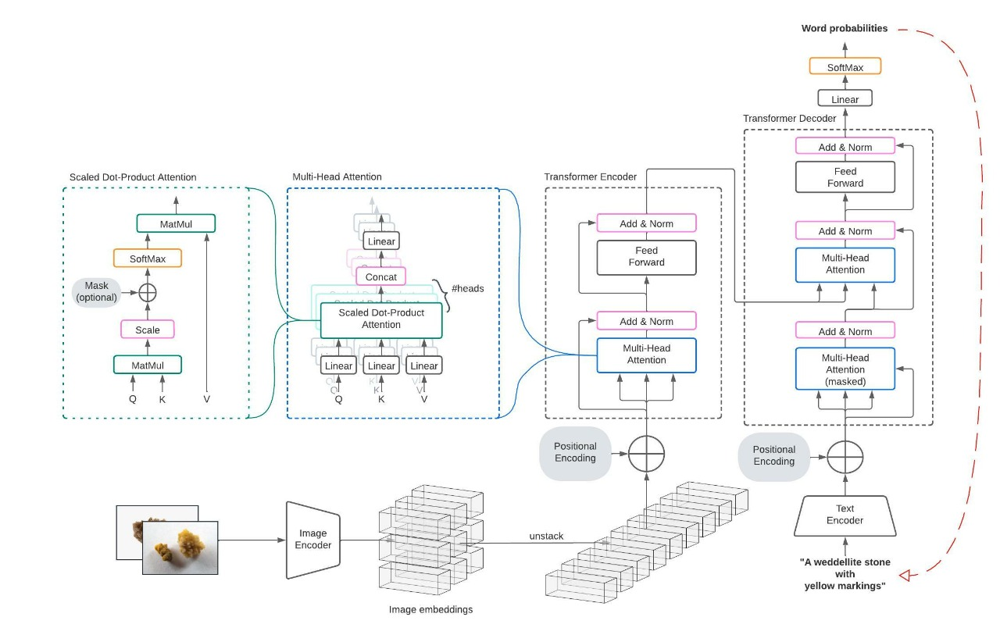

## Image encoder (model)

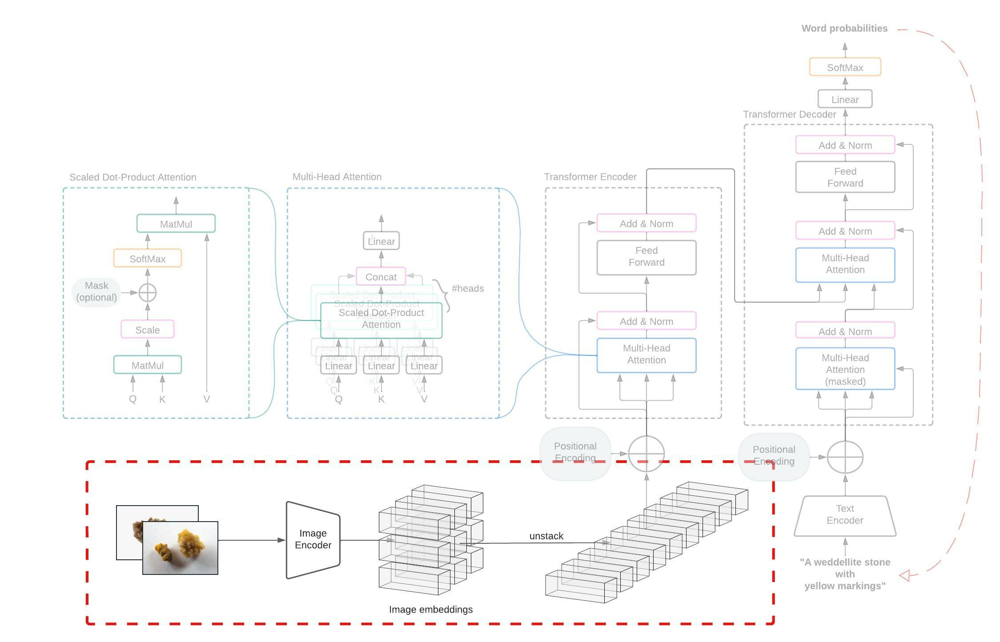

The input is a 299 by 299 image batch and the output are the image features corresponding to the last layer but they are flattened. 

In [50]:
def make_image_encoder(IMAGE_SIZE=(299,299), backbone='efficientnetb0',trainable=False):
    
    inputs=tf.keras.Input(shape=(*IMAGE_SIZE,3))

    if backbone=='efficientnetb0':
    # Notice that the images must be in float formate (299,299,3) and go from 0 to 255
        print('input images must be floats from 0 to 255 and have (299,299,3) format.') 
        base_model = tf.keras.applications.efficientnet.EfficientNetB0(input_shape=(*IMAGE_SIZE, 3), 
                                                                       include_top=False, 
                                                                       weights="imagenet",)
    if backbone=='resnet50':
    # Special preprocessing needed
     
        base_model=tf.keras.applications.resnet50.ResNet50(input_shape=(*IMAGE_SIZE, 3), 
                                                           include_top=False, 
                                                           weights="imagenet",)
    
    base_model.trainable = trainable
    base_model_out = base_model.output
    base_model_out = tf.keras.layers.Reshape((-1, base_model_out.shape[-1]))(base_model_out)
    cnn_model = tf.keras.models.Model(base_model.input, base_model_out, name='image_encoder')
    return cnn_model


## Transformer Encoder Block (Layer )

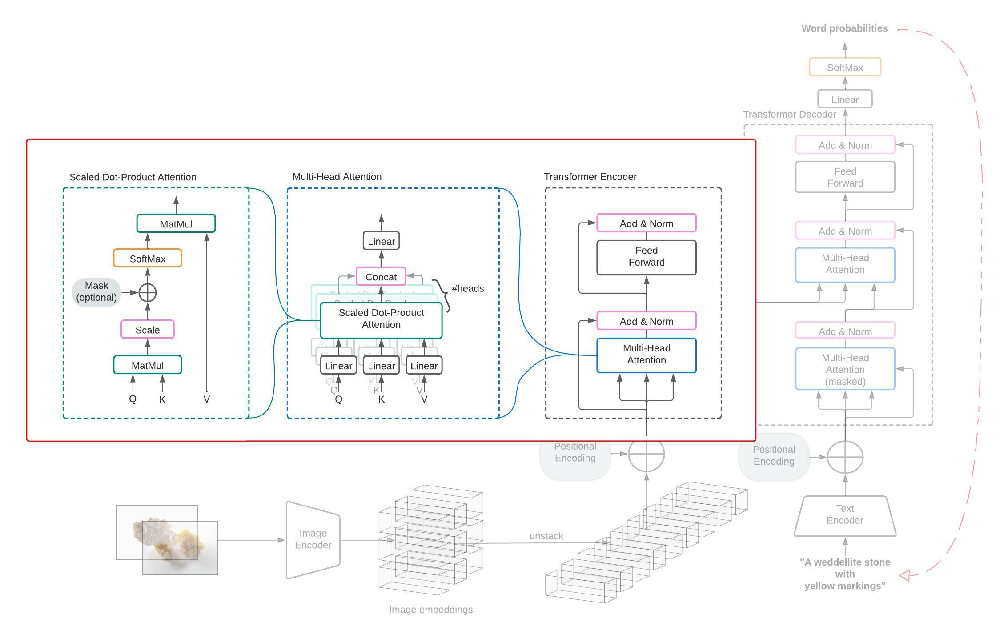

This encoder block will take convolutional vectors corresponding to different areas of the image and transform them into a sequence of values for text queries. It follows the transformer architecture: 







In [51]:
class TransformerEncoder(tf.keras.layers.Layer):
    
    def __init__(self, seq_len, embedding_dim, num_heads,dropout,**kwargs):
        super().__init__(**kwargs)
            

        self.mha = MultiHeadAttention(num_heads=num_heads,
                                      key_dim=embedding_dim,
                                      dropout=dropout)
        # Mha Q:(T,k_dim), K: (S,key_dim), V (S, v_dim)
        # T=Sequence length of query, S=Number of values to attend to. 
        # notice that there  is one key per value to attend to, meaning 
        # there are S values and S keys. 
        # The operation QxT'xV is performed, which yields dimensions
        # (T x k_dim) x (k_dim x v_dim) = T x v_dim
        # however then the result is projected 
        # back to k_dim size to yield (T x k_dim) result.  
        self.ffn = tf.keras.Sequential([tf.keras.layers.Dense(embedding_dim, activation='relu'),  # (batch_size, seq_len, dff)
                                        tf.keras.layers.Dense(embedding_dim)])                    # (batch_size, seq_len, d_model)
      
        self.norm_input = tf.keras.layers.LayerNormalization(epsilon=1e-6)
        self.layernorm1 = tf.keras.layers.LayerNormalization(epsilon=1e-6)
        self.layernorm2 = tf.keras.layers.LayerNormalization(epsilon=1e-6)

        self.dropout1 = tf.keras.layers.Dropout(dropout)
        self.dropout2 = tf.keras.layers.Dropout(dropout)

    def call(self, x, training=True, mask=None):

        x=self.norm_input(x)
        attn_output, att = self.mha(query=x, 
                                    value=x, 
                                    key=x, 
                                    return_attention_scores=True)  # (batch_size, input_seq_len, d_model)
        attn_output = self.dropout1(attn_output, training=training)
        out1 = self.layernorm1(x + attn_output)  # (batch_size, input_seq_len, d_model)

        ffn_output = self.ffn(out1)  # (batch_size, input_seq_len, d_model)
        ffn_output = self.dropout2(ffn_output, training=training)
        out2 = self.layernorm2(out1 + ffn_output)  # (batch_size, input_seq_len, d_model)
        
        output_dict={'embeddings':out2,'attentions':att}
        return output_dict



## Text encoder (layer within class) Abstract
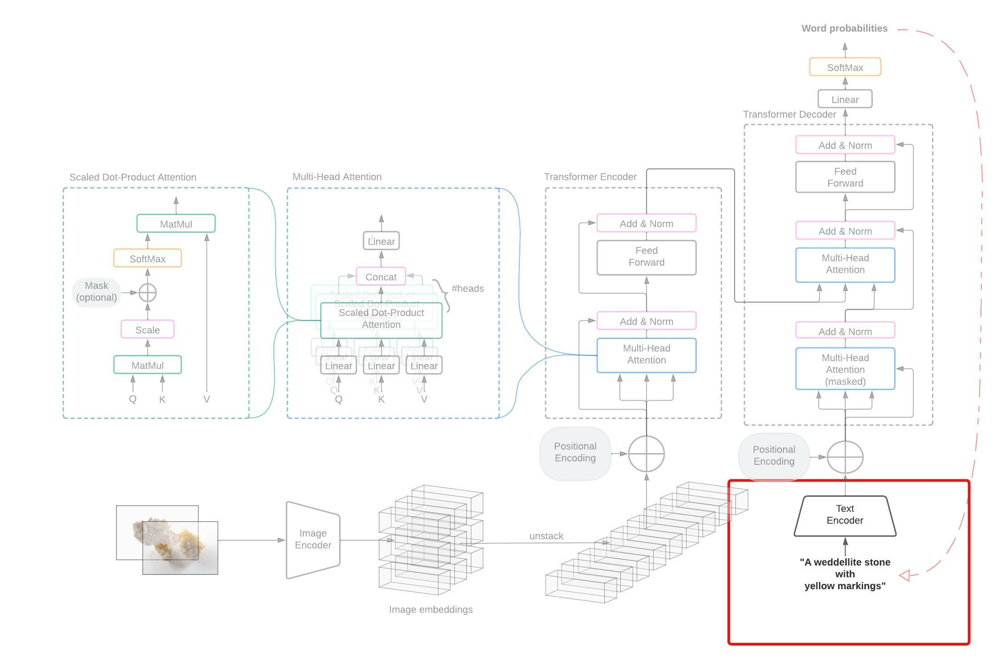









We opted to implement a class to gain access to the specific tokenizer of the text encoder (which is different for bert, clinical_bert, etc as well as the masking function). The class template must have the following methods: 
1. .mask(tokens)
2. .tokenize(text)
3. .encode(tokens)
The core layer: 
    This layer takes a string and returns vectorized string. There are several options for this one. 

In [52]:
class TextEncoder(object):
    """A text encoder and associated objects for modular implementations.

    The class is to be used within larger architectures such as the clip
    pretraining module or the captioning transformer. The class includes
    the tokenizer as well as encoding functions. 
    
    Usage: 
        encoder=TextEncoder()
        tokens=encoder.tokenizer(df)
        embeddings=encoder.encode(tokens)

    Attributes:
        
        seq_len (int): The sequence length for the outputs. 
        embedding_dim (int): The embedding dimensions. 
        projection_trainable (bool): Whether the projection head of the 
            model is trainable or not. 
        backbone_trainable (bool): Whether the backbone of the model is 
            trainable or not. 
        dropout (float): Dropout rate. 
        tokenizer(function): A tokenizer object built uisng seq_len attribute.  
        encoder(keras_model): An encoder model built on the previous attributes, 
            (seq_len,embedding_dim,projection_trainable and backbone trainable).
        start_token(str): Start token. 
        end_token(str:): End token.
        
        Start and end tokens are added to the begnning and end of captions. 
        
        
    """

    def __init__(self,seq_len=100,embedding_dim=512,projection_trainable=False,
                 backbone_trainable=False,dropout=0.1):
        """Initializes the text encoder to the default values. Builds the encoders
           and tokenizers. 
           
            Args:
                
                seq_len (int): The sequence length for the outputs. 
                embedding_dim (int): The embedding dimensions. 
                projection_trainable (bool): Whether the projection head of the 
                    model is trainable or not. 
                backbone_trainable (bool): Whether the backbone of the model is 
                    trainable or not. 
                dropout(float,optional): The dropout rate. 
               
        """
        self.seq_len=seq_len
        self.embedding_dim=embedding_dim
        self.projection_trainable=projection_trainable
        self.backbone_trainable=backbone_trainable
        self.dropout=dropout
        
        self.tokenizer=self.build_tokenizer()
        self.encoder=self.build_encoder()
    @ property
    def vocab(self):
        print('vocab property not yet implemented')
        vocab=None
        return vocab


    def build_tokenizer(self):
        """Builds the tokenizer according to the class attributes.
        
        Some subclasses may need access to the training data to build the tokenizer. 
        """
        print('build_tokenizer method called but method not implemented.')
        return None
    
    def build_encoder(self):
        """Build the encoder. 
        
        The encoder must take sequences of tokens and return 
        embeddings of size 'self.emb_dim'
        """
        print('build_encoder method called but method not implemented.')
        return None
    
    def tokenize(self,texts):
        """Apply preprocessing and tokenizes the texts.
        
        Args: 
            texts(tensor): Tensor of shape (batch_size,None) of strings. 
            
        Returns: 
            tokens(tensor):Tensor of shape (batch_size,seq_len) of token keys.
        """
       
        
        return self.tokenizer(texts)
        
    def encode(self,tokens,**kwargs):
        """Encode the tokens into vectors of size 'self.embedding_dim'
        Args: 
            tokens(tensor of ints): A tensor of shape (batch_size,self.seq_len)
                containing the token keys. 
        Returns: 
            embeddings(tensor of floats): A tensor of shape 
                (batch_size, self.seq_len, self.embedding_dim)
        """
        return self.encoder(tokens,**kwargs)
        
    def tokenize_and_encode(self,texts):
        """Apply the tokenizer and then the encoder to a sequence of texts. 
        
        Args:
            texts(iterable): A sequence of strings. 
        Returns: 
            embeddings(tensor): A tensor of shape (batch_size,slf.seq_len,self.embedding_dim)
            that contains the embedding representation of the texts. 
            
        """
        tokens=self.tokenize(texts)
        embeddings=self.encode(tokens)
        
        return embeddings
    
    def mask(self,tokens):
        """Mask 0 tokens
        Args: 
            
        """
        return tf.math.not_equal(tokens, 0)
        

## Embedding Matrix text encoder (class) 

In [53]:
class MatrixTextEncoder(TextEncoder):
    """Children of TextEncoder. Embedding matrix text encoder. 
        
    A simple text encoder composed by a tokenizer and an embedding 
    matrix. 
        
        
        
    """
    def __init__(self,tokenizer_data,**kwargs):
        """Initializes the text encoder to the default values. Builds the encoders
           and tokenizers. 
           
        Args:
            tokenizer_data(iterable): A list or array of texts on which to adapt the 
                tokenizer. 
            embedding_dim (int,optional): The embedding dimensions. Defaults to 512 
            projection_trainable (bool,optional): Whether the projection head of the 
                model is trainable or not. Defaults to False. 
            backbone_trainable (bool,optional): Whether the backbone of the model is 
                trainable or not. Defaults to False. 

        """
        self.tokenizer_data=tokenizer_data
        self.backbone=None
        self.start_token='<start>'
        self.end_token='<end>'
            
        
        # The super class is called at last because I am overriding the build_tokenizer method
        # which now requires self.tokenizer_data so we need to instantiate it first and then 
        # build the rest of attributes from super. 
        super().__init__(**kwargs)
        
    @property
    def vocabulary_size(self):
        "str: The vocabulary size of the tokenizer including OOV token"
        return self.tokenizer.vocabulary_size()
    @property
    def vocabulary(self):
        return self.tokenizer.get_vocabulary()
    @property
    def vocabulary_dict(self):
        dictionary=dict(zip(range(len(self.vocabulary)),self.vocabulary))
        return dictionary
    
    def standarize(self, input_string):
        strip_chars = "!\"#$%&'()*+,-./:;<=>?@[\]^_`{|}~"
        strip_chars = strip_chars.replace("<", "")
        strip_chars = strip_chars.replace(">", "")
        lowercase = tf.strings.lower(input_string)
        final_string =tf.strings.regex_replace(lowercase, 
                                                 "[%s]" % re.escape(strip_chars), "")
        return final_string
        
    def build_tokenizer(self):
        """ Builds and adapts the tokenizer according to the class attributes"""
        tokenizer=tf.keras.layers.TextVectorization(
        max_tokens=None,
        standardize=self.standarize,
        split='whitespace',
        ngrams=None,
        output_mode='int',
        output_sequence_length=self.seq_len, # Impotant to fit the ammount of characters in the string. 
        pad_to_max_tokens=False,
        vocabulary=None,
        idf_weights=None,
        sparse=False,
        ragged=False,
        name='Matrix_Text_Encoder_Vectorizer')
        
        tokenizer.adapt(self.tokenizer_data)
        
        return tokenizer
    
    def build_encoder(self):
        """
        Builds a keras functional model text encoder based on the class
        attributes. 
        """
        input_tokens=tf.keras.Input(shape=[None])
        embedding_matrix= tf.keras.layers.Embedding(
            input_dim=self.tokenizer.vocabulary_size(),
            output_dim=self.embedding_dim,
            embeddings_initializer='uniform',
            embeddings_regularizer=None,
            activity_regularizer=None,
            embeddings_constraint=None,
            mask_zero=False,
            input_length=None,
        )

        output_embeddings=embedding_matrix(input_tokens)
        model=tf.keras.Model(inputs=input_tokens,
                             outputs=output_embeddings,name='Matrix_Text_Encoder')
        if not self.projection_trainable:
            for layer in model.layers:
                layer.trainable=False
        
        return model
    
        
        
        

## Positional embedding (layer)

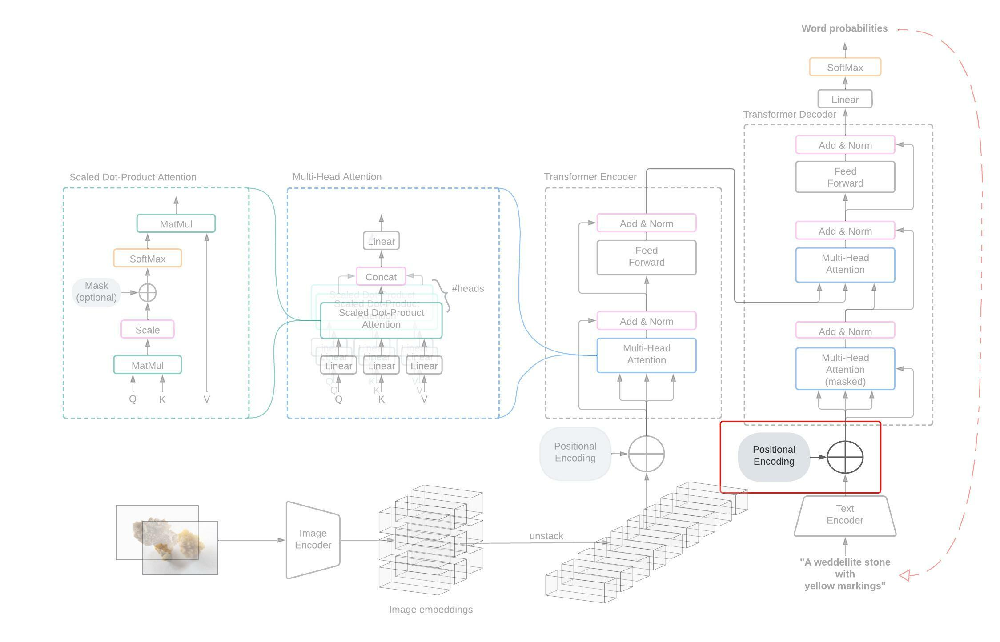


A custom layer that takes the text embeddings and learns a positional encoding to add to each index. 

In [54]:
class AddLearntPositional(tf.keras.layers.Layer):
    def __init__(self,sequence_length,embedding_dim,**kwargs):
        
        super().__init__(**kwargs)
       
        self.position_embeddings = layers.Embedding(
            input_dim=sequence_length, 
            output_dim=embedding_dim)
        
        self.tok_emb_scale=tf.math.sqrt(tf.cast(embedding_dim,tf.float32))
        self.sequence_length=sequence_length

    def call(self,inputs):
        
        length = tf.shape(inputs)[-2] # Length of the sequence
        positions = tf.range(start=0, limit=length, delta=1) # Indexes of the positions
        embedded_positions = self.position_embeddings(positions)
        output_embedding=embedded_positions
        scaled_inputs=self.tok_emb_scale*inputs
        
        return output_embedding+inputs
    

## Transformer decoder (layer)

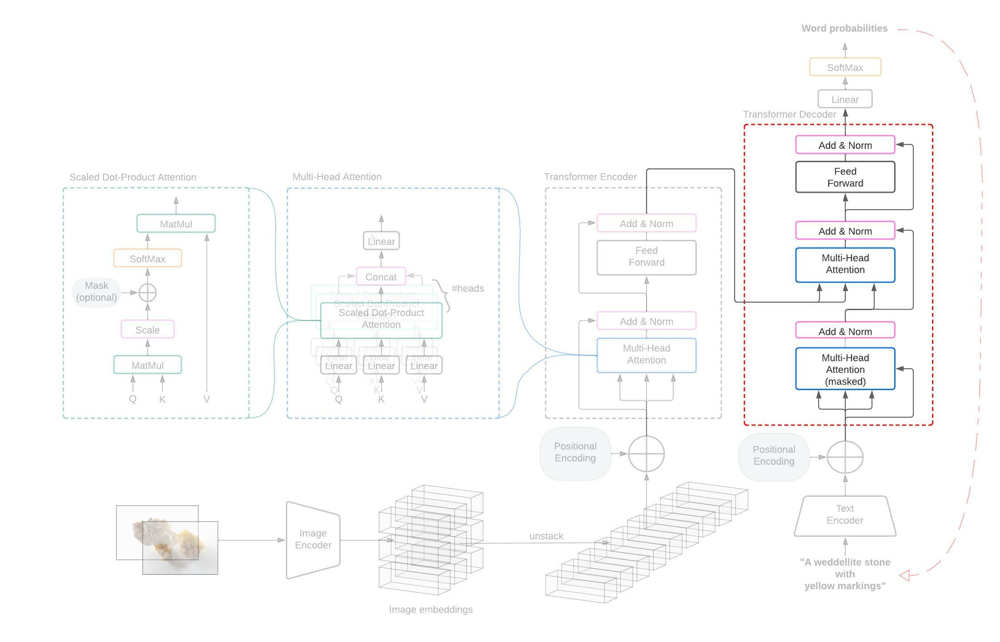

In [55]:
class TransformerDecoder(tf.keras.layers.Layer):
    def __init__(self,num_heads,embedding_dim,dropout,debug=False, **kwargs):
        super().__init__(**kwargs)
        
        self.debug=debug
        
        
        # Multi head attention modules
        self.mha1=MultiHeadAttention(num_heads=num_heads,
                                      key_dim=embedding_dim,
                                      dropout=dropout)
        self.mha2=MultiHeadAttention(num_heads=num_heads,
                                     key_dim=embedding_dim,
                                     dropout=dropout)
        
        # Layer normalizations
        self.layer_norm1 = tf.keras.layers.LayerNormalization(epsilon=1e-6)
        self.layer_norm2 = tf.keras.layers.LayerNormalization(epsilon=1e-6)
        self.layer_norm3 = tf.keras.layers.LayerNormalization(epsilon=1e-6)
        
        # Feed forward network 
        self.feed_forward = tf.keras.Sequential([
            tf.keras.layers.Dense(embedding_dim,activation='relu'),
            tf.keras.layers.Dropout(dropout),
            tf.keras.layers.Dense(embedding_dim),
            tf.keras.layers.Dropout(dropout)])
        
    def call(self,inputs, image_embedding_sequence, mask=False):
        # Mask the inputs if the option to mask inputs is provided
        debug=self.debug
        if debug:
            print('\n\nTransformer decoder called\n-------------------')
        if debug:
            print('calculating masks ')
        if mask is not None:
            causal_mask = self.get_causal_attention_mask(inputs)
            padding_mask = tf.cast(mask[:, :, tf.newaxis], dtype=tf.int32)
            combined_mask = tf.cast(mask[:, tf.newaxis, :], dtype=tf.int32)
            combined_mask = tf.minimum(combined_mask, causal_mask)
        if debug: 
            print(f'combined mask: {combined_mask.shape}')
        # Pass inputs through first attention head using masking
        if debug:
            print(f'going through attention head 1:\n\t inputs:{inputs.shape}')
        x = self.mha1(
            query=inputs,
            value=inputs,
            key=inputs, 
            attention_mask=combined_mask
            )
        # Add and normalize
        if debug:
            print(f'going thorugh layer normalization 1:\n\t inputs:{inputs.shape}\n\t x:{x.shape}')
        x1=self.layer_norm1(x+inputs)
        
        # Pass inputs throught second attention head
        if debug:
            print(f'going thorugh mha 2: \n\t x1:{x1.shape}\n\t image\
            _embedding_sequence:{image_embedding_sequence.shape}')
        x2=self.mha2(
            query=x1,
            key=image_embedding_sequence,
            value=image_embedding_sequence,
            attention_mask=padding_mask
            
            )
        # Add and normalize
        if debug:
            print(f'going thorugh addnorm2:\n\t x2:{x2.shape}')
        x2=self.layer_norm2(x1+x2)
        
        # Pass inputs through feed forward network
        if debug:
            print(f'going thorugh feed forward:\n\t x2:{x2.shape}')
        x3=self.feed_forward(x2)
        
        # Add and normalize
        if debug:
            print(f'layer normalization:\n\t x2:{x2.shape}\n\t x3:{x3.shape}')
        x3=self.layer_norm3(x2+x3)
        return x3
    
    
    def get_causal_attention_mask(self, inputs):
        
        input_shape = tf.shape(inputs)
        batch_size, sequence_length = input_shape[0], input_shape[1]
        
        i = tf.range(sequence_length)[:, tf.newaxis]
        j = tf.range(sequence_length)
        
        mask = tf.cast(i >= j, dtype="int32")
        mask = tf.reshape(mask, (1, input_shape[1], input_shape[1]))
        
        mult = tf.concat([tf.expand_dims(batch_size, -1), 
                          tf.constant([1, 1], 
                          dtype=tf.int32)],
                          axis=0,)
        
        return tf.tile(mask, mult)
    
        

## Captioning Model (Subclassed Model)
Putting it all together in a subclassed model

In [56]:
class CaptioningTransformer(tf.keras.Model):
    """Makes a transformer based captioning model.

    If the class has public attributes, they may be documented here
    in an ``Attributes`` section and follow the same formatting as a
    function's ``Args`` section. Alternatively, attributes may be documented
    inline with the attribute's declaration (see __init__ method below).

    Properties created with the ``@property`` decorator should be documented
    in the property's getter method.

    Attributes:
        image_size (touple): Height and width of the image taken by the model. 
        
        image_encoder (model): A model that takes images (None, H,W,3) 
            and produces a unstacked convolutional volume (None, positions(HxW) ,emb_length)
        attr2 (:obj:`int`, optional): Description of `attr2`.

    """

    def __init__(self,image_encoder, text_encoder, 
                 transformer_encoder, transformer_decoder,
                 embedding_dim,num_heads,vocab_size,captions_per_image,
                 debug=False,**kwargs):
        
        super().__init__(**kwargs)
        
        self.embedding_dim=embedding_dim
        self.image_encoder=image_encoder
        self.image_projector=tf.keras.layers.Dense(embedding_dim)
        self.text_encoder=text_encoder
        self.text_encoder_encoder=text_encoder.encoder
        self.text_enocder_tokenizer=text_encoder.tokenizer
        self.text_projector=tf.keras.layers.Dense(embedding_dim)
        self.seq_len=text_encoder.seq_len
        self.num_heads=num_heads
        self.add_positional_img= AddLearntPositional(image_encoder.output.shape[-2],self.embedding_dim)
        self.add_positional_txt= AddLearntPositional(self.seq_len,self.embedding_dim)
        self.transformer_encoder=transformer_encoder
        self.transformer_decoder=transformer_decoder
        self.vocab_size=vocab_size
        self.debug=debug
        self.captions_per_image=captions_per_image
    
        # The output model, is responsible of taking the decoder sequence output and 
        # translating it to probabilities of the words in the vocab. For now, 
        # it will be a sigmoid with the vocab size. However we may explore other ways 
        # in the future such as distance metrics or similarity between output embeddings and 
        # target wordd embeddings. 
        self.out=tf.keras.layers.Dense(self.vocab_size,activation='softmax')
        
        # Trackers: These 
        self.loss_tracker = keras.metrics.Mean(name="loss")
        self.acc_tracker = keras.metrics.Mean(name="accuracy")
   
    @property
    
    def metrics(self):
        # We need to list our metrics here so the `reset_states()` can be
        # called automatically.
        return [self.loss_tracker, self.acc_tracker]
    
    def train_step(self, batch_data):
        
        debug=self.debug
        # Unpack data 
        if debug:
            print('\n\nCaptioning transformer called\n----------')
        if debug:
            print('unpacking data')
        image_input=batch_data['image']
        text_inputs=batch_data['text']

        batch_acc=0
        batch_loss=0
        for i in range(self.captions_per_image):
            text_input=text_inputs[:,i]
            with tf.GradientTape() as tape:
            # Forward pass
                # Pass text through text encoder
                if debug:
                    print(f'passing text through text encoder:\n\t text_input:{text_input.shape}')

                # Split the predictor text from the target text.
                all_tokens=self.text_encoder.tokenize(text_input)
                predictor_tokens,y_true=all_tokens[:,:-1],all_tokens[:,1:]
                # Get the mask from the targets. 
                
                mask=self.text_encoder.mask(y_true)
                
                if debug:
                    print(f'The mask has dimensions {mask.shape}')

                # Pass image through all image layers
                # (encoding, projection, positional encoding, transformer encoder)
                image_encoding=self.full_encoder(image_input,debug=debug)
                
                # Decode the embeddings using the queries provided by the 
                # predictor tokens.
                y_pred=self.full_decoder(predictor_tokens,image_encoding,mask,debug=debug)

                if debug:
                    print('Calculating loss')
                    print(f'Predictions shape: {y_pred.shape}\ny_true shape{y_true.shape}')

                loss=self.calculate_loss(y_true,y_pred,mask)
                    
            # Compute gradients
            if debug:
                print('computing gradients')
            gradients = tape.gradient(loss, self.trainable_variables)
            
            # Apply gradients
            if debug:
                print('applying weights')
            self.optimizer.apply_gradients(zip(gradients, self.trainable_variables))
            
            # update batch loss
            batch_loss+=loss
            
            # coumpute accuracy and update batch_accuracy
            if debug:
                print('Computing accuracy')
            acc=self.calculate_accuracy(y_true,y_pred,mask)
            batch_acc+=acc
            
        # Update loss trackers
        self.loss_tracker.update_state(batch_loss)
        self.acc_tracker.update_state(batch_acc/self.captions_per_image)

        return {"loss": self.loss_tracker.result(),
                "acc": self.acc_tracker.result()}
      
    def full_encoder(self, image_input,debug=False):
        """
        Apply image encoding layers to image input. 
        
        Apply the image encoder, transformer encoder and image projection layers
        to the image. This is known as the "encoder" in the "encoder-decoder" 
        architecture. Notice that it is called "full-encoder" here because it is
        made of several layers. These are: 
        1. Pass image through image encoder. 
        2. Project image encodings to the dimension of the transformer model. 
        3. Pass projected image encodings through transformer encoder. 
        """
        # Pass image through image encoder. 
        if debug:
            print(f'pass through image encoder:\n\t image_input:{image_input.shape}')
        image_embeddings_0=self.image_encoder(image_input)
        # Project image embeddings to right dimension
        image_embeddings_1=self.image_projector(image_embeddings_0)
        # Add positional encoding
        if debug:
            print(f'Adding positional encoder to image embeddings:\n\t image_embeddings: {image_embeddings_1.shape}')
        image_embeddings_2=self.add_positional_img(image_embeddings_1)

        # Pass image encoder outputs through transformer encoder
        image_embeddings_3=self.transformer_encoder(image_embeddings_2)['embeddings']
        return image_embeddings_3
        
    def full_decoder(self,predictor_tokens,image_embeddings,mask,debug=False):
        """
        Decode the predictor_tokens and the image_embeddings into the
        predictions for words at each slot in the target. 
        
        Args: 
            predictor_tokens: The left part of the training sequence used to 
                predict the right part of the sequence. It must already be 
                tokenized.
            image_embeddings: The result of the full_encoding process of the 
                image. 
            mask: Masking of the empty tokens of the target sequence.
        Returns:
            probs: The probabilities for every word in the output sequence. 
                Probs have shape (None,seq_len,vocab_size)
        """
        # Use text encoder to get embeddings from tokens. 
        token_embeddings=self.text_encoder.encode(predictor_tokens)
        # Project text encodings to right shape for transformer
        if debug:
            print(f'going thorugh text_projector:\n\t embeddings:{token_embeddings.shape}')
        token_embeddings=self.text_projector(token_embeddings)
        # Add positional encoding.
        if debug: 
            print(f'adding positional embeddings to text \n\t embeddings:{token_embeddings.shape}')
        queries=self.add_positional_txt(token_embeddings)
        
         # Go through transformer decoder. 
        if debug:
            print(f'going through decoder\n\t image_embedding_sequence:{image_embeddings.shape}'+
                  f'\n\t text_embedings:{queries.shape} ')
        prediction_context= self.transformer_decoder(queries, 
                                                     image_embedding_sequence=image_embeddings, 
                                                     mask=mask)
        # Compute loss.
        probs=self.out(prediction_context)
        return probs
    
    def calculate_loss(self, y_true, y_pred, mask):
        """
        Calculates the loss and masks it 
        
        Args:
        y_true: Batch of tokens with dimension (None,seq_len-1)
            (-1 because of the left shifting of the input sequence)
        y_pred: A batch of probabilities
        
        """
        loss = self.loss(y_true, y_pred)
        mask = tf.cast(mask, dtype=loss.dtype)
        loss *= mask
        loss= (tf.reduce_sum(loss) / tf.reduce_sum(mask))
        # if math.isnan(loss):
        #     print('loss is nan')
        #     print(f'mask:\n {tf.reduce_sum(mask)}')
        #     print(f'y_true:\n {y_true}')
        #     print(f'y_pred:\n {y_pred}')
        
        return loss
    
    def calculate_accuracy(self, y_true, y_pred, mask):
        # Argmax get's the index of the max across the vocabulary dimension. 
        accuracy = tf.equal(y_true, tf.argmax(y_pred, axis=2))
        
        # The logical and avoids counting correct 
        # predictions of values that are masked
        accuracy = tf.math.logical_and(mask, accuracy)
        
        # Ture values are casted to 1. 
        accuracy = tf.cast(accuracy, dtype=tf.float32)
        mask = tf.cast(mask, dtype=tf.float32)
        
        return tf.reduce_sum(accuracy) / tf.reduce_sum(mask)
   
    def test_step(self,batch_data):
        
        debug=self.debug
        # Unpack data 
        if debug:
            print('\n\nCaptioning transformer called\n----------')
        if debug:
            print('unpacking data')
        image_input=batch_data['image']
        text_inputs=batch_data['text']

        batch_acc=0
        batch_loss=0
        
        for i in range(self.captions_per_image):
            text_input=text_inputs[:,i]
            # Forward pass
            # Pass text through text encoder
            if debug:
                print(f'passing text through text encoder:\n\t text_input:{text_input.shape}')

            # Split the predictor text from the target text.
            all_tokens=self.text_encoder.tokenize(text_input)
            predictor_tokens,y_true=all_tokens[:,:-1],all_tokens[:,1:]
            # Get the mask from the targets. 
            mask=self.text_encoder.mask(y_true)

            # Pass image through all image layers
            # (encoding, projection, positional encoding, transformer encoder)
            image_encoding=self.full_encoder(image_input,debug=debug)

            # Decode the embeddings using the queries provided by the 
            # predictor tokens.
            y_pred=self.full_decoder(predictor_tokens,image_encoding,mask,debug=debug)

            if debug:
                print('Calculating loss')
                print(f'Predictions shape: {y_pred.shape}\ny_true shape{y_true.shape}')

            loss=self.calculate_loss(y_true,y_pred,mask)
                                 
            # update batch loss
            batch_loss+=loss
            
            # coumpute accuracy and update batch_accuracy
            if debug:
                print('Computing accuracy')
            acc=self.calculate_accuracy(y_true,y_pred,mask)
            batch_acc+=acc
            
        # Update loss trackers
        self.loss_tracker.update_state(batch_loss)
        self.acc_tracker.update_state(batch_acc/self.captions_per_image)

        return {"loss": self.loss_tracker.result(),
                "acc": self.acc_tracker.result()}
        



## Function to instantiate the captioner

In [57]:
def instantiate_captioner(params,data_pipeline):
    """
    Instantiates a captioning model. 
    
    Args: 
        params(dict): A dictionary of parameters for the model 
        data_pipeline(pipeline): A pipeline made by the make_pipeline function
    Returns 
        model(tf model): The captioner model
    """
  
    

    tokenizer_data=data_pipeline['captioning']['train_captions']              # Get the captions to fit tokenizer


    text_encoder=MatrixTextEncoder(seq_len=params['SEQ_LEN'],                # Make text encoder
                                   embedding_dim=params['EMBEDDING_DIM'],
                                   tokenizer_data=tokenizer_data,
                                   projection_trainable=True,
                                   backbone_trainable=True)
    
    image_encoder=make_image_encoder(params['IMG_SIZE'],                      # Make image encoder
                                     backbone=params['IMG_BACKBONE'],
                                     trainable= params['IMG_TRAINABLE'])
    
    transformer_encoder=TransformerEncoder(params['SEQ_LEN'],                 # Make transformer encoder
                                           params['EMBEDDING_DIM'],
                                           params['NUM_HEADS'], 
                                           params['DROPOUT'])
    
    transformer_decoder=TransformerDecoder(params['NUM_HEADS'],             # Make transformer decoder
                                           params['EMBEDDING_DIM'],
                                           params['DROPOUT'])

   
    VOCAB_SIZE=text_encoder.vocabulary_size   
   
    model=CaptioningTransformer(image_encoder,                             # Build the captioner model 
                                text_encoder,             
                                transformer_encoder,
                                transformer_decoder,
                                params['EMBEDDING_DIM'],
                                params['NUM_HEADS'],
                                VOCAB_SIZE,captions_per_image=1)
    return model

# RUNNING THE MODEL

## Instantiate Model

In [5]:
data_pipeline['captioning'].keys()

dict_keys(['train', 'val', 'test', 'train_captions'])

In [2]:

#Settings
params={
    'IMG_SIZE':(299,299),
    'IMG_BACKBONE':'efficientnetb0',
    'IMG_TRAINABLE':False,
    'EMBEDDING_DIM':500,
    'SEQ_LEN':70 ,
    'NUM_HEADS':3,
    'DROPOUT':0.01,
    'DATA_PATH':'../data/intermediate/inter_medpix.csv',
    'DATA_SPLIT':[0.9,0.05,0.05],
    'DATA_DOWNSCALE':False,               
    'LEARNING_RATE': 9e-4,
}

data_pipeline= build_pipeline(inter_dataset_path=params['DATA_PATH'],
                              image_size=params['IMG_SIZE'],
                              train_val_test_split=params['DATA_SPLIT'])

model= instantiate_captioner(params,data_pipeline)  # Instantiate the model

2022-11-20 21:48:12.703403: E tensorflow/stream_executor/cuda/cuda_driver.cc:271] failed call to cuInit: CUDA_ERROR_NO_DEVICE: no CUDA-capable device is detected
2022-11-20 21:48:12.703527: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:156] kernel driver does not appear to be running on this host (tensorflow-2-8-20221025-075908): /proc/driver/nvidia/version does not exist
2022-11-20 21:48:12.722206: I tensorflow/core/platform/cpu_feature_guard.cc:151] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


NameError: name 'instantiate_captioner' is not defined

## Callbacks and checkpointing

### The captioning callback

In [ ]:
class CaptioningCallback(tf.keras.callbacks.Callback):
    """ A callback that logs the paremeter dictionary of the model.
    """
    def __init__(self,params,log_dir):
        """
        Initialize the callback. 
        
        Args:
            params(dict): The parameters of the model.
            log_dir(str): Path to the model tensorboard log.  
        """
        super().__init__()
        self.model_params=params
        self.log_dir=log_dir
        
    def on_train_begin(self,logs=None):
        """
        Log the model parameters. 

        """
        file_writer = tf.summary.create_file_writer(self.log_dir) 
        with file_writer.as_default():
            tf.summary.text("model_params", self.pretty_json(self.model_params), step=0)
        
    def on_epoch_end(self, epoch,logs):
        ''' 
        Log bleu metrics (not implemented yet).
        '''
        pass
    
    def pretty_json(self,hp):
        """Dumps dictionary into a formatted string.  
        
        Args: 
           hp(dict): The parameters dictionary
        
        Returns:
            json_hp(str): A formatted string with the contents of the hp dict
        """
        json_hp = json.dumps(hp, indent=2)
        return "".join("\t" + line for line in json_hp.splitlines(True))

### Define the savepath

In [39]:
# Define checkpoints path
date_str=datetime.datetime.now().strftime("%Y%m%d-%H%M%S") # Get the date
save_model_path='../models/pretraining/captioning/' + date_str # build savepath

# Define logs path
log_dir='../model_logs/pretraining/captioning/'+date_str # The logs directory


### Instantiate callbacks

In [ ]:
# Define callbacks
# Since model is subclassed we save weights only.
checkpoint_callback = tf.keras.callbacks.ModelCheckpoint( # Callback to save the model every epoch end
        filepath=save_model_path,
        save_weights_only=True,
        monitor='val_loss',
        mode='min',
        save_best_only=True)

tensorboard_callback=tf.keras.callbacks.TensorBoard(  # Callback to log loss and accuracy every epoch
    log_dir=log_dir,
    histogram_freq=None,
    write_graph=True,
    write_images=False,
    write_steps_per_second=False,
    update_freq='epoch',
    profile_batch=0,
    embeddings_freq=1,
    embeddings_metadata=None)

captioning_callback= CaptioningCallback(params=params,
                                       log_dir=log_dir)


# Define learning rate decay 
# lr_schedule = keras.optimizers.schedules.ExponentialDecay(
#     initial_learning_rate=1e-7,
#     decay_steps=8,
#     decay_rate=1.5)
    




        


        

## Compile and Train

In [ ]:
train_data=data_pipeline['captioning']['train'].batch(32)
validation_data=data_pipeline['captioning']['val'].batch(32)
loss=tf.keras.losses.SparseCategoricalCrossentropy(reduction='none',from_logits=False)
opt = keras.optimizers.Adam(learning_rate=params['LEARNING_RATE'])
model.compile(loss=loss, optimizer=opt)
model.fit(train_data,validation_data=validation_data,epochs=200,callbacks=[checkpoint_callback,
                                                                           tensorboard_callback,
                                                                           captioning_callback])
# model.fit(train_data.take(3),
#           validation_data=validation_data.take(1),
#           epochs=1,
#           callbacks=[checkpoint_callback, # We include the three callbacks
#                      tensorboard_callback,
#                      captioning_callback])

# MAKING CAPTIONS

In [29]:
# # Remember to create the object model and call it on some data fist
# path='../models/pretraining/captioning/20220814-170749' 
# model.load_weights(path)
def test_step(batch_data,self=model):
        debug=self.debug
        # Unpack data 
        if debug:
            print('test_step')
            print('\n\nCaptioning transformer called\n----------')
        if debug:
            print('unpacking data')
        image_input=batch_data['image']
        text_input=batch_data['text']
        
        # Forward pass
        # Pass text through text encoder
        if debug:
            print(f'passing text through text encoder:\n\t text_input:{text_input.shape}')


        # Split the predictor text from the target test. 
        all_tokens=self.text_encoder.tokenize(text_input)
        predictor_tokens,y_true=all_tokens[:,:-1],all_tokens[:,1:]
        mask=self.text_encoder.mask(predictor_tokens)
        embeddings=self.text_encoder.encode(predictor_tokens)

        # Project text encodings to right shape
        if debug:
            print(f'going thorugh text_projector:\n\t embeddings:{embeddings.shape}')
        embeddings=self.text_projector(embeddings)

        # Add positional encoding.
        if debug: 
            print(f'adding positional embeddings to text \n\t embeddings:{embeddings.shape}')
        text_embeddings=self.add_positional_txt(embeddings)

        # Pass image through image encoder. 
        if debug:
            print(f'pass through image encoder:\n\t image_input:{image_input.shape}')
        image_embeddings_0=self.image_encoder(image_input)
        # Project image embeddings to right dimension
        image_embeddings_1=self.image_projector(image_embeddings_0)

        # Add positional encoding
        if debug:
            print(f'Adding positional encoder to image embeddings:\n\t image_embeddings: {image_embeddings.shape}')
        image_embeddings_2=self.add_positional_img(image_embeddings_1)

        # Pass image encoder outputs through transformer encoder
        image_embeddings_3=self.transformer_encoder(image_embeddings_2)['embeddings']


        # Go through decoder. 
        if debug:
            print(f'going through decoder\n\t image_embedding_sequence:{image_embeddings.shape}'+
                  f'\n\t text_embedings:{text_embeddings.shape} ')
        prediction_context= self.transformer_decoder(text_embeddings, 
                                                     image_embedding_sequence=image_embeddings_3, 
                                                     mask=mask)
        # Compute loss.
        y_pred=self.out(prediction_context)
        return y_pred

In [30]:
def format_original(messy_string,width=60):
    
    caption=messy_string.numpy()[0][0].decode("utf-8")
    caption=caption.replace('<start> ','')
    caption=caption.replace('Modality: ','Modality:\n')
    caption=caption.replace(' Anatomy: ','\n\nAnatomy:\n')
    caption=caption.replace('Impression: ','\n\nImpression:\n')
    caption=caption.replace('Findings: ','\n\nFindings:\n')
    caption = re.sub(r"<end>(.*)", " ", caption)
    # Wrapping
    wrapper = textwrap.TextWrapper(width=width)
    caption = wrapper.fill(text=caption) 
    
    return caption
    

In [31]:
def format_caption(messy_string,width=60): 
    
    caption=messy_string.numpy()[0].decode("utf-8")
    caption=caption.replace('<start> ','')
    caption=caption.replace(' modality ','Modality:\n')
    caption=caption.replace(' anatomy ','\n\nAnatomy:\n')
    caption=caption.replace('impression ','\n\nImpression:\n')
    caption=caption.replace('findings ','\n\nFindings:\n')
    caption=caption.replace(' •',' \n•')
    caption = re.sub(r"<end>(.*)", " ", caption)
    # Wrapping 
    wrapper = textwrap.TextWrapper(width=width)
    caption = wrapper.fill(text=caption)
    
    return caption
    

--------

searching for {US}


  0%|          | 0/1498 [00:00<?, ?it/s]

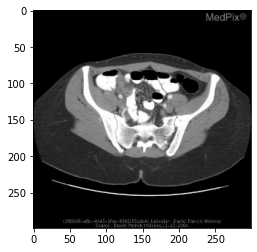

  0%|          | 1/1498 [00:13<5:25:15, 13.04s/it]

ORIGINAL ----------------
Modality: CT w/contrast (IV) Plane: Axial  Anatomy:
Gastrointestinal   Findings: dilated inflammed, nonfilling
appendix   Impression: Acute Appendicitis


AI GENERATED ------------
Modality: ct gi iv contrast plane axial  Anatomy:
gastrointestinal   Findings: supine abdominal film there is
a large amount of air and stool in the cecum with associated
large hyperdense contrast that is well circumscribed and the
intraperitoneal fluid level that are solid components no
calcium or adjacent structures to


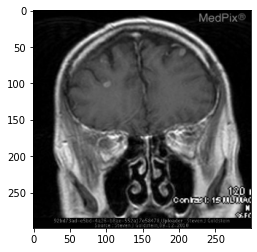

  0%|          | 2/1498 [00:26<5:30:04, 13.24s/it]

ORIGINAL ----------------
Modality: MR - T1W w/Gadolinium Plane: Coronal  Anatomy:
Brain and Neuro   Findings: •  Multiple cerebral and
cerebellar ring enhancing lesions most of which are
associated with restricted diffusion. •  Gyral enhancement
left frontal lobe.   Impression: Multifocal brain abscess,
septic emboli from endocarditis


AI GENERATED ------------
Modality: mr t1w wgadolinium plane coronal  Anatomy: brain
and neuro   Findings: • left frontal lobe mass  • mass has a
thick wall with calcifications  • there is no associated
vasogenic edema   Impression: papillary glioneuronal tumor
low grade


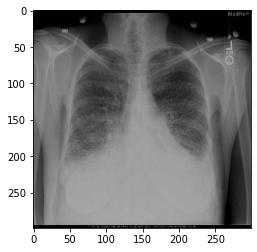

  0%|          | 3/1498 [00:39<5:29:15, 13.21s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: PA  Anatomy: Chest,
Pulmonary (ex. Heart)   Findings: PA and lateral chest
radiograph demonstrating diffuse reticulonodular opacities
(greatest in lower lung fields) with overlying bilateral
pleural effusions. Axial CT demonstrates thickened
interlobular and intralobular septa with diffuse nodular
opacities, resulting in the reticulonodular appearance on
conventional radiographs.   Impression: Amyloidosis


AI GENERATED ------------
Modality: xr plain film plane pa  Anatomy: chest pulmonary
ex heart   Findings: cxr prominent bilateral hila when
compared with prior cxr 5 months prior peripheral tapering
of pulmonary vasculature new airspace opacification superior
segment left lower lobe seen best on lateral view ct pedvt
large clot burden involving majority


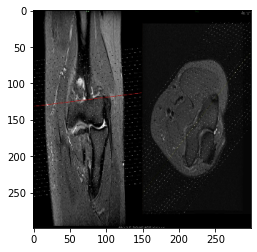

  0%|          | 4/1498 [00:52<5:26:09, 13.10s/it]

ORIGINAL ----------------
Modality: MR - T2 weighted Plane: Other View (see caption)
Anatomy: Multisystem   Findings: Figure 1: MRI Cervical
Spine C3-C4 level (sagittal and coronal views) W/O Contrast
HFO 25min (Multiplanar 3-T MR imaging of the cervical spine)
T2 weighted imaging  •       Subligamentous disc herniations
at C5-C6 and C6-C7 impressing on the thecal sac, with
borderline central spinal stenosis at C5-6 and mild central
spinal stenosis at C6-C7, encroaching mildly toward the left
neural foramen at C6-C7 with uncovertebral joint hypertrophy
•       Subligamentous disc herniations also associated with
C3-C4 and C4-C5 impressing on the thecal sac without
stenosis  •       C7-T1 disc bulging impressing on the
ventral thecal sac  •       Diffuse cervical straightening
with evidence for muscular spasm   Figure 2: MRI Cervical
Spine C4-C5 level (sagittal and coronal views) W/O Contrast
HFO 25min (Multiplanar 3-T MR imaging of the cervical spine)
T2 weighted imaging  •       Subli

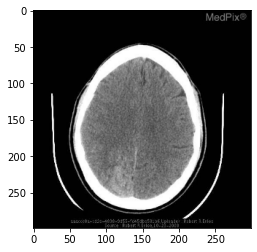

  0%|          | 5/1498 [01:05<5:24:18, 13.03s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Axial  Anatomy: Brain and
Neuro   Findings: •  Right occipital lesion •  Serpentine
hypointensities with surrounding edema •  Enlarged feeding
vessels from both PCA and MCA supply •  Small feeder from
the ACA •  Enlarged draining veins - varix -drains into
superior sagittal sinus   Impression: Arteriovenous
Malformation (AVM)


AI GENERATED ------------
Modality: ct noncontrast plane axial  Anatomy: brain and
neuro   Findings: noncontrast ct images demonstrate
effacement of the the sulci there is diffuse graying of the
cerebral hemispheres with blurring and loss of normal
graywhite differentiation and interface the ventricles are
small note that the cerebellum and brainstem are well


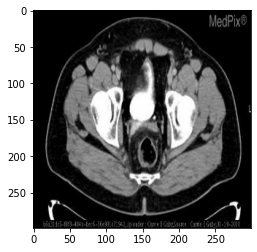

  0%|          | 6/1498 [01:18<5:22:47, 12.98s/it]

ORIGINAL ----------------
Modality: CT w/contrast (IV) Plane: Axial  Anatomy:
Genitourinary   Findings: •  CT urography shows an anterior
extension of the bladder lumen, without evidence of mass.  •
This "diverticulum" extends from the anterior bladder dome
to a small, fat containing, umbilical hernia.   Impression:
Vesico-urachal diverticulum


AI GENERATED ------------
Modality: ct gi iv contrast plane axial  Anatomy:
gastrointestinal   Findings: early studies demonstrate an
internal transmesenteric small bowel hernia without volvulus
or ischemia recent study demonstrate the whirl sign
indicating twisting of the bowel and hence volvulus no
evidence of intestinal ischemia or necrosis on ct no
submucosal enhancement


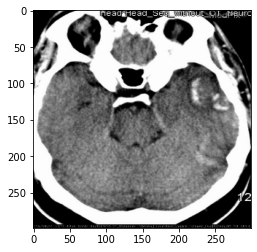

  0%|          | 7/1498 [01:31<5:25:52, 13.11s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Axial  Anatomy: Brain and
Neuro   Findings: Hematoma left temporal lobe. Thrombosis
left transverse and sigmoid sinus and jugular vein.
Impression: Acute dural venous sinus thrombosis (DVST),
secondary temporal lobe venous hemorrhagic infarction


AI GENERATED ------------
Modality: ct noncontrast plane axial  Anatomy: brain and
neuro   Findings: • acute bilateral cerebellar infarcts  •
acute right pontine infarct  • acute right temporaloccipital
lobe infarcts  • acute bilateral thalamic infarction artery
of percheron infarcts  • chronic infarct right basal ganglia
• wallerian degeneration right cerebral peduncle
Impression: basilar


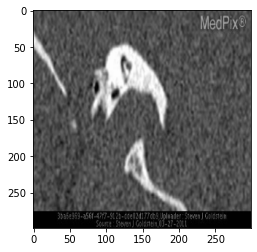

  1%|          | 8/1498 [01:44<5:25:08, 13.09s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Sagittal  Anatomy: Head
and Neck (ex. orbit)   Findings: •  Absence of the left otic
capsule. •  Small left petrous bone and mastoid process •
Small IAC •  High riding jugular bulb with bony dehiscence.
Impression: Labyrinthine Aplasia


AI GENERATED ------------
Modality: ct wcontrast iv plane axial  Anatomy: head and
neck ex orbit   Findings: water density mass in left floor
of mouth and submandibular space no peripheral enhancement
or capsule no inferior extension below submandibular space
into neck   Impression: simple ranula


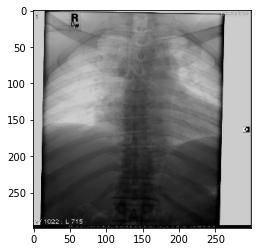

  1%|          | 9/1498 [01:57<5:23:52, 13.05s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: PA  Anatomy: Spine
Findings: -Plain radiograph one week later showed decreased
disk space between T10-T11   -On fat-suppressed MRI (STIR
and FSE T2-weighted with fat sat MRI), high-signal -ntensity
mass anterior to thoracic vertebrae, high signal intensity
in the disc space and in the thoracic vertebrae at this
level are consistent with infection. These areas enhance
after contrast on the contrast-enhanced fat-saturated
T1-weighted MR images.   Impression: Citrobacter koseri
osteomyelitis/discitis


AI GENERATED ------------
Modality: xr plain film plane pa  Anatomy: cardiovascular
inc heart   Findings: cxr the left side marker is present to
the right of the patient and the image has been inverted
there are multiple old healed rib fractures on the side
labeled left otherwise no abnormal   Findings: ct shows
there


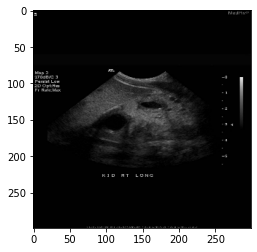

  1%|          | 10/1498 [02:10<5:22:21, 13.00s/it]

ORIGINAL ----------------
Modality: US - Ultrasound Plane: Sagittal  Anatomy:
Genitourinary   Findings: The right kidney demonstrates a
large dilated renal pelvis with increased cortical
echogenicity and loss of corticomedullary differentiation.
Innumerable cortical cysts are present within the kidney.
Not shown is a normal left kidney.   Impression: Right
kidney - multicystic dysplastic.  Left kidney - normal


AI GENERATED ------------
Modality: us ultrasound plane transverse  Anatomy:
genitourinary   Findings: 1 gallbladder is unremarkable no
sonographic murphys sign 2 the right kidney is normal in
size and contour with normal corticomedullary
differentiation the renal collecting system is decompressed
there are multiple hyperechoic foci within the medullary
pyramids the largest measuring approximately


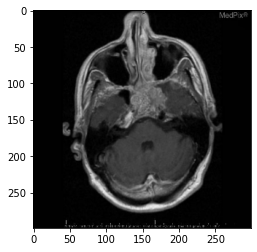

  1%|          | 11/1498 [02:23<5:23:41, 13.06s/it]

ORIGINAL ----------------
Modality: MR - T2 weighted Plane: Axial  Anatomy: Brain and
Neuro   Findings: •  Sphenoid base mass lesion •  Possible
invasion into the left cavernous sinus and Meckel Cave •  No
obvious brain parenchymal lesions   Impression: Sinonasal
Metastatic Melanoma


AI GENERATED ------------
Modality: mr t1w noncontrast plane axial  Anatomy: brain and
neuro   Findings: t1wi shows a low signal area centered in
the pons without enhancement on post gd t1wi sequence t2wi
shows increased sigal in the centered in the pons diffusion
weighted sequence also shows high t2 signal in the pons


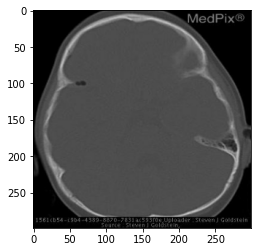

  1%|          | 12/1498 [02:36<5:22:20, 13.02s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Axial  Anatomy:
Ophthalmology   Findings: Key penetrating into right orbit
with extension into right anterior cranial fossa
Impression: Penetrating eye injury


AI GENERATED ------------
Modality: ct noncontrast plane axial  Anatomy: brain and
neuro   Findings: • narrow or fused right coronal suture  •
shallow right orbit with elevation of orbital roof
Impression: craniosynostosis coronal suture


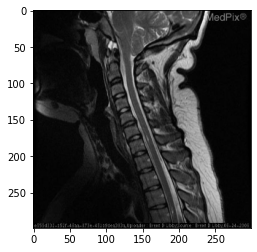

  1%|          | 13/1498 [02:49<5:20:39, 12.96s/it]

ORIGINAL ----------------
Modality: MR - T2 weighted Plane: Sagittal  Anatomy: Brain
and Neuro   Findings: The cerebellar tonsils extend
approximately 1 cm below the foramen magnum.  The visualized
posterior fossa appears normal in size.  There is increased
T2 signal and decreased T1 signal of the spinal cord,
particularly at the C7 and T4 vertebral body levels with
focal dilatation of the central canal, consistent with
syrinx.   Impression: Chiari I Malformation


AI GENERATED ------------
Modality: mr t1w noncontrast plane sagittal  Anatomy: spine
Findings: • paraspinal masses  • softtissue masses  • masses
are elongated or fusiform   Impression: neurofibromatosis1


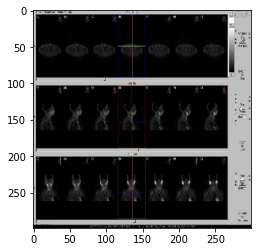

  1%|          | 14/1498 [03:02<5:20:29, 12.96s/it]

ORIGINAL ----------------
Modality: NM - Nuclear Medicine Plane: 3D Reconstruction
Anatomy: Endocrine (clinical)   Findings: • Tc-99m Sestamibi
parathyroid scintigraphy with single photon emission
computed tomography (SPECT): persistent foci of increased Tc
99m Sestamibi uptake in the right neck and left superior
mediastinum.  •  CT of the Thorax with IV Contrast:
corresponding hyperenhancing soft tissue nodules in the
right neck and left superior mediastinum.   Impression:
Parathyroid Hyperplasia


AI GENERATED ------------
Modality: nm nuclear medicine plane nos not specified
Anatomy: head and neck ex orbit   Findings: i123 24hour
thyroid uptake scan was performed the ct scan was performed
the ct the demonstrated the demonstrated the radiotracer was
subsequent patient was 8 fracture was a 3 months later it
following the


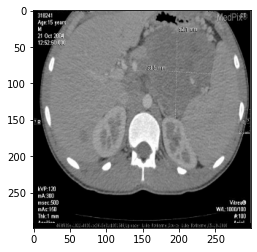

  1%|          | 15/1498 [03:15<5:19:27, 12.92s/it]

ORIGINAL ----------------
Modality: CT w/contrast (IV) Plane: Axial  Anatomy: Abdomen
- Generalized   Findings: Abdominal Ultrasound –
Hepatosplenomegaly, and 2 hypoechoic homogenous pelvic
masses with greatest diameters at 6cm and 4cm.   CT Abdomen
and Pelvis – Multiple soft tissue masses with the largest in
the region of the tail of the pancreas encasing the celiac
axis, the superior mesenteric artery, and the renal and
splenic vessels. Several lesions in the right lobe of the
liver and one lesion in the left lobe of the liver.
Impression: Desmoplastic Small Round Cell Tumor


AI GENERATED ------------
Modality: ct wcontrast iv plane axial  Anatomy:
genitourinary   Findings: • renal fusion or isthmus crossing
aorta at ima  • low position and malrotated anteriorly
directed renal pelvis  • enhancingfunctioning renal isthmus
Impression: renal ectopia with horseshoe kidney


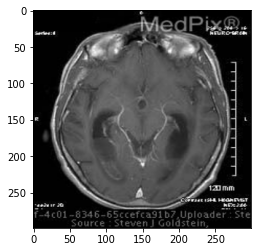

  1%|          | 16/1498 [03:28<5:21:08, 13.00s/it]

ORIGINAL ----------------
Modality: MR - T1W w/Gadolinium Plane: Axial  Anatomy: Brain
and Neuro   Findings: •  Multiple ring enhancing brain
lesions •  Enhancement of ventricular lining ependyma •
Debris layering in ventricles   Impression: Ruptured brain
abscess and pyocephalus


AI GENERATED ------------
Modality: mr t1w wgadolinium plane axial  Anatomy: brain and
neuro   Findings: • multiple bilateral brain lesions  • mri
infarcts of the lesions with are partially cystic and low
signal on t1 sequences  • t2 hyperintensity within the
lesion enhances with contrast with contrast   Impression:
lesions of bone infarcts


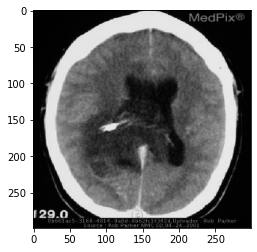

  1%|          | 17/1498 [03:41<5:20:51, 13.00s/it]

ORIGINAL ----------------
Modality: CT w/contrast (IV) Plane: Axial  Anatomy: Brain
and Neuro   Findings: Noncontrast head CT demonstrates a
large intraaxial mass which appears based in the right
parietal lobe then extends into the right lateral ventricle.
Some calcification is present.  Pathology from a brain
biopsy came back as a grade 2 astrocytoma.   Impression:
Astrocytoma, low-grade, supratentorial


AI GENERATED ------------
Modality: ct noncontrast plane axial  Anatomy: brain and
neuro   Findings: • ct hyperdense mass in the suprasellar
cistern  • angio giant right internal carotid terminus
aneurysm   Impression: giant aneurysm


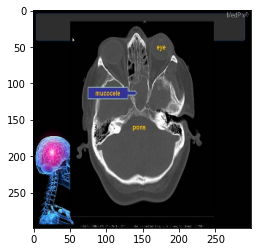

  1%|          | 18/1498 [03:54<5:20:18, 12.99s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Axial  Anatomy: Head and
Neck (ex. orbit)   Findings: CT Progressive destruction of
skull base with invasion of left cavernous sinus from
sphenoid sinus mass.  MRI  Mass is fluid intensity on all
scan sequences.   Impression: Sphenoid Mucocele and
Sinusitis


AI GENERATED ------------
Modality: ct noncontrast plane axial  Anatomy: brain and
neuro   Findings: noncontrast images demonstrate marked
swelling with herniation of fat attenuation in the entire
orbital region of the right maxillary sinus with a small
focus of increased t2 signal intensity on secondary to local
inflammatory changes   Impression: acute otomastoiditis
osteomyelitis


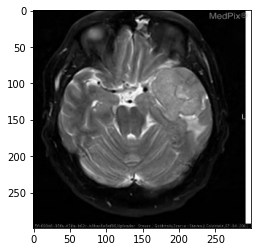

  1%|▏         | 19/1498 [04:07<5:19:13, 12.95s/it]

ORIGINAL ----------------
Modality: MR - T2 weighted Plane: Axial  Anatomy: Brain and
Neuro   Findings: •  CT: Hyperdense mass middle cranial
fossa. •  MRI: Enhancing mass with surrounding intraaxial
vasogenic edema, in the left middle cranial fossa
Impression: Meningioma


AI GENERATED ------------
Modality: mr t2 weighted plane axial  Anatomy: head and neck
ex orbit   Findings: • infiltrative mass centered in
sphenoid sinus with heterogeneous enhancement  • mass left
nasopharynx and peripherally  • mass contains fat and
compression on left  • mass extends through left orbital
apex   Impression: trigeminal schwannoma


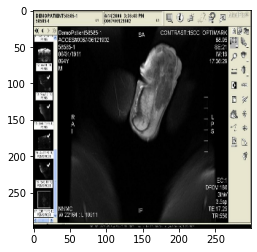

  1%|▏         | 20/1498 [04:20<5:18:30, 12.93s/it]

ORIGINAL ----------------
Modality: MR - T1W w/Gadolinium Plane: Coronal  Anatomy:
Genitourinary   Findings: On these T1 weighted post gad MRI
images an irregular mass of approx 5cm x 1.5 cm is visible
within the corpus spongiosum.  The mass appears of
intermediate signal intensity and is heterogeneous in
composition.  There is no definitive invasion into the
corpora cavernosa but the mass has indistinct margins and is
poorly circumscribed.  No lymphadenopathy is seen.
Impression: Urethral Cancer, Transitional Cell Carcinoma,
T2N0M0


AI GENERATED ------------
Modality: mr flair plane coronal  Anatomy: head and neck ex
orbit   Findings: mri neck axial and coronal and axial t1
post gadolinium images demonstrate a enhancing mass arising
from the posterior left lobe there is a separate mass in the
left frontal sinus which was heterogeneous in appearance ct


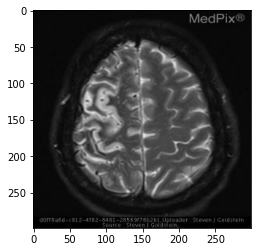

  1%|▏         | 21/1498 [04:33<5:20:09, 13.01s/it]

ORIGINAL ----------------
Modality: MR - FLAIR Plane: Axial  Anatomy: Brain and Neuro
Findings: •  CT- low density changes right frontal and
parietal lobes     no evidence of hemorrhage or
calcifications  •  CTA- dilated vessels without mass effect
indicative of a large, high flow shunt lesion  •  MRI-
Confirms AVM.  Also reveals diffusion and ADC findings
consistent with acute right MCA infarct.   Impression: AVM
with acute right MCA infarction


AI GENERATED ------------
Modality: mr t2 weighted plane axial  Anatomy: brain and
neuro   Findings: • ring enhancing lesion right frontal lobe
• surrounding vasogenic edema  • lesion has low signal
intensity rim on t2 sequences  • elevated signal intensity
within lesion on dwi images  • decreased signal on adc map
Impression: brain


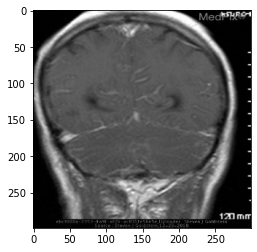

  1%|▏         | 22/1498 [04:46<5:18:56, 12.96s/it]

ORIGINAL ----------------
Modality: MR - T1W w/Gadolinium Plane: Coronal  Anatomy:
Generalized   Findings: •  Extensive abnormal enhancement of
the sulci and subarachnoid spaces overlying the cerebral
hemispheres and cerebellum •  Extensive deep white matter
changes •  Mild hydrocephalus   Impression: Secondary CNS
Lymphoma, subarachnoid spread (carcinomatous meningitis)


AI GENERATED ------------
Modality: mr t1w wgadolinium plane coronal  Anatomy: brain
and neuro   Findings: • 25 cm right parietal lobe mass with
very little enhancement following contrast administration  •
mass has high signal changes on t2 and flair sequences
Impression: oligodendroglioma who grade 2


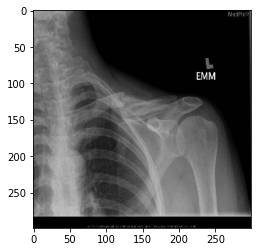

  2%|▏         | 23/1498 [04:59<5:18:12, 12.94s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: AP  Anatomy: MSK -
Musculoskeletal   Findings: Radiograph of the left clavicle
demonstrates a comminuted fracture with a butterfly fragment
of the mid-clavicle.   Impression: Butterfly fragment
subtype of comminuted fracture.


AI GENERATED ------------
Modality: xr plain film plane ap  Anatomy: msk
musculoskeletal   Findings: plain films of the right
shoulder and arm centrally located large expansile and lytic
lesion of the proximal humeral metaphysis and diaphysis
there is an intertrochanteric fracture   Impression: simple
bone cyst pathologic fracture


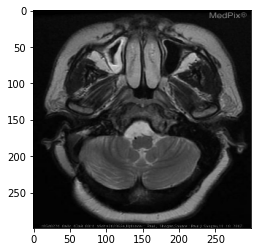

  2%|▏         | 24/1498 [05:11<5:16:59, 12.90s/it]

ORIGINAL ----------------
Modality: MR - T2 weighted Plane: Axial  Anatomy: Nerve,
central   Findings: Noncontrast CT:  The patient is status
post right suboccipital craniotomy.  There is a subtle area
of hypoattenuation off-midline to the right, anterior and
lateral to the pons.  Contrast enhanced CT demonstrates a
subtle area of nonenhancing hypoattenuation off-midline to
the right, anterior and lateral to the medulla.  MRI:
Sagittal T1-weighted FLAIR demonstrates expansion of the
prepontine cistern, and enlargement of the CSF space
anterior to the proximal cervical spinal cord and medulla,
with displacement of the medulla posteriorly.  This space
contains an extra-axial mass, demonstrating heterogeneous
signal intensity.  Coronal T2-weighted FLAIR demonstrates
heterogeneous signal intensity in the prepontine cistern.
Axial T1 weighted images demonstrates the prepontine cistern
extra-axial mass that is near CSF signal intensity with
enlargement of the pre-medullary cistern.  Axial T2

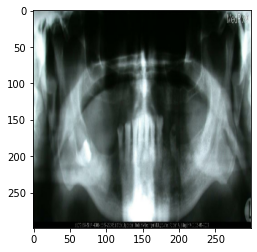

  2%|▏         | 25/1498 [05:25<5:21:09, 13.08s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: Frontal  Anatomy: Head and
Neck (ex. orbit)   Findings: Panorex (radiograph)
demonstrates a non-aggressive lucent focus at the left
mandibular angle; follow-up sialography reveals that the
left submandibular gland occupies the "lesion."
Impression: Stafne Bone Cavity


AI GENERATED ------------
Modality: xr plain film plane ap  Anatomy: gastrointestinal
Findings: supine radiograph of the abdomen demonstrates an
abnormal gas pattern with air in the stomach and two
additional dilated loops resembling a “triple bubble”
stomach dilated duodenum and air in the proximal small bowel
lack of pneumatosis or secondary signs


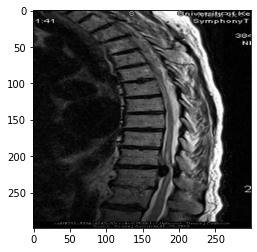

  2%|▏         | 26/1498 [05:38<5:22:46, 13.16s/it]

ORIGINAL ----------------
Modality: MR - T2 weighted Plane: Sagittal  Anatomy: Spine
Findings: Calcified extradural mass adjacent to the T10-11
disc space, compressing the spinal cord.  No enhancement of
the mass noted following contrast administration
Impression: Calcified and Herniated Thoracic Disc


AI GENERATED ------------
Modality: mr t2 weighted plane sagittal  Anatomy: spine
Findings: • spinal cord tethered to l34 level  • small
central spinal canal  • lower cord divided into two through
upper chest  • not shown  • ct of digital atelectasis and
two in a masses in the lower lobes  • ct


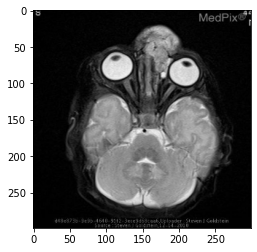

  2%|▏         | 27/1498 [05:52<5:25:13, 13.27s/it]

ORIGINAL ----------------
Modality: MR - T2 weighted Plane: Axial  Anatomy:
Generalized   Findings: •  Mass extending from base of left
frontal lobe through the left ethmoid sinuses and nose out
onto face •  Bilateral frontal lobe dysplasia with
polymicrogyria and subcortical heterotopia.   Impression:
Fronto-nasal encephalocele


AI GENERATED ------------
Modality: mr t2 weighted plane axial  Anatomy: brain and
neuro   Findings: mr images shows multiple masses in
fissures the axial axial ventricles together the frontal
horns of the lateral image of the brain demonstrating large
midline sagittal image a thin region of the vessel
suprasellar and proximal small artery


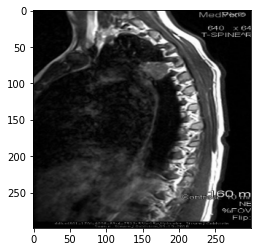

  2%|▏         | 28/1498 [06:05<5:23:14, 13.19s/it]

ORIGINAL ----------------
Modality: MR - T1W - noncontrast Plane: Sagittal  Anatomy:
Spine   Findings: Well circumscribed mass adjacent to left
T3-4 vertebral disk. No involvement of the neural foramen or
spinal canal.  No bone erosion.  Mass enhances following
contrast.   Impression: Schwannoma, Paraspinal


AI GENERATED ------------
Modality: us ultrasound plane sagittal  Anatomy:
genitourinary   Findings: multiple small cystic masses which
do not enhance with contrast demonstrates signal intensity
on contrast with multiple calcified sequences and nodules
Impression: autosomal dominant cysts on the left the cysts


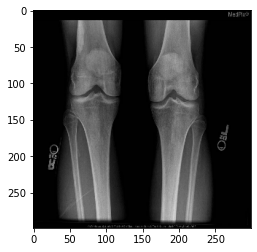

  2%|▏         | 29/1498 [06:18<5:21:31, 13.13s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: AP  Anatomy: MSK -
Musculoskeletal   Findings: No acute osseous findnigs. A
non-aggressive, geographic, densly sclerotic lesion is
present on the lateral aspect of the right femoral
metaphysis. There is no associated soft tissue mass or
periosteal reaction.   Impression: Healing, Nonossifying
fibroma


AI GENERATED ------------
Modality: xr plain film plane ap  Anatomy: msk
musculoskeletal   Findings: plain films of the right fibula
demonstrate smooth cortical thickening at the distal femur
and proximal to left femur   Impression: stress fracture


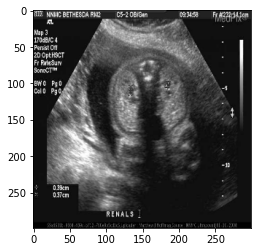

  2%|▏         | 30/1498 [06:31<5:22:18, 13.17s/it]

ORIGINAL ----------------
Modality: US - Ultrasound Plane: Transverse  Anatomy:
Genitourinary   Findings: Images from 16 SEP 2003
demonstrate renal pelvis dilatation to approximately 7mm in
AP dimension bilaterally.  Normal appearing renal parenchyma
and bladder.  Normal amniotic fluid volume.    Follow up
sonogram on 17 OCT 2003 demonstrate interval decrease in the
renal pelvis dimension to a less significant measurement of
4mm bilaterally.  Follow up exam on 23 DEC 2003 demonstrate
marked worsening of renal pelvis size.  Current measurements
up to 14mm bilaterally. Additionally there is calyceal
dilatation bilaterally. The renal parenchyma remained normal
however.  No cortical atrophy identified. The bladder is
also dilated and did not empty during the exam, which took
over 1.5 hours to complete and fully evaluate with staff
review.  The bladder wall was not particularly thickened on
this exam.  The distal ureters are dilated bilaterally.
There was a relative oligohydramnios seen dur

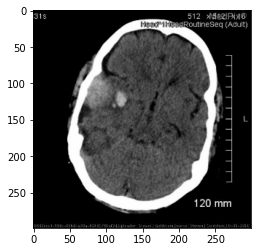

  2%|▏         | 31/1498 [06:44<5:21:21, 13.14s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Axial  Anatomy: Brain and
Neuro   Findings: •  CT - Right middle middle cranial fossa
epidural hematoma and small temporal lobe hematoma  •  CTA -
grape like contrast collection within epidural hematoma -
"spot sign"?  •  Angiogram - 1.5cm aneurysm arising from the
right  middle meningeal artery   Impression: Middle
Meningeal Artery Aneurysm, Ruptured


AI GENERATED ------------
Modality: ct noncontrast plane axial  Anatomy: brain and
neuro   Findings: • ct right frontal lobe hematoma  • cta
fluid collection behind rt temporal flow voids consistent
with right parietal area  • ct  • cta enhancing mass in same
location   Impression: developmental venous anomaly dva and
associated fracture


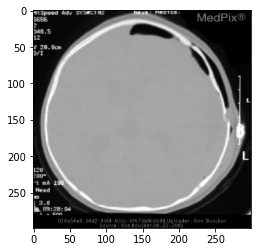

  2%|▏         | 32/1498 [06:57<5:20:37, 13.12s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Axial  Anatomy: Brain and
Neuro   Findings: •  Biconvex hyperattenuating extraaxial
mass over left hemisphere •  Skull Fracture •  Intracranial
Air (after craniotomy?)   Impression: Skull Fracture with
Epidural Hematoma


AI GENERATED ------------
Modality: ct noncontrast plane axial  Anatomy: brain and
neuro   Findings: • depressed skull fracture secondary to
dog bite  • minimal amount of subarachnoid blood  •
rightsided pneumothorax   Impression: depressed skull
fractures


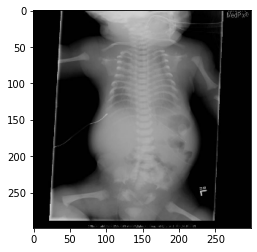

  2%|▏         | 33/1498 [07:10<5:19:41, 13.09s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: Frontal  Anatomy: MSK -
Musculoskeletal   Findings: Long narrow chest and relatively
short ribs (Image 1) Anterior aspects of the ribs are
bulbous and irregular (Image 1) Clavicles have a handlebar
configuration (Image 1)  Pelvis is small with short flared
iliac bones (Image 2) Capital femoral ossification centers
not present (Image 2) Long bones appear relatively shortened
(Image 2)  Exaggerated lumbar lordosis noted (Image 3)
Impression: Jeune Syndrome (Asphyxiating Thoracic Dystrophy)


AI GENERATED ------------
Modality: xr plain film plane ap  Anatomy: gastrointestinal
Findings: supine radiograph of the abdomen demonstrates an
abnormal gas pattern with air in the stomach and two
additional dilated loops resembling a “triple bubble”
stomach dilated duodenum and air in the proximal small bowel
lack of pneumatosis or secondary signs


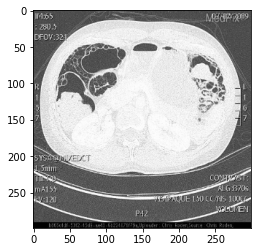

  2%|▏         | 34/1498 [07:23<5:20:16, 13.13s/it]

ORIGINAL ----------------
Modality: CT w/contrast (IV) Plane: Axial  Anatomy:
Gastrointestinal   Findings: Markedly abnormal appearance of
the majority of the colon consistent with pneumatosis
intestinalis.  Multiple cystic lucencies are present
diffusely within the colonic wall with sparing of the distal
descending and distal transverese colon.  Cystic changes are
most pronounced at the hepatic and splenic flexures.
Impression: Pneumatosis cystoides coli


AI GENERATED ------------
Modality: ct noncontrast plane axial  Anatomy: spine
Findings: • chest radiograph fig 1 demonstrates an oval
shaped lobulated mass at the left t1 mri t1 hypointense t2
hyperintense and adjacent to the inferior septal t2
hypointense level lobe lesion in the spinal canal with
gadolinium enhancement and a small


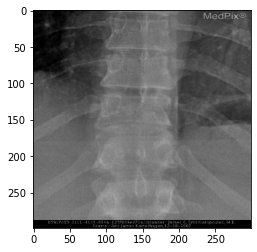

  2%|▏         | 35/1498 [07:36<5:18:59, 13.08s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: PA  Anatomy: Spine
Findings: Chance Fracture through T11   Impression: Chance
Fracture


AI GENERATED ------------
Modality: xr plain film plane ap  Anatomy: spine   Findings:
lumbar spine appears to be completely fused through the
anterior spinal ligament sacroiliac articulations appear to
be fused diffuse sclerosis and fusion is seen throughout the
facet joints   Findings: consistent with ankylosing
spondylosis sacroiliac joints bilateral fusion consistent
with ankylosing


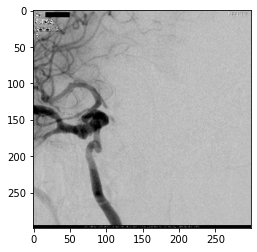

  2%|▏         | 36/1498 [07:49<5:17:00, 13.01s/it]

ORIGINAL ----------------
Modality: AN - Angiogram Plane: Oblique  Anatomy: Brain and
Neuro   Findings: MRI-- proptosis on the right with enlarged
superior opthalmic vein and extraoccular muscles especially
the superior rectus and lateral rectus muscles.
Impression: Carotid Cavernous Fistula


AI GENERATED ------------
Modality: an angiogram plane ap  Anatomy: brain and neuro
Findings: • acute right frontal lobe infarct  • focal
stenosis right mca superior division  • occlusion left mca
m1 segment   Impression: moyamoya


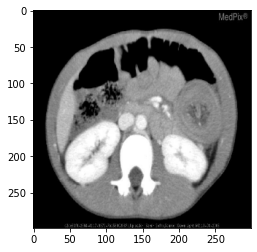

  2%|▏         | 37/1498 [08:03<5:18:27, 13.08s/it]

ORIGINAL ----------------
Modality: CT - GI Contrast Plane: Axial  Anatomy:
Gastrointestinal   Findings: Plain radiograph: show
distended loops of bowel in the region of ascending and
transverse colon. No air is visible in left colon and
rectum.  Longitudinal ultrasound: shows submarine sandwich-
like appearance of the intussuscipiens and the
intussusceptum.  Transverse ultrasound: shows a mass with a
loop-within-a-loop.  CT scan of the abdomen shows classic
“target sign” Air enema shows  intussusceptum in mid
descending colon and lead point proximal to splenic
flexture.  Colonoscopy: identified a large juvenile polyp.
Impression: Colo-colic intussusception


AI GENERATED ------------
Modality: ct gi iv contrast plane axial  Anatomy:
gastrointestinal   Findings: pancreatic head mass mass w
pancreatic ductal dilatation   Impression: pancreatic
adenocarcinoma


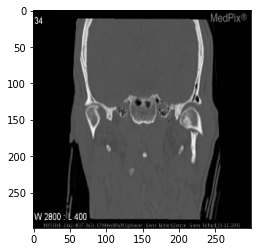

  3%|▎         | 38/1498 [08:15<5:16:48, 13.02s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Coronal  Anatomy: MSK -
Musculoskeletal   Findings: Left mandibular subcondylar
fracture with medial subluxation and angulation of condylar
fracture fragment.   Impression: Mandibular Fracture


AI GENERATED ------------
Modality: ct noncontrast plane coronal  Anatomy: head and
neck ex orbit   Findings: ct showed round hollow structure
in inferior portion of middle ear consistent with size and
shape of pe tube   Impression: medial migration of pe
tympanostomy tube


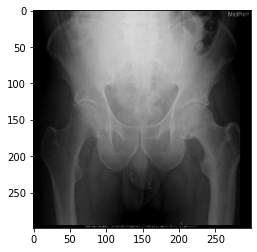

  3%|▎         | 39/1498 [08:29<5:17:58, 13.08s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: AP  Anatomy: MSK -
Musculoskeletal   Findings: Marked sclerosis and enlargement
of the proximal left femur.  No apparent involvement of the
pelvis.   Impression: Paget Disease


AI GENERATED ------------
Modality: xr plain film plane ap  Anatomy: msk
musculoskeletal   Findings: ap and frogleg radiographs of
the hips demonstrate asymmetric sclerosis in the articular
space mri of the medial aspect of the femoral neck as well
as a mixed sclerotic and a vertical line effusion is a
compressive mass that


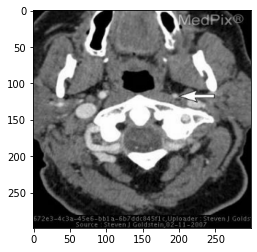

  3%|▎         | 40/1498 [08:42<5:17:56, 13.08s/it]

ORIGINAL ----------------
Modality: CT w/contrast (IV) Plane: Axial  Anatomy: Brain
and Neuro   Findings: Occlusion of the left Common carotid
artery in the neck, proximal to the bifurcation.  Flow is
preserved in the ipsilateral ICA from collateral flow via
the contralateral external carotid branches and ipsilateral
muscular branches of the left vertebral artery.  The
ipsilateral ICA is quite small (string sign) due to low flow
and diminshed pressure in the vessel.   Impression: Common
Carotid Occlusion with preservation of ipsilateral flow in
the ICA


AI GENERATED ------------
Modality: ct wcontrast iv plane axial  Anatomy: head and
neck ex orbit   Findings: bilateral bulky cervical
lymphadenopathy involving nodal chains 2 through 5 nodes
were necrotic with central hypoattenuation and a thick
shaggy rim of enhancement both discrete and confluent matted
nodes apparent   Impression: scrofula infectious cervical
lymphadenitis caused


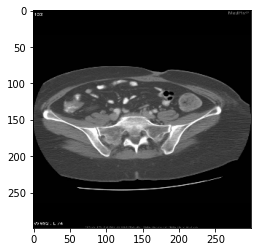

  3%|▎         | 41/1498 [08:55<5:16:29, 13.03s/it]

ORIGINAL ----------------
Modality: CT - GI & IV Contrast Plane: Axial  Anatomy:
Gastrointestinal   Findings: Enlargement of the appendix
filled with low attenuation material (mucous) without
evidence of surrounding inflammatory changes   Impression:
Mucocele of the appendix


AI GENERATED ------------
Modality: ct gi iv contrast plane axial  Anatomy:
gastrointestinal   Findings: ct images demonstrate an
enlarged fluid filled enhancing appendix with
periappendiceal fat stranding small foci of extraluminal air
and a small fluid collection are present   Impression:
ruptured appendicitis


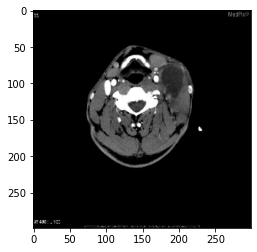

  3%|▎         | 42/1498 [09:08<5:15:19, 12.99s/it]

ORIGINAL ----------------
Modality: CT w/contrast (IV) Plane: Axial  Anatomy: Head and
Neck (ex. orbit)   Findings: Contrast enhanced neck CT
demonstrates a large, fluid-attenuation mass anteriomedial
to the anterior margin of the left sternocleidomastoid
muscle, lateral to the carotid vessels. Minimal rim
enhancement.  No associated solid components.   Impression:
Second branchial cleft cyst


AI GENERATED ------------
Modality: ct wcontrast iv plane axial  Anatomy: head and
neck ex orbit   Findings: ct of the neck demonstrates medial
aspect of the left submandibular gland   Impression:
sialolithiasis


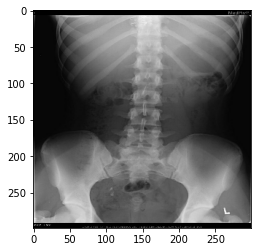

  3%|▎         | 43/1498 [09:20<5:14:14, 12.96s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: PA  Anatomy: Genitourinary
Findings: Radiograph of the abdomen demonstrates tooth-like
calcifications in the right hemipelvis.  Bowel gas pattern
is unremarkable. Normal osseous structures. No organomegaly.
Ultrasound demonstrates a mass in the right adenexa
demonstrating a fluid-fluid level with solid components of
mixed echogenicity.  No definitive calcification is
demonstrated.  Mixed shadowing is present.   Impression:
Dermoid Cyst


AI GENERATED ------------
Modality: xr plain film plane ap  Anatomy: gastrointestinal
Findings: supine radiograph of the abdomen demonstrates an
abnormal gas pattern with air in the stomach and two
additional dilated loops resembling a “triple bubble”
stomach dilated duodenum and air in the proximal small bowel
lack of pneumatosis or secondary signs


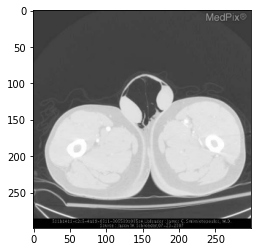

  3%|▎         | 44/1498 [09:33<5:14:13, 12.97s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Axial  Anatomy:
Genitourinary   Findings: Pnsuemoscrotum (air in scrotal
sac) is present, as well as diffuse subcutaneous emphysema
extending along the patient's entire left side.  Numerous
left-sided rib fractures, left-sided pneumothorax and chest
tube are present (not shown).   Impression: Pneumoscrotum


AI GENERATED ------------
Modality: ct noncontrast plane axial  Anatomy: msk
musculoskeletal   Findings: ap radiograph of the pelvis and
abdomen shows an abnormal contrast reveals a rounded area of
increased density at the medial aspect of the right femoral
neck as well as a mixed sclerotic density lesion is present
through the left


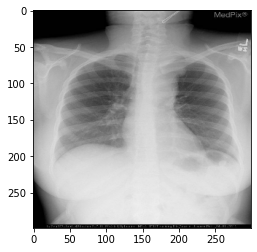

  3%|▎         | 45/1498 [09:46<5:12:10, 12.89s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: PA  Anatomy: Chest,
Pulmonary (ex. Heart)   Findings: •  Anterior (superior)
mediastinal mass, surrounding the great vessels and aortic
arch.   Impression: Nodular Sclerosing Hodgkin’s Lymphoma


AI GENERATED ------------
Modality: xr plain film plane pa  Anatomy: chest pulmonary
ex heart   Findings: cxr prominent bilateral hila when
compared with prior cxr 5 months prior peripheral tapering
of pulmonary vasculature new airspace opacification superior
segment left lower lobe seen best on lateral view ct pedvt
large clot burden involving majority


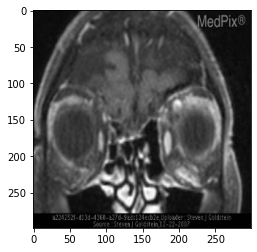

  3%|▎         | 46/1498 [09:59<5:11:29, 12.87s/it]

ORIGINAL ----------------
Modality: MR - T1W w/Gadolinium Plane: Coronal  Anatomy: Eye
and Orbit (exclude Ophthalmology)   Findings: •  Enlarged
left superior opthalmic vein •  Mild enlargement of extra-
ocular muscles on left •  Mild vascular distention of
intraconal veins. •  No bulging of left cavernous sinus.
Impression: Indirect carotid-cavernous  fistula


AI GENERATED ------------
Modality: mr t1w wgd fat suppressed plane axial  Anatomy:
head and neck ex orbit   Findings: • plain neck axial ct
demonstrates a prominence of the soft tissues and ramus
thickening of the right maxillary sinus and nose
Impression: rupture of the right maxillary sinus acute right
frontal sinus


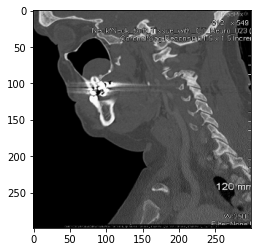

  3%|▎         | 47/1498 [10:12<5:12:01, 12.90s/it]

ORIGINAL ----------------
Modality: CT w/contrast (IV) Plane: Sagittal  Anatomy: Head
and Neck (ex. orbit)   Findings: Domed shape mass in the
left maxillary sinus.  The mass is homogeneous in
attenuation, has smooth margins and does not erode nor
penetrate the sinus wall.   Impression: Mucus Rentention
Cyst


AI GENERATED ------------
Modality: ct noncontrast plane sagittal  Anatomy: spine
Findings: • prevertebral soft tissue hematoma  • fracture
through the left c4 lateral mass and laminar arch with
unilateral perched c45 facets on the right  • herniated and
disrupted disk c45 facets with some disrupted disk c45
facets on the c56 level


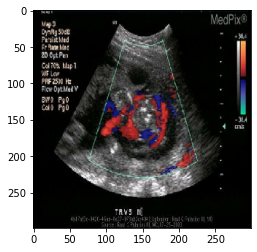

  3%|▎         | 48/1498 [10:25<5:12:04, 12.91s/it]

ORIGINAL ----------------
Modality: US - Ultrasound Plane: Multiple or Montage
Anatomy: Risk   Findings: OB ultrasound examination of the
c-spine demonstrates multiple loops of fetal cord around the
fetal neck.  The rest of the anatomy scan is WNL. A four
chambered heart was seen beating at 150 BPM.  All limbs are
moving and grosely normal on inspection.   Impression: Fetal
Nuchal Cords


AI GENERATED ------------
Modality: us ultrasound plane transverse  Anatomy:
genitourinary   Findings: on the ta images a normal
appearing uterus is visualized with a small amount of fluid
present within the endometrial canal representing a
pseudogestational sac on the tv images a theca lutein cyst
is seen within the left ovary and a


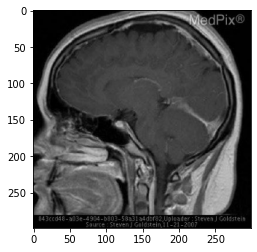

  3%|▎         | 49/1498 [10:38<5:11:21, 12.89s/it]

ORIGINAL ----------------
Modality: MR - T1W w/Gadolinium Plane: Sagittal  Anatomy:
Brain and Neuro   Findings: Marked distension of deep venous
sinuses as well as spinal epidural veins.  The deep veins
are rounded in configuration and engorged.  Prominent
enhancement of dura.  No downward displacement of brainstem
or drooping of chiasm   Impression: Intracranial hypotension


AI GENERATED ------------
Modality: mr t1w wgadolinium plane sagittal  Anatomy: brain
and neuro   Findings: • 25 cm right parietal lobe mass with
very little enhancement following contrast administration  •
mass has high signal changes on t2 and flair sequences
Impression: oligodendroglioma who grade 2


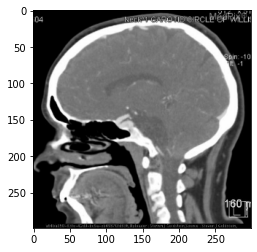

  3%|▎         | 50/1498 [10:51<5:11:38, 12.91s/it]

ORIGINAL ----------------
Modality: CTA - CT Angiography Plane: Sagittal  Anatomy:
Brain and Neuro   Findings: •  CTA--low density mass right
CPA cistern •  MRI-- Right CPA cistern mass compressing pons
and medulla.  The mass has CSF signal intensity on all scan
sequences - except DWI and FLAIR imaging.   Impression:
Epidermoid Brain Tumor


AI GENERATED ------------
Modality: cta ct angiography plane sagittal  Anatomy: brain
and neuro   Findings: • acute right frontal lobe infarct  •
focal stenosis right mca superior division  • occlusion left
mca m1 segment   Impression: moyamoya


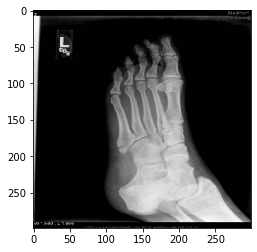

  3%|▎         | 51/1498 [11:04<5:11:17, 12.91s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: Other View (see caption)
Anatomy: MSK - Musculoskeletal   Findings: Multiple
radiographic views of the left foot demonstrate a minimally
displaced transverse fracture through the base of the fifth
metatarsal with intra-articular extension to the most
proximal aspect of the metatarsocuboid joint.  Soft tissue
swelling is noted overlying the fracture site.  No other
abnormalities are detected.   Impression: Avulsion fracture
of the base of the fifth metatarsal


AI GENERATED ------------
Modality: xr plain film plane oblique  Anatomy: msk
musculoskeletal   Findings: 11310 right ankle 3 views
Findings: the ankle mortise is symmetric without evidence of
degenerative change or focal osteochondral lesion of the
talar dome with focal abnormality the adjacent fracture or
dislocation and no evidence of fracture for age


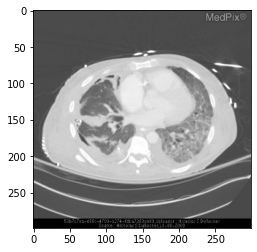

  3%|▎         | 52/1498 [11:16<5:10:31, 12.88s/it]

ORIGINAL ----------------
Modality: CT - GI & IV Contrast Plane: Axial  Anatomy:
Chest, Pulmonary (ex. Heart)   Findings: An air-fluid level
in the right hemithorax, with marked atelectasis of the
right lung.   Impression: Pyopneumothorax


AI GENERATED ------------
Modality: ct wcontrast iv plane axial  Anatomy: chest
pulmonary ex heart   Findings: cxr bilateral r>l hilar
enlargement and pleural thickening ct chunky calcification
of mediastinal nodes pleural nodules and interstitial
thickening in upper lobes   Impression: pulmonary
sarcoidosis


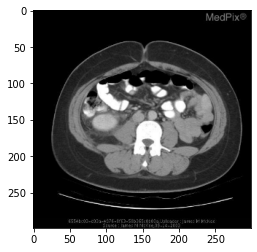

  4%|▎         | 53/1498 [11:29<5:11:46, 12.95s/it]

ORIGINAL ----------------
Modality: CT w/contrast (IV) Plane: Axial  Anatomy:
Genitourinary   Findings: Contrast enhanced CT of the
abdomen revealed mildly enlarged right kidney with bluring
of the renal capsule/perirenal fat interface, stranding of
the perirenal fat, and striated nephrogram.   Impression:
Acute Pyelonephritis (pyuria with positve culture for E.
Coli).


AI GENERATED ------------
Modality: ct gi iv contrast plane axial  Anatomy:
gastrointestinal   Findings: fluid filled dialated appendix
>7mm containing an intraluminal calcified density with
associated pericecal and periappendiceal fluidinflammatory
changes   Impression: acute appendicitis


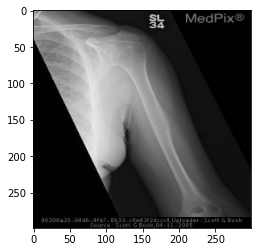

  4%|▎         | 54/1498 [11:42<5:09:47, 12.87s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: Frontal  Anatomy: MSK -
Musculoskeletal   Findings: An intramuscular lesion is seen
in the medial head of the triceps with intermediate signal
intensity with slightly higher than muscle signal on T1
sequences with very high signal on T2 sequences with central
areas of low signal consistent with flow voids. Post
gadolinium sequences demonstrate serpentine vascular
pattern. Images of the shoulder demonstate a similar lesion
in the subcutaneous fat over the rotator cuff.   Impression:
Intramuscular Hemangioma


AI GENERATED ------------
Modality: xr plain film plane ap  Anatomy: msk
musculoskeletal   Findings: plain films of the right
shoulder and arm centrally located large expansile and lytic
lesion of the proximal humeral metaphysis and diaphysis
there is an intertrochanteric fracture   Impression: simple
bone cyst pathologic fracture


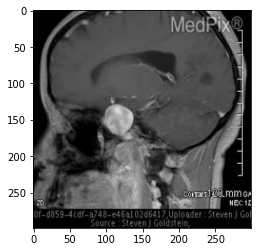

  4%|▎         | 55/1498 [11:55<5:08:21, 12.82s/it]

ORIGINAL ----------------
Modality: MR - T1W - noncontrast Plane: Sagittal  Anatomy:
Generalized   Findings: •  5 cm right Cavernous Internal
Carotid Artery Aneurysm •  1.5 cm left Cavernous Internal
Carotid Artery Aneurysm   Impression: Giant intracranial
aneurysm


AI GENERATED ------------
Modality: mr t1w wgadolinium plane sagittal  Anatomy: brain
and neuro   Findings: • multiple bilateral cerebral infarcts
of varying ages and sizes  • acute infarcts in the right
frontal lobe  • absent flow in the distal ica mca and aca
vessels   Impression: moyamoya


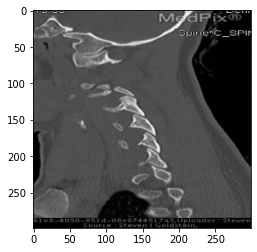

  4%|▎         | 56/1498 [12:08<5:07:33, 12.80s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Sagittal  Anatomy: Spine
Findings: •  Hypoplastic right pedicle at C3. •  Dysmorphic
lateral mass and facet joint at C3 on right. •  Incomplete
fusion posterior arch of C3.   Impression: Hypoplastic
Cervical pedicle C3 on right


AI GENERATED ------------
Modality: ct noncontrast plane sagittal  Anatomy: head and
neck ex orbit   Findings: • longitudinal fracture passing
through anterior wall of external auditory canal into tmj  •
the fracture extends along the floor of the middle cranial
fossa into the sphenoid sinus   Impression: longitudinal
petrous temporal bone fracture


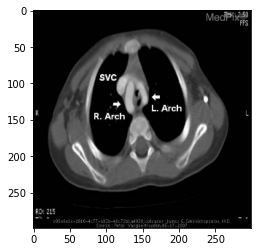

  4%|▍         | 57/1498 [12:21<5:09:39, 12.89s/it]

ORIGINAL ----------------
Modality: CT w/contrast (IV) Plane: Axial  Anatomy: Chest,
Pulmonary (ex. Heart)   Findings: •  The patient has a
double aortic arch with mild right-arch dominance in size
(right arch 8 mm left arch 6 mm diameter).  •  There is
resulting mass-effect on the trachea where the trachea
narrows to 3.5 mm.  •  There is posterior mass-effect on the
esophagus with resulting dilation of the more proximal
esophagus. The distal esophagus is also dilated and courses
slightly to the left of the aorta.  •  The right carotid
artery and right subclavian artery originate separately from
the right arch while the left carotid artery and left
subclavian artery have separate origins from the left arch.
•  The descending aorta travels just to the right of midline
and then midline more inferiorly.   Impression: Double
Aortic Arch


AI GENERATED ------------
Modality: ct wcontrast iv plane axial  Anatomy: head and
neck ex orbit   Findings: the right maxillary sinus
demonstrates a bon

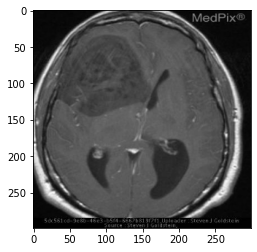

  4%|▍         | 58/1498 [12:34<5:09:53, 12.91s/it]

ORIGINAL ----------------
Modality: MR - T1W w/Gadolinium Plane: Axial  Anatomy: Brain
and Neuro   Findings: Large complex, partially cystic mass
in the right frontal lobe and temporal lobe.  Minimal
enhancement following contrast.   Impression: Gemistocytic
Astrocytoma


AI GENERATED ------------
Modality: mr t1w wgadolinium plane axial  Anatomy: brain and
neuro   Findings: large complex partially cystic mass in the
right frontal lobe minimal enhancement of mass   Impression:
papillary glioneuronal tumor


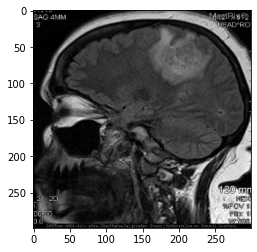

  4%|▍         | 59/1498 [12:46<5:08:29, 12.86s/it]

ORIGINAL ----------------
Modality: MR - FLAIR Plane: Sagittal  Anatomy: Brain and
Neuro   Findings: 3 cm irregular enhancing lesion with
central necrosis right parietal lobe.  There was dramatic
growth of the lesion in 3 months between the serial MR scans
Impression: Glioblastoma multiforme, GBM


AI GENERATED ------------
Modality: mr t1w noncontrast plane sagittal  Anatomy: brain
and neuro   Findings: • ct right frontal lobe hematoma  •
cta fluid collection behind rt transverse sinus  • cta
dilated feeding arteries especially left pca  • enlarge
draining veins and mastoid air cells   Impression:
arteriovenous malformation vascular malformation


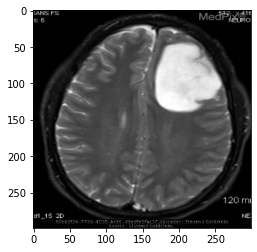

  4%|▍         | 60/1498 [12:59<5:06:35, 12.79s/it]

ORIGINAL ----------------
Modality: MR - T2 weighted Plane: Axial  Anatomy: Brain and
Neuro   Findings: •  5 cm left frontal lobe mass. •
Internal structure noted. •  Low SI on T1 and high SI on T2
scans. •  No enhancement following contrast.   Impression:
Fibrillary astrocytoma, WHO Grade 2 to 3


AI GENERATED ------------
Modality: mr t2 weighted plane axial  Anatomy: brain and
neuro   Findings: • ring enhancing lesion right frontal lobe
• surrounding vasogenic edema  • lesion has low signal
intensity rim on t2 sequences  • elevated signal intensity
within lesion on dwi images  • decreased signal on adc map
Impression: brain


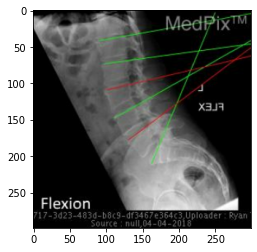

  4%|▍         | 61/1498 [13:12<5:05:21, 12.75s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: Lateral  Anatomy: Spine
Findings: Figure 1 AP Cervical Spine X-Ray  No evidence of
acute compression fractures.   Figure 2 Neutral Lateral
Cervical Spine X-Ray  Mild end plate spurring and minor disc
space narrowing can be seen at C3-C4, C4-C5, and C5-C6. No
evidence of acute compression fractures.   Figure 3 Flexion
Lateral Cervical Spine X-Ray   No evidence of acute
compression fractures. There is no evidence of induced
malalignment.   Figure 4 Extension Lateral Cervical Spine
X-Ray  No evidence of acute compression fractures. There is
no evidence of induced malalignment.   Figure 5 C4-C5
Cervical Spine T2 MRI  Right discopathy/bulge of nucleus
pulposus at the C4-C5 vertebral level (green arrows).
Figure 6 C5-C6 Cervical Spine T2 MRI  Right paramedian
herniation of nucleus pulposus protruding into the thecal
sac (yellow arrow). CIS lesions can be seen in the sagittal
view (yellow circles).   Figure 7 C6-C7 Cervical Spine T2
M

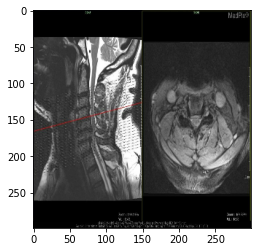

  4%|▍         | 62/1498 [13:25<5:06:34, 12.81s/it]

ORIGINAL ----------------
Modality: MR - T2 weighted Plane: Sagittal  Anatomy: Nerve,
central   Findings: MRI Cervical Spine:  - At C2-C3 there is
small central disc herniation slightly indenting the thecal
sac.  - At C3-C4 there is advanced disc space narrowing and
a spondylosis with end plate osteophytes. There is a dorsal
osteophyte and moderate central disc herniation resulting in
cord impingement. Both the ventral and dorsal subarachnoid
space are effaced. There is moderate bilateral foraminal
stenosis.  - At C4-C5 there is advanced spondylosis and disc
space narrowing with a dorsal bony ridge and moderate broad
based central disc herniation with cord impingement. There
is moderate bilateral foraminal stenosis.  - At C5-C6 there
is more advanced spondylosis and disc space narrowing with a
dorsal osteophyte and disc herniation. There is
retrolisthesis. This results in more severe spinal stenosis
with cord compression. The ventral and dorsal subarachnoid
space are effaced and the co

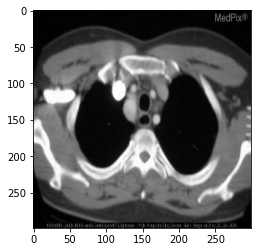

  4%|▍         | 63/1498 [13:37<5:05:47, 12.79s/it]

ORIGINAL ----------------
Modality: CT w/contrast (IV) Plane: Axial  Anatomy:
Cardiovascular (inc. Heart)   Findings: AP view of an
esophogram demonstrates a convex impression on the right
with a smaller convexity inferiorly on the left.  Lateral
view of an esophogram demonstrates a posterior extrinsic
impression on the esophagus.  Serial contrast enhanced axial
images of the aortic arch demonstrates a dominant aortic
arch with its respective subclavian artery and common
carotid artery.  There is extrinsic compression on the
posterolateral wall of the esophagus by the left aortic
arch.   Impression: Double Aortic Arch


AI GENERATED ------------
Modality: ct wcontrast iv plane axial  Anatomy:
cardiovascular inc heart   Findings: ovoid mass lying behind
the associated with mri at t5 level of the frontal bone
metastatic to the aorta   Impression: aortic arch with
aberrant right subclavian artery


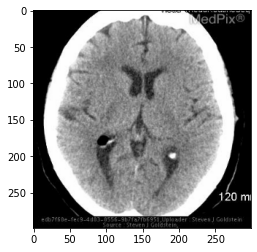

  4%|▍         | 64/1498 [13:50<5:05:31, 12.78s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Axial  Anatomy: Brain and
Neuro   Findings: •  Lipoma choroid plexus glomerula on
right. •  Lipoma hyperintense on T1 and hypointense on T2
sequences. •  Lipoma measures -92 CT units   Impression:
Choroid Plexus Lipoma


AI GENERATED ------------
Modality: ct noncontrast plane axial  Anatomy: brain and
neuro   Findings: • acute bilateral cerebellar infarcts  •
acute right pontine infarct  • acute right temporaloccipital
lobe infarcts  • acute bilateral thalamic infarction artery
of percheron infarcts  • chronic infarct right basal ganglia
• wallerian degeneration right cerebral peduncle
Impression: basilar


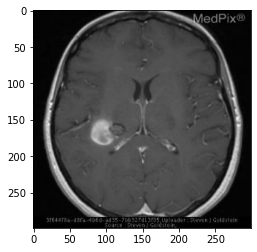

  4%|▍         | 65/1498 [14:03<5:05:27, 12.79s/it]

ORIGINAL ----------------
Modality: MR - T1W w/Gadolinium Plane: Axial  Anatomy: Brain
and Neuro   Findings: •  CT: acute (hyperdense) right basal
ganglionic hematoma •  MRI: heterogeneous lesion adjacent to
hematoma.  The lesion has a "popcorn" pattern of hyper/hypo
signal and a hypointense rim on T2W   Impression: Cavernous
malformation with adjacent basal ganglionic hemorrhage


AI GENERATED ------------
Modality: mr t1w wgadolinium plane axial  Anatomy: brain and
neuro   Findings: • ring enhancing lesion right frontal lobe
• surrounding vasogenic edema  • lesion has low signal
intensity rim on t2 sequences  • elevated signal intensity
within lesion on dwi images  • decreased signal on adc map
Impression: brain


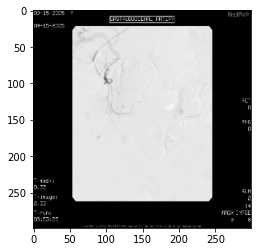

  4%|▍         | 66/1498 [14:16<5:04:18, 12.75s/it]

ORIGINAL ----------------
Modality: AN - Angiogram Plane: AP  Anatomy:
Gastrointestinal   Findings: Selected angiogram of the
gastroduodenal artery demonstrates focal extravasation off
of the branch of the posterior superior pancreaticoduodenal
artery at the junction of the second and third portions of
the duodenum.  Post-embolization angiogram demonstrates no
active extravasation.   Impression: GASTROINTESTINAL
BLEEDING


AI GENERATED ------------
Modality: an angiogram plane ap  Anatomy: vascular
Findings: left subclavian central line with its tip to the
left of the spine at the level of the cervical persistent
facets at one level   Impression: skull fracture


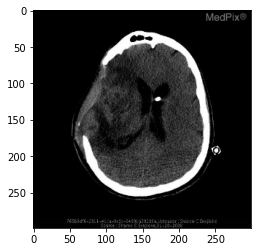

  4%|▍         | 67/1498 [14:29<5:04:58, 12.79s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Axial  Anatomy: Brain and
Neuro   Findings: •  craniectomy  •  frontotemporal hematoma
evacuation   Impression: Parenchymal hemorrhage and brain
edema after Blast Injury


AI GENERATED ------------
Modality: ct noncontrast plane axial  Anatomy: brain and
neuro   Findings: noncontrast ct shows hypodensity in l
parietal lobe with no visible compression of other
structures no hyperdens or hemorrhagic areas are noted mri
dwi image shows hyperintense signal within same area
demonstrating restricted diffusion of water molecules
Impression: l


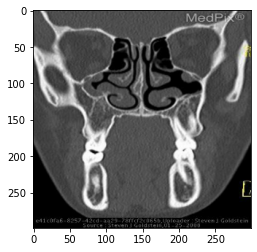

  5%|▍         | 68/1498 [14:41<5:05:05, 12.80s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Coronal  Anatomy: Head and
Neck (ex. orbit)   Findings: • Very Small Maxillary sinuses
bilaterally •  Normal aeration of the ethmoid sinuses •
Large orbits • Downward sloping aspect to  Orbital floors
Impression: Maxillary Sinus Hypoplasia


AI GENERATED ------------
Modality: ct noncontrast plane coronal  Anatomy: head and
neck ex orbit   Findings: ct of the head and neck
demonstrates a nondisplaced fracture of the right occipital
condyle with extension posteriorly into the occipital bone
the atlantoaxial and atlantooccipital relationship is normal
there is extensive subcutaneous air   Impression: occipital
condyle


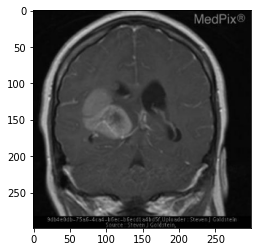

  5%|▍         | 69/1498 [14:54<5:04:06, 12.77s/it]

ORIGINAL ----------------
Modality: MR - T1W w/Gadolinium Plane: Coronal  Anatomy:
Brain and Neuro   Findings: Multifocal enhancing mass
involving the right temporal lobe with a second component in
the basal ganglia and thalamus.   Impression: Glioblastoma
multiforme


AI GENERATED ------------
Modality: mr t1w wgadolinium plane coronal  Anatomy: brain
and neuro   Findings: • large right frontal parietal lobe
mass  • extensive surrounding vasogenic edema  • lesion has
low signal intensity rim on t2 images  • elevated signal
intensity within lesion on dwi images  • decreased signal on
adc map impression


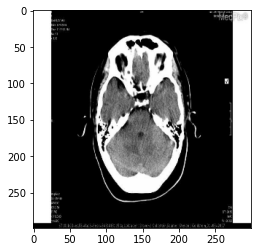

  5%|▍         | 70/1498 [15:07<5:02:54, 12.73s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Axial  Anatomy: Brain and
Neuro   Findings: Low attenuation changes on CT involving
the occipital and posterior parietal lobes.   Impression:
Posterior Reversible Leukoencephalopathy, PRES


AI GENERATED ------------
Modality: ct noncontrast plane axial  Anatomy: brain and
neuro   Findings: noncontrast ct shows hypodensity in l
parietal lobe with no visible compression of other
structures no hyperdens or hemorrhagic areas are noted mri
dwi image shows hyperintense signal within same area
demonstrating restricted diffusion of water molecules
Impression: l


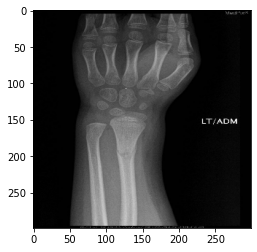

  5%|▍         | 71/1498 [15:19<5:02:01, 12.70s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: Multiple or Montage
Anatomy: MSK - Musculoskeletal   Findings: Radiographs of
the left wrist demonstrate two fractures: •  a Torus
(buckle) fracture of the distal ulna.  There is radial
angulation of the distal portion of the ulnar Torus (buckle)
fracture.   •  a Greenstick fracture of the distal radial
diaphasis, with anterior angulation of the distal radius.
Impression: Torus (Buckle) Fracture and Greenstick Fracture


AI GENERATED ------------
Modality: xr plain film plane pa  Anatomy: msk
musculoskeletal   Findings: there is a buckle fracture of
the lateral and volar aspect of the radial metaphysis
minimal volar angulation is present no other fractures are
evident soft tissue swelling is present indicating a
fracture   Impression: torus fracturebuckle fracture of the


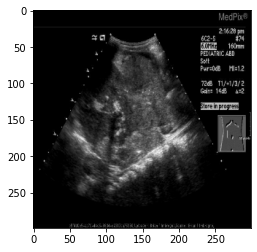

  5%|▍         | 72/1498 [15:32<5:02:36, 12.73s/it]

ORIGINAL ----------------
Modality: US - Ultrasound Plane: Sagittal  Anatomy:
Genitourinary   Findings: Plain Film:  Paucity of bowel gas
in the abdomen with pathologic calcifications and metal
densities in the shape of teeth.   US: Large heterogeneous
intraabdominal mass with apparent cystic and solid
components.  Scattered echogenic structures with shadowing
likely representing calcifications throughout the mass are
noted.  CT: Large midline heterogenous mass with cystic and
calcific components that does not appear to be originating
from liver or kidney.  The ovaries are not easily
identified.   Impression: Ovarian Germ Cell Tumor:  Mature
Cystic Teratoma with Yolk Sac component.


AI GENERATED ------------
Modality: us ultrasound plane longitudinal  Anatomy:
genitourinary   Findings: 1 gallbladder is unremarkable no
sonographic murphys sign 2 the right kidney is normal in
size and contour with normal corticomedullary
differentiation the renal collecting system is decompressed
there 

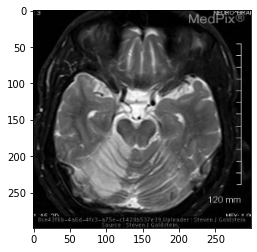

  5%|▍         | 73/1498 [15:45<5:02:28, 12.74s/it]

ORIGINAL ----------------
Modality: MR - T2 weighted Plane: Axial  Anatomy: Brain and
Neuro   Findings: •  Wedge-shaped signal abnormality in the
distribution of the right superior cerebellar artery •
Lesion has virtually no mass effect •  Lesion has restricted
diffusion (ADC dark & DWI bright)   Impression: Cerebellar
infarction in SCA Distribution


AI GENERATED ------------
Modality: mr t2 weighted plane axial  Anatomy: brain and
neuro   Findings: • multiple bilateral cerebral infarcts of
varying ages and sizes  • acute infarcts in the right
frontal lobe  • absent flow in the distal ica mca and aca
vessels   Impression: moyamoya


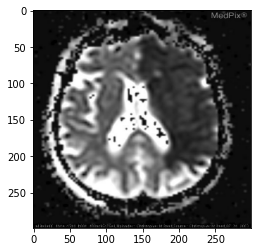

  5%|▍         | 74/1498 [15:58<5:02:57, 12.77s/it]

ORIGINAL ----------------
Modality: MR - ADC Map (App Diff Coeff) Plane: Axial
Anatomy: Brain and Neuro   Findings: Non-Enhanced CT -
Subtle left sided "insular ribbon sign" with loss of normal
gray-white differenciation and overlying sulcal effacement.
MRI - Diffusion weighted images demonstrate marked intensity
over the entire left ACA and MCA territories. Corresponding
ADC hypointensity seen in this case confirms that there has
been an acute infarct. The displayed FLAIR image further
reveals the hyperintensity involving these same regions.
Note the sparing of the PCA territory on the affected side.
Selected MRA image of the bilateral carotid arteries
demonstrates occlusion of the left ICA shortly after the
bifurcation. Note the vertebrobasilar system is intact,
supplying the PCA territories.   Impression: Cerebral
Infarction encompassing the left MCA and ACA territories
with occlusion of the left ICA.


AI GENERATED ------------
Modality: mr adc map app diff coeff plane axial  Anato

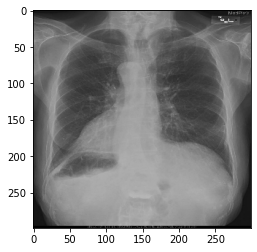

  5%|▌         | 75/1498 [16:11<5:06:00, 12.90s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: PA  Anatomy: Multisystem
Findings: Chest radiography demonstrates dextrocardia with
the cardiac apex pointing to the right.  There is a right-
sided aortic arch, associated with slight deviation of the
distal trachea to the left.   A loop of bowel projects in
the right upper quadrant of the abdomen. The minor fissure
is on the left side.  There is no evidence of
bronchiectasis.   Contrast enhanced CT at the level of the
origin of the great vessels demonstrates mirror-image
branching of the great vessels; a left-sided superior vena
cava; and a contrast filled esophagus posterior to the
trachea.  Contrast enhanced CT at the level of the diaphragm
demonstrates reversal of the normal cardiac anatomy.  Note
that the cardiac apex and descending aorta are on the right,
and the inferior vena cava is on the left side.  Contrast
enhanced CT of the upper abdomen show mirror-image anatomy
of the viscera.  The liver, gallbladder, and inferi

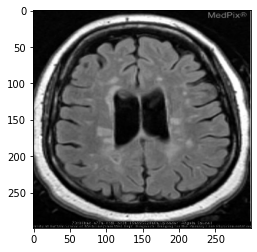

  5%|▌         | 76/1498 [16:24<5:06:59, 12.95s/it]

ORIGINAL ----------------
Modality: MR - FLAIR w/Gd Plane: Axial  Anatomy: Generalized
Findings: MRI BRAIN: 2010  1. AXIAL FLAIR with GADOLINIUM:
EXTENSIVE MS PLAQUES, ESPECIALLY PERIVENTRICULAR,WHICH
INDICATES ADVANCED DISEASE  2. AX IR FSPGR: PLAQUES NOTED ON
T1 IMAGING; ALSO INDICATES ADVANCED DISEASE STATUS.  3.
SAGITTAL T2 FLAIR: EXTENSIVE MS PLAQUES SEEN, ESPECIALLY
PERIVENTRICULARLY, INDICATING ADVANCED DISEASE. PLAQUES ARE
NOTED TO BE PERPENDICULAR TO THE VENTRICLES, ANOTHER SIGN
THAT POINT TO LESIONS BEING DUE TO MS ETIOLOGY, RATHER THAN
OTHER PATHOLOGY SUCH AS MULTI-INFARCT OR ISCHEMIC VASCULAR
DISEASE.   MRI BRAIN 2012:  1. BR AX FLAIR plus
GAD:EXTENSIVE MS PLAQUES, ESPECIALLY PERIVENTRICULAR,WHICH
INDICATES ADVANCED DISEASE  2. EXTENSIVE MS PLAQUES,
ESPECIALLY PERIVENTRICULAR,WHICH INDICATES ADVANCED DISEASE.
CERVICAL SPINE MRI FINDINGS:  1. STRAIGHTENING OF THE NORMAL
CERVICAL LORDOSIS WHICH MIGHT BE SECONDARY TO MUSCLE SPASM.
2. AT THE C2-C3 LEVEL, THERE IS MILD SMALL CEN

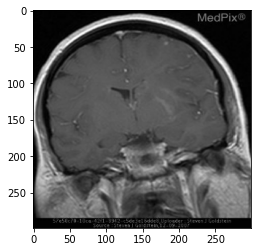

  5%|▌         | 77/1498 [16:37<5:06:50, 12.96s/it]

ORIGINAL ----------------
Modality: MR - T1W w/Gadolinium Plane: Coronal  Anatomy:
Vascular   Findings: •  Extensive left MCA infarct with
restricted diffusion. •  Evidence of laminar necrosis of
Basal Ganglia on T1 images. •  Scattered enhancement of
cortical gray matter. •  Small cavernous carotid ICA, left.
•  90% stenosis left ICA origin on MRA - not shown here
Impression: Cerebral Infarction, Laminar Necrosis, Left MCA


AI GENERATED ------------
Modality: mr t1w wgadolinium plane coronal  Anatomy: brain
and neuro   Findings: • ring enhancing lesion right frontal
lobe  • surrounding vasogenic edema  • lesion has low signal
intensity rim on t2 sequences  • elevated signal intensity
within lesion on dwi images  • decreased signal on adc map
Impression: brain


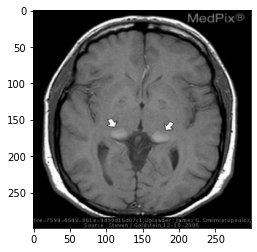

  5%|▌         | 78/1498 [16:50<5:06:23, 12.95s/it]

ORIGINAL ----------------
Modality: MR - T1W - noncontrast Plane: Axial  Anatomy:
Brain and Neuro   Findings: Bilateral and symmetric
hyperintensity in the pulvinar of thalamus on T1-weighted MR
Impression: Fabry Disease


AI GENERATED ------------
Modality: mr flair plane axial  Anatomy: brain and neuro
Findings: • august mri mass lesion in left temporal lobe
with edema but no contrast enhancement best seen on flair
mri  • november mri ringlike enhancement in left temporal
lobe flair images are not remarkable   Impression: herpes
simplex encephalitis hsv2


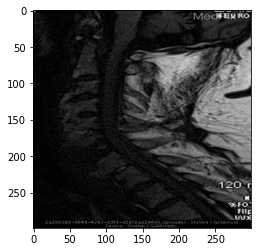

  5%|▌         | 79/1498 [17:03<5:05:18, 12.91s/it]

ORIGINAL ----------------
Modality: MR - T1W - noncontrast Plane: Sagittal  Anatomy:
Spine   Findings: Fracture through C6-7 disc and superior C7
vertebral body. Anterior flowing ostephytes C2 though C6
indicative of DISH.   Impression: Diffuse Idiopathic
Skeletal Hyperostosis (DISH) with fracture through C6-C7
disk


AI GENERATED ------------
Modality: mra mr angiographyvenography plane sagittal
Anatomy: head and neck ex orbit   Findings: fenestration or
duplication of proximal right vertebral artery to the c3
level absent signal in left vertebral artery   Impression:
vertebral artery fenestration


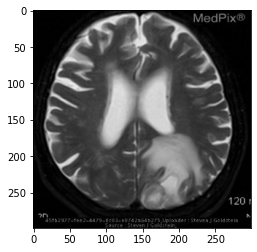

  5%|▌         | 80/1498 [17:16<5:05:57, 12.95s/it]

ORIGINAL ----------------
Modality: MR - T2 weighted Plane: Axial  Anatomy: Brain and
Neuro   Findings: •  Ring Enhancing lesion right occipital
lobe. •  Moderate associated vasogenic edema. •  Increased
signal on DWI images with corresponding low signal on ADC
map.   Impression: Metastatic Adenocarcinoma of the Lung


AI GENERATED ------------
Modality: mr t2 weighted plane axial  Anatomy: brain and
neuro   Findings: • left parietooccipital mass with both
fluid cystic and solid components  • there is enhancement of
both the cyst walls and solid portions of the mass
Impression: oligodendroglioma malignant


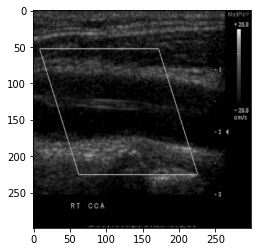

  5%|▌         | 81/1498 [17:29<5:06:55, 13.00s/it]

ORIGINAL ----------------
Modality: US - Ultrasound Plane: Sagittal  Anatomy: Vascular
Findings: Carotid Ultrasound:  Dissection involving the
right common carotid artery and extending into the right
internal carotid artery.  Two lumens are separated by a thin
intimal flap.  There is flow within both the true and false
lumens.   Impression: Carotid Artery Dissection


AI GENERATED ------------
Modality: us ultrasound plane longitudinal  Anatomy:
gastrointestinal   Findings: the pylorus measures 197 mm in
length with a wall thickness of 48 mm on cine imaging no
gastric contents are observed passing through the pylorus
Impression: hypertrophic pyloric stenosis


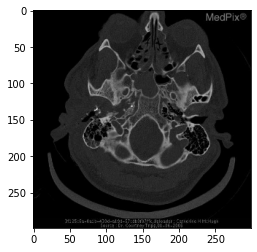

  5%|▌         | 82/1498 [17:42<5:05:41, 12.95s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Axial  Anatomy:
Multisystem   Findings: Metallic fragments from projectile
in right temporal bone demonstrating ballistic tract. The
bullet entered the external auditory canal, penetrated the
petrous portion of the temporal bone, and stopped in the
clivus.   The bullet appears to have tumbled from when it
entered the EAM to lodging into the clivus.   Impression:
Bullet to the clivus.


AI GENERATED ------------
Modality: ct noncontrast plane axial  Anatomy: head and neck
ex orbit   Findings: ct scan plain axial of para nasal
sinuses showed complete opacification of the left maxillary
sinus the opacification had obliterated the whole of left
maxillary sinus posteriorly opacification extended up to the
left pterygoid process   Impression: fibrous


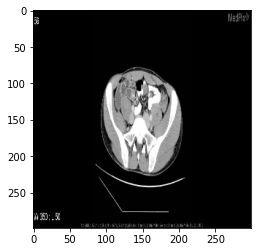

  6%|▌         | 83/1498 [17:55<5:04:59, 12.93s/it]

ORIGINAL ----------------
Modality: CT - GI & IV Contrast Plane: Axial  Anatomy:
Gastrointestinal   Findings: An axial Ct scan with oral and
IV contrast demonstrating a ring enhacing tubular structure
in the region of the ileal small bowel.   Impression:
Meckel's Diverticulum


AI GENERATED ------------
Modality: ct noncontrast plane axial  Anatomy: brain and
neuro   Findings: on the t2w images of the head a plain
films demonstrate a minimally enhancing mass that is
displaced and decreased signal on both sides the brain stem
bronchus dark on the mass is diffusely heterogeneous in
appearance on t1


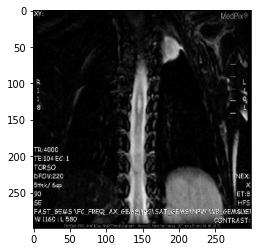

  6%|▌         | 84/1498 [18:07<5:04:32, 12.92s/it]

ORIGINAL ----------------
Modality: MR - T1W - noncontrast Plane: Coronal  Anatomy:
Brain and Neuro   Findings: •  NF Spots in R posterior
internal capsule.   •  L optic glioma.   •  Scoliosis with
Severe Kyphosis of Cervical Spine. •  Posterior Cervical
fusion mass. •  Dural ectasia.  Widened spinal canal.
Posterior vertebral body scalloping.    •  Syrinx.   •
Plexiform neurofibroma of L apex.   Impression:
Neurofibromatosis Type 1 (NF1) with optic glioma, dural
ectasia, thoracic syrinx.


AI GENERATED ------------
Modality: mr t1w wgd fat suppressed plane sagittal  Anatomy:
msk musculoskeletal   Findings: plain films and ct show low
t1 and high signal bone changes foci of marrow edema
Impression: osteoporosis of left hip parietal bone fracture
with destruction of left hip and left hip and extensive
fracture of left


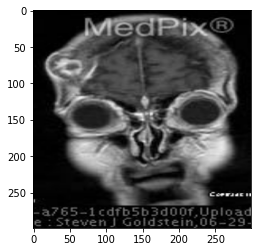

  6%|▌         | 85/1498 [18:21<5:05:54, 12.99s/it]

ORIGINAL ----------------
Modality: MR - T1W w/Gadolinium Plane: Coronal  Anatomy:
Risk   Findings: Destructive mass lesion arising from the
right frontal bone with both intra-cranial and extra-cranial
extension.   Impression: Angiosarcoma,Liver, Metastatic to
skull


AI GENERATED ------------
Modality: mr t1w wgd fat suppressed plane coronal  Anatomy:
head and neck ex orbit   Findings: • absence of normal flow
void in the right sigmoid colon and rectum   Impression:
dural sinus thrombosis


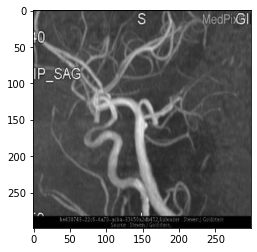

  6%|▌         | 86/1498 [18:34<5:04:50, 12.95s/it]

ORIGINAL ----------------
Modality: MRA - MR Angiography/Venography Plane: Lateral
Anatomy: Vascular   Findings: MRA 1. Absent signal left ICA
at skull base. 2.  Reconstitution of intradural ICA directly
from the basilar  artery.  CT Scan No bony carotid canal on
the left.   Impression: Congenital Absence of the Internal
Carotid Artery


AI GENERATED ------------
Modality: mra mr angiographyvenography plane ap  Anatomy:
brain and neuro   Findings: • bilateral anterior circulation
infarcts on ct and mri  • occlusion of the supracavernous
intradural internal carotid arteries on mra   Impression:
moyamoya anterior circulation infarcts bilateral aca


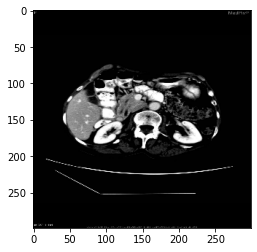

  6%|▌         | 87/1498 [18:46<5:04:40, 12.96s/it]

ORIGINAL ----------------
Modality: CT - GI & IV Contrast Plane: Axial  Anatomy:
Gastrointestinal   Findings: Pancreatic divisum
Impression: Pancreatic Divisum


AI GENERATED ------------
Modality: ct gi iv contrast plane axial  Anatomy:
gastrointestinal   Findings: pancreatic divisum
Impression: pancreatic divisum


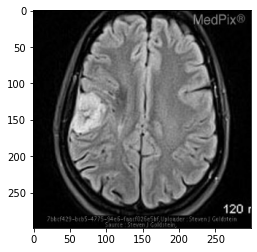

  6%|▌         | 88/1498 [18:59<5:03:23, 12.91s/it]

ORIGINAL ----------------
Modality: MR - FLAIR Plane: Axial  Anatomy: Brain and Neuro
Findings: •  CT calcified mass right basal ganglia and a
hemispheric convexity mass almost isodense with brain  •
MRI  Large right basal ganglionic/temporal  heterogeneous
black-and-white mass lesion with remarkably little mass
effect.  A similar but smaller lesion is seen in the base of
left frontal lobe.  There is a right frontal convexity
extraaxial lesion, hemispheric, with an enhancing "dural
tail".   Impression: Cavernous  hemangioma and Convexity
Meningioma


AI GENERATED ------------
Modality: mr flair plane axial  Anatomy: brain and neuro
Findings: • multiple bilateral cerebral infarcts of varying
ages and sizes  • acute infarcts in the right frontal lobe
• absent flow in the distal ica mca and aca vessels
Impression: moyamoya


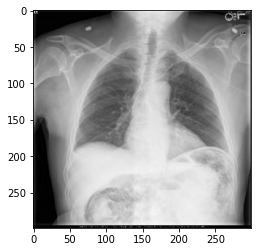

  6%|▌         | 89/1498 [19:12<5:02:19, 12.87s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: PA  Anatomy:
Gastrointestinal   Findings: CXR: Rigler’s sign is present
in the abdomen.  This is seen as well defined white lines,
the bowel wall, outlined by air on both sides.  Also, there
appears to be free air within the peritoneal cavity.  CT:
Large quantities of free air in the peritoneal cavity and
within the colonic walls.   Impression: Idiopathic
pneumatosis coli


AI GENERATED ------------
Modality: xr plain film plane pa  Anatomy: chest pulmonary
ex heart   Findings: cxr prominent bilateral hila when
compared with prior cxr 5 months prior peripheral tapering
of pulmonary vasculature new airspace opacification superior
segment left lower lobe seen best on lateral view ct pedvt
large clot burden involving majority


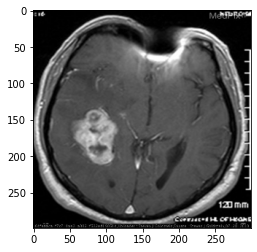

  6%|▌         | 90/1498 [19:25<5:02:50, 12.91s/it]

ORIGINAL ----------------
Modality: MR - T1W w/Gadolinium Plane: Axial  Anatomy:
Chest, Pulmonary (ex. Heart)   Findings: Heterogeneous
irregular ring-enhancing mass right temporal lobe with
surrounding vasogenic edema. Small, thin and irregular
linear areas of T-1 shortening (bright) may represent
hemorrhage, melanin, or even micro-calcifications.  The
lesions shows some peripheral rim T2-shortening (dark) which
is also consistent with older hemorrhage (ferritin or
hemosiderin).   Impression: Malignant Melanoma Metastatic to
brain


AI GENERATED ------------
Modality: mr t1w wgadolinium plane axial  Anatomy: brain and
neuro   Findings: • ct right frontal lobe hematoma  • cta
fluid collection behind rt frontal bone  • ct brain cortex
around enlargement of right hemisphere  • cta dilated
vessels  • mass is vascular draining into ivc with partial
agenesis of


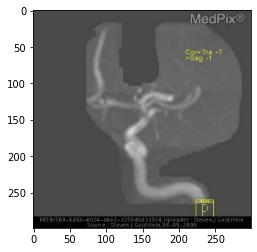

  6%|▌         | 91/1498 [19:38<5:01:34, 12.86s/it]

ORIGINAL ----------------
Modality: MRA - MR Angiography/Venography Plane: Oblique
Anatomy: Brain and Neuro   Findings: •  Acute Right frontal
lobe infarct •  Focal stenosis right MCA superior division •
Occlusion left MCA M1 segment   Impression: MOYAMOYA


AI GENERATED ------------
Modality: ct noncontrast plane sagittal  Anatomy: msk
musculoskeletal   Findings: plain radiographs thoracic spine
ap radiograph of the thoracic spine demonstrate a mixed
lucentsclerotic appearance of the left t4 pedicle and upper
t11 vertebral body the lumbar spine mri with gadolinium of
the lumbar spine demonstrates a pedicle and intervertebral


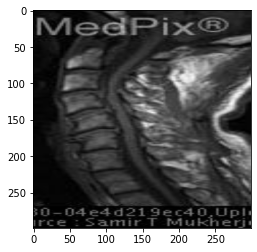

  6%|▌         | 92/1498 [19:51<5:00:41, 12.83s/it]

ORIGINAL ----------------
Modality: MR - T1W - noncontrast Plane: Sagittal  Anatomy:
Spine   Findings: •  MR Brain - Sagittal T1 image w/o
contrast demonstrates normal brain parenchyma with apparent
tapering of the spinal cord at the C3-C4 level. •  MR
c-spine - Sagittal T2 FRFSE image w/o contrast demonstrates
diffuse disk desiccation at all levels with posterior
projecting disk material at C3-C4 level causing cord
impingement and severe central canal narrowing. •  MR
c-spine - Axial T2 FRFSE image w/o contrast at the C3-C4
level demonstrates posterior disk bulge, eccentric to the
right with superimposed uncovertebral spurring causing mass
impression and effacement of the ventral thecal sac and
cord, resulting in severe central canal stenosis.
Impression: Spinal stenosis


AI GENERATED ------------
Modality: mr t1w noncontrast plane sagittal  Anatomy: spine
Findings: • moderate degeneration l4l5 facet joints  •
lateral recess and neural foramen mass at l45 on right  •
mass is high sig

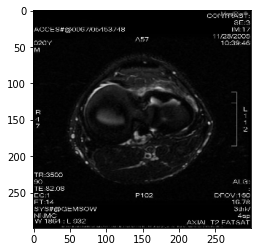

  6%|▌         | 93/1498 [20:04<5:01:41, 12.88s/it]

ORIGINAL ----------------
Modality: MR - T2 weighted Plane: Axial  Anatomy: MSK -
Musculoskeletal   Findings: Axial T2 weighted fat saturated
cut through the knee joint:    • Cleft sign of free edge of
lateral meniscus. Sagittal oblique T1 cut of lateral knee:
• Ghosting of anterior horn of lateral meniscus. Also
with noted loss of bow tie appearance of the        menisci.
Sagittal PD cut of lateral knee:    • Ghosting of free edge
of lateral meniscus with      increased signal.  Sagittal PD
cut through lateral knee:    • Ghosting of free edge of
lateral meniscus with      increased signal.   Impression:
Radial tear of the anterior horn of the lateral meniscus


AI GENERATED ------------
Modality: mr t2 weighted plane axial  Anatomy: msk
musculoskeletal   Findings: plain radiographs demonstrate a
subtle lucency in the acromion a ct ordered to rule out
fracture clearly demonstrates a congentially unfused
acromion   Impression: os acromiale


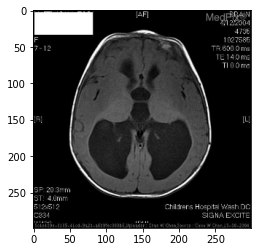

  6%|▋         | 94/1498 [20:17<5:04:08, 13.00s/it]

ORIGINAL ----------------
Modality: MR - Other Pulse Seq. Plane: NOS - Not specified
Anatomy: Brain and Neuro   Findings: Symmetrical dilatation
of the lateral and 3rd ventricles with normal size of the
4th ventricle.  No intraventricular masses.   Impression:
Aqueductal stenosis.


AI GENERATED ------------
Modality: mr t1w noncontrast plane axial  Anatomy: brain and
neuro   Findings: mri cervical spine with and contrast 1 cm
left sided solitary lytic lesion in the right side of
posterior fossa enhancement of mass is small central canal
necrosis of cerebellum   Impression: acute disseminated
encephalomyelitis


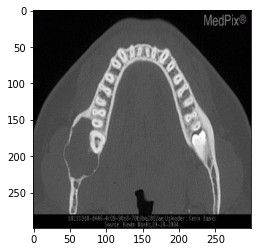

  6%|▋         | 95/1498 [20:30<5:03:52, 13.00s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Axial  Anatomy: Head and
Neck (ex. orbit)   Findings: Radiographic evaluation of the
mandible demonstrated a multilocular cystic lesion of the
right mandible arising along the crown of a tooth at the
ramus of the mandible. There is significant expansion of the
bone with cortical disruption medially.   Impression:
Ameloblastoma


AI GENERATED ------------
Modality: ct noncontrast plane axial  Anatomy: head and neck
ex orbit   Findings: • longitudinal fracture passing through
anterior wall of external auditory canal into tmj  • the
fracture extends along the floor of the middle cranial fossa
into the sphenoid sinus   Impression: longitudinal petrous
temporal bone fracture


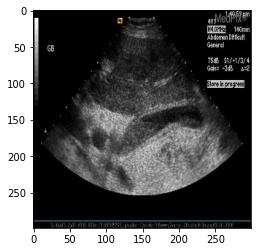

  6%|▋         | 96/1498 [20:43<5:02:16, 12.94s/it]

ORIGINAL ----------------
Modality: US - Ultrasound Plane: Longitudinal  Anatomy:
Gastrointestinal   Findings: Sonography demonstrates a
thickened gallbladder wall with a layering echogenicity
consistent with sludge.  No gallstones or intra/extrahepatic
biliary ductal dilatation is present.   Impression:
Gallbladder wall edema with sludge


AI GENERATED ------------
Modality: us ultrasound plane sagittal  Anatomy:
genitourinary   Findings: ultrasound both testes demonstrate
no tenderness is a large solid mass measuring approximately
12mm and multiple 12 small cystic mass pleural effusion
multiple small hyperechoic foci of both ct multiple small
cystic spaces are also seen throughout the abdomen
t2weighted mr


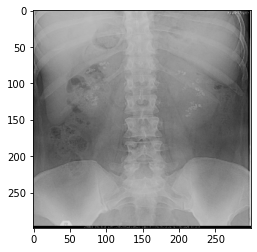

  6%|▋         | 97/1498 [20:55<5:00:34, 12.87s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: Frontal  Anatomy:
Genitourinary   Findings: Medullary nephrocalcinosis is
noted on CT and KUB by innumerable discrete stones
throughout the bilateral kidneys.  Ultrasound shows
hyperechoic medullary pyramids.  There is mild
hydronephrosis on CT and US.   Impression: Medullary Sponge
Kidney


AI GENERATED ------------
Modality: xr plain film plane pa  Anatomy: gastrointestinal
Findings: flat and upright abdominal films reveal multiple
dilated loops of small bowel with prominent air fluid levels
axial ct images from the upper abdomen show normal
orientation of the superior mesenteric artery and vein
proximally with twisting and malposition of


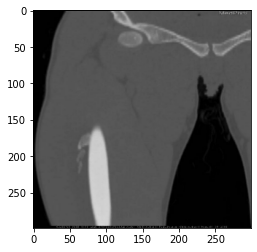

  7%|▋         | 98/1498 [21:08<5:00:16, 12.87s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Coronal  Anatomy: MSK -
Musculoskeletal   Findings: Irregular soft tissue
calcification is seen adjacent to the lateral aspect of the
mid right femur, underlying site of known prior trauma and
now-palpable soft tissue mass. Cortical contiguity is
uncertain. Additionally, there is curvilinear extension of
the posteromedial mid right femoral cortex consistent with a
chronic tug lesion of the thigh adductors.   Impression:
Bizarre Parosteal Osteochondromatous Proliferation


AI GENERATED ------------
Modality: ct noncontrast plane axial  Anatomy: head and neck
ex orbit   Findings: ct of the facial bones demontrates
fractures of the lateral orbital wall at the
zygomaticofrontal suture orbital floor in the region of the
zygomaticomaxillary suture and zygoma there is a rotational
deformity of the fracture fragment impression


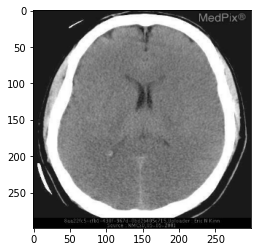

  7%|▋         | 99/1498 [21:22<5:03:12, 13.00s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Axial  Anatomy: Brain and
Neuro   Findings: Noncontrast CT images demonstrate
effacement of the the sulci. There is diffuse graying of the
cerebral hemispheres with blurring and loss of normal gray-
white differentiation and interface.  The ventricles are
small. Note that the cerebellum and brainstem are well
preserved and have a normal appearance. Also note
pansinusitis with air-fluid level in sphenoids.
Impression: Diffuse Cerebral Edema from cardiac arrest


AI GENERATED ------------
Modality: ct noncontrast plane axial  Anatomy: brain and
neuro   Findings: • ct hyperdense mass in the anterior left
inferior meatus with extension into the left nasal passage
of air pocket of air on contrast opacification extending
into the anterior portion of the left maxillary sinus
Impression: anterior maxillary sinus


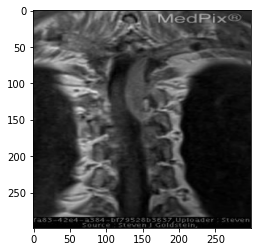

  7%|▋         | 100/1498 [21:34<5:01:36, 12.94s/it]

ORIGINAL ----------------
Modality: MR - T1W w/Gadolinium Plane: Coronal  Anatomy:
Pathology   Findings: •  Spinal extradural enhancing mass at
T4-5. •  Spinal cord is displaced anteriorly and to the
right by the mass.   Impression: Chronic Lymphocytic
Leukemia (CLL) Thoracic spine


AI GENERATED ------------
Modality: mr t1w wgd fat suppressed plane sagittal  Anatomy:
cardiovascular inc heart   Findings: • enlarged aortic arch
with all mitral stenosis left subclavian artery  • slight
ventricle and hydrocephalus  • mild dilatation of lateral
ventricles  • mri vertebra and flair although not shown  •
ct chest shows multiple enlarged


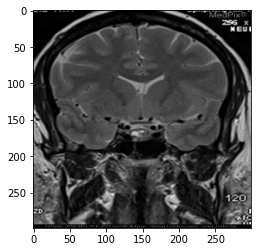

  7%|▋         | 101/1498 [21:47<5:00:25, 12.90s/it]

ORIGINAL ----------------
Modality: MR - T2 weighted Plane: Coronal  Anatomy: Brain
and Neuro   Findings: Heterogeneous signal intensity
material in a mildly enlarged pituitary gland consistent
with recent hemorrhage.   Impression: Pituitary apoplexy


AI GENERATED ------------
Modality: mr t2 weighted plane coronal  Anatomy: brain and
neuro   Findings: • enlarging mass foramen of monroe on
right  • mass almost doubled in size in past 12 months  •
subependymal nodules and cortical tubers some of which
enhance  • hydrocephalus   Impression: giant cell
astrocytoma in tuberous sclerosis


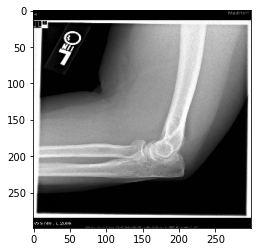

  7%|▋         | 102/1498 [22:00<4:59:15, 12.86s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: Lateral  Anatomy: MSK -
Musculoskeletal   Findings: Frontal, lateral and oblique
radiographs of the left elbow demonstrate a non-displaced
fracture at the volar aspect of the left radial head.
Alignement is anatomic and the joint spaces are within
normal limits.  An effusion or hemarthrosis is present at
the elbow, as evidenced by elevation of the anterior fat pad
and visualization of the posterior fat pad.   Impression:
Radial Head Fracture


AI GENERATED ------------
Modality: xr plain film plane lateral  Anatomy: msk
musculoskeletal   Findings: plain radiographs demonstrate
thickening of the achilles tendon convex   Impression: of
achilles tendon on the posterior margin of kagers fat pad
and a lower limits normal toygars angle mr   Findings:
demonstrates focal thickening of the achilles tendon
increased t2w


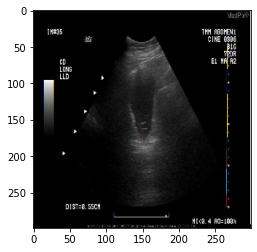

  7%|▋         | 103/1498 [22:13<4:57:44, 12.81s/it]

ORIGINAL ----------------
Modality: US-D - Doppler Ultrasound Plane: Other View (see
caption)  Anatomy: Gastrointestinal   Findings: CT and US
findings consistent with emphysematous cholecystitis.  CT
cleary delineates the intraluminal air within the
gallbladder. US demonstrates hyperechoic foci with ringed
down artifact suggesting intraluminal and or intramural air.
Impression: Emphysematous cholecystitis Organism:
CLOSTRIDIUM PERFRINGENS


AI GENERATED ------------
Modality: us ultrasound plane transverse  Anatomy:
gastrointestinal   Findings: ct imaging of the abdomen
demonstrated a pyloric channel 18mm in length of the wall of
the pancreas with the pancreatic head with two welldefined
lobulated adjacent stones   Impression: pyloric stenosis


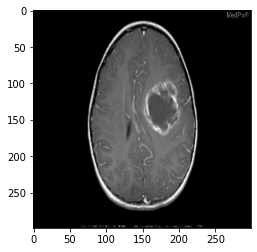

  7%|▋         | 104/1498 [22:25<4:58:15, 12.84s/it]

ORIGINAL ----------------
Modality: MR - T1W w/Gadolinium Plane: Axial  Anatomy: Brain
and Neuro   Findings: Mixed signal intensity mass in left
frontal and parietal lobe with cystic components and
surrounding edema.  There is mass effect with depression of
the roof of the lateral ventricle.  There is irregular ring-
like enhancement following contrast administration
Impression: Ependymoma


AI GENERATED ------------
Modality: mr flair plane axial  Anatomy: brain and neuro
Findings: • enlarged left hemisphere with evidence of poor
sulcation and thickened gyri  • enlarged left lateral
ventricle  • falx displaced to the right  • band heterotopia
of gray matter   Impression: cephalic disorders
hemimegalencephaly


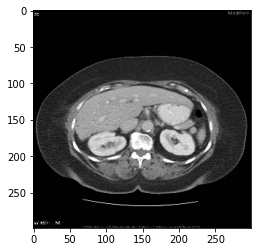

  7%|▋         | 105/1498 [22:38<4:56:53, 12.79s/it]

ORIGINAL ----------------
Modality: CT - GI & IV Contrast Plane: Axial  Anatomy:
Gastrointestinal   Findings: CT ABDOMEN 05 APR 2004:  Liver
demonstrates a nodular contour consistent with chronic
cirrhosis.  There are areas of heterogeneous density,
throughout the right lobe of the liver, without definitive
circumscribed mass identified.  Hypertrophy of the caudate
lobe.  The left lobe appears clear by CT. Small spenule is
present. Atherosclerotic vascular calcification of the
abdominal aorta without aneurysmal dilatation. Degenerative
changes of the spine.    MR Abdomen 10 APR 2004:  The liver
is diffusely nodular consistent with cirrhosis.  Multiple
hyperenhancing lesions seen throughout the right lobe of the
liver which appear to conglomerate to a mass in the superior
portion of right lobe measuring approximately 13 X 10 cm.  A
separate conglomeration mass is seen in the inferior portion
of right lobe near the tip measuring approximately 7 X 7 cm.
Additionally there is a hyperenhanc

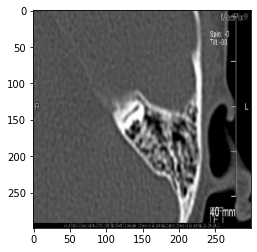

  7%|▋         | 106/1498 [22:51<4:55:45, 12.75s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Axial  Anatomy: Pathology
Findings: Sclerosis of the right otic capsule structures on
the right with the semicircular canals being most involved.
Impression: Otosclerosis, probably secondary to acute
bacterial meningitis


AI GENERATED ------------
Modality: ct noncontrast plane sagittal  Anatomy: head and
neck ex orbit   Findings: high riding and dehiscent jugular
bulb on the right   Impression: dehiscent julgular bulb


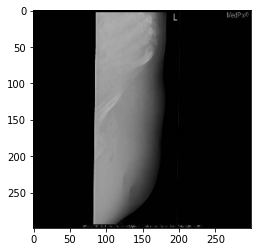

  7%|▋         | 107/1498 [23:04<4:55:33, 12.75s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: AP  Anatomy: Spine
Findings: Image 1: Abdominal X ray showing the narrow hips
and no evidence of a sacrum.   Image 2: T1 MRI showing the
narrow and hypoplastic hips with sacral agenesis.   Image 3:
T1 MRI also showing the hip narrowing.    Image 4: VCUG
showing a distended bladder from neurogenic bladder caused
by Caudal Regression syndrome.   Impression: Caudal
Regression Syndrome


AI GENERATED ------------
Modality: xr plain film plane ap  Anatomy: msk
musculoskeletal   Findings: • subchondral crescent shaped
lucency of the femoral head and mixed sclerotic and
avascular necrosis of the femoral head cervical spine mri t1
t2weighted mri imaging shows low signal intensity in the
pons   Impression: avascular necrosis of the femoral


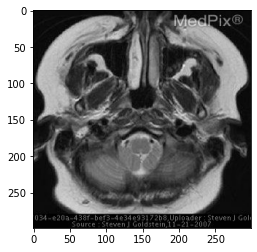

  7%|▋         | 108/1498 [23:16<4:56:09, 12.78s/it]

ORIGINAL ----------------
Modality: MR - T2 weighted Plane: Axial  Anatomy: Brain and
Neuro   Findings: Marked distension of deep venous sinuses
as well as spinal epidural veins.  The deep veins are
rounded in configuration and engorged.  Prominent
enhancement of dura.  No downward displacement of brainstem
or drooping of chiasm   Impression: Intracranial hypotension


AI GENERATED ------------
Modality: mr t2 weighted plane axial  Anatomy: brain and
neuro   Findings: • multiple cystic spaces in the pons  •
the cysts are identical signal intensity to csf on all
sequences  • no enhancement of the cyst walls following
contrast enhancement   Impression: virchowrobin spaces type
iii


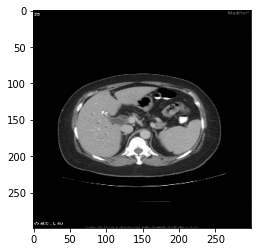

  7%|▋         | 109/1498 [23:29<4:57:19, 12.84s/it]

ORIGINAL ----------------
Modality: CT - GI Contrast Plane: Axial  Anatomy:
Miscellaneous   Findings: Retained calculus in the common
bile duct.   Impression: Choledocholithiasis


AI GENERATED ------------
Modality: ct gi iv contrast plane axial  Anatomy:
gastrointestinal   Findings: ct of the abdomen with iv and
oral contrast demonstrates increased density of the
intraabdominal fat adjacent to the right colon extending to
the abdominal wall the appendix not included in this was
pattern was consistent with acute in


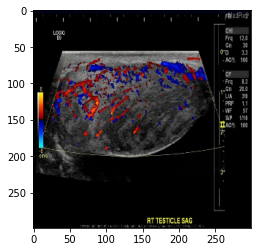

  7%|▋         | 110/1498 [23:42<4:55:37, 12.78s/it]

ORIGINAL ----------------
Modality: US - Ultrasound Plane: Sagittal  Anatomy:
Genitourinary   Findings: Enlarged heterogenous testicle
with increased blood flow. Hydrocele.   Impression: Orchitis


AI GENERATED ------------
Modality: usd doppler ultrasound plane transverse  Anatomy:
genitourinary   Findings: the left testicle is empty
demonstrates inflammatory and increase blood flow along the
course of the testicular producing a large mixed echogenic
mass   Impression: left histological adenocarcinoma of the
acromioclavicular from the inferior aspect of the testis


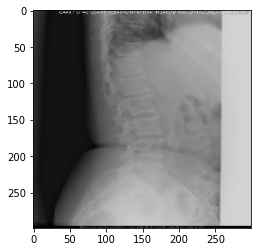

  7%|▋         | 111/1498 [23:55<4:53:46, 12.71s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: Lateral  Anatomy:
Gastrointestinal   Findings: The lumbar spine demonstrated a
focus of sclerosis within the L4 and L5 vertebral bodies
with corresponding metabolic activity noted on bone scan.
The CT demonstrated abnormally thickened mucosa within the
rectum as well as lymphadenopathy within the pelvis and
inflamatory changes in the adjacent fat.   Impression: Colon
Cancer


AI GENERATED ------------
Modality: xr plain film plane lateral  Anatomy:
gastrointestinal   Findings: radiographs of the lumbar spine
demonstrate syndesmophytes of the entire visualized spine
demonstrated on bone bone bone ct   Findings: are flattened
there is diffuse there is a large schmorl’s node of the
central within the distal esophagus with increased
echogenicity


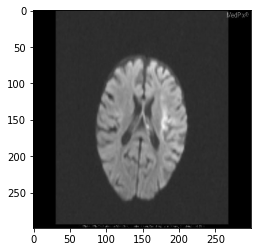

  7%|▋         | 112/1498 [24:07<4:53:09, 12.69s/it]

ORIGINAL ----------------
Modality: MR - DWI Diffusion Weighted Plane: Axial  Anatomy:
Brain and Neuro   Findings: MRI Day 1:  Cortical gray-matter
edema left temporal lobe with corresponding restricted
diffusion in same part of the brain on DWI images.  MRI Day
23:  Necrosis of most of the left temporal lobe.  DWI no
longer show restricted diffusion.  No significant
enhancement.   Impression: Herpes simplex encephalitis (HSV
Type 1)


AI GENERATED ------------
Modality: mr flair plane axial  Anatomy: brain and neuro
Findings: • enlarged left hemisphere with evidence of poor
sulcation and thickened gyri  • enlarged left lateral
ventricle  • falx displaced to the right  • band heterotopia
of hyperechoic foci of gray matter   Impression: cephalic
disorders hemimegalencephaly


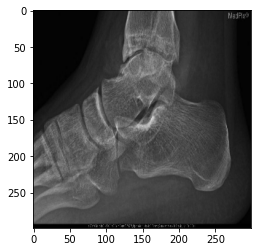

  8%|▊         | 113/1498 [24:20<4:51:42, 12.64s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: Lateral  Anatomy: MSK -
Musculoskeletal   Findings: AP, Lateral, and Oblique views
of the elbow demonstrating later stages of hemophilia. These
findings include osseous destruction, cystic lesions,
surface irregularities, joint space narrowing, and synovial
thickening.  AP, Lateral, and Oblique views of the ankles
demonstrating later stages of hemophilia. These findings
include osseous destruction, cystic lesions, surface
irregularities, joint space narrowing, and synovial
thickening.   Impression: Hemophilia


AI GENERATED ------------
Modality: xr plain film plane lateral  Anatomy: msk
musculoskeletal   Findings: plain radiographs demonstrate
thickening of the achilles tendon convex   Impression: of
achilles tendon on the posterior margin of kagers fat pad
and a lower limits normal toygars angle mr   Findings:
demonstrates focal thickening of the achilles tendon
increased t2w


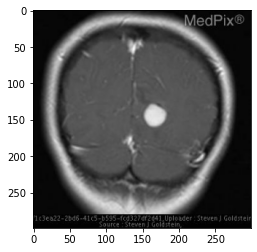

  8%|▊         | 114/1498 [24:33<4:53:27, 12.72s/it]

ORIGINAL ----------------
Modality: MR - T1W w/Gadolinium Plane: Coronal  Anatomy:
Brain and Neuro   Findings: •  Enhancing lesion right
occipital lobe with surrounding vasogenic edema. •  No
cystic component.   Impression: Juvenile Pilocytic
Astrocytoma


AI GENERATED ------------
Modality: mr t1w wgadolinium plane coronal  Anatomy: brain
and neuro   Findings: • ring enhancing lesion right frontal
lobe  • surrounding vasogenic edema  • lesion has low signal
intensity rim on t2 sequences  • elevated signal intensity
within lesion on dwi images  • decreased signal on adc map
Impression: brain


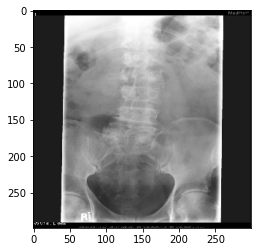

  8%|▊         | 115/1498 [24:45<4:53:04, 12.71s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: AP  Anatomy: MSK -
Musculoskeletal   Findings: The L2 vertebral body is
enlarged, with prominent cortical margins, aka, a "picture
frame" vertebral body   Impression: Pagets Disease of the
Vertebral Body


AI GENERATED ------------
Modality: xr plain film plane ap  Anatomy: genitourinary
Findings: ap radiograph of the lumbar spine demonstrating a
lytic lesion within the right kidney with suggestion of low
density thrombus adjacent to the right kidney   Impression:
grade iii grade 3 stress fracture


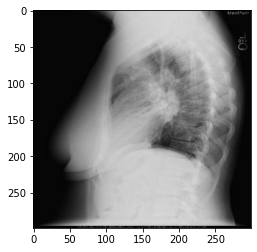

  8%|▊         | 116/1498 [24:58<4:51:59, 12.68s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: Lateral  Anatomy: Chest,
Pulmonary (ex. Heart)   Findings: - Calcified granulomatous
lymph nodes - mediasinal and hilar, bilaterally. -
Obstruction of right mainstem by bulky disease and resultant
post-obstructive infection.   Impression: Sarcoidosis


AI GENERATED ------------
Modality: xr plain film plane lateral  Anatomy: chest
pulmonary ex heart   Findings: • cxr large destructive left
apical mass involving the chest wall there is vertebral
destruction pleural metastasis lymphadenopathy and a
contralateral lung nodules  • ct 1 large left upper lobe
mass with adjacent chest wall invasion with


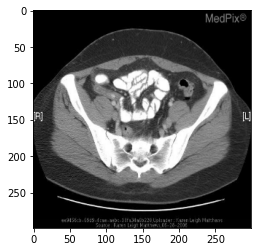

  8%|▊         | 117/1498 [25:11<4:50:59, 12.64s/it]

ORIGINAL ----------------
Modality: CT - GI & IV Contrast Plane: Axial  Anatomy:
Gastrointestinal   Findings: enlarged, inflammed appendix
with a fecalith which does not fill with contrast
Impression: Acute appendicitis


AI GENERATED ------------
Modality: ct gi iv contrast plane axial  Anatomy:
gastrointestinal   Findings: intravenous and enteric
contrastenhanced axial computed tomographic images of the
abdomen demonstrate a distended appendix 9 mm diameter with
thickened enhancing walls the lumen of the appendix fails to
opacify with enteric contrast there is prominent
periappendiceal fat stranding


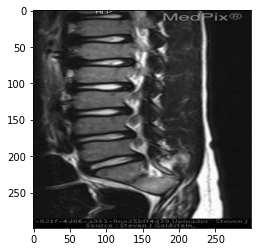

  8%|▊         | 118/1498 [25:23<4:52:30, 12.72s/it]

ORIGINAL ----------------
Modality: MR - T2 weighted Plane: Sagittal  Anatomy: Spine
Findings: Blunt appearing conus medullaris Absent lower
sacral segments No coccyx   Impression: Caudal Regression
Syndrome


AI GENERATED ------------
Modality: mr t1w wgd fat suppressed plane sagittal  Anatomy:
spine   Findings: sagittal and axial and coronal ct images
exhibit a right posterior and superiorly extruded
intervertebral disc exerting significant mass effect on the
following the administration demonstrate smooth below the
level of the arch   Impression: carotid artery


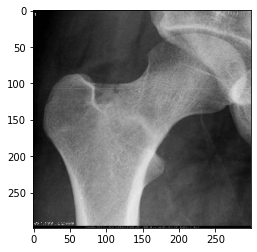

  8%|▊         | 119/1498 [25:36<4:51:06, 12.67s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: Frontal  Anatomy: MSK -
Musculoskeletal   Findings: Frontal radiographs of the
pelvis and right hip as well as a frog-leg lateral
radiograph of the right hip demonstrate abnormal linear
sclerosis extending to the inferior mid portion of the right
femoral neck as well as a subtle cortical break through at
the superior midportion of the right femoral neck.  These
findings are consistent with a non-displaced completed right
femoral neck stress fracture.   Impression: Femoral Neck
Stress Fractures


AI GENERATED ------------
Modality: xr plain film plane lateral  Anatomy: msk
musculoskeletal   Findings: plain radiographs demonstrate
thickening of the achilles tendon convex   Impression: of
achilles tendon on the posterior margin of kagers fat pad
and a lower limits normal toygars angle mr   Findings:
demonstrates focal thickening of the achilles tendon
increased t2w


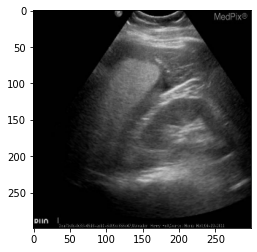

  8%|▊         | 120/1498 [25:48<4:49:58, 12.63s/it]

ORIGINAL ----------------
Modality: US - Ultrasound Plane: Axial  Anatomy: Abdomen -
Generalized   Findings: Focused Assessment with Sonography
for Trauma (FAST) scan positive in RUQ and LUQ for free
fluid.  CT abdomen showed fluid around spleen with contrast
suggesting active bleed.  Questionable splenic laceration.
Impression: Superior Mesenteric Vein laceration


AI GENERATED ------------
Modality: xr plain film plane mammo cc  Anatomy:
gastrointestinal and neuro   Findings: ultrasound images
demonstrate hyperechoic lesion in the right cerebellum with
a lobulated focal low density center and right lobe of mixed
attenuation   Impression: liver metastases demonstrates
small nodular enhancement


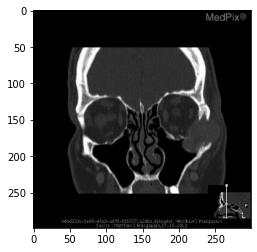

  8%|▊         | 121/1498 [26:01<4:48:54, 12.59s/it]

ORIGINAL ----------------
Modality: CT w/contrast (IV) Plane: Coronal  Anatomy:
Generalized   Findings: CT of the head 12/3/2010 » 3.5 x2.5
x2.3 cm invasive destructive mass at the junction of the
left zygomatic arch, left maxillary sinus and inferiolateral
wall of the left orbit »contains small bony fragments  MRI
of the head 12/14/2010 » 3.5cm expansile mass centered at
the malar eminence.  » Mass enhaced homogeneously except for
small areas of hypointensisty.  » Flow voids within the mass
MRA of the head  12/14/2010 » Enlarged blood vessels seen
extending toward and within the left orbital mass.   » The
hypervascularity of the mass is suggestive of a metastasis
CT of the abdomen and pelvis 1/25/2011 » 5 cm lower pole
left renal mass » Heterogeneus enhancement with contrast »
Contains calcifications » No renal vein involvement » No
significant lymph node enlargment  Post treatment CT of the
head 3/22/2011 » Resection of the mass » Lateral wall of the
orbit has been resected » Surgica

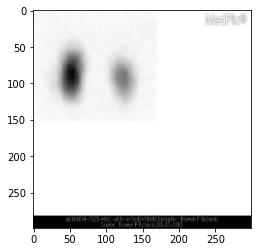

  8%|▊         | 122/1498 [26:13<4:48:00, 12.56s/it]

ORIGINAL ----------------
Modality: NM - Nuclear Medicine Plane: NOS - Not specified
Anatomy: Head and Neck (ex. orbit)   Findings: PREOPERATIVE
thyroid nuclear scan was performed:   I (131) 7.7 microcurie
was administered 24 hours prior to imaging and measurement
of the radioactive uptake was 13.8% (normal 8% - 30%). On
the day of imaging technetium 99m-pertechnetate 11.0
millicurie was administered thyroid imaging revealed a
photopenic region in the lateral aspect of the right thyroid
gland.  The findings consistent with a cold thyroid nodule.
POST-THYROIDECTOMY 1(123) scan demonstrated residual thyroid
activity in the thyroid bed with no evidence of
extrathyroidal malignancy.  I (131) ablation therapy
followed with a 185 millicurie dose.   Impression: Solitary
thyroid nodule


AI GENERATED ------------
Modality: nm nuclear medicine plane nos not specified
Anatomy: head and neck ex orbit   Findings: i123 24hour
thyroid uptake scan was performed the ct scan was performed
the ct the de

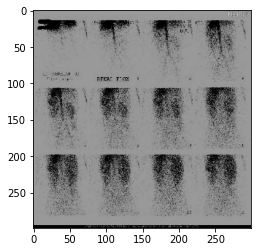

  8%|▊         | 123/1498 [26:27<4:51:32, 12.72s/it]

ORIGINAL ----------------
Modality: NM - Nuclear Medicine Plane: NOS - Not specified
Anatomy: Genitourinary   Findings: The MAG3 renal scan
demonstrated prompt but decreased blood flow to both
kidneys.  Cortical uptake in both kidneys was also
decreased, less in the left kidney.  The size of the left
kidney was also smaller than that of the right kidney.
Delayed excretion was present in both kidneys without
clearance.  In this patient, cortical transit in both
kidneys was markedly delayed; therefore, diuretic challenge
was not performed.    A CT scan of the abdomen and pelvis
demonstrated thickening of the stomach wall and a
conglomerate mass of para-aortic lymphadenopathy.  Bilateral
hydronephrosis was present.   Impression: Obstructive
hydronephrosis


AI GENERATED ------------
Modality: nm nuclear medicine plane frontal  Anatomy:
genitourinary   Findings: prompt perfusion to both kidneys
demonstrate air in both kidneys bilaterally the lower pole
and left kidney with small focal regi

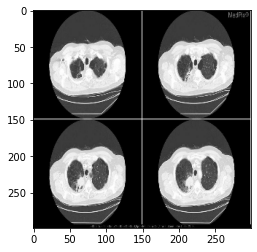

  8%|▊         | 124/1498 [26:39<4:49:54, 12.66s/it]

ORIGINAL ----------------
Modality: CT - Montage Plane: Axial  Anatomy: Chest,
Pulmonary (ex. Heart)   Findings: spiculated 3.4 cm mass
noted within the right upper lobe.   Impression:
Adenocarcinoma of the lung


AI GENERATED ------------
Modality: ct wcontrast iv plane axial  Anatomy: chest
pulmonary ex heart   Findings: contrast enhanced ct chest
images with iv contrast demonstrate a well defined mass in
the left upper lobe the right inferior pulmonary nodule with
a smaller lesion within the left lower lobe adjacent lung
Impression: pulmonary arteriovenous


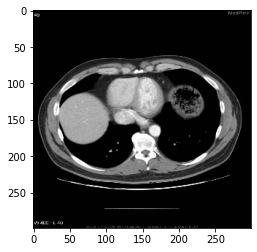

  8%|▊         | 125/1498 [26:52<4:52:04, 12.76s/it]

ORIGINAL ----------------
Modality: CT w/contrast (IV) Plane: Axial  Anatomy:
Cardiovascular (inc. Heart)   Findings: CXR: Dextrocardia is
present with the stomach bubble on the normal, left, side of
the patient.  No evidence of pneumonia.  CT: Dextrocardia
without evidence of situs inversus. A persistent left sided
SVC is seen with complete agensis of the left
brachiocephalic vein.  The left SVC can be followed to the
point where it drains into the coronary sinus.   Impression:
Persistent Left Superior Vena Cava (PLSVC)


AI GENERATED ------------
Modality: ct wcontrast iv plane axial  Anatomy:
gastrointestinal   Findings: pedunculated wellcircumscribed
heterogeneous mass emanates from the posterior gastric
fundus   Impression: gastrointestinal stromal tumor gist


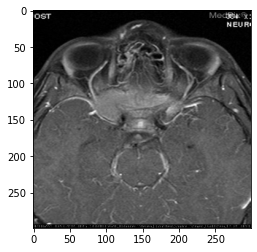

  8%|▊         | 126/1498 [27:05<4:53:15, 12.82s/it]

ORIGINAL ----------------
Modality: MR - T1W w/Gd (fat suppressed) Plane: Axial
Anatomy: Head and Neck (ex. orbit)   Findings: Sclerotic and
thickened bone at skull base which involves the lesser and
greater wing and  the ridge of the sphenoid bone.  The
ethmoid bone and both the anterior clinoid and optic foramen
are also affected.   Impression: Fibrous Dysplasia


AI GENERATED ------------
Modality: mr t1w wgd fat suppressed plane axial  Anatomy:
eye and orbit exclude ophthalmology   Findings: • bilateral
calcified intraocular masses  • right sided mass is larger
than left  • both masses enhance with contrast
administration  • no pineal region mass   Impression:
retinoblastomabilateral


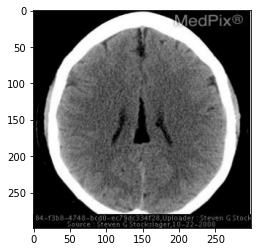

  8%|▊         | 127/1498 [27:18<4:52:26, 12.80s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Axial  Anatomy: Brain and
Neuro   Findings: Non-contrast head CT demonstrates a very
low attenuation lesions wrapped around the corpus callosum
that courses along the genu, body, and splenium without
disruption of the surrounding structures or other gross
abnormality.   Impression: Corpus Callosum Lipoma


AI GENERATED ------------
Modality: ct noncontrast plane axial  Anatomy: brain and
neuro   Findings: • high attenuation mass in anterior roof
of third ventricle on ct  • round mass in same location on
mri faint rim enhancement  • incidental pineal cyst is seen
on mri also with faint rim enhancement   Impression: colloid
cyst


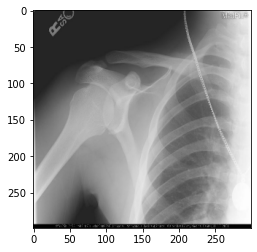

  9%|▊         | 128/1498 [27:31<4:54:59, 12.92s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: AP  Anatomy: MSK -
Musculoskeletal   Findings: There is a compression deformity
lesion of posterolateral aspect of the humeral head.  There
is a small fracture of the anterior aspect of the inferior
rim of the glenoid fossa.  There is minimal inferior
displacement of the small triangular fracture fragment. Both
Hill-Sachs and osseous Bankart lesions are noted.
Impression: Hill-Sachs lesion, osseous Bankart lesion.
Evidence of prior anterior glenohumeral dislocation.


AI GENERATED ------------
Modality: xr plain film plane ap  Anatomy: msk
musculoskeletal   Findings: plain films of the right
shoulder and arm centrally located large expansile and lytic
lesion of the proximal humeral metaphysis and diaphysis
there is an intertrochanteric fracture   Impression: simple
bone cyst pathologic fracture


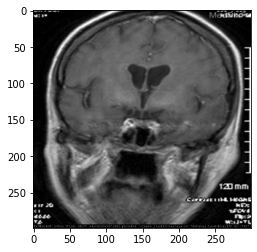

  9%|▊         | 129/1498 [27:44<4:55:19, 12.94s/it]

ORIGINAL ----------------
Modality: MR - T1W - noncontrast Plane: Coronal  Anatomy:
Brain and Neuro   Findings: •  High signal intensity changes
in the globus pallidus - bilateral, cerebral peduncles, and
centrum semiovale onT1, T2 and FLAIR •  Splenomegaly •
Cirrhosis of liver and vascular changes of portal
hypertension   Impression: Hepatic encephalopathy w/Globus
Pallidus hyperintensity


AI GENERATED ------------
Modality: mr t1w wgadolinium plane coronal  Anatomy: brain
and neuro   Findings: • enhancing mass in atrial portion of
right lateral ventricle  • no invasion of adjacent brain  •
no hydrocephalus   Impression: intraventricular meningioma


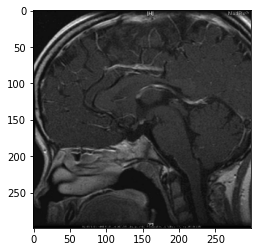

  9%|▊         | 130/1498 [27:57<4:54:00, 12.90s/it]

ORIGINAL ----------------
Modality: MR - T1W w/Gadolinium Plane: Sagittal  Anatomy:
Brain and Neuro   Findings: MRI of brain and sella with and
without contrast revealed anterior pituitary height of less
than 1mm   Impression: Empty Sella Syndrome


AI GENERATED ------------
Modality: mr t1w wgadolinium plane sagittal  Anatomy: brain
and neuro   Findings: ct and mri demonstrate aggresive
appearing hemorrhagic mass in the right frontal lobe there
is dural thickening overlying the mass there is also blood
underlying the dura   Impression: central nervous system
extraosseous ewings sarcoma


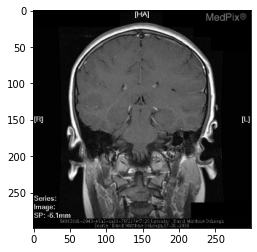

  9%|▊         | 131/1498 [28:10<4:53:59, 12.90s/it]

ORIGINAL ----------------
Modality: MR - T1W w/Gadolinium Plane: Coronal  Anatomy:
Brain and Neuro   Findings: Axial T1 and T2 images
demonstrate a 5 x 6 x 4 mm cystic structure at the normal
location of the pineal gland which is hypointense on T1 and
hyperintense on T2. Axial and Coronal T1W images after the
addition of gadolinium shows that the lesion does not
significantly enhance.   Impression: Pineal Cyst


AI GENERATED ------------
Modality: mr t1w noncontrast plane coronal  Anatomy: brain
and neuro   Findings: mri cervical spine with and contrast 1
cm in the right sided extraaxial comparison with cortical
disruption extending approximately 40 cm x 16 cm ap
dimension and a dense calcification located at the mid
portion of the right


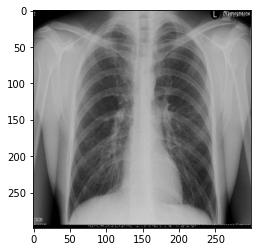

  9%|▉         | 132/1498 [28:23<4:56:13, 13.01s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: PA  Anatomy: Chest,
Pulmonary (ex. Heart)   Findings: Left apical pleural line
with superior crescentic area with absent pulmonary
markings.   Impression: Pneumothorax


AI GENERATED ------------
Modality: xr plain film plane pa  Anatomy: chest pulmonary
ex heart   Findings: pa and lateral chest radiographs
demonstrate a 15 x 23 cm right middle lung mass is a 37 cm
right pleural effusion ct confirms a small right pleural
effusion and an airfluid level axial that contains a


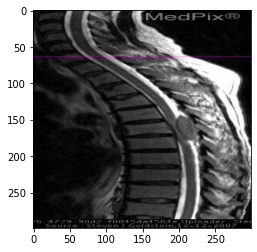

  9%|▉         | 133/1498 [28:36<4:56:24, 13.03s/it]

ORIGINAL ----------------
Modality: MR - T2 weighted Plane: Sagittal  Anatomy: MSK -
Musculoskeletal   Findings: •  Extradural mass lying behind
spinal cord at T5 level. Mass compresses the cord.  •  No
apparent bone involvement is observed   Impression: Multiple
Myeloma at T5 level


AI GENERATED ------------
Modality: mr t2 weighted plane sagittal  Anatomy: spine
Findings: • spinal cord tethered to l34 level  • small
central spinal canal  • lower cord divided into two through
elbow  • normal hemi chest  • of digital intensity on outer
sagittal sequences  • an little hernia is slow of the


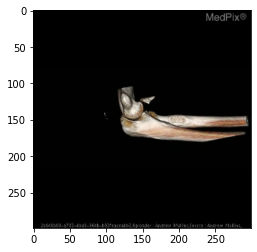

  9%|▉         | 134/1498 [28:49<4:55:58, 13.02s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Lateral  Anatomy: MSK -
Musculoskeletal   Findings: AP and lateral views of the
elbow in splint show posterior dislocation of the ulna with
associated displaced coronoid process fracture.  Post
reduction radiographs and 3D reconstruction from elbow CT
show reduction of the posterior dislocation with
anterosuperior displacement of the coronoid process.
Impression: Posterior ulnar dislocation with coronoid
process fracture


AI GENERATED ------------
Modality: ct noncontrast plane 3d reconstruction  Anatomy:
msk musculoskeletal   Findings: plain radiographs ·no
fractures or joint space irregularities ·retraction of the
1st mtp sesamoids when compared with old radiographs mri ·t2
hyperintensity within the plantar soft tissues at the 1st
mtp ·disruption of the plantar plate at the site


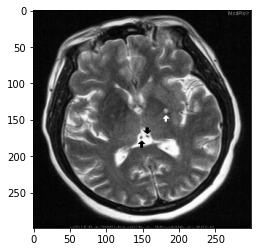

  9%|▉         | 135/1498 [29:02<4:54:56, 12.98s/it]

ORIGINAL ----------------
Modality: MR - T2 weighted Plane: Axial  Anatomy: Brain and
Neuro   Findings: » CT (acute) •  abnormal hyper-attenuation
in the right basal ganglia    (putamen and caudate head) •
old left basal ganglia lacunar infarct •  bilateral
cerebellar wedge lesions  » MRI (subacute - 3 days) •  T1W
hyperintensity in the same region as hyper-attenuation on CT
(putamen and caudate head) •  T2W hypointensity in basal
ganglia - putamen and caudate head   Impression: Nonketotic
Hyperglycemic Hemichorea/Hemiballismus


AI GENERATED ------------
Modality: mr t2 weighted plane axial  Anatomy: brain and
neuro   Findings: • ct shows thickening of the falx and the
tentorium bilaterally  • mri shows extensive bilateral
extraaxial subdural fluid consistent with hematoma sdh
overlying both cerebral hemispheres the sdh is also seen
layering in between the cerebral hemishperes


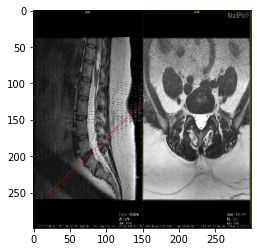

  9%|▉         | 136/1498 [29:15<4:54:21, 12.97s/it]

ORIGINAL ----------------
Modality: MR - T2 weighted Plane: Axial  Anatomy: Nerve,
central   Findings: 1. Cystic lesion with internal septation
present at the conus medullaris measuring approximately 3.6
CM in longitudinal dimension and .9 cm in AP dimension.
Syringomyelia noted at the visualized portion of thoracic
spinal cord. This could represent possible ependymoma versus
other neoplasm.  2. T12-L1 level: Minimal diffuse disc budge
of the annulus fibrosus which minimally impinges upon
anterior subarachnoid space.  3. L4-5 level: There is a
broad-based central disc hernation of the protrusion type
measuring 2 mm in AP dimension which impinges upon the
anterior surface of the thecal sac.  4. Partial
sacralization of L5 vertebra suspected.   Impression: Spinal
Cord Ependymoma pending histology results.


AI GENERATED ------------
Modality: mr t2 weighted plane sagittal  Anatomy: spine
Findings: mri of the lumbar spine revealed mild 1 l34 levels
there is a l45 level the l45 level the d

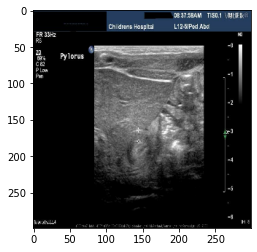

  9%|▉         | 137/1498 [29:28<4:55:26, 13.02s/it]

ORIGINAL ----------------
Modality: US - Ultrasound Plane: Sagittal  Anatomy:
Gastrointestinal   Findings: Supine AP abdominal radiograph
reveals a dilated gas-filled stomach, with an otherwise
gasless abdomen.    Sonographic grayscale images reveal a
thickened pyloric muscle, with a single wall measuring 4mm
in thickness and an overall length of 2 cm.   Impression:
Pyloric Stenosis


AI GENERATED ------------
Modality: us ultrasound plane transverse  Anatomy:
gastrointestinal   Findings: ultrasound images of the
gastric pylorus demonstrate an on all mesenteric artery
Impression: hypertrophic pyloric stenosis


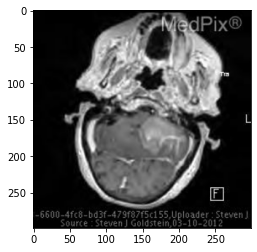

  9%|▉         | 138/1498 [29:41<4:54:32, 12.99s/it]

ORIGINAL ----------------
Modality: MR - T1W w/Gadolinium Plane: Axial  Anatomy:
Generalized   Findings: •  Enhancing mass in the left
cerebellar hemisphere. •  Mass is bright on DWI (restricted
diffusion)   Impression: Diffuse Large B-cell Lymphoma


AI GENERATED ------------
Modality: mr t1w wgadolinium plane axial  Anatomy: brain and
neuro   Findings: • multiple bilateral cerebral infarcts of
varying ages and sizes  • acute infarcts in the right
frontal lobe  • absent flow in the distal ica mca and aca
vessels   Impression: moyamoya


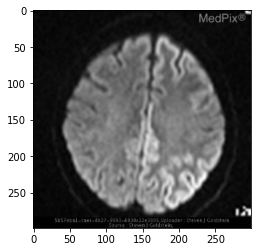

  9%|▉         | 139/1498 [29:54<4:54:29, 13.00s/it]

ORIGINAL ----------------
Modality: MR - DWI Diffusion Weighted Plane: Axial  Anatomy:
Brain and Neuro   Findings: Abnormal signal involving head
of caudate, putamen, and left partietal cortex on Flair, T2,
DWI and ADC map. No pathologic enhancement or mass effect.
Impression: Spongiform Encephalopathy;  presumed variant
Creutzfeldt-Jacob Disease


AI GENERATED ------------
Modality: mr dwi diffusion weighted plane axial  Anatomy:
brain and neuro   Findings: • bilateral temporal lobe
lesions  • enhancement of left frontal lobe lesion  •
hyperintense on t1 and t2 scans  • no contrast enhancement
Impression: oligodendroglioma


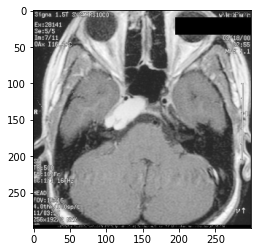

  9%|▉         | 140/1498 [30:07<4:54:28, 13.01s/it]

ORIGINAL ----------------
Modality: MR - T1W w/Gadolinium Plane: Axial  Anatomy: Head
and Neck (ex. orbit)   Findings: Abnormal hyperintense
lesion in the far anterior petrous apex on the patient's
right. Sharply marginated   Impression: Cholesterol
granuloma of the right petrous apex.


AI GENERATED ------------
Modality: mr t1w wgd fat suppressed plane axial  Anatomy:
head and neck ex orbit   Findings: • enhancing mass arising
in sphenopalatine foramen  • widening of the pterygopalatine
fossa  • mass extends into the nasal cavity nasopharynx and
invades the sphenoid sinus   Impression: juvenile
nasopharyngeal angiofibroma jna


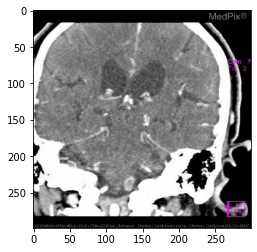

  9%|▉         | 141/1498 [30:20<4:53:45, 12.99s/it]

ORIGINAL ----------------
Modality: CT - Montage Plane: Coronal  Anatomy: Brain and
Neuro   Findings: •  MRI: Bilateral Cerebellar infarcts of
varying ages •  CTA: Dissection of  high cervical and
intracranial portion of the left vertebral artery
Impression: Vertebral Artery Dissection with Cerebellar
Infarction


AI GENERATED ------------
Modality: ct wcontrast iv plane coronal  Anatomy: brain and
neuro   Findings: contrastenhanced head ct and mr images
demonstrating a ringenhancing lesion in the right temporal
lobe extending through an eroded tegmen tympani vasogenic
edema surrounds the ring enhancing lesion   Impression:
cerebral abscess


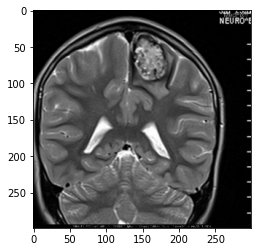

  9%|▉         | 142/1498 [30:33<4:53:25, 12.98s/it]

ORIGINAL ----------------
Modality: MR - T2 weighted Plane: Coronal  Anatomy: Brain
and Neuro   Findings: Complex lesion with cystic and solid
components in the left frontal lobe.  Complex pattern of
high and low signal intensity suggest either melanin or
blood products within the lesion.  Little or no mass effect
nor edema suggest a long standing process.  No large
vascular structures are present on MRA.   Impression:
Cerebral Cavernous Malformation ("hemangioma")


AI GENERATED ------------
Modality: mr t2 weighted plane coronal  Anatomy: brain and
neuro   Findings: • solid mass arising from vermis and
extending into 4th ventricle  • mass is hyperintense to
brain on both t2 and flair  • the lesion does not enhance
Impression: juvenile pilocytic astrocytoma


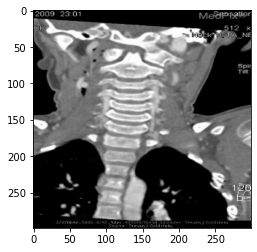

 10%|▉         | 143/1498 [30:46<4:54:31, 13.04s/it]

ORIGINAL ----------------
Modality: CT w/contrast (IV) Plane: Coronal  Anatomy: Brain
and Neuro   Findings: Lacerations back of neck and
suboccipital region. Bilateral subcutaneous emphysema in the
neck. No vascular injury.   Impression: Penetrating injury
to the neck secondary to dog attack


AI GENERATED ------------
Modality: mr t1w noncontrast plane coronal  Anatomy: left
blank   Findings: extradural mass centered on temporal bone
extending into middle crainal fossa and temporal scalp
extraconal mass in the lateral aspect of right orbit
retroperitoneal enhancing mass   Impression: neuroblastoma


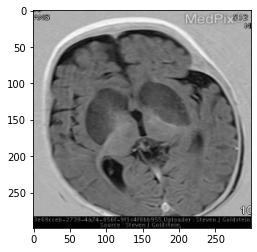

 10%|▉         | 144/1498 [30:59<4:55:04, 13.08s/it]

ORIGINAL ----------------
Modality: MR - STIR Plane: Axial  Anatomy: Generalized
Findings: •  Localized signal lesions in basal ganglia and
midbrain •  Lesions are hyperintense on T2 MR and
hypointense on T1 MR •  Lesions have restricted diffusion on
DWI/ADC map   Impression: Anoxic (hypoxic) injury


AI GENERATED ------------
Modality: mr flair plane axial  Anatomy: brain and neuro
Findings: • thrombosis anterior half of superior sagittal
sinus  • bilateral frontal lobe venous infarcts  • artifact
from metallic dental braces   Impression: superior sagittal
sinus thrombosis with hemorrhagic venous infarction


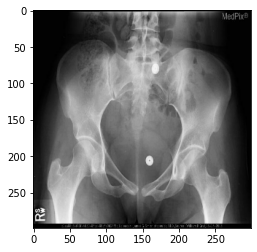

 10%|▉         | 145/1498 [31:12<4:52:48, 12.98s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: AP  Anatomy: MSK -
Musculoskeletal   Findings: MR shows "marrow edema" as low
signal on T1W and corresponding high signal on the T2W
Impression: Incomplete Fracture Proximal Left Femur


AI GENERATED ------------
Modality: xr plain film plane ap  Anatomy: msk
musculoskeletal   Findings: ap and frogleg radiographs of
the hips demonstrate asymmetric sclerosis in the inferior
and articular space is a small osseous fusion of the medial
aspect of the femoral neck as well as a compressive inferior
right femoral neck mri


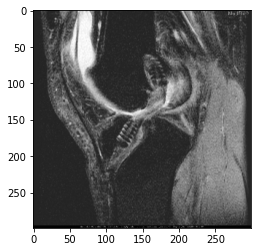

 10%|▉         | 146/1498 [31:25<4:53:52, 13.04s/it]

ORIGINAL ----------------
Modality: MR - PDW Proton Density Plane: Sagittal  Anatomy:
MSK - Musculoskeletal   Findings: Sagittal proton density
images of the knee with and without fat suppression
demonstrate screw tunnels in the distal femur and proximal
tibia indicative of prior ACL grafting.  The tibial screw
tunnel lies anterior to a line drawn along the intercondylar
roof (Bloomensaat’s line).  The ACL graft appears draped
over the distal portion of the intercondylar roof.  There is
increased signal intensity within the distal portion of the
graft.   Impression: ACL graft impingement


AI GENERATED ------------
Modality: mr pdw proton density plane sagittal  Anatomy: msk
musculoskeletal   Findings: normal shoulder radiography mri
and gross   Impression: normal shoulder radiography mri and
gross sections


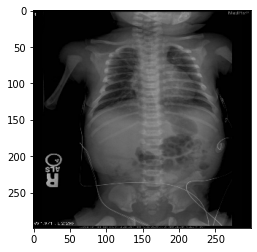

 10%|▉         | 147/1498 [31:38<4:54:22, 13.07s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: Frontal  Anatomy: Chest,
Pulmonary (ex. Heart)   Findings: High lung volumes with
"coarse, ropey" perihilar markings.   Impression: Meconium
Aspiration Syndrome


AI GENERATED ------------
Modality: xr plain film plane ap  Anatomy: gastrointestinal
Findings: upright plain radiograph of the chest and abdomen
shows paucity of bowel gas in the right abdomen and no free
intraperitoneal air contrast enema demonstrates a filling
defect in the hepatic flexure of the colon   Impression:
intussusception


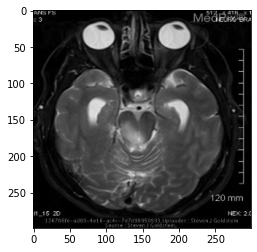

 10%|▉         | 148/1498 [31:51<4:51:28, 12.95s/it]

ORIGINAL ----------------
Modality: MR - T2 weighted Plane: Axial  Anatomy: Head and
Neck (ex. orbit)   Findings: •  Enhancing mass in
quadrigeminal plate cistern that was not present on MRI
study from 6 months ago. •  Edema in brain stem not present
on prior MRI. •  Secondary Hydrocephalus.   Impression:
Squamous Cell Carcinoma, malignant transformation of
Epidermoid Cyst.


AI GENERATED ------------
Modality: mr t2 weighted plane axial  Anatomy: brain and
neuro   Findings: • left cerebellar subacute hematoma with
some mass effect  • 4th ventricle minimally compressed  •
hemosiderin ring surrounding hematoma  • lineartubular
enhancement  • popcorn lesion medial and inferior to
hematoma   Impression: developmental venous anomaly dva and
cavernous malformation


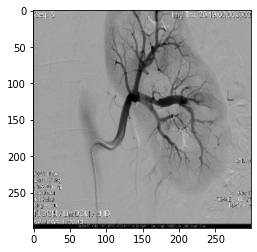

 10%|▉         | 149/1498 [32:04<4:50:00, 12.90s/it]

ORIGINAL ----------------
Modality: AN - Angiogram Plane: NOS - Not specified
Anatomy: Genitourinary   Findings: •  splenic artery
dissection and aneurysm of false lumen •  R renal artery
bead-on-a-string appearance •  Acute R renal infarct •
Bilateral external iliac webbing •  Left external iliac
artery dissection •  remote infarcts of bilateral kidneys
with atrophy •  dissected small intrarenal artery in R
kidney •  SMA saccular aneurysm •  Jejunal branch of SMA
complete occlusion (remote) •  Left sided intrarenal
arterial dissection with aneurysm of false lumen
Impression: Fibromuscular dysplasia


AI GENERATED ------------
Modality: an angiogram plane ap  Anatomy: brain and neuro
Findings: • acute right frontal lobe infarct  • focal
stenosis right mca superior division  • occlusion left mca
m1 segment   Impression: moyamoya


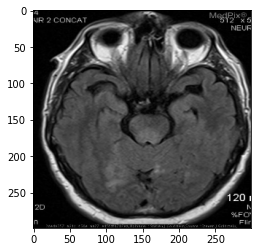

 10%|█         | 150/1498 [32:16<4:48:17, 12.83s/it]

ORIGINAL ----------------
Modality: MR - FLAIR Plane: Axial  Anatomy: Brain and Neuro
Findings: •  Bilateral Thalamic infarcts •  Left Occipital
lobe infarction  •  Brainstem infarct •  Bilateral
Cerebellar infarcts   Impression: Basilar artery thrombosis,
cerebral infarction


AI GENERATED ------------
Modality: mr flair plane axial  Anatomy: brain and neuro
Findings: • multiple bilateral cerebral infarcts of varying
ages and sizes  • acute infarcts in the right frontal lobe
• absent flow in the distal ica mca and aca vessels
Impression: moyamoya


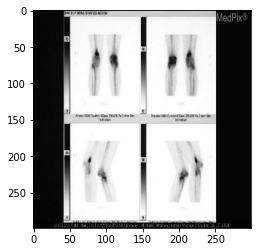

 10%|█         | 151/1498 [32:29<4:48:42, 12.86s/it]

ORIGINAL ----------------
Modality: NM - Nuclear Medicine Plane: Multiple or Montage
Anatomy: MSK - Musculoskeletal   Findings: Multilobulated
lesion at right distal femoral metaphysis.  Increased
radiotracer uptake on scintigram at site of lesion, along
with increased uptake in the left knee in a pattern
suggestive of arthropathic change.   Impression:
Nonossifying Fibroma


AI GENERATED ------------
Modality: nm nuclear medicine plane nos not specified
Anatomy: msk musculoskeletal   Findings: nuclear bone scan
lesion at the left skull base ct scan erosive lesion
involving the left occipital condyle in the region of the
hypoglossal canal   Impression: bone metastasis left
occipital condyle from colon cancer


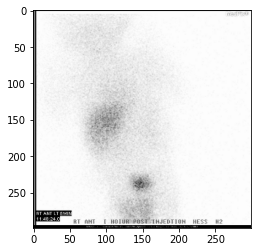

 10%|█         | 152/1498 [32:42<4:47:16, 12.81s/it]

ORIGINAL ----------------
Modality: NM - Nuclear Medicine Plane: Transverse  Anatomy:
Multisystem   Findings: Ultrasound images demonstrated no
intrahepatic biliary ductal dilitation to suggest an
obstructive process i.e. biliary plug as the cause of
jaundice.  Also no cystic structure near the gallbladder
fossa was demonstrated, hence a choledocal cyst was ruled
out as the cause of jaundice.  A small gallbladder was seen
which did not help in the differential between hepatitis vs.
biliary atresia.  No discernable extrahepatic biliary ducts
were visualized on sonography. On HIDA scan, radiotracer
uptake by hepatocytes are adequate, but tracer never reaches
the GI tract, even on 24-hour delayed imaging.   Impression:
Alagille Syndrome


AI GENERATED ------------
Modality: nm nuclear medicine plane frontal  Anatomy:
gastrointestinal   Findings: ct images demonstrate
cholelithiasis gallbladder wall thickening positive
sonographic murphys sign was present during examination
cholescintigrap

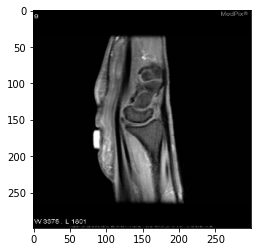

 10%|█         | 153/1498 [32:55<4:46:09, 12.77s/it]

ORIGINAL ----------------
Modality: MR - T1W w/Gadolinium Plane: Sagittal  Anatomy:
Nerve, peripheral   Findings: Grossly thickened median nerve
with prominent low-signal fascicles that enhance after
contrast administration.   Impression: Neural Fibrolipoma
(Fibrolipomatous Hamartoma)


AI GENERATED ------------
Modality: mr t1w noncontrast plane sagittal  Anatomy: msk
musculoskeletal   Findings: mri images show an accessory
muscle posteromedial to the peroneus brevis and longus
tendons and anterolateral to the achilles tendon the signal
characteristics of a double pcl sign is present within the
visualized on all mri sequences   Impression: accessory


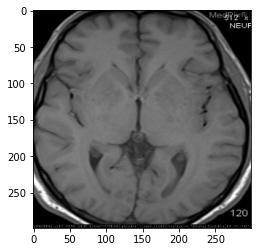

 10%|█         | 154/1498 [33:07<4:45:20, 12.74s/it]

ORIGINAL ----------------
Modality: MR - T1W - noncontrast Plane: Axial  Anatomy:
Brain and Neuro   Findings: •  CT - bilateral low density
lesions in the globus pallidi •  MRI - Lesions in both
medial basal ganglia without mass effect (restricted
diffusion)   Impression: Carbon monoxide poisoning


AI GENERATED ------------
Modality: mr t1w noncontrast plane axial  Anatomy: brain and
neuro   Findings: • bilateral temporal lobe lesions with
increase cortical signal on t2 flair and dwi scans  • no
basal ganglia lesions are evident  • artifact from left
cochlear implant   Impression: spongioform encephalopathy
presumed variant creutzfeldtjakob disease


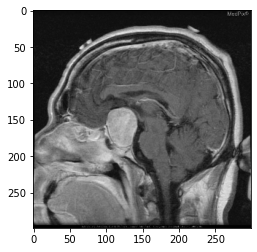

 10%|█         | 155/1498 [33:20<4:44:44, 12.72s/it]

ORIGINAL ----------------
Modality: MR - T1W w/Gadolinium Plane: Sagittal  Anatomy:
Brain and Neuro   Findings: Large mass on T1 isointense to
gray matter arising from the sella with mass effect on the
optic chiasm. Post contrast shows heterogeneous enhancement.
No visible pituitary gland seen.   Impression: Pituitary
Macroadenoma


AI GENERATED ------------
Modality: mr t1w wgadolinium plane sagittal  Anatomy: brain
and neuro   Findings: ct there are numerous fat attenuation
foci of increased density within the subarachnoid space in
the region of the ileal mri mild diffuse cerebral edema
Impression: metastatic disease presumed breast


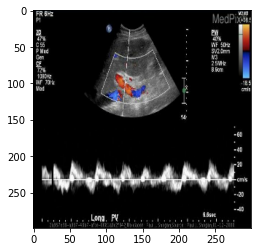

 10%|█         | 156/1498 [33:33<4:45:59, 12.79s/it]

ORIGINAL ----------------
Modality: US-D - Doppler Ultrasound Plane: Longitudinal
Anatomy: Gastrointestinal   Findings: Sonographic evaluation
of the gallbladder demonstrates diffuse gallbladder wall
thickening.  There is no evidence of cholelithiasis, or
biliary sludge.  The common bile duct measured 6 mm, which
is acceptable for this patient's age.  Duplex Doppler
sonogram of portal vein shows highly pulsatile blood flow.
Color Doppler shows both blue and red, indicating flow
reversal.  Duplex Doppler waveforms of the inferior vena
cava (IVC), and hepatic vein demonstrate normal triphasic
flow with abnormally high amplitude retrograde flow in the
IVC and hepatic vein, caused by high right heart pressures
during the cardiac cycle.  PA chest radiograph demonstrates
cardiomegaly, a small right-sided pleural effusion and
increased interstitial markings.  Unenhanced axial CT image
through the level of the heart demonstrates small bilateral
pleural effusions.   Impression: Hepatic Congesti

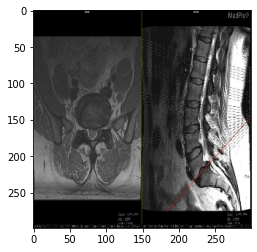

 10%|█         | 157/1498 [33:46<4:45:39, 12.78s/it]

ORIGINAL ----------------
Modality: MR - T2 weighted Plane: Other View (see caption)
Anatomy: Generalized   Findings: MRI BRAIN: 2010  1. AXIAL
FLAIR with GADOLINIUM: EXTENSIVE MS PLAQUES, ESPECIALLY
PERIVENTRICULAR,WHICH INDICATES ADVANCED DISEASE  2. AX IR
FSPGR: PLAQUES NOTED ON T1 IMAGING; ALSO INDICATES ADVANCED
DISEASE STATUS.  3. SAGITTAL T2 FLAIR: EXTENSIVE MS PLAQUES
SEEN, ESPECIALLY PERIVENTRICULARLY, INDICATING ADVANCED
DISEASE. PLAQUES ARE NOTED TO BE PERPENDICULAR TO THE
VENTRICLES, ANOTHER SIGN THAT POINT TO LESIONS BEING DUE TO
MS ETIOLOGY, RATHER THAN OTHER PATHOLOGY SUCH AS MULTI-
INFARCT OR ISCHEMIC VASCULAR DISEASE.   MRI BRAIN 2012:  1.
BR AX FLAIR plus GAD:EXTENSIVE MS PLAQUES, ESPECIALLY
PERIVENTRICULAR,WHICH INDICATES ADVANCED DISEASE  2.
EXTENSIVE MS PLAQUES, ESPECIALLY PERIVENTRICULAR,WHICH
INDICATES ADVANCED DISEASE.   CERVICAL SPINE MRI FINDINGS:
1. STRAIGHTENING OF THE NORMAL CERVICAL LORDOSIS WHICH MIGHT
BE SECONDARY TO MUSCLE SPASM.  2. AT THE C2-C3 LEVEL,

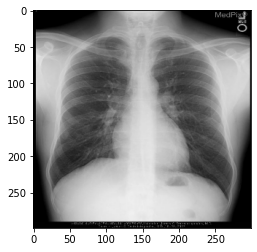

 11%|█         | 158/1498 [33:59<4:45:22, 12.78s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: PA  Anatomy: Chest,
Pulmonary (ex. Heart)   Findings: Normal   Impression:
Normal Chest Review


AI GENERATED ------------
Modality: xr plain film plane pa  Anatomy: chest pulmonary
ex heart   Findings: pa and lateral chest radiographs
demonstrate a 15 x 23 cm right middle lung ct of the thorax
lung windows reveals that the right hilum with ill defined
mass in the right medial segment right lower lobe


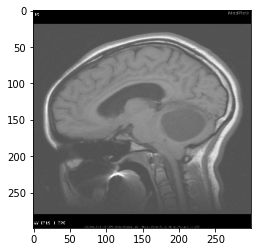

 11%|█         | 159/1498 [34:11<4:44:48, 12.76s/it]

ORIGINAL ----------------
Modality: MR - T1W - noncontrast Plane: Sagittal  Anatomy:
Brain and Neuro   Findings: 5 cm cystic mass with mural
nodule in left cerebellar hemisphere.  Smaller satellite
lesion.  Mass effect on cerebellar vermis and brainstem.
Mild lateral and third ventricular enlargement.
Impression: Juvenile Pilocytic Astrocytoma


AI GENERATED ------------
Modality: mr t1w noncontrast plane sagittal  Anatomy: brain
and neuro   Findings: ct images demonstrate a 4 mm calcific
density just lateral to the right caudate nucleus mri
demonstrates central high signal on t1 and t2 weighted
images the low signal intesity within this lesion on the gre
images there


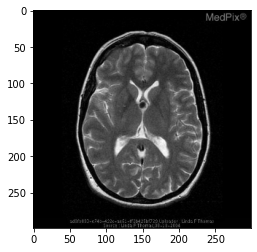

 11%|█         | 160/1498 [34:24<4:45:18, 12.79s/it]

ORIGINAL ----------------
Modality: MR - T2 weighted Plane: Axial  Anatomy: Brain and
Neuro   Findings: 11 x 11 x 13 mm nonenhancing well-
circumscribed mildly T1 hyperintense and markedly T2
hypointense round mass in the anterior-superior third
ventricle without ventricular enlargement.   Impression:
Colloid cyst.


AI GENERATED ------------
Modality: mr t2 weighted plane axial  Anatomy: brain and
neuro   Findings: • axial ct image demonstrates bilateral
extraaxial subdural fluid collections which aremore
prominent along the frontal convexities these have a
slightly and are consistent with a csf and are less than
calvarium and are likely physiological 2 show


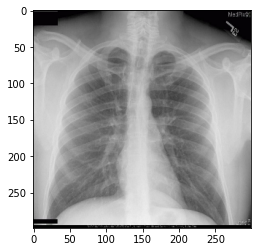

 11%|█         | 161/1498 [34:37<4:43:41, 12.73s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: PA  Anatomy: Chest,
Pulmonary (ex. Heart)   Findings: Chest radiograph shows
well circumscribed mass projecting over lower thoracic
spine, best seen on lateral view.  CT shows well
circumscribed mass in medial left hemithorax, paraspinal
region, with fat attenuation, and communication with
retroperitoneal fat.   Impression: Bochdalek Hernia


AI GENERATED ------------
Modality: xr plain film plane pa  Anatomy: chest pulmonary
ex heart   Findings: pa and lateral chest radiographs
demonstrate a 15 x 23 cm right middle lung ct of the thorax
lung windows reveals that the right hilum with ill defined
mass in the right medial segment right lower lobe


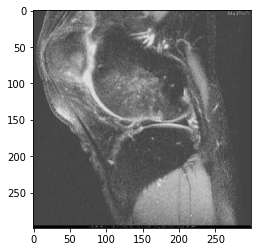

 11%|█         | 162/1498 [34:49<4:43:27, 12.73s/it]

ORIGINAL ----------------
Modality: MR T2* gradient,GRE,MPGR,SWAN,SWI Plane: Sagittal
Anatomy: MSK - Musculoskeletal   Findings: Axial and coronal
T2 weighted fatsat and a sagital GRE images of the left knee
demonstrated diffused increased bright signal throughout the
patella and lateral aspect of the lateral femoral condyle.
The is increased bright signal and irregularity to the
cartilage of the medial patellar facet and trochlea. There
is a small effusion; medial and lateral retinculum are
intact.   Impression: Traumatic Transient Lateral Patellar
Dislocation.


AI GENERATED ------------
Modality: mr pdw proton density plane sagittal  Anatomy: msk
musculoskeletal   Findings: normal shoulder radiography mri
and gross   Impression: normal shoulder radiography mri and
gross sections


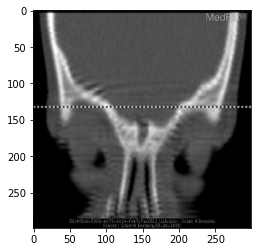

 11%|█         | 163/1498 [35:02<4:43:04, 12.72s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Coronal  Anatomy: Nerve,
central   Findings: - Fluorscopy  Contrast tractography
reveals a sinus tract extending from the skin surface to the
nasofrontal bone at the midline.  Contrast is seen outlining
a central filling defect at the distal aspect of the tract.
- CT  Osseous defect at the midline nasofrontal interface.
- MR  Low T1/High T2 signal nasal dermal sinus at the
midline nasofrontal interface with mixed signal mass at the
fonticulus frontalis .   Impression: Dermoid Cyst,
Nasofrontal with remnant tract to skin surface.


AI GENERATED ------------
Modality: ct noncontrast plane coronal  Anatomy: head and
neck ex orbit   Findings: rt mandibular condyle fractured
angulated and displaced   Impression: fracture


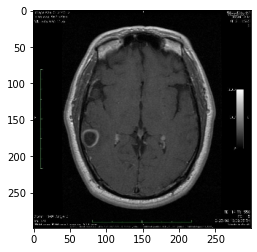

 11%|█         | 164/1498 [35:15<4:44:40, 12.80s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Axial  Anatomy: Brain and
Neuro   Findings: •  Solitary ring-enhancing lesion in the
right temporal lobe. •  Thin and smooth rim of enhancement •
Small chunk of calcification in the lateral/peripheral rim
Impression: Cysticercosis


AI GENERATED ------------
Modality: mr t1w wgadolinium plane axial  Anatomy: brain and
neuro   Findings: noncontrast ct shows hypodensity in l
parietal lobe with no visible compression fractures no
visible compression fractures no definite destruction of the
lesions within the soft tissues indicative of a large amount
of edema around the mass the


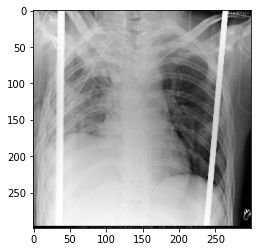

 11%|█         | 165/1498 [35:28<4:47:09, 12.93s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: AP  Anatomy:
Gastrointestinal   Findings: CXR shows well defined soft
tissue opacity in right lower hemithorax.  Cardiomediastinal
silhouette is normal.  Single coronal reformat of chest CT
with contrast demonstrates superior herniation of the liver
into the chest due to hemidiaphragm rupture.   Impression:
Diaphragmatic Rupture and liver herniation


AI GENERATED ------------
Modality: xr plain film plane pa  Anatomy: chest pulmonary
ex heart   Findings: cxr prominent bilateral hila when
compared with prior cxr 5 months prior peripheral tapering
of pulmonary vasculature new airspace opacification superior
segment left lower lobe seen best on lateral view ct pedvt
large clot burden involving majority


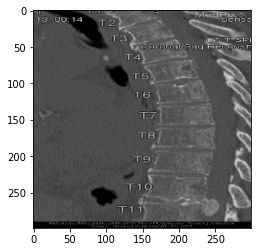

 11%|█         | 166/1498 [35:41<4:45:28, 12.86s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Sagittal  Anatomy: Spine
Findings: Calcified extradural mass adjacent to the T10-11
disc space, compressing the spinal cord.  No enhancement of
the mass noted following contrast administration
Impression: Calcified and Herniated Thoracic Disc


AI GENERATED ------------
Modality: ct noncontrast plane sagittal  Anatomy: spine
Findings: • prevertebral soft tissue hematoma  • fracture
through the left c4 lateral mass and laminar arch with
unilateral perched c45 facets on the right  • herniated and
disrupted disk c45 facets with some disrupted disk c45
facets on the c56 level


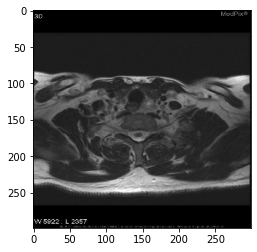

 11%|█         | 167/1498 [35:54<4:43:33, 12.78s/it]

ORIGINAL ----------------
Modality: MR - T2 weighted Plane: Axial  Anatomy: Endocrine
(clinical)   Findings: - Ultrasound images show a well-
defined hypoechoic mass just posterior to the inferior
aspect of the left lobe of the thyroid. - Tc-99m Sestamibi
scan shows delayed radiotracer accumulation within the
inferior left thyroid bed. - MRI images show a heterogeneous
T2 lesion that enhances on T!-post Gadolinium.   Impression:
Parathyroid Adenoma


AI GENERATED ------------
Modality: mr t2 weighted plane axial  Anatomy: genitourinary
Findings: there are 2 seperate horns to the fundal region of
the uterus with a indentation or concave appearance to the
contour of the fundus that has bowel and omental fat sitting
in the concavity the 2 horns are seen to


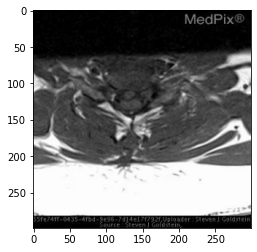

 11%|█         | 168/1498 [36:06<4:42:38, 12.75s/it]

ORIGINAL ----------------
Modality: MR - T1W - noncontrast Plane: Axial  Anatomy:
Spine   Findings: Ossification of posterior longitudinal
ligament in cervical spine.  Ligament is low signal
intensity on T2 and Gradient Echo scans. Severe cord
compress at multiple cervical levels.   Impression: Ossified
posterior longitudinal ligament (OPLL)


AI GENERATED ------------
Modality: mr t1w wgd fat suppressed plane axial  Anatomy:
msk musculoskeletal   Findings: axial t2weighted
fatsaturated fat saturated mr images demonstrate sagittal
lesion in the proximal to the articular space and
subchondral pattern of enhancement of the foot with a focal
area of low signal intensity on the t1wi and


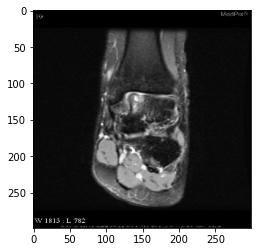

 11%|█▏        | 169/1498 [36:19<4:41:12, 12.70s/it]

ORIGINAL ----------------
Modality: MR - FLAIR Plane: Coronal  Anatomy: MSK -
Musculoskeletal   Findings: AP and mortise radiographs of
the left ankle shows a lucency in the medial talar dome.
T1-weighted sagittal MR image of the left ankle shows a
focus of low signal intensity in the talar dome.  Coronal
proton-density MR image with fat saturation and sagittal
STIR MR image shows a focal high-signal-intensity
osteochondral lesion of the medial talar dome with
associated edema in the talus   Impression: Osteochondritis
dissecans.


AI GENERATED ------------
Modality: mr t2 weighted plane coronal  Anatomy: msk
musculoskeletal   Findings: plain radiographs demonstrate
thickening of the achilles tendon convex   Impression: of
achilles tendon on the posterior margin of kagers fat pad
and a lower limits normal toygars angle mr   Findings:
demonstrates focal thickening of the achilles tendon
increased t2w


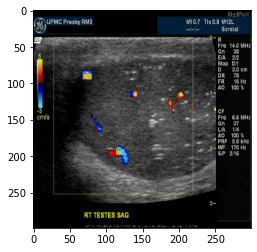

 11%|█▏        | 170/1498 [36:32<4:43:03, 12.79s/it]

ORIGINAL ----------------
Modality: US - Ultrasound Plane: Longitudinal  Anatomy:
Genitourinary   Findings: Ultrasound images demonstrate a
normal-sized right testicle with multiple punctate
nonshadowing echogenic foci (with occasional ring down
artifact) consistent with testicular microliths.  In the
upper pole of the right testicle is an isoechoic mass which
was new from a prior ultrasound and is worrisome for a germ
cell tumor.   Impression: Testicular Microlithiasis


AI GENERATED ------------
Modality: us ultrasound plane sagittal  Anatomy:
genitourinary   Findings: static gray scale sonographic
images demonstrate multiple left peritesticular small
rounded and tubular structures that communicate with each
other appreciated on realtime cine images consistent with
dilated peristesticular veins most of these structures are
approximately 3 mm in diameter color flow


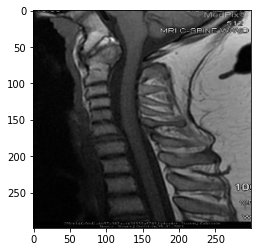

 11%|█▏        | 171/1498 [36:46<4:48:46, 13.06s/it]

ORIGINAL ----------------
Modality: MR - T1W - noncontrast Plane: Sagittal  Anatomy:
MSK - Musculoskeletal   Findings: Plain Film- Fusion C1 to
C6. Unstable at C6-7 disc with flexion extension views.
MRI- Edema in C6-7 disc and posterior paraspinal soft
tissues.   Impression: Juvenile rheumatoid Arthritis


AI GENERATED ------------
Modality: mr t1w noncontrast plane sagittal  Anatomy: spine
Findings: • severe congenital spinal stenosis  • large
intraspinal mass centered at l45 disk space » extradural vs
intradural  • no enhancement of mass following contrast
administration   Impression: l4l5 herniated disc with a
sequestered fragment


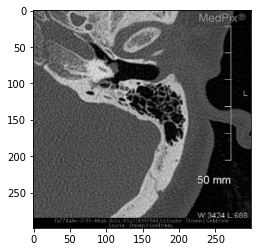

 11%|█▏        | 172/1498 [36:59<4:49:16, 13.09s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Axial  Anatomy: Brain and
Neuro   Findings: 5 mm soft tissue mass adjacent to
promontory of cochlea. No bone erosion.   Impression: Glomus
tympanicum tumor (paraganglioma)


AI GENERATED ------------
Modality: ct noncontrast plane axial  Anatomy: head and neck
ex orbit   Findings: • longitudinal fracture passing through
anterior wall of external auditory canal into tmj  • the
fracture extends along the floor of the middle cranial fossa
into the sphenoid sinus   Impression: longitudinal petrous
temporal bone fracture


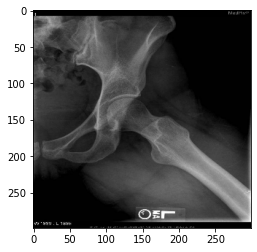

 12%|█▏        | 173/1498 [37:12<4:52:52, 13.26s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: Lateral  Anatomy: MSK -
Musculoskeletal   Findings: Plain films of the left hip
demonstrate subtle periosteal reaction along the medial
aspect of basicervical portion of femoral neck.  T1W image
demonstrates a line of low signal in the medial aspect of
the basicervical neck which does not extend through the
entire neck.  On T2W images there is surrounding increased
signal consistent with edema.   Impression: Femoral Neck
Stress Fracture


AI GENERATED ------------
Modality: xr plain film plane ap  Anatomy: msk
musculoskeletal   Findings: plain films of the left shoulder
and arm centrally located large expansile and lytic lesion
of the proximal humeral metaphysis and diaphysis there is an
intertrochanteric fracture   Impression: simple bone cyst
pathologic fracture


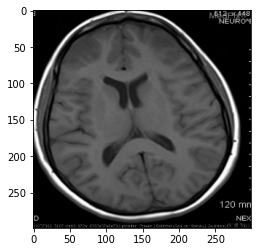

 12%|█▏        | 174/1498 [37:26<4:51:42, 13.22s/it]

ORIGINAL ----------------
Modality: MR - T1W - noncontrast Plane: Axial  Anatomy:
Brain and Neuro   Findings: •  CT - Bilateral frontal lobe
lesions with mild mass effect.  •  MRI - Cortical and gyral
enhancement of the frontal lobe lesions. •  DWI - No
restricted diffusion  •  MRV - Occlusion of the anterior
aspect of the Superior Sagittal Sinus.   Impression: Venous
Infarction from Sinus Thrombosis


AI GENERATED ------------
Modality: mr t1w noncontrast plane axial  Anatomy: brain and
neuro   Findings: • left parietooccipital mass with both
fluid cystic and solid components  • there is enhancement of
both the cyst walls and solid portions of the mass
Impression: oligodendroglioma malignant


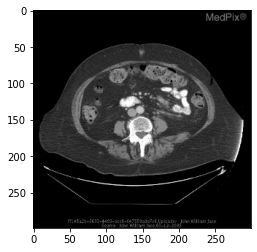

 12%|█▏        | 175/1498 [37:39<4:49:46, 13.14s/it]

ORIGINAL ----------------
Modality: CT w/contrast (IV) Plane: Axial  Anatomy: Abdomen
- Generalized   Findings: Early: - Acute right portal venous
thrombosis - Peripheral hepatic septic emboli with
infarction - Septic thrombophlebitis - Left retroperitoneal
abscess  Late: - Chronic right portal venous thrombosis with
early cavernous transformation of the porta hepatis -
Resolution of hepatic lesions and septic thrombophlebitis -
Decrease in size of retroperitoneal abscess   Impression:
Portal Venous Thrombosis


AI GENERATED ------------
Modality: ct gi iv contrast plane axial  Anatomy:
gastrointestinal   Findings: 12cm heterogeneous round soft
tissue density mass with rim enhancement containing at least
3 1cm round calcific density structures in the region of the
gall bladder no separate gallbladder was identified
Impression: complicated cholecystitis gangrenous
cholecystitis with focal perforation


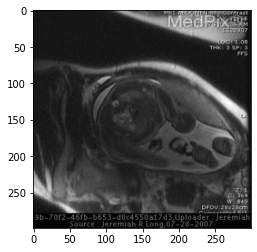

 12%|█▏        | 176/1498 [37:51<4:46:54, 13.02s/it]

ORIGINAL ----------------
Modality: MR - T2 weighted Plane: Axial  Anatomy: Chest,
Pulmonary (ex. Heart)   Findings: Ultrasound images of the
gravid uterus (32 weeks gestational age) demonstrate a large
cystic mass within the right hemithorax without significant
Doppler flow and minimal leftward mediastinal shift.  Fetal
MR images (single shot fast spin echo T2 sequences) in
multiple planes demonstrate a mass replacing the right lower
lobe with multiple distinct cystic lesions of varying sizes
within.  The lesion has some mass effect on both the right
middle and upper lobes.  There is minimal leftward
mediastinal shift. No feeding vessels were identified.  No
other fetal abnormalities were present.   Impression:
Congenital Cystic Adenomatoid Malformation of the Lung


AI GENERATED ------------
Modality: mr t2 weighted plane sagittal  Anatomy: msk
musculoskeletal   Findings: long head biceps brachii tendon
rupture with distal retraction high signal intensity is
present along bicipital g

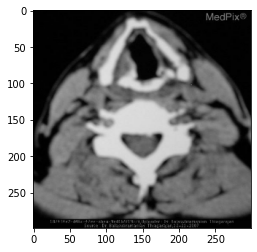

 12%|█▏        | 177/1498 [38:04<4:45:29, 12.97s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Axial  Anatomy: Head and
Neck (ex. orbit)   Findings: CT scan plain neck -  Axial
cuts show a radio opaque mass arising from the right
pyriform fossa, extending in to the post cricoid region.
The inlet of larynx seen to be occluded.   Impression:
Squamous cell carcinoma moderately differentiated


AI GENERATED ------------
Modality: ct gi iv contrast plane axial  Anatomy:
gastrointestinal   Findings: o enlarged colon tail with o
barium filled appendix with appendicolith o fatty stranding
of the appendicolith o inflammatory stranding homogenous
fluid   Impression: appendicitis with appendicolith


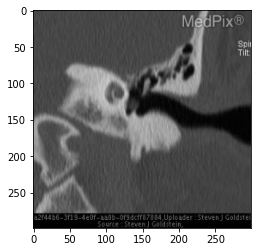

 12%|█▏        | 178/1498 [38:17<4:44:55, 12.95s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Coronal  Anatomy: Brain
and Neuro   Findings: 4 mm mass arising from the promontory
of cochlea. No associated bone erosion.   Impression: Glomus
tympanicum and glomus jugulare tumors (paraganglioma)


AI GENERATED ------------
Modality: ct noncontrast plane coronal  Anatomy: head and
neck ex orbit   Findings: • longitudinal fracture passing
through anterior wall of external auditory canal into tmj  •
the fracture extends along the floor of the middle cranial
fossa into the sphenoid sinus   Impression: longitudinal
petrous temporal bone fracture


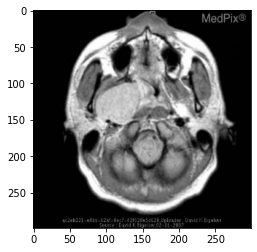

 12%|█▏        | 179/1498 [38:30<4:45:17, 12.98s/it]

ORIGINAL ----------------
Modality: MR - T1W - noncontrast Plane: Axial  Anatomy: Head
and Neck (ex. orbit)   Findings: There is a very large mass
lesion within the right parapharyngeal region, extending to
the skull base and down to the level of the oropharynx. This
mass is well circumscribed, and displaces muscle anteriorly
and vascular structures posteriorly.   Impression:
Pleomorphic adenoma


AI GENERATED ------------
Modality: mr flair plane axial  Anatomy: brain and neuro
Findings: • axial ct day 1 hyperdense middle cerebral artery
hdmca sign suggesting intraluminal clot  • mri day 1 early
cytotoxic edema and restricted diffusion consistent with
acute right mca infarct  • mri 7 weeks later well developed
mca infarct


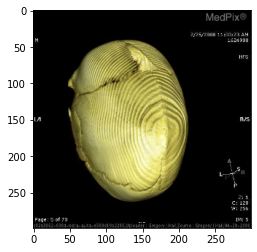

 12%|█▏        | 180/1498 [38:43<4:44:01, 12.93s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: 3D Reconstruction
Anatomy: Brain and Neuro   Findings: CT of the head
demonstrates premature closure of the sagital suture, with
straightening, ridging and sclerosis of the margins; the
head is abnormal in shape with dolichocephaly (increased
AP/transverse ratio).   Impression: Sagittal
Craniosynostosis


AI GENERATED ------------
Modality: xr plain film plane 3d reconstruction  Anatomy:
msk musculoskeletal   Findings: hull shaped skull with
increased anteriorposterior length relative to width bony
tumor bilateral sagittal ap  Anatomy: spine diffuse
anteriorposterior length and masses were hyperintense on
both sagittal t2 sequences fat saturation multiple axial and
axial sequences demonstrate focal


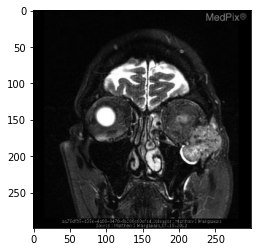

 12%|█▏        | 181/1498 [38:56<4:42:07, 12.85s/it]

ORIGINAL ----------------
Modality: MR - T2 weighted Plane: Coronal  Anatomy:
Generalized   Findings: CT of the head 12/3/2010 » 3.5 x2.5
x2.3 cm invasive destructive mass at the junction of the
left zygomatic arch, left maxillary sinus and inferiolateral
wall of the left orbit »contains small bony fragments  MRI
of the head 12/14/2010 » 3.5cm expansile mass centered at
the malar eminence.  » Mass enhaced homogeneously except for
small areas of hypointensisty.  » Flow voids within the mass
MRA of the head  12/14/2010 » Enlarged blood vessels seen
extending toward and within the left orbital mass.   » The
hypervascularity of the mass is suggestive of a metastasis
CT of the abdomen and pelvis 1/25/2011 » 5 cm lower pole
left renal mass » Heterogeneus enhancement with contrast »
Contains calcifications » No renal vein involvement » No
significant lymph node enlargment  Post treatment CT of the
head 3/22/2011 » Resection of the mass » Lateral wall of the
orbit has been resected » Surgical 

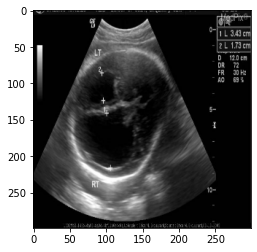

 12%|█▏        | 182/1498 [39:08<4:41:24, 12.83s/it]

ORIGINAL ----------------
Modality: US - Ultrasound Plane: Axial  Anatomy: Generalized
Findings: Initial intracranial images demonstrate markedly
dilated lateral ventricles.    Profile images show a midline
nasofrontal mass in the region of the glabella.
Impression: Fronto-nasal encephalocele


AI GENERATED ------------
Modality: us ultrasound plane transverse  Anatomy:
genitourinary   Findings: on transabdominal ultrasound
imaging there was a normal homogeneous appearance to the
uterus and endometrial fluid or endometrial cavity imaging
of the patient was found to have 3cm to normal echotexture
to endometrial borders and free a cervix the obtained one


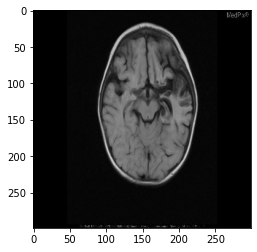

 12%|█▏        | 183/1498 [39:21<4:42:34, 12.89s/it]

ORIGINAL ----------------
Modality: MR - T1W w/Gadolinium Plane: Axial  Anatomy: Brain
and Neuro   Findings: MRI Day 1:  Cortical gray-matter edema
left temporal lobe with corresponding restricted diffusion
in same part of the brain on DWI images.  MRI Day 23:
Necrosis of most of the left temporal lobe.  DWI no longer
show restricted diffusion.  No significant enhancement.
Impression: Herpes simplex encephalitis (HSV Type 1)


AI GENERATED ------------
Modality: mr flair plane axial  Anatomy: brain and neuro
Findings: • enlarged left hemisphere with evidence of poor
sulcation and thickened gyri  • enlarged left lateral
ventricle  • falx displaced to the right  • band heterotopia
of gray matter   Impression: cephalic disorders
hemimegalencephaly


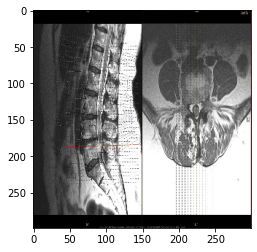

 12%|█▏        | 184/1498 [39:34<4:42:05, 12.88s/it]

ORIGINAL ----------------
Modality: MR - T2 weighted Plane: Sagittal  Anatomy: Spine
Findings: MRI of the lumbar spine revealed mild
straightening of the lumbar lordosis with no acute bony
abnormalities. The L2-3 disc space has anterior spurring and
minimal posterior bulge with hypertrophy of the ligamentum
flavum resulting in mild central spinal stenosis. There is
left foraminal protrusion mildly effacing the left L2 nerve
root. The L3-4 disc space has anterior spurring, posterior
bulge, and hypertrophy of the ligamentum flavum resulting in
moderate central spinal stenosis. There are mild bilateral
foraminal bulges. The L4-5 disc space has anterior spurring
and mild posterior bulge which indents the ventral thecal
sac and prominent hypertrophy of the ligamentum flavum
resulting in moderate to severe central spinal stenosis. As
we descend an additional slice below the disc space of L4/L5
it is clear there is stenosis and pressure upon the L5 nerve
root (medial to the L4 nerve root).  T

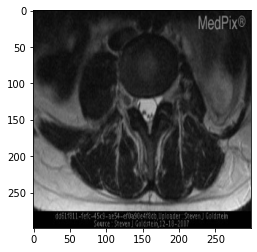

 12%|█▏        | 185/1498 [39:47<4:41:37, 12.87s/it]

ORIGINAL ----------------
Modality: MR - T2 weighted Plane: Axial  Anatomy: Spine
Findings: Avulsion of the L5 and S1 roots on the left with
empty root sleeves at both levels and pseudomeningocele
formation.   Impression: Lumbar nerve root avulsion


AI GENERATED ------------
Modality: mr t2 weighted plane axial  Anatomy: spine
Findings: spit spinal cord at t11t12 no duplication of the
dural sac or nerve roots   Impression: diastematomyelia
fibrous septum


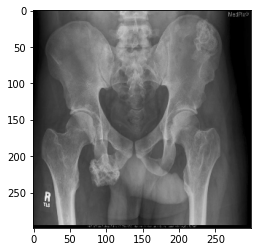

 12%|█▏        | 186/1498 [40:00<4:40:43, 12.84s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: AP  Anatomy: MSK -
Musculoskeletal   Findings: Right knee radiograph
demonstrates a prominent pedunculated bony projection
pointing away from the knee joint, with apparent continuity
with cortex and marrow. Questionable cortical irregularity
of the inferior stalk is suspicious for a fracture.
Multiple exostoses project from numerous additional sites on
bone survey.   Impression: Multiple Osteochondromatosis


AI GENERATED ------------
Modality: xr plain film plane ap  Anatomy: msk
musculoskeletal   Findings: ap pelvis coarsened and
thickened trabeculae along the right femoral neck and
greater trochanter axial ct images through the right hip and
pelvis thickened trabecular markings with thickening of
cortical bone along the right femoral neck and greater
trochanter


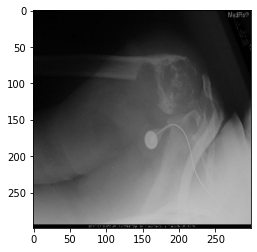

 12%|█▏        | 187/1498 [40:13<4:41:57, 12.90s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: AP  Anatomy: MSK -
Musculoskeletal   Findings: Plain films and CT show  an
aggressive lytic lesion in the right humeral head and
metaphysis with wide transition zone, cortical destruction,
no significant periostitis, and dystrophic calcification but
no significant tumor matrix.  MRI shows the mass to be
enhancing.   Impression: Fibrosarcoma


AI GENERATED ------------
Modality: xr plain film plane ap  Anatomy: msk
musculoskeletal   Findings: • epiphyseal enlargement  •
gracile diaphyses  • widening of the intertrochanteric notch
Impression: hemophilia   • right hip dysplasia


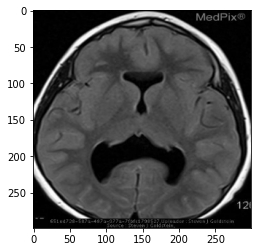

 13%|█▎        | 188/1498 [40:26<4:43:22, 12.98s/it]

ORIGINAL ----------------
Modality: MR - FLAIR Plane: Axial  Anatomy: Brain and Neuro
Findings: Absent septum pellucidum Heterotopic subependymal
gray matter Non-fusion of basal ganglia Dystrophic corpus
callosum   Impression: Middle Interhemispheric Variant of
Holoprosencephaly


AI GENERATED ------------
Modality: mr t1w noncontrast plane axial  Anatomy: brain and
neuro   Findings: • enhancing mass in the posterior third
ventricle  • hydrocephalus of both lateral and 3rd
ventricles   Impression: papillary epithelial tumor of
pineal region


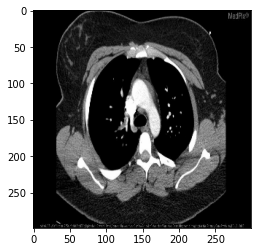

 13%|█▎        | 189/1498 [40:39<4:43:20, 12.99s/it]

ORIGINAL ----------------
Modality: CTA - CT Angiography Plane: Axial  Anatomy:
Vascular   Findings: CT chest was positive for bibasilar
segmental and subsegmental pulmonary thormboemboli.  Small
left pleural effusion, mild hazy ground glass opacities in
the left lower lobe.   MRI of spine demonstrated small
central disc herniation at L5-S1. Concentric bulging disc
and annular tears at L4-L5 and L3-L4 level.   Chest Xray
demonstrated small left pleural effusion with subsegmental
atelectasis at the left base.   Impression: Pulmonary
Thromboembolism associated with Pregnancy, small lumbar disc
herniation.


AI GENERATED ------------
Modality: ct gi iv contrast plane axial  Anatomy:
gastrointestinal   Findings: pancreatic head mass w
pancreatic ductal dilatation   Impression: pancreatic
adenocarcinoma


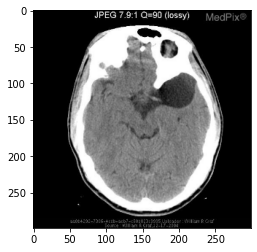

 13%|█▎        | 190/1498 [40:52<4:42:27, 12.96s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Axial  Anatomy: Brain and
Neuro   Findings: Large cystic extra-axial intra-dural
cystic stucture left middle cranial fossa. Signal intensity
is similar to CSF on multiple MR sequences and is isodense
to CSF on CT.  The DWI shows *freely mobile water*
Impression: Arachnoid Cyst


AI GENERATED ------------
Modality: ct noncontrast plane axial  Anatomy: brain and
neuro   Findings: • ct hyperdense mass in the suprasellar
cistern  • angio giant right internal carotid terminus
aneurysm   Impression: giant aneurysm


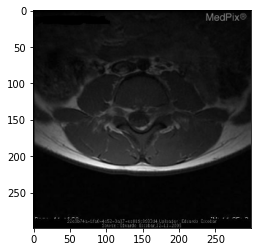

 13%|█▎        | 191/1498 [41:05<4:41:35, 12.93s/it]

ORIGINAL ----------------
Modality: MR - T1W - noncontrast Plane: Axial  Anatomy:
Spine   Findings: Soft tissue density seen in the spinal
canal on CT with extension through the left L4 neural
foramen posterior to the psoas muscle  Obliteration of the
fat tissue planes of the L4 left neural foramen with
myositis and focal area of rim enhancement within the left
erector spinae muscle   Impression: Epidural Abscess


AI GENERATED ------------
Modality: mr t1w wgadolinium plane axial  Anatomy: spine
Findings: • enhancing epidural collection lumbar spinal
canal  • dural sac is compressed  • dural thickening present
• collection is primarily posterior in location  •
paraspinal and psoas muscles abscesses   Impression: spine
epidural abscess


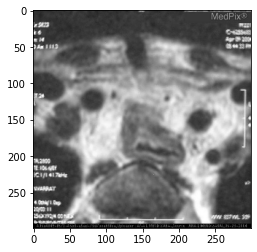

 13%|█▎        | 192/1498 [41:18<4:40:46, 12.90s/it]

ORIGINAL ----------------
Modality: MR - T2 weighted Plane: Axial  Anatomy: Head and
Neck (ex. orbit)   Findings: MRI shows severe subglottic
tracheal stenosis with fluid level and scarring, sagital
images demonstrate the tract created by an emergency
tracheostomy. Esophagogram permormed later revealed a
traction diverticulum.   Impression: Postintubation tracheal
stenosis.


AI GENERATED ------------
Modality: us ultrasound plane sagittal  Anatomy:
genitourinary   Findings: multiple tubular structures which
dilate to some degree with valsalva maneuver and demonstrate
color flow within   Impression: varicocele


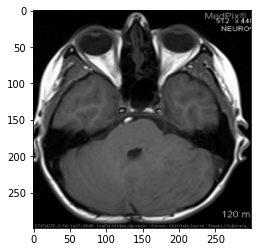

 13%|█▎        | 193/1498 [41:31<4:41:17, 12.93s/it]

ORIGINAL ----------------
Modality: MR - T1W - noncontrast Plane: Axial  Anatomy:
Brain and Neuro   Findings: Right cerebellar hemisphere mass
with striated appearance.  No enhancement following contrast
injection.   Impression: Lhermitte Duclos with Cowden
Syndrome


AI GENERATED ------------
Modality: mr t1w wgadolinium plane axial  Anatomy: brain and
neuro   Findings: • multiple bilateral brain lesions  • mri
infarcts of the lesions with are partially cystic and low
signal intensity central lesions in the basal ganglia and
lesion enhances intensely lesion in the calvarium skull base
of the frontal


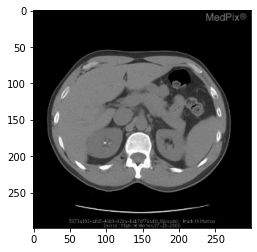

 13%|█▎        | 194/1498 [41:43<4:40:03, 12.89s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Axial  Anatomy:
Genitourinary   Findings: Noncontrast axial computed
tomographic images of the abdomen and pelvis demonstrate a 3
mm calculus within the right ureter at the ureterovesical
junction with mild dilitation of the right renal pelvis and
right ureter suggesting a degree of obstruction.  Two
nonobstructing calculi within the upper pole of the right
kidney and a single nonobstructing calculus within the
interpolar region of the left kidney are also demonstrated.
There are no solid or cystic renal lesions.  The left ureter
is of normal caliber and follows a normal course without
evidence of ureterolithiasis.   Impression: Nephrolithiasis
- Kidney Stones


AI GENERATED ------------
Modality: ct wcontrast iv plane axial  Anatomy:
genitourinary   Findings: • renal fusion or isthmus crossing
aorta at ima  • low position and malrotated anteriorly
directed renal pelvis  • enhancingfunctioning renal isthmus
Impression: renal e

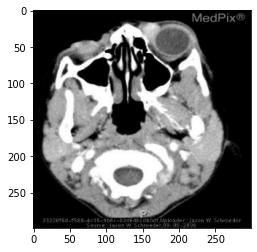

 13%|█▎        | 195/1498 [41:57<4:44:37, 13.11s/it]

ORIGINAL ----------------
Modality: CT w/contrast (IV) Plane: Axial  Anatomy: Eye and
Orbit (exclude Ophthalmology)   Findings: Avidly enhancing
mass in the medial canthal region. No bony involvement. No
other masses (remaining imaging of the head and neck was
normal).   Impression: Orbital Nodular Fasciitis


AI GENERATED ------------
Modality: ct wcontrast iv plane axial  Anatomy: head and
neck ex orbit   Findings: water density mass in left floor
of mouth and submandibular space no peripheral enhancement
or capsule no inferior extension below submandibular space
into neck   Impression: simple ranula


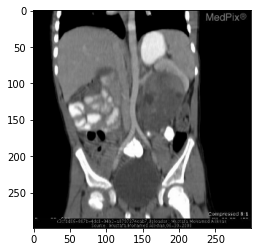

 13%|█▎        | 196/1498 [42:10<4:44:43, 13.12s/it]

ORIGINAL ----------------
Modality: CT - GI & IV Contrast Plane: Coronal  Anatomy:
Genitourinary   Findings: Initial upright and supine
radiographs of the abdomen demonstrated a large soft tissue
density/mass within the left hemiabdomen that appears to
displace large bowel medially. Follow-up CT scan images
demonstrated a large apparent subcapsular mass lesion
emanating from the lower pole of the left kidney that causes
mass-effect and cortical thinning.   Impression: Clear Cell
Sarcoma of the Kidney


AI GENERATED ------------
Modality: ct gi iv contrast plane coronal  Anatomy:
genitourinary   Findings: exophytic mass off inferior pole
of left kidney   Impression: renal cell carcinoma


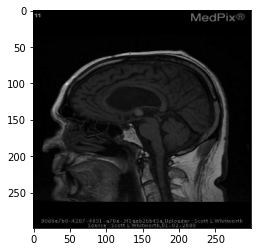

 13%|█▎        | 197/1498 [42:23<4:43:21, 13.07s/it]

ORIGINAL ----------------
Modality: MR - T1W - noncontrast Plane: Sagittal  Anatomy:
Brain and Neuro   Findings: •  Rounded mass anterior third
ventricle •  Hypointense on T2W images •  Hydrocephalus from
obstruction at F. of Monro   Impression: Colloid cyst


AI GENERATED ------------
Modality: mr t1w noncontrast plane sagittal  Anatomy: brain
and neuro   Findings: mr images demonstrate a well
delineated complex core of mixed signal intensities with a
low signal hemosiderin rim and with enhancement of the
medial aspect of the core after contrast administration
Impression: cavernous malformation


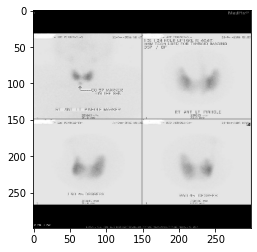

 13%|█▎        | 198/1498 [42:36<4:41:11, 12.98s/it]

ORIGINAL ----------------
Modality: NM - Nuclear Medicine Plane: Coronal  Anatomy:
Endocrine (clinical)   Findings: Homogeneous increased
uptake of radioiodine throughout the entire thyroid with an
elevated 24 hour uptake   Impression: GRAVES DISEASE


AI GENERATED ------------
Modality: nm nuclear medicine plane nos not specified
Anatomy: head and neck ex orbit   Findings: preoperative
thyroid nuclear scan was performed i 131 77 microcurie was
administered 24 hours prior to imaging and measurement of
the radioactive uptake was 138 normal 8 30 on the day of
imaging technetium


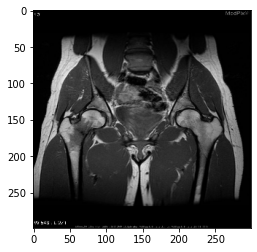

 13%|█▎        | 199/1498 [42:49<4:40:34, 12.96s/it]

ORIGINAL ----------------
Modality: MR - T1W - noncontrast Plane: Coronal  Anatomy:
MSK - Musculoskeletal   Findings: Initial radiographs
demonstrate no abnormalities.  Follow up radiographs
obtained two to three weeks later demonstrate interval
development of a band of sclerosis at the inferior aspect of
the right femoral neck concerning for stress fracture.  MR
images obtained two days after the second set of radiographs
demonstrate an irregular linear band of low signal on T1 and
T2 weighted images within the distal right femoral neck,
with adjacent low T1 signal and adjacent increased T2
signal, consistent with a stress fracture.   Impression:
Occult Stress Fracture


AI GENERATED ------------
Modality: mr t1w noncontrast plane coronal  Anatomy: msk
musculoskeletal   Findings: mri intraarticular osseous
fragment within the lateral aspect of the medial femoral
condyle in the weight images   Impression: osteochondritis
dissecans


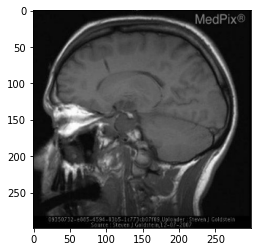

 13%|█▎        | 200/1498 [43:02<4:38:31, 12.87s/it]

ORIGINAL ----------------
Modality: MR - T1W - noncontrast Plane: Sagittal  Anatomy:
Brain and Neuro   Findings: •  Skull base complex mass
extending into sella and suprasellar cistern. •  Irregular
enhancement on MRI. •  Mottled calcification noted within
mass on CT   Impression: Chondrosarcoma of skull base


AI GENERATED ------------
Modality: mr t1w noncontrast plane sagittal  Anatomy: brain
and neuro   Findings: • ring enhancing lesion right frontal
lobe  • surrounding vasogenic edema  • lesion has low signal
intensity rim on t2 sequences  • elevated signal intensity
within lesion on dwi images  • decreased signal on adc map
Impression: brain


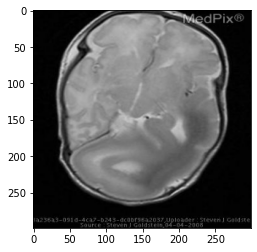

 13%|█▎        | 201/1498 [43:14<4:37:24, 12.83s/it]

ORIGINAL ----------------
Modality: MR - T2 weighted Plane: Axial  Anatomy: Brain and
Neuro   Findings: Remarkably abnormal left brain: •  Marked
enlargement of the cerebral hemisphere •  Diffuse cortical
thickening, shallow gyri, and migrational abnormalties •
Dystrophic calcification   Impression: Unilateral
megaloencephaly, Hemimegalencephaly


AI GENERATED ------------
Modality: mr t1w noncontrast plane axial  Anatomy: brain and
neuro   Findings: • large occipital encephalocele containing
dystrophic neural tissue  • chiari malformation of hind
brain  • cervical cord syrinx   Impression: chiari iii
hindbrain malformation with large occipital encephalocele


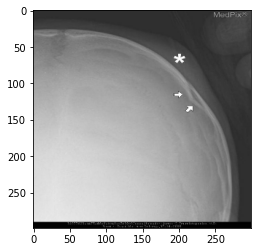

 13%|█▎        | 202/1498 [43:27<4:36:54, 12.82s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: AP  Anatomy: Brain and
Neuro   Findings: An irregularity in the skull is noted on
the plain radiograph and is suspicious for fracture.  The
axial image from a non-contrast head CT demonstrates a
corresponding depressed skull fracture. A similar image
obtained after six weeks demonstrates healing and remodeling
of the depressed fragment.   Impression: Depressed skull
fracture.


AI GENERATED ------------
Modality: xr plain film plane ap  Anatomy: msk
musculoskeletal   Findings: ap and lateral radiographs of
the hips show serpiginous lines of sclerosis along the
femoral heads there is flattening and subchondral fracture
of the right lateral femoral head additionally the right
femoral head is smaller than the left mri


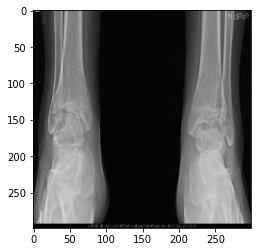

 14%|█▎        | 203/1498 [43:40<4:36:03, 12.79s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: AP  Anatomy: MSK -
Musculoskeletal   Findings: AP, Lateral, and Oblique views
of the elbow demonstrating later stages of hemophilia. These
findings include osseous destruction, cystic lesions,
surface irregularities, joint space narrowing, and synovial
thickening.  AP, Lateral, and Oblique views of the ankles
demonstrating later stages of hemophilia. These findings
include osseous destruction, cystic lesions, surface
irregularities, joint space narrowing, and synovial
thickening.   Impression: Hemophilia


AI GENERATED ------------
Modality: xr plain film plane lateral  Anatomy: msk
musculoskeletal   Findings: plain radiographs ·no fractures
or joint space irregularities ·retraction of the 1st mtp
sesamoids when compared with old radiographs mri ·t2
hyperintensity within the plantar soft tissues at the 1st
mtp ·disruption of the plantar plate at the site


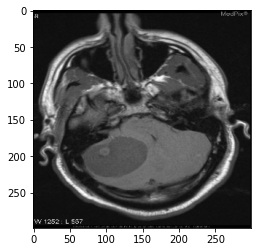

 14%|█▎        | 204/1498 [43:52<4:34:36, 12.73s/it]

ORIGINAL ----------------
Modality: MR - T1W - noncontrast Plane: Axial  Anatomy:
Brain and Neuro   Findings: CT: Large cystic mass in the
right cerebellar hemisphere with rounded mural soft tissue
nodule. MR: Cystic right cerebellar hemisphere mass with
enhancing mural nodule.   Impression: Cerebellar
hemangioblastoma


AI GENERATED ------------
Modality: mr t1w wgd fat suppressed plane axial  Anatomy:
brain and neuro   Findings: ct large cystic mass in the
right cerebellar hemisphere with rounded mural soft tissue
nodule mr cystic right cerebellar hemisphere mass with
enhancing mural nodule   Impression: cerebellar
hemangioblastoma


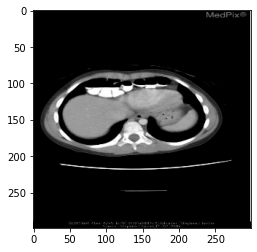

 14%|█▎        | 205/1498 [44:05<4:34:19, 12.73s/it]

ORIGINAL ----------------
Modality: CT - GI & IV Contrast Plane: AP  Anatomy: Abdomen
- Generalized   Findings: Transverse colon lies above the
level of the diaphragm, anterior to the heart and
predominantly medial.  No surrounding inflammatory change.
Free passage of enteric contrast.   Impression: Morgagni
Hernia (adult, incidental)


AI GENERATED ------------
Modality: ct wcontrast iv plane axial  Anatomy:
gastrointestinal   Findings: retrocardiac mass on ct be seen
around the plain film imaging of the abdomen at the scout ct
scan from the scout radiograph of the abdomen demonstrates
the liver ct images demonstrates the abdomen and on the
reveals bowing of


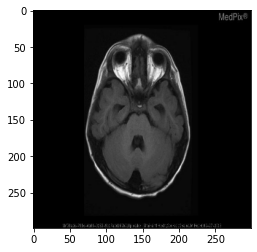

 14%|█▍        | 206/1498 [44:18<4:34:38, 12.75s/it]

ORIGINAL ----------------
Modality: MR - T2 weighted Plane: Transverse  Anatomy:
Multisystem   Findings: The abdominal ultrasound showed
hepatosplenomegaly (13.3cm, UL 10.5cm) and splenomegaly
(9.8cms, UL 9cms).  The skeletal survey showed a J shaped
sella, short and wide long bones, anterior beaking of the L1
vertebral body, and widened metacarpals with inferior
pointing.  The cranial MRI showed areas of cystic change in
the superior medial margins of the lateral ventricles and a
thin corpus callosum.   Impression: Hunter Syndrome


AI GENERATED ------------
Modality: mr t2 weighted plane axial  Anatomy: brain and
neuro   Findings: • sphenoid base mass lesion  • possible
invasion into the left cavernous sinus and meckel cave  • no
obvious brain parenchymal lesions   Impression: sinonasal
metastatic melanoma


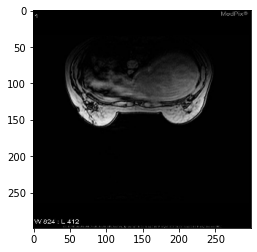

 14%|█▍        | 207/1498 [44:31<4:34:36, 12.76s/it]

ORIGINAL ----------------
Modality: MR T2* gradient,GRE,MPGR,SWAN,SWI Plane: Axial
Anatomy: Breast and Mammography   Findings: Well
circumscribed non-enhancing area in the left breast that is
hyperintense on T2WI, hypointense on T1WI and fat saturated
T2 sequences compatible with injected silicone.  Post
gadolinium images demonstrate symmetric enhancement of
breast parenchyma with nonspecific nodules of enhancement
with non-aggressive time intensity curves (not shown).
Architectural distortion in the upper breast with blooming
artifact on gradient imaging compatible with post surgical
change.   Impression: Siliconomas:  Silicone granulomas from
silicone breast augmentation


AI GENERATED ------------
Modality: mr t1w noncontrast plane sagittal  Anatomy: msk
musculoskeletal   Findings: plain radiographs demonstrate
thickening of the achilles tendon convex   Impression: of
achilles tendon on the posterior margin of kagers fat pad
and a lower limits normal toygars angle mr   Findings:
dem

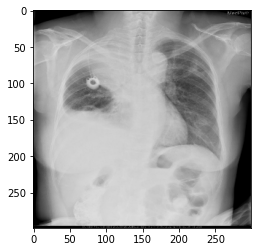

 14%|█▍        | 208/1498 [44:43<4:33:58, 12.74s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: Frontal  Anatomy:
Cardiovascular (inc. Heart)   Findings: Large right upper
lobe mass that obstructs the superior vena cava.  The right
upper lobe is collapsed.  The patient also has a right
pleural effusion.  Additionally, the patient displays
numerous venous collaterals about the liver, likely chronic
in nature, providing low resistance venous flow into the
inferior vena cava.   Impression: Superior Vena Cava
Obstruction


AI GENERATED ------------
Modality: xr plain film plane pa  Anatomy: chest pulmonary
ex heart   Findings: cxr bilateral r>l hilar enlargement and
pleural thickening ct chunky calcification of mediastinal
nodes pleural nodules and interstitial thickening in upper
lobes   Impression: pulmonary sarcoidosis


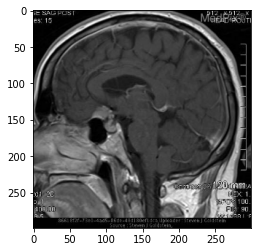

 14%|█▍        | 209/1498 [44:56<4:32:55, 12.70s/it]

ORIGINAL ----------------
Modality: MR - T1W w/Gadolinium Plane: Sagittal  Anatomy:
Brain and Neuro   Findings: Enhancing extradural mass
arising from the planum of the sphenoid bone. Enlargement of
air-filled sphenoid sinus under the mass - pneumosinus
dilatans   Impression: Meningioma, Pneumosinus Dilatans


AI GENERATED ------------
Modality: mr t1w wgadolinium plane sagittal  Anatomy: brain
and neuro   Findings: • left parietooccipital mass with both
fluid cystic and solid components  • there is enhancement of
both the cyst walls and solid portions of the mass
Impression: oligodendroglioma malignant


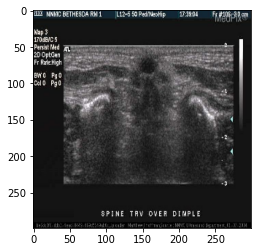

 14%|█▍        | 210/1498 [45:09<4:31:50, 12.66s/it]

ORIGINAL ----------------
Modality: US - Ultrasound Plane: Transverse  Anatomy: Spine
Findings: The normal neonatal spinal cord is displayed on
ultrasound as a tubular hypoechoic structure with
hyperechoic walls. The central canal is hyperechoic, the so-
called central echo complex. The subarachnoid space
surrounding the cord is hypoechoic. The caudal end of the
spinal cord corresponds with the conus medullaris, which
continues into the filum terminale. The cauda equina is seen
as echogenic linear structures surrounding a hyperechoic
filum terminale. The vertebral bodies are seen as echogenic
structures ventral to the spinal cord. Viewed axially, the
spinal cord is hypoechoic and round or oval-shaped, lying
within the anechoic subarachnoid space. The spinal cord is
fixed by dentate ligaments that pass laterally from the
spinal cord. Echogenic nerve roots are seen below the level
of L2.     Particular features to note are:  -The position
of the cord in a dorsal/ventral or anterior/poste

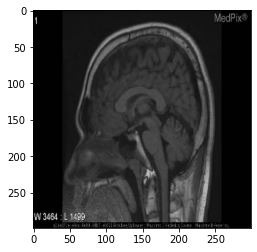

 14%|█▍        | 211/1498 [45:22<4:33:39, 12.76s/it]

ORIGINAL ----------------
Modality: MR - T1W - noncontrast Plane: Sagittal  Anatomy:
Head and Neck (ex. orbit)   Findings: Axial CT through level
of nasopharynx -Asymmetry of the soft tissues with slight
increase in attenuation in the left lateral nasopharyngeal
recess (AKA Fossa of Rosenmuller) -Well circumscribed
hyperattenuated soft tissue mass in location of lymph nodes
(Node of Rouvierre)  Axial CT through level of nasopharynx
-Obliteration of the normal fat planes in the
pterygopalatine fossa  Sagittal T1 at midline
-Nasopharyngeal fullness, convex rather than concave toward
brain -Replacement of normal T1-bright marrow signal in
clivus -Some opacification of the sphenoid sinus  Sagittal
T1 at midline -Sphenoid opacified -Posterior to maxilla and
anterior to sphenoid bone is pterygopalatine fossa, which
appears to be full of a soft tissue density  -Able to see
foramen rotundum, widened with mass filling foramen   Axial
T2 through the level of the orbits -Sphenoid is opacified
wit

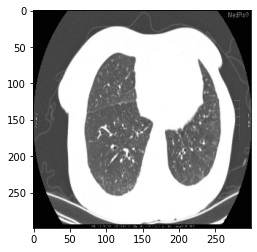

 14%|█▍        | 212/1498 [45:34<4:33:27, 12.76s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Axial  Anatomy: Chest,
Pulmonary (ex. Heart)   Findings: Axial CT images from HRCT
demonstrate bilateral predominantly lower lung zone
bronchiectasis. Images demonstrate the classic "signet ring"
sign with enlarged bronchi adjacent to relatively smaller
caliber of pulmonary arteries. No fissural thickening or
nodularity appreciated.  No evidence of ground glass opacity
or air trapping. No air-filled cystic abnormalities.
Impression: Bronchiectasis


AI GENERATED ------------
Modality: ct wcontrast iv plane axial  Anatomy: chest
pulmonary ex heart   Findings: • cxr shows a solitary
pulmonary noduleopacity within the left lower lobe  • axial
ct images of the chest demonstrate a welldefined solitary
peripheral mass with curvilinear structures extending tofrom
consistent with feeding arteries and draining veins


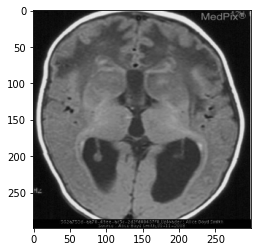

 14%|█▍        | 213/1498 [45:47<4:34:49, 12.83s/it]

ORIGINAL ----------------
Modality: MR - T1W - noncontrast Plane: Axial  Anatomy:
Brain and Neuro   Findings: •  Low T1 Signal involving the
periventricular white matter and high T1 signal involving
the periventricular rim. •  Increased T2 signal int the
involved white matter and the basal ganglia •  On post-
contrast imaging there is intense enhancement of the basal
ganglia   Impression: Alexander  Disease, Rosenthal Fiber
Encephalopathy


AI GENERATED ------------
Modality: mr t1w wgadolinium plane axial  Anatomy: brain and
neuro   Findings: • large cystic mass in the right
cerebellar hemisphere with rounded mural soft tissue nodule
• mr cystic right cerebellar hemisphere mass  • isointense
to slightly heterogeneous enhancement following contrast
Impression: cerebellar metastatic to   Findings:


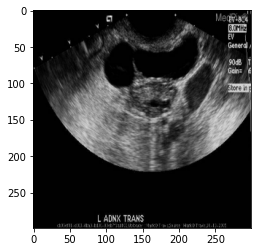

 14%|█▍        | 214/1498 [46:00<4:34:56, 12.85s/it]

ORIGINAL ----------------
Modality: US - Ultrasound Plane: Oblique  Anatomy:
Genitourinary   Findings: Ultrasound of the left adenexa
demonstrates a 5 X 1.5 CM tubular anechoic structure
adjacent to the left ovary. Original ultrasound of 8 weeks
prior demonstrated what was thought to be a 2.7 cm left
ovarian cyst.   Impression: Hydrosalpinx


AI GENERATED ------------
Modality: us ultrasound plane sagittal  Anatomy:
genitourinary   Findings: pelvic sonography demonstrates a
dilated 9 mm diameter fluidfilled thickwalled avascular
tubular structure adjacent to the left ovary no internal
echoes or fluiddebris levels are evident fluoroscopic images
obtained during hysterosalpingography demonstrate
preferential filling of the dilated left fallopian tube
without


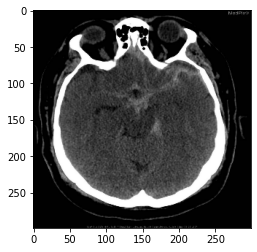

 14%|█▍        | 215/1498 [46:13<4:35:09, 12.87s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Axial  Anatomy: Brain and
Neuro   Findings: Hyperdense acute blood within multiple
CSF-containing spaces including the fourth ventricle, pre-
pontine cistern, intrapenduncular cistern, suprasellar
cister, left Sylvian fissure, left interhemispheric space
and left middle cerebral artery fissure.   Impression:
Nontraumatic Subarachnoid Hemorrhage


AI GENERATED ------------
Modality: ct noncontrast plane axial  Anatomy: brain and
neuro   Findings: • ct hyperdense mass in the anterior left
inferior meatus with extension into the left nasal passage
of air pocket of air on contrast opacification extending
into the anterior portion of the left maxillary sinus
Impression: anterior maxillary sinus


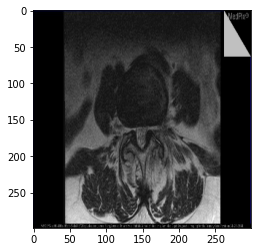

 14%|█▍        | 216/1498 [46:26<4:34:53, 12.87s/it]

ORIGINAL ----------------
Modality: MR - T2 weighted Plane: Axial  Anatomy:
Genitourinary   Findings: MRI of the brain:  1. PROMINENT
PERIVENTRICULAR MICROVASCULAR ISCHEMIC CHANGES AND EXTENSIVE
DEEP AND TO A LESSER EXTENT SUBCORTICAL MICROVASCULAR
ISCHEMIC WHITE MATTER CHANGES WITH INVOLVEMENT OF THE PONS.
2. NO ACUTE INTRACRANIAL ABNORMALITIES ARE SEEN.   MRI of
the lumbar spine:  1) MINIMAL CHRONIC DEPRESSION OF THE
SUPERIOR ENDPLATE OF T12 WITH A SCHMORL'S NODE. THERE IS NO
EDEMA TO INDICATE RECENT COMPRESSION FRACTURE.  2) ON THE
AXIAL IMAGES, A HETEROGENEOUS LESION IS SEEN IN THE RIGHT
RENAL SINUS MEASURING 5 CM. THIS IS NOT A SIMPLE CYST. CT OF
THE ABDOMEN WITH AND WITHOUT CONTRAST IS SUGGESTED FOR
FURTHER EVALUATION TO EXCLUDE A NEOPLASM.  3) AT L2-L3: DISC
SPACE NARROWING AND MILD DISC BULGE.  4) AT L3-L4: MILD DISC
BULGE AND FACET ARTHROPATHY WITH MODERATE BILATERAL
FORAMINAL STENOSIS.  5) AT L4-L5: MORE ADVANCED FACET
ARTHROPATHY WITH GRADE I SPONDYLOLISTHESIS. THERE IS
MODE

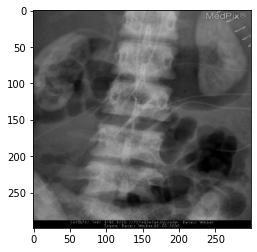

 14%|█▍        | 217/1498 [46:39<4:33:19, 12.80s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: Frontal  Anatomy:
Miscellaneous   Findings: •  Radiographs of the spine
demonstrate diffusely increased density •  The kidneys also
appear hyperdense (no recent IV contrast administration).  •
Surgical staples consistent with recent liver transplant.
Impression: Renal oxalosis


AI GENERATED ------------
Modality: xr plain film plane ap  Anatomy: spine   Findings:
avulsion of the l5 and s1 roots on the left with empty root
sleeves at both levels and pseudomeningocele formation
Impression: lumbar nerve root avulsion


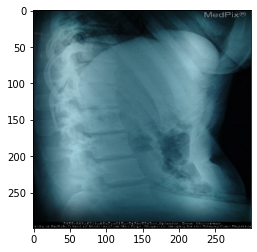

 15%|█▍        | 218/1498 [46:51<4:32:21, 12.77s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: Lateral  Anatomy: Spine
Findings: When initially brought in to ER after MVA, plain
film radiographs were taken. These revealed a slight left
lumbar concavity of curvature which is likely due to muscle
spasms. No other osseous pathologies were noted.   The
lumbar MRI revealed evidence of a small disc bulge at the
L4-L5 level. There was also a right paracentral posterior
disc herniation at L5-S1 level which effaces the thecal sac
and compresses the S1 nerve root.   Impression: L5-S1 disc
herniation with S1 radiculopathy


AI GENERATED ------------
Modality: xr plain film plane lateral  Anatomy: spine
Findings: ap and lateral images of the cervical spine
demonstrate loss of the normal cervical lordosis
additionally there are syndesmophytes throughout the
cervical spine the disc spaces are preserved single ap view
of the pelvis demonstrates erosive changes of both
sacroiliac


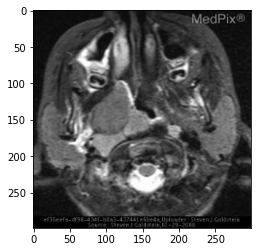

 15%|█▍        | 219/1498 [47:04<4:32:58, 12.81s/it]

ORIGINAL ----------------
Modality: MR - T2 weighted Plane: Axial  Anatomy: Head and
Neck (ex. orbit)   Findings: Bulky infiltrative mass in the
right nasopharynx and oropharynx infiltrating the skull
base.  Metastatic lymphadenopathy noded in neck
Impression: Nonkeratinizing Undifferentiated Carcinoma
Oropharyngeal cancer


AI GENERATED ------------
Modality: mr t1w wgd fat suppressed plane axial  Anatomy:
head and neck ex orbit   Findings: ct mass in left maxillary
sinus with irregular enhancement and surrounding structures
with erosion of the mastoid air cells with prominent fluid
level focal areas of low signal intensity on cxr
Impression: osteomyelitis right


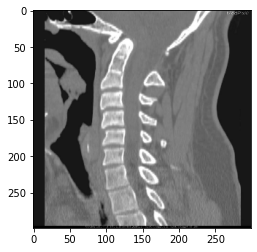

 15%|█▍        | 220/1498 [47:17<4:32:58, 12.82s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Lateral  Anatomy: MSK -
Musculoskeletal   Findings: Axial non-contrast Ct images
show congenital atlanto-occipital fusion.  The sagital and
coronal reformatted images additionally demonstrate fusion
of C-2 with C-3.   Impression: Klippel-Feil     Klippel-Feil
Syndrome


AI GENERATED ------------
Modality: ct noncontrast plane sagittal  Anatomy: spine
Findings: • c1 jefferson burst fracture of c1 with
comminution of the mid anterior ring and comminution of the
left posterolateral ring  • c2 predominately
coronallyoriented fracture with an additional posterior left
parasagittal c2 body fracture component this fracture
extends into the


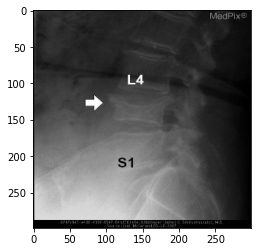

 15%|█▍        | 221/1498 [47:30<4:31:28, 12.76s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Coronal  Anatomy: Spine
Findings: Plain Radiograph (pre-procedure):  Bones are
diffusely osteopenic, with moderate to severe facet and
discovertebral degenerative changes in the lower lumbar
spine.  Transitional lumbosacral anatomy, with a compression
deformity at L5. Slight retropulsion of the postero-superior
endplate of L5.  Cholecystectomy clips.  CT (post-
procedure): Diffuse osteopenia, diskovertebral and facet
degenerative changes (including prominent Schmorl’s node at
L4), and L5 compression deformity again noted.  Levoconvex
curvature to the lumbar spine seen on the coronal reformat.
Moderate spinal stenosis secondary to facet hypertrophy,
ligamentum flavum buckling, and diffuse posterior disk
bulges.  Interval kyphoplasty changes, with findings
consistent with balloon inflation with minimal bone cement
placed in the right aspect of L5. Cement leakage into the
right pedicle.  Moderate amount of cement placed into the


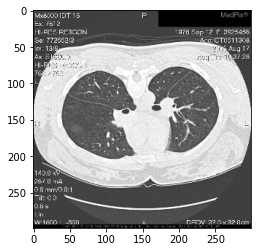

 15%|█▍        | 222/1498 [47:42<4:29:31, 12.67s/it]

ORIGINAL ----------------
Modality: CT w/contrast (IV) Plane: Axial  Anatomy:
Generalized   Findings: 1.      Cortical tubers: MRI T2
axial showing high signal cortical lesions;  2.
Subependymal tumors:  MRI T2 axial showing subependymal
calcifications in left and right lateral ventricles 3.
Subependymal tumors: MRI T1 sagital showing high signal
subependymal nodules.  4.      Renal angiomyolipoma: Non-
enhanced axial CT of the abdomen showing multiple renal
lesions bilaterally; Attenuation equivocal to fat
surrounding torso.  5.      Small lung cysts
(lymphangioleiomyomatosis): A high-resolution axial CT of
the chest showing numerous bilateral well defined, thin
walled cysts   Impression: Tuberous sclerosis complex (TSC)
with lymphangioleiomyomatosis (LAM)


AI GENERATED ------------
Modality: ct noncontrast plane axial  Anatomy: chest
pulmonary ex heart   Findings: chest ct reveals patchy
groundglass attenuation throughout the lungs right pleural
fluid vs thickening is noted he has h

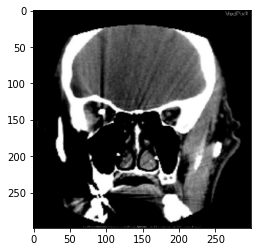

 15%|█▍        | 223/1498 [47:55<4:28:36, 12.64s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Coronal  Anatomy: Brain
and Neuro   Findings: Radiopaque fragments in right orbit
near expected location of the optic nerve   Impression:
Penetrating orbital trauma


AI GENERATED ------------
Modality: ct wcontrast iv plane axial  Anatomy: eye and
orbit exclude ophthalmology   Findings: contrast enhanced
axial and coronal ct images reveal abnormal infiltration and
thickening of the anterior aspect of the right preseptal
soft tissues extending into the right medial canthus no
obstruction of the right globe is within


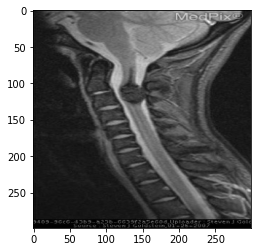

 15%|█▍        | 224/1498 [48:07<4:28:03, 12.62s/it]

ORIGINAL ----------------
Modality: MR - T2 weighted Plane: Sagittal  Anatomy: Brain
and Neuro   Findings: Intramedullary mass in cervical cord
with evidence of hemosiderin staining and blood products of
various ages. There is not definite enhancement of the mass
and no associated cord cysts (no syringohydromyelia).
Impression: Spinal cord cavernous hemangiomas


AI GENERATED ------------
Modality: mr t2 weighted plane sagittal  Anatomy: spine
Findings: • spinal cord tethered to l34 level  • small
central spinal canal  • lower cord divided into two through
elbow  • normal hemi chest  • of digital intensity on outer
sagittal sequences  • an little hernia is difficult digital
lung


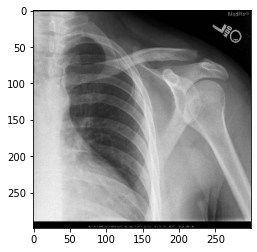

 15%|█▌        | 225/1498 [48:20<4:29:50, 12.72s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: AP  Anatomy: MSK -
Musculoskeletal   Findings: Weightbearing views of the left
shoulder demonstrates widening of the acromioclavicular
joint of approximately 8 mm which is borderline abnormal.
The coracoclavicular joint space is well maintained.
Impression: Acromioclavicular Joint Separation


AI GENERATED ------------
Modality: xr plain film plane ap  Anatomy: msk
musculoskeletal   Findings: • plain films of the right
shoulder  • acromioclavicular coracoclavicular distances  •
superior humeral distal clavicle   Impression:
acromioclavicular joint separation type iii fracture type ii


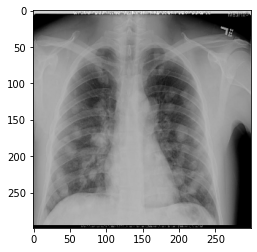

 15%|█▌        | 226/1498 [48:33<4:30:39, 12.77s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: PA  Anatomy: Genitourinary
Findings: CXR demonstrates numerous "cannonball" masses
within both lungs.  Initial CT of the ab/pelv performed
overseas (currently unavailable) demonstrated an
approximately 10 cm soft tissue density mass encasing the
abdominal aorta and vena cava, presumably massive paraortic
lymphadenopathy.  Scrotal US demonstrates a heterogeneous
mass with areas of calcification in the right testis.
Impression: Metastatic testicular neoplasm, most likely
choriocarcinoma or mixed NSGCT


AI GENERATED ------------
Modality: xr plain film plane pa  Anatomy: cardiovascular
inc heart   Findings: pa chest radiograph demonstrates a
round well defined mass in the right posterior to the
cardiac apex axial ct wellcircumscribed mass with nearwater
attenuation in the anterior mediastinum   Impression:
pericardial cyst


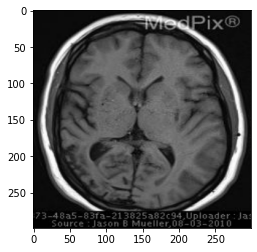

 15%|█▌        | 227/1498 [48:46<4:30:34, 12.77s/it]

ORIGINAL ----------------
Modality: MR - T1W - noncontrast Plane: Axial  Anatomy:
Brain and Neuro   Findings: MRI Brain:   • T1 Axial (at the
level of the cavernous sinuses): Note no ICA flow voids • T1
Axial (at level of the third ventricle): Numerous punctate
flow voids within the basal ganglia. Note right temporal-
occipital encephalomalacia with occipital horn ex vacuo
dilatation. • T2 Axial: Multiple collateral flow voids
within the suprasellar cisterns. • DWI/ADC: Restricted
diffusion and corresponding low ADC in the left temporal-
occipital region consistent with acute infarct. •  FLAIR:
Abnormal FLAIR signal in right temporal-occipital region
consistent with old stroke.  Area of acute infact on the
left shows edematous hyperintense gyri. Note hyperintensity
of basal ganglia and  sulcal collateral vessels (“ivy
sign”). • Right parasagittal Post Gad: Note lenticulostriate
collateral vessels within the basal ganglia (“puff of
smoke”) and leptomeningeal enhancement (“enhanced ivy
s

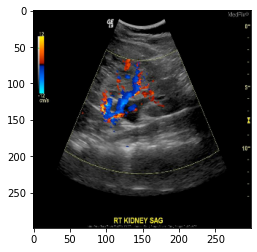

 15%|█▌        | 228/1498 [48:59<4:30:02, 12.76s/it]

ORIGINAL ----------------
Modality: US - Ultrasound Plane: Sagittal  Anatomy:
Genitourinary   Findings: Color and gray-scale sonography of
the liver demonstrates diffusely increased echogenicity of
the portal tracts, secondary to periportal fibrotic changes.
When compared to the prior sonogram from 2006, these
findings are more pronounced.  Sonographic evaluation of the
kidneys demonstrates enlargement with diffusely increased
echogenicity and loss of the normal corticomedullary
differentiation.  Numerous microcysts are visualized within
the renal parenchyma.  The right kidney measures 11.5 cm in
length.  The left kidney measures 13.2 cm in length.  When
compared to the sonogram from 2006,  the renal parenchyma
has increased in echotexture.   Impression: Autosomal
Recessive Polycystic Kidney Disease


AI GENERATED ------------
Modality: us ultrasound plane transverse  Anatomy:
genitourinary   Findings: on the right us the right kidney
is enlarged kidney is absent normal color flow to t

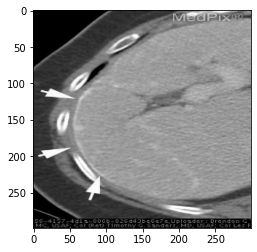

 15%|█▌        | 229/1498 [49:11<4:29:50, 12.76s/it]

ORIGINAL ----------------
Modality: CT w/contrast (IV) Plane: Axial  Anatomy:
Gastrointestinal   Findings: Abdominal radiography showed
subtle curvilinear densities overlying in the left lower
quadrant and central within the pelvis.  This was confirmed
on intravenous contrast-enhanced abdominopelvic CT to be the
caused by thin mucosal surface calcifications within the
descending and sigmoid colons.  Incidental note is made of
thin right hepatic lobe capsule calcifications.
Impression: Schistosomiasis Japonicum


AI GENERATED ------------
Modality: ct noncontrast plane axial  Anatomy: brain and
neuro   Findings: • depresssed open skull fractures and
multiple facial fractures  • pneuomcephalus  • parenchymal
subarachnoid and subdural hemorrhages   Impression:
depressed skull fractures


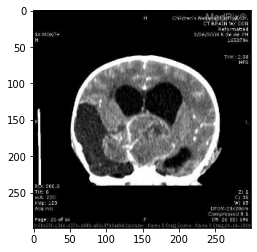

 15%|█▌        | 230/1498 [49:24<4:30:45, 12.81s/it]

ORIGINAL ----------------
Modality: CT w/contrast (IV) Plane: Coronal  Anatomy: Brain
and Neuro   Findings: •  Limited brain ultrasound (at time
of normal abdominal ultrasound) demonstrates large echogenic
midline suprasellar mass with marked hydrocephalus of
lateral ventricles.  •  Head CT with and without contrast
shows large, vascular suprasellar mass extending into
frontal and middle cranial fossae, marked hydrocephalus
lateral ventricles, and right middle cranial fossa cystic
mass - probably arachnoid cyst.  •  MRI brain shows large
suprasellar mass (T1 intermediate, T2 bright, heterogeneous
enhancement) greatest dimension 7.3cm; obstructive
hydrocephalus bilateral lateral ventricles with
transependymal edema; splaying of circle of willis arteries;
mass surrounding, narrowing, stretching RT ACA.  Large
arachnoid cyst right middle cranial fossa.   Impression:
Pilomyxoid Astrocytoma (PMA)


AI GENERATED ------------
Modality: ct noncontrast plane axial  Anatomy: brain and
neuro   Fi

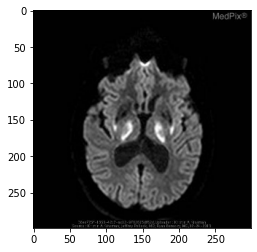

 15%|█▌        | 231/1498 [49:37<4:29:21, 12.76s/it]

ORIGINAL ----------------
Modality: MR - DWI Diffusion Weighted Plane: Axial  Anatomy:
Brain and Neuro   Findings: MRI of the brain with and
without contrast: There is abnormal diffusion restriction
with associated T2 and FLAIR hyperintensity involving the
bilateral thalami with extension into the midbrain and pons
as well as the bilateral putamina in a symmetric manner.
Additional diffusion restriction abnormality with associated
T2 and FLAIR hyperintensity involves the cortex of the
bilateral frontal lobes, left greater than right.  Low
gradient signal is seen in the putamina as well. There is no
mass effect associated with this abnormal signal. No other
abnormal parenchymal signal is identified. Diffuse
parenchymal volume loss is also noted.   Impression:
Hepatolenticular Degeneration, Wilson's disease


AI GENERATED ------------
Modality: mr dwi diffusion weighted plane axial  Anatomy:
brain and neuro   Findings: • midshaft fracture of femur  •
ct of brain in er was negative not sh

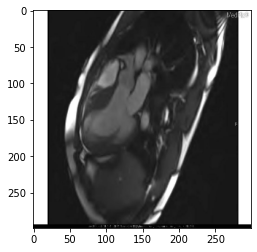

 15%|█▌        | 232/1498 [49:50<4:28:26, 12.72s/it]

ORIGINAL ----------------
Modality: MR - Other Pulse Seq. Plane: Other View (see
caption)  Anatomy: Cardiovascular (inc. Heart)   Findings:
ECHO:   Summary:  1. Hypertrophic cardiomyopathy: normal
LVED with severe LVH, septum worse than posterior wall. No
LV outflow obstruction at this time. Normal LV systolic
function. 2. Prominent LV apical and posterior wall
trabeculations. 3. Apparent tiny apical muscular ventricular
septal defect with left to right shunting versus flow within
RV apical trabeculations. 4. Trivial mitral regurgitation.
5. Poor subcostal acoustic windows. Cannot exclude a small
atrial level shunt. 6. Trivial tricuspid regurgitation. 7.
Normal right ventricular size and systolic function. 8.
Widely patent aortic arch with no evidence of obstruction.
9. No pericardial effusion.  MRI:  Assymetrical left
ventricular hypertrophy is present, preferentially involving
the mid interventricular septum with a lesser degree of
hypertrophy of the anterior wall and inferior wall. 

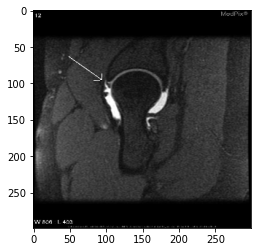

 16%|█▌        | 233/1498 [50:02<4:28:07, 12.72s/it]

ORIGINAL ----------------
Modality: MR - T1W w/Gd (fat suppressed) Plane: Sagittal
Anatomy: MSK - Musculoskeletal   Findings: Intra-articular
Gadolinium was administered under fluoroscopy followed by
MRI imaging.  Sagittal and Axial T1 and T1 fat saturated
images show abnormal linear and irregular signal in the
anterior superior labrum consistent with the labral tear.
Gadolinium is visualized within the joint space and
accentuates visualization of the labral tear.   Impression:
Labral tear of the acetabulum


AI GENERATED ------------
Modality: mr pdw proton density plane coronal  Anatomy: msk
musculoskeletal   Findings: normal shoulder radiography mri
and gross   Impression: normal shoulder radiography mri and
gross sections


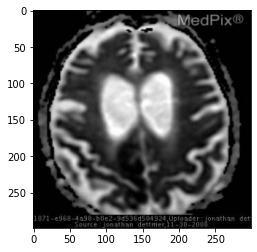

 16%|█▌        | 234/1498 [50:15<4:28:40, 12.75s/it]

ORIGINAL ----------------
Modality: MR - ADC Map (App Diff Coeff) Plane: Axial
Anatomy: Brain and Neuro   Findings: A new large area of
restricted diffusion in the right posterior cerebral artery
territory involving the parasagittal right parietal and
right occipital regions.  Numerous areas of periventricular
and deep white matter intensities on the DWI are not present
on the ADC map.  This represents probable T2 shine-through
corresponding to diffuse chronic microvascular ischemic
changes.   Impression: Posterior Cerebral Artery Infarction


AI GENERATED ------------
Modality: mr adc map app diff coeff plane axial  Anatomy:
brain and neuro   Findings: • ring enhancing lesion right
frontal lobe  • surrounding vasogenic edema  • lesion has
low signal intensity rim on t2 sequences  • elevated signal
intensity within lesion on dwi images  • ring is restricted
diffusion


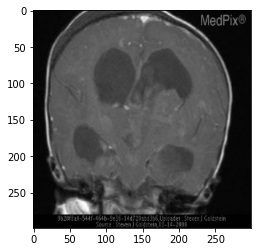

 16%|█▌        | 235/1498 [50:28<4:30:14, 12.84s/it]

ORIGINAL ----------------
Modality: MR - T1W w/Gadolinium Plane: Coronal  Anatomy:
Brain and Neuro   Findings: •  Large frond-like  tumor
masses in the right lateral and Third ventricle. •
Hydrocephalus •  Contrast enhanced study reveals
leptomeningeal tumor and parenchymal spread of tumor,
especially in the cerebellum   Impression: Atypical
Teratoid/Rhabdoid Tumor


AI GENERATED ------------
Modality: mr t1w wgd fat suppressed plane axial  Anatomy:
brain and neuro   Findings: • large cystic mass in the right
choroidal fissure  • focal enhancement following contrast  •
no enhancement of the administration   Impression:
glioblastoma multiforme


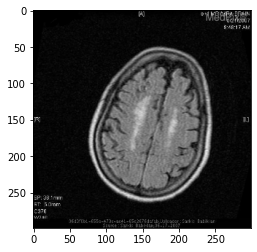

 16%|█▌        | 236/1498 [50:41<4:29:09, 12.80s/it]

ORIGINAL ----------------
Modality: MR - FLAIR Plane: Transverse  Anatomy: Brain and
Neuro   Findings: •  MRI Brain: "There is mild, age-
appropriate volume loss. There is periventricular and deep
white matter symmetric signal abnormality. There is no
intracranial hemorrhage, mass, or mass effect. The brain
parenchyma, CSF-containing spaces, posterior fossa, limited
views of the internal auditory canals and orbits, overlying
skull, and soft tissues are unremarkable."  •  MRA Head w/o
contrast: "The circle of Willis is intact. There is no
evidence of aneurysm. There is no evidence of vessel
occlusion."   Impression: Leukoaraiosis


AI GENERATED ------------
Modality: mr flair plane transverse  Anatomy: brain and
neuro   Findings: • mri brain lesion left inferior to
cavernous sinus aneurysm  • low small anterior superior
opthamic vein proptosis and enlargement of all extra axial
shows fluid level  • obstruction   Impression: traumatic
carotidcavernous fistula


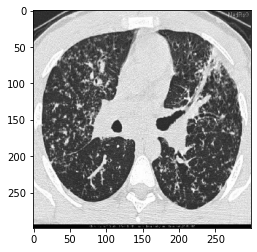

 16%|█▌        | 237/1498 [50:54<4:28:43, 12.79s/it]

ORIGINAL ----------------
Modality: CT w/contrast (IV) Plane: Axial  Anatomy: Chest,
Pulmonary (ex. Heart)   Findings: CXR and CT demonstrate
nodular interstitial lung disease with multiple superimposed
pulmonary masses/nodules. Significant mediastinal and hilar
lymphadenopathy are seen. Numerous splenic and renal nodules
are also present.   Impression: Sarcoid


AI GENERATED ------------
Modality: ct wcontrast iv plane axial  Anatomy:
cardiovascular inc heart   Findings: enhanced ct of the
heart demonstrates a bicuspid aortic valve with thickening
of the edge of the valve leaflets there is associated
poststenotic dilation of the ascending aorta the patient was
also noted to have a small muscular


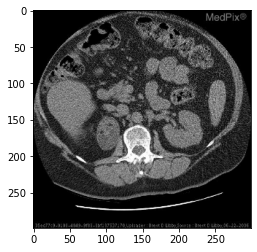

 16%|█▌        | 238/1498 [51:06<4:27:57, 12.76s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Axial  Anatomy:
Genitourinary   Findings: Round, well-circumscribed, 4.2 cm
mass arising from the right adrenal gland containing
discrete foci of low attenuation density measuring -52
Hounsfield units.  No calcifications were identified.
Impression: Adrenal Myelolipoma


AI GENERATED ------------
Modality: ct noncontrast plane axial  Anatomy: genitourinary
Findings: old ct for comparison mild hydrouretonephrosis new
ct with marked increase in hydrouretonephrosis with distal
obstruction no renal or ureter calculi identified foley in
decompressed bladder spot ap flouro images demonstrate
percutaneous nephrosomy placement with tubes in renal pelvis
dilated ureters


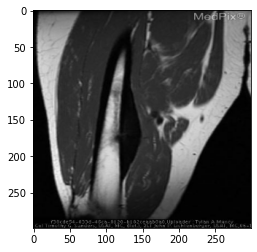

 16%|█▌        | 239/1498 [51:19<4:27:37, 12.75s/it]

ORIGINAL ----------------
Modality: MR - T1W - noncontrast Plane: NOS - Not specified
Anatomy: MSK - Musculoskeletal   Findings: AP and lateral
(lateral not shown) radiographs of the right femur
demonstrated a zone of cortical thickening with a smooth
contour along the medial aspect of the distal right femoral
metadiaphysis (Fig 1).  A central lucency measuring 2.5 cm
craniocaudal can be seen with a small component of
associated cortical penetration.  No surrounding soft tissue
abnormalities were evident.    MR T1 coronal image (Fig. 2)
demonstrates the wide cortical thickening with associated
cortical penetration.   Follow-up MR imaging validated the
cortical thickening as low signal intensity. On T2-weighted
images a nidus in the mid femoral shaft was noted with high
signal intensity and enhancement following administration of
intravenous gadolinium (Figs. 3&4). There is marked bone
production medially, with adjacent bone marrow edema
involving the mid femoral shaft.  Nuclear medicin

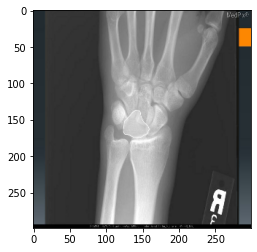

 16%|█▌        | 240/1498 [51:32<4:28:15, 12.79s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: Lateral  Anatomy: MSK -
Musculoskeletal   Findings: Abnormal alignment of the distal
radius, lunate, and capitellum   Impression: Lunate
dislocation


AI GENERATED ------------
Modality: xr plain film plane ap  Anatomy: msk
musculoskeletal   Findings: ap and lateral radiographs of
the wrist show that the lunate bone additionally a
transverse fracture is present shows the ulnar aspect of the
wrist shows a disruption at the radial carpal joint
Impression: scapholunate dissociation stress fracture


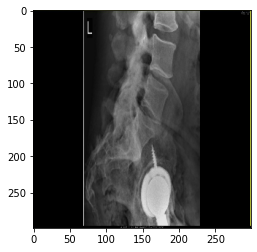

 16%|█▌        | 241/1498 [51:45<4:29:15, 12.85s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: nan  Anatomy: MSK -
Musculoskeletal   Findings: Figure 1. Plain film AP Pelvis.
MARKEDLY SEVERE DEGENERATIVE CHANGES ARE NOTED AT THE RIGHT
HIP JOINT. THERE IS EROSION/ABSENCE OF THE RIGHT FEMORAL
HEAD.   Figure 2-6. 4 views of Lumbar spine on plain film
x-ray including lateral flexion and extension views.  MILD
TO MODERATE DEXTROSCOLIOSIS OF THE LUMBAR SPINE IS NOTED.
MILD DEGENERATIVE DISC DISEASE IS NOTED AT THE L4-5 LEVEL.
Figure 7-10. Whole Body Bone Scan. Flow portion of the
three-phase bone scan was performed in anterior projection
with attention to the bilateral hips. Next, whole body bone
scan was performed approximately 2 hours following the
intravenous injection of 25.0 mCi of technetium-99m labeled
MDP.   This Bone Scan was done after recent car accident.
Findings of Bone Scan- THERE IS NO EVIDENCE FOR LOOSENING OF
THE LEFT HIP PROSTHESIS. SEVERE DEGENERATIVE CHANGES ARE
NOTED AT THE RIGHT HIP JOINT. THERE IS NO EVI

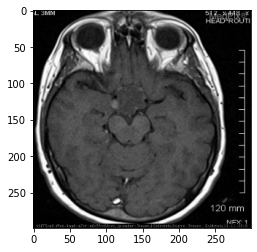

 16%|█▌        | 242/1498 [51:58<4:30:07, 12.90s/it]

ORIGINAL ----------------
Modality: MR - T1W - noncontrast Plane: Axial  Anatomy:
Brain and Neuro   Findings: •  Enhancing mass extending from
sella into supra sellar cistern.   Impression:
Craniopharyngioma


AI GENERATED ------------
Modality: mr flair plane axial  Anatomy: brain and neuro
Findings: • intraventricular mass left temporal horn  •
isointense to slightly hyperintense on t1 and t2 mri  • no
restricted diffusion  • focal small areas of enhancement
Impression: central neurocytoma


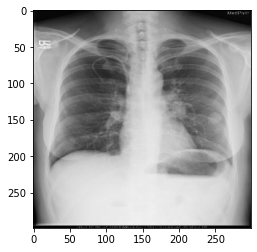

 16%|█▌        | 243/1498 [52:11<4:29:44, 12.90s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: PA  Anatomy: Pathology
Findings: Study from December demonstrates increase in size
and quantity of masses over all lung fields as compared to
previous study of August in the same year.  Largest mass,
measuring 3cm, is located peripherally in the left lung
field.  There is prominent lymphadenopathy in both hila.  A
9.5 cm length of catheter is present in the left pulmonary
artery and extends into the inferior branch.   Impression:
Stage IV Melanoma Migration of broken catheter


AI GENERATED ------------
Modality: xr plain film plane pa  Anatomy: chest pulmonary
ex heart   Findings: cxr bilateral r>l hilar enlargement and
pleural thickening ct chunky calcification of mediastinal
nodes pleural nodules and interstitial thickening in upper
lobes   Impression: pulmonary sarcoidosis


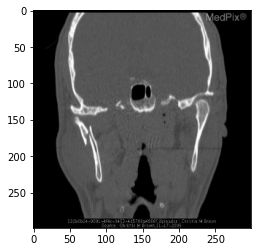

 16%|█▋        | 244/1498 [52:24<4:33:44, 13.10s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Coronal  Anatomy: Head and
Neck (ex. orbit)   Findings: Oblique fracture across the
right mandibular condyle.  Predominantly vertical, displaced
fracture through the mandibular symphysis with a slight
obliquity to the left.   Impression: Mandible "ring"
fracture


AI GENERATED ------------
Modality: ct noncontrast plane coronal  Anatomy: head and
neck ex orbit   Findings: ct of the facial bones demontrates
fractures of the lateral orbital wall at the
zygomaticofrontal suture orbital floor in the region of the
zygomaticomaxillary suture and zygoma there is a rotational
deformity of the fracture fragment impression


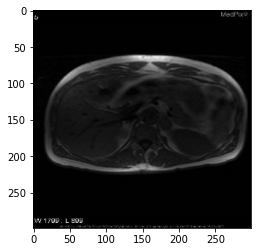

 16%|█▋        | 245/1498 [52:37<4:33:01, 13.07s/it]

ORIGINAL ----------------
Modality: MR - T1W - noncontrast Plane: Axial  Anatomy:
Genitourinary   Findings: Axial and coronal MR images
demonstrate a left adrenal mass that is isointense on T1,
T2, and T2 fat sat sequences.  Signal drop out is
demonstrated on out-of-phase sequences.   Impression:
Adrenal Adenoma


AI GENERATED ------------
Modality: mr t1w wgd fat suppressed plane axial  Anatomy:
genitourinary   Findings: bicornuate uterus with uterine
tissue between horns   Impression: bicornuate uterus


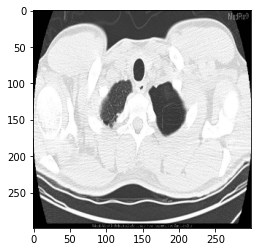

 16%|█▋        | 246/1498 [52:50<4:31:57, 13.03s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Axial  Anatomy: Chest,
Pulmonary (ex. Heart)   Findings: Left apical pneumothorax
secondary to several pulmonary bullae/blebs.   Impression:
Primary Spontaneous Pneumothorax


AI GENERATED ------------
Modality: ct wcontrast iv plane axial  Anatomy: chest
pulmonary ex heart   Findings: cxr prominent bilateral hila
when compared with prior cxr 5 months prior peripheral
tapering of pulmonary vasculature new airspace opacification
superior segment left lower lobe seen best on lateral view
ct pedvt large clot burden involving majority


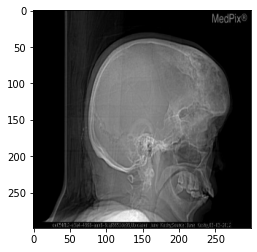

 16%|█▋        | 247/1498 [53:03<4:30:43, 12.98s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Axial  Anatomy: Brain and
Neuro   Findings: CT of the head shows an expansile, ground
glass lesion with lytic areas involving the frontal, ethmoid
and sphenoid bones.  No associated soft tissue mass is seen.
Impression: Fibrous Dysplasia


AI GENERATED ------------
Modality: xr plain film plane lateral  Anatomy: brain and
neuro   Findings: mixed attenuation extracranial mass with
smooth peripheral sclerotic margin of ossification
Impression: cephalohematoma ossified


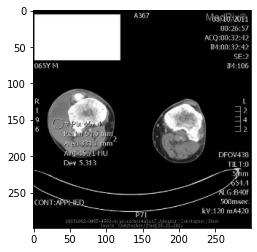

 17%|█▋        | 248/1498 [53:16<4:29:27, 12.93s/it]

ORIGINAL ----------------
Modality: CT w/contrast (IV) Plane: Axial  Anatomy: MSK -
Musculoskeletal   Findings: •  Frontal and lateral
radiographs of the right femur, tibia, and fibula did not
reveal any fractures or aggressive osseous lesions. There
were mild degenerative changes of the knee with medial and
lateral tibial spine spurring, marginal osteophyte
formation, and superior patellar osteophyte formation.
Subchondral irregularities were appreciated at the medial
tibial plateau.  •  CT with IV contrast revealed a 17 x 8 x
5 cm layering fluid collection in the subcutaneous, extra-
fascial compartment of the lateral right lower leg and knee.
Hounsfield units of the fluid collection was approximately
45. Previously identified thrombus in right venous
collecting system was not visualized due to timing of IV
contrast.   Impression: Hematoma, Compartment Syndrome


AI GENERATED ------------
Modality: ct wcontrast iv plane axial  Anatomy: chest
pulmonary ex heart   Findings: contrast en

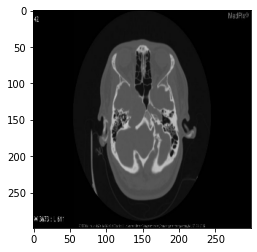

 17%|█▋        | 249/1498 [53:29<4:28:26, 12.90s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Axial  Anatomy: Brain and
Neuro   Findings: Non-contrast CT shows expansile lesion of
the right petrous apex.  MRI shows discrete mass,
hyperintense on both T1 and T2 , and no post-contrast
enhancement   Impression: Cholesterol granuloma


AI GENERATED ------------
Modality: ct noncontrast plane coronal  Anatomy: head and
neck ex orbit   Findings: ct images through the face
demonstrate welldefined lesions within the left anterior
mandible and right anterior maxilla which displace adjacent
teeth   Impression: compound composite odontoma


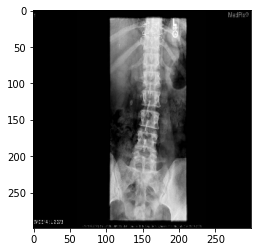

 17%|█▋        | 250/1498 [53:42<4:26:59, 12.84s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: AP  Anatomy: Genitourinary
Findings: Plain radiographs of the lumbar spine demonstrate
a well circuscribed calcification in the right upper
quadrant at the level of L3.  Sonographic images of the
kidneys demonstrate hydronephrosis with a 1.1 cm
calcification in the right ureteropelvic junction(UPJ).  CT
of the abdomen confirms the location of a 9 mm stone in the
right UPJ.   Impression: Hydronephrosis


AI GENERATED ------------
Modality: xr plain film plane oblique  Anatomy: spine
Findings: 1 ap and lateral lumbar spine xrays revealed an
airfilled rectum displaced anteriorly by a presacral soft
tissue mass the vertebral bodies and posterior elements of
the lumbar spine itself were normal there were 5 ossified
sacral segments without an


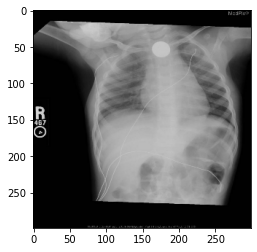

 17%|█▋        | 251/1498 [53:54<4:26:02, 12.80s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: PA  Anatomy:
Gastrointestinal   Findings: AP and lateral radiographs
demonstrate a round metallic density overlying the superior
mediastinum.   Impression: Esophageal foreign body - Coin
ingestion


AI GENERATED ------------
Modality: xr plain film plane ap  Anatomy: gastrointestinal
Findings: films i ii multiple dilated small bowel loops with
differential airfluid levels consistent with obstruction
note also multiple vertebral and rib anomalies films iii iv
multiple dilated small and large bowel loops with enteric
contrast through to rectum and opacification


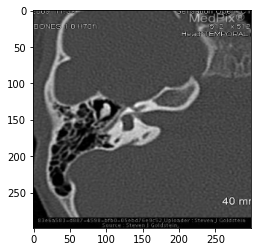

 17%|█▋        | 252/1498 [54:07<4:25:26, 12.78s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Axial  Anatomy: Head and
Neck (ex. orbit)   Findings: Dilated vestibular aqueducts.
Both right and left sides measures in excess of 3 mm in
width, more than twice normal width.   Impression: Enlarged
Vestibular Aqueduct Syndrome


AI GENERATED ------------
Modality: ct noncontrast plane axial  Anatomy: head and neck
ex orbit   Findings: • absence of normal flow void in the
right sigmoid and transverse sinus and in the jugular bulb
• high signal intensity clot in jugular bulb on t2 and flair
sequences  • mastoiditis abnormal fluid in air


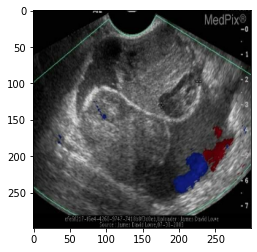

 17%|█▋        | 253/1498 [54:20<4:24:44, 12.76s/it]

ORIGINAL ----------------
Modality: US - Ultrasound Plane: Coronal  Anatomy: Abdomen -
Generalized   Findings: Single echogenic mass in the liver
seen on ultrasound. CT with contrast revealed multiple
capsular masses over the dome of the liver .  Ascites and
peritoneal studding as well as complex adnexal masses were
seen.   Impression: Metastatic Ovarian adenocarcinoma
verified by ex-LAP/pathology.


AI GENERATED ------------
Modality: us ultrasound plane sagittal  Anatomy:
genitourinary   Findings: multiple small cystic and tubular
spaces in the left adnexa   Impression: cysts due to include
an effusion


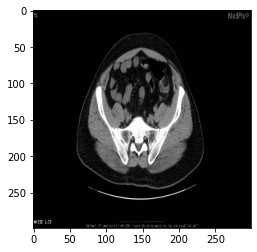

 17%|█▋        | 254/1498 [54:33<4:25:24, 12.80s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Axial  Anatomy:
Gastrointestinal   Findings: A small, rounded, fat-
containing lesion is seen adjacent to the proximal sigmoid
colon.  A surrounding soft-attenuation ring is seen about
this lesion as is mild mesenteric fat stranding.  Mild
adjacent thickening of the sigmoid colon in this area is
also noted.     No diverticula were identified.
Impression: Epiploic appendigitis


AI GENERATED ------------
Modality: ct noncontrast plane axial  Anatomy: abdomen
generalized   Findings: axial noncontrast ct images through
the lower pelvis and site of anastamosis demonstrate a large
amount of intraperitoneal free air at the site of
anastamosis there appears to be discontinuation of the lumen
of the bowel following the administration of


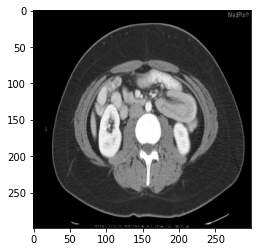

 17%|█▋        | 255/1498 [54:45<4:24:53, 12.79s/it]

ORIGINAL ----------------
Modality: CT w/contrast (IV) Plane: Axial  Anatomy:
Gastrointestinal   Findings: Contrast enhanced axial CT of
the abdomen demonstrates extraluminal mesenteric fat located
around a proximal jejununal segment (intussusceptum)
telescoping into the lumen of an adjacent and more distal
jejunal segment (intussuscipiens).   Impression: Transient
adult jejunojejunal intussusception secondary to IBD (Crohn
disease).


AI GENERATED ------------
Modality: ct gi iv contrast plane axial  Anatomy:
gastrointestinal   Findings: cecal volvulus   Impression:
cecal volvulus


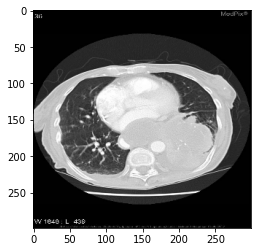

 17%|█▋        | 256/1498 [54:58<4:24:12, 12.76s/it]

ORIGINAL ----------------
Modality: CT w/contrast (IV) Plane: Axial  Anatomy: Chest,
Pulmonary (ex. Heart)   Findings: -Initial chest x-ray shows
an opacity within the left lower lobe.  This was initially
called pneumonia. -Subsequent chest CT demonstrates this to
be a mass within the left lower lobe with extensive
mediastinal spread.   Impression: Small Cell Lung Carcinoma
(SCLC)


AI GENERATED ------------
Modality: ct noncontrast plane axial  Anatomy: chest
pulmonary ex heart   Findings: cxr bibasilar interstitial
pattern ct pe study diffuse ground glass greater at bases
Impression: pleural effusions


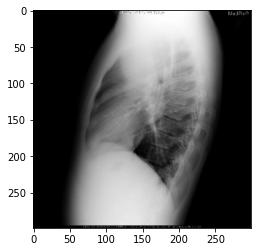

 17%|█▋        | 257/1498 [55:11<4:23:07, 12.72s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: Lateral  Anatomy: Chest,
Pulmonary (ex. Heart)   Findings: PA and lateral radiographs
demonstrate a large lobulated upper mediastinal mass
measuring approximately 10 x 13 x 16 cm, projecting
predominately to the right, but obscuring the upper margin
of the aortic arch.  PET Scan demonstrates multiple foci of
activity, including a large region of increased activity in
the superior mediastinum.  The spleen demonstrates increased
activity.  Increased activity is also seen in the right
supraclavicular region, sub-carinal and paraaortic regions,
as well as multiple rib and vertebral lesions.   Impression:
Hodgkin's Lymphoma


AI GENERATED ------------
Modality: xr plain film plane lateral  Anatomy: chest
pulmonary ex heart   Findings: • cxr large destructive left
apical mass involving the chest wall there is vertebral
destruction pleural metastasis lymphadenopathy and a
contralateral lung nodules  • ct 1 large left upper lobe
mass w

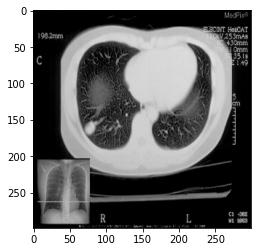

 17%|█▋        | 258/1498 [55:24<4:24:45, 12.81s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Axial  Anatomy: Chest,
Pulmonary (ex. Heart)   Findings: Chest CT images
demonstrate a right lower lobe peripheral pulmonary nodule
in association with a tortuous vessel leading to the nodule
Impression: Pulmonary Arteriovenous Malformation (PAVM)


AI GENERATED ------------
Modality: ct wcontrast iv plane axial  Anatomy: chest
pulmonary ex heart   Findings: cxr palat showed destructive
silhouette prominent pulmonary vasculature and bilateral
hila   Impression: bilateral pleural effusions


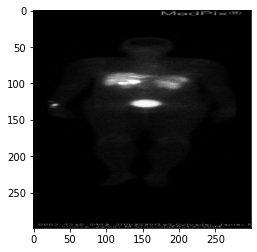

 17%|█▋        | 259/1498 [55:36<4:23:08, 12.74s/it]

ORIGINAL ----------------
Modality: NM - Nuclear Medicine Plane: Frontal  Anatomy:
Gastrointestinal   Findings: A large 5 cm mass is seen in
the porta hepatis region on the CT examination, between the
head of the pancreas and the inferior vena cava, causing
mass effect on the vena cava.  A hypodense lesion in the
liver is suspicious for a metastatic focus. The In-111
octreotide scan demostrates an intense focus of activity in
the porta hepatis region, with fainter foci of activity in
the liver and left hilum.   Impression: Zollinger-Ellison
Syndrome wtih metastatic gastrinomas


AI GENERATED ------------
Modality: xr plain film plane ap  Anatomy: genitourinary
Findings: ultrasound of the l kidney shows mild
hydronephrosis and a 75 by 55 cm mass located in the lower
pole of the kidney   Impression: upj obstruction imaging


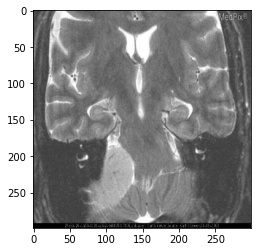

 17%|█▋        | 260/1498 [55:49<4:22:21, 12.71s/it]

ORIGINAL ----------------
Modality: MR - T2 weighted Plane: Coronal  Anatomy: Brain
and Neuro   Findings: Sagital T1W pre-gad images
demonstrates a well circumscribed, isointense, extra-axial
cerebellopontine angle mass. Coronal T2W image again shows
the mass to be slightly increased in signal in comparison to
the surrounding brain tissue. Axial T1W post-gad image
demonstrate a homogenously enhancing mass.   Impression:
Cerebellopontine angle meningioma - path proven


AI GENERATED ------------
Modality: mr t2 weighted plane coronal  Anatomy: head and
neck ex orbit   Findings: ct   Findings: o tbone ct poorly
marginated lesion with amorphous intratumoral bony spicules
know as the “honeycomb” appearance is a distinctive imaging
finding of facial hemangiomas this finding is seen in 100 of
larger lesions enlargement


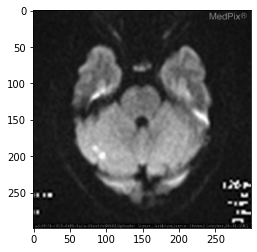

 17%|█▋        | 261/1498 [56:02<4:21:58, 12.71s/it]

ORIGINAL ----------------
Modality: MR - DWI Diffusion Weighted Plane: Axial  Anatomy:
Head and Neck (ex. orbit)   Findings: Short section
irregular contour right proximal vertebral artery with
intraluminal filling defect. Multiple small right cerebellar
infarcts.   Impression: Vertebral Artery Dissection with
Cerebellar Infarcts


AI GENERATED ------------
Modality: mr dwi diffusion weighted plane axial  Anatomy:
brain and neuro   Findings: • multiple bilateral cerebral
infarcts of varying ages and sizes  • acute infarcts in the
right frontal lobe  • absent flow in the distal ica mca and
aca vessels   Impression: moyamoya


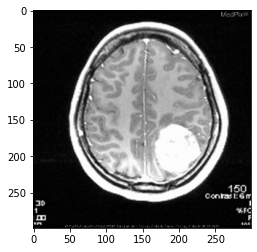

 17%|█▋        | 262/1498 [56:14<4:21:14, 12.68s/it]

ORIGINAL ----------------
Modality: MR - T1W w/Gadolinium Plane: Axial  Anatomy: Brain
and Neuro   Findings: 5 to 6  cm mass in the left parietal
lobe   Mass is hyperdense on CT Lesion has mixed signal on
all MRI sequences Irregular enhancement pattern with foci of
necrosis   Impression: Gliosarcoma


AI GENERATED ------------
Modality: mr t1w wgadolinium plane axial  Anatomy: brain and
neuro   Findings: • ct chest bilateral pulmonary airspace
disease with halo sign characteristic of hemorrhage new
splenic and liver lesions probably due to infarcts and
infection  • mri brain multiple enhancing lesions in left
cerebellum and right frontal white matter


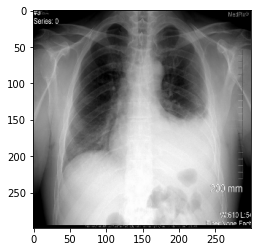

 18%|█▊        | 263/1498 [56:27<4:21:49, 12.72s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: PA  Anatomy: Generalized
Findings: •  multiple displaced left sided rib fractures •
pleural fluid collection consistent w/hemothorax
Impression: Rib Fractures, hemothorax, left


AI GENERATED ------------
Modality: xr plain film plane pa  Anatomy: chest pulmonary
ex heart   Findings: cxr prominent bilateral hila when
compared with prior cxr 5 months prior peripheral tapering
of pulmonary vasculature new airspace opacification superior
segment left lower lobe seen best on lateral view ct pedvt
large clot burden involving majority


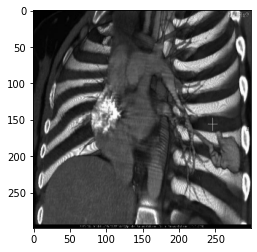

 18%|█▊        | 264/1498 [56:40<4:21:31, 12.72s/it]

ORIGINAL ----------------
Modality: CT w/contrast (IV) Plane: 3D Reconstruction
Anatomy: Chest, Pulmonary (ex. Heart)   Findings: •  CXR
shows a solitary pulmonary nodule/opacity within the left
lower lobe.    •  Axial CT images of the chest demonstrate a
well-defined solitary peripheral mass with curvilinear
structures extending to/from,  consistent with feeding
arteries and draining veins.   Impression: Pulmonary
Arteriovenous Malformation (PAVM)


AI GENERATED ------------
Modality: mr t2 weighted plane sagittal  Anatomy: spine
Findings: • mri october 2000 severe epidural lipomatosis
while on steroids  • mri july 2007 epidural lipomatosis has
partially resolved following cessation of steroid treatment
in 2001   Impression: epidural lipomatosis


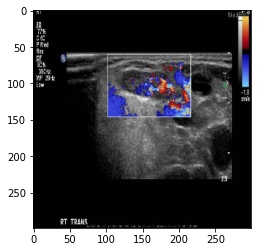

 18%|█▊        | 265/1498 [56:53<4:21:29, 12.72s/it]

ORIGINAL ----------------
Modality: US-D - Doppler Ultrasound Plane: Transverse
Anatomy: Eye and Orbit (exclude Ophthalmology)   Findings:
Lobulated, intensely enhancing mass lesion with high flow
intralesional vessels.   Impression: Capillary Hemangioma


AI GENERATED ------------
Modality: us ultrasound plane transverse  Anatomy:
genitourinary   Findings: the left testicle is enlarged and
heterogeneous in appearance with hypoechoic areas
Impression: seminoma


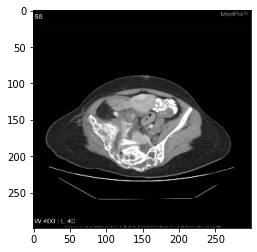

 18%|█▊        | 266/1498 [57:05<4:20:37, 12.69s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Axial  Anatomy: MSK -
Musculoskeletal   Findings: Single AP view of the pelvis
demonstrates a deformed right iliac bone with lucent
appearing lesions with sclerotic margins.  The pelvic wall
is medially displaced.  The sacrum is also involved, but is
difficult to visualize.   An axial CT through the pelvis
demonstrates a deformed region of bone with a honeycomb
trabecular appearance.   Impression: Hemangiomatosis


AI GENERATED ------------
Modality: ct gi iv contrast plane axial  Anatomy:
gastrointestinal   Findings: ct images demonstrate an
enlarged fluid filled enhancing appendix with
periappendiceal fat stranding small foci of extraluminal air
and a small fluid collection are present   Impression:
ruptured appendicitis


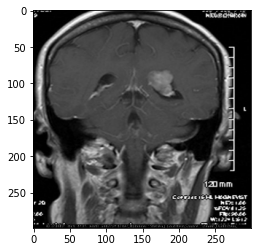

 18%|█▊        | 267/1498 [57:18<4:21:12, 12.73s/it]

ORIGINAL ----------------
Modality: MR - T1W w/Gadolinium Plane: Coronal  Anatomy:
Brain and Neuro   Findings: 2 cm enhancing mass in atria of
left lateral ventricle   Impression: Intraventricular
meningioma


AI GENERATED ------------
Modality: mr t1w wgadolinium plane coronal  Anatomy: brain
and neuro   Findings: • left temporal lobe hemorrhagic mass
in left lateral ventricle  • mass enhances with contrast
enhancement  • no hydrocephalus   Impression:
intraventricular meningioma


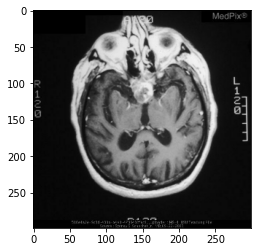

 18%|█▊        | 268/1498 [57:31<4:23:57, 12.88s/it]

ORIGINAL ----------------
Modality: MR - T1W w/Gadolinium Plane: Axial  Anatomy: Brain
and Neuro   Findings: Fig 1. Contrast enhanced axial MRI
showing a partially cystic suprasellar mass.  Fig 2.
Contrast enhanced coronal MRI showing the partially cystic
suprasellar mass.   Fig 3. Histological section of the
resected tumor showing irregular expanses of squamous
epithelium in which basal cells and stellate cells can be
seen.  Also present are bands of eosinophilic fibrous
tissue.  Fig 4. In other areas, there were large masses of
“wet” keratin in which ill-defined remnants of nuclei can be
seen.   Impression: Adamantinomatous craniopharyngioma


AI GENERATED ------------
Modality: mr flair plane axial  Anatomy: brain and neuro
Findings: • ct day 1 hyperdense middle cerebral artery hdmca
sign suggesting intraluminal clot  • mri day 1 early
cytotoxic edema and restricted diffusion consistent with
acute right mca infarct  • mri 7 weeks later well developed
mca infarct with


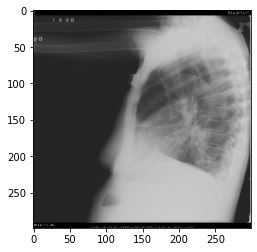

 18%|█▊        | 269/1498 [57:44<4:23:26, 12.86s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: Lateral  Anatomy: Chest,
Pulmonary (ex. Heart)   Findings: Numerous, scattered, small
masses   Impression: Lung Metastasis


AI GENERATED ------------
Modality: xr plain film plane lateral  Anatomy: chest
pulmonary ex heart   Findings: cxr bilateral r>l hilar
enlargement and pleural thickening ct chunky calcification
of mediastinal nodes pleural nodules and interstitial
thickening in upper lobes   Impression: pulmonary
sarcoidosis


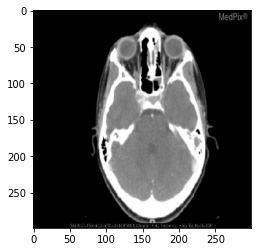

 18%|█▊        | 270/1498 [57:57<4:23:20, 12.87s/it]

ORIGINAL ----------------
Modality: CT w/contrast (IV) Plane: Axial  Anatomy: Brain
and Neuro   Findings: Image 1 – Axial NECT:  Subtle soft
tissue density right parasellar region Image 2 – Axial CECT:
The cavernous sinus is distended on the right with irregular
enhancement of parasellar density Image 3 – Axial Fat
Saturation T1WI: Isointense extra-axial lesion right
parasellar region, appears to encase cavernous carotids;
Left sinus disease Image 4 – Axial T2WI: Slight hyperintense
extra-axial lesion right cavernous sinus; Left sinus disease
Image 5 – MRA: Normal MRA without definite carotid
involvement  Image 6 – Sagittal T1WI+: Diffuse enhancement
of lesion Image 7 – Axial FLAIR T1WI+: Diffuse enhancement
of lesion   Impression: Tolosa Hunt


AI GENERATED ------------
Modality: ct noncontrast plane axial  Anatomy: brain and
neuro   Findings: ct axial noncontrast ct of the brain
showed an acute sah in the right frontal lobe brain cerebral
angiogram lateral projection of the right cer

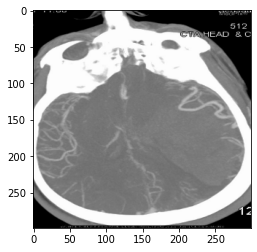

 18%|█▊        | 271/1498 [58:10<4:22:12, 12.82s/it]

ORIGINAL ----------------
Modality: CTA - CT Angiography Plane: Axial  Anatomy: Brain
and Neuro   Findings: Multiple large vessels surrounding
hematoma on CTA.   Impression: Arteriovenous Malformation,
Ruptured


AI GENERATED ------------
Modality: cta ct angiography plane axial  Anatomy: brain and
neuro   Findings: • ctsubarachnoid hemorrhage hyperdense
basilar cisterns and sulci  • ctabasilar tip aneurysm
Impression: basilar artery aneurysm basilar tip aneurysm


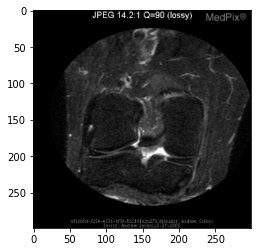

 18%|█▊        | 272/1498 [58:22<4:22:31, 12.85s/it]

ORIGINAL ----------------
Modality: MR - Other Pulse Seq. Plane: Coronal  Anatomy: MSK
- Musculoskeletal   Findings: On sagital images there is
"ghosting" of the medial meniscus as you progress from
lateral to medial. The coronal images show the radial tear
of the medial meniscus.   Impression: Meniscal Tear


AI GENERATED ------------
Modality: mra mr angiographyvenography plane axial  Anatomy:
brain and neuro   Findings: severely atrophic brain with
diffuse cortical and subcortical calcification embolic
material producing star artifacts partially occluding the
avm drainage into the falcine sinus there is still a patent
venous sac draining avm   Impression: vein of galen
malformation aneurysm


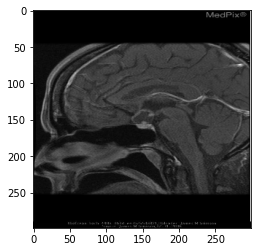

 18%|█▊        | 273/1498 [58:35<4:21:04, 12.79s/it]

ORIGINAL ----------------
Modality: MR - T1W w/Gadolinium Plane: Sagittal  Anatomy:
Brain and Neuro   Findings: There is a predominantly fluid
("cystic") mass with some peripheral nodularity in a
suprasellar location.  The lesion displays hypointense
central signal on T1 and hyperintense signal on T2 weighted
images.  The lesion also displays peripheral nodular
enhancement.   Impression: Craniopharyngioma


AI GENERATED ------------
Modality: mr t1w wgd fat suppressed plane sagittal  Anatomy:
msk musculoskeletal   Findings: plain radiographs
demonstrate cortical discontinuity in distal first phalanx
with cortical disruption along the blood bone window of the
compressive inferior aspect of the distal aspect of the
adjacent acetabulum   Impression: femoral condyle fracture
of the acromioclavicular


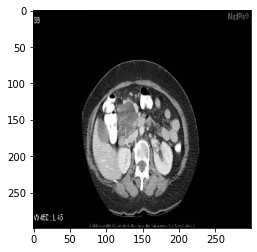

 18%|█▊        | 274/1498 [58:48<4:20:32, 12.77s/it]

ORIGINAL ----------------
Modality: CT - GI & IV Contrast Plane: Axial  Anatomy: Left
Blank   Findings: Images from a multiphase CT exam of the
pancreas demonstrates a complex cystic mass centered in the
head of the pancreas with enhancing internal septa and
multiple cysts, some of which are < 2cm in size. The cysts
averaged fluid attenuation on all sequences. On the
nonenhanced image, dystrophic calcification is noted within
the cyst wall. No intra or extrahepatic or pancreatic ductal
dilatation.   Impression: Microcystic (serous) adenoma of
the pancreas


AI GENERATED ------------
Modality: ct gi iv contrast plane axial  Anatomy:
genitourinary   Findings: severe leftsided hydronephrosis
and hydroureter causing prominent mass effect on the
underlying bowel and vasculature the cause is likely the
18mm ureterolith in the distal left ureter just proximal to
the ureterovesical junction   Impression: giant
hydronephrosis with hydroureter secondary


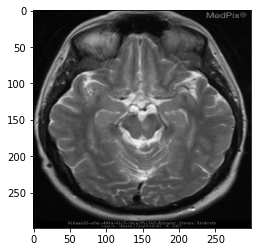

 18%|█▊        | 275/1498 [59:01<4:22:18, 12.87s/it]

ORIGINAL ----------------
Modality: MR - T2 weighted Plane: Axial  Anatomy: Pathology
Findings: •  Lesion of the mid-brain at the level of the
left Third Cranial Nerve nucleus. •  Hyperintense on DWI
Impression: cerebral infarction


AI GENERATED ------------
Modality: mr t2 weighted plane axial  Anatomy: brain and
neuro   Findings: • february mri mesial temporal lobe non
enhancing lesion on the left  • june mri interval
development of multiple enhancing lesions with central
necrosis in left hemisphere and dural enhancement overlying
left frontal and parietal lobe   Impression: multicentric


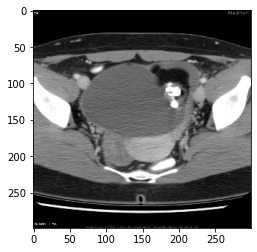

 18%|█▊        | 276/1498 [59:14<4:22:24, 12.88s/it]

ORIGINAL ----------------
Modality: CT - GI & IV Contrast Plane: Axial  Anatomy:
Genitourinary   Findings: On multiple US images a complex
adnexal mass is seen with both solid and cystic components.
No signifcant blood flow (lack of color) present.  On CT,
the lesion is seen to extent from the left ovary with
multiple areas of calcification that likely represent teeth.
Fat attenuation tissue and cystic components are noted.
Impression: Cystic Teratoma


AI GENERATED ------------
Modality: ct gi iv contrast plane axial  Anatomy:
gastrointestinal   Findings: >> diffuse enlargement of the
vermiform appendix >> mesenteric fat stranding in the right
lower quadrant >> no contrast enhancement within the
appendiceal lumen >> an appendicolith was present in the
appendiceal lumen   Impression: acute appendicitis


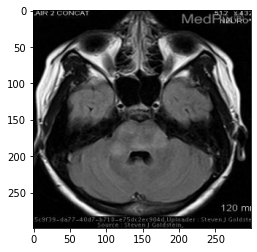

 18%|█▊        | 277/1498 [59:27<4:24:05, 12.98s/it]

ORIGINAL ----------------
Modality: MR - FLAIR Plane: Axial  Anatomy: Brain and Neuro
Findings: •  Multiple lesions in white matter, pons,
midbrain, and basal ganglia. •  Lesion have elevated T2
signal with minimal mass effect. •  No enhancement
Impression: Acute Disseminated Encephalomyelitis


AI GENERATED ------------
Modality: mr flair plane axial  Anatomy: brain and neuro
Findings: • quadrigeminal plate csf signal cyst  •
compresses vermis  • elevates basal vein sof rosenthal  •
multiple white matter lesions consistent with ms
Impression: arachnoid cyst


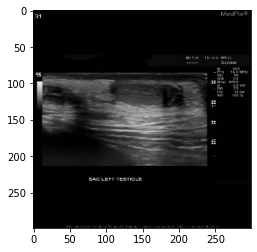

 19%|█▊        | 278/1498 [59:40<4:23:49, 12.98s/it]

ORIGINAL ----------------
Modality: US - Ultrasound Plane: Longitudinal  Anatomy:
Genitourinary   Findings: Testicles and epididymies
visualized in the inguinal canals with normal echogenicity
bilaterally and normal vascular flow   Impression:
Undescended testicles


AI GENERATED ------------
Modality: us ultrasound plane transverse  Anatomy:
genitourinary   Findings: ultrasound was performed of the
kidneys the left kidney demonstrates a hypoechoic soft
tissue mass in the central renal sinus fat splaying the
pelvic vasculature noncontrast ct followed by iv contrast
demonstrates a similar soft tissue mass with enhancement
this is


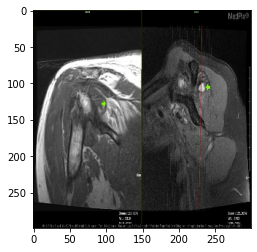

 19%|█▊        | 279/1498 [59:53<4:22:45, 12.93s/it]

ORIGINAL ----------------
Modality: MR - T1W - noncontrast Plane: Coronal  Anatomy:
MSK - Musculoskeletal   Findings: One month s/p MVC, MRI
evaluation revealed:  1.      Complete tear of the
supraspinatus tendon with retraction.  2.      High-grade
partial tear of the distal subscapularis tendon.  3.
Intrasubstance partial tear of the infraspinatus tendon.  4.
Partial tear of the proximal biceps tendon.  5.
Superior labral from anterior to posterior (SLAP) tear.  6.
Osteoarthritis of the glenohumeral joint and osteoarthrosis
of the acromioclavicular joint.  Two and a half years s/p
surgical repair of shoulder, MRI revealed:  1.      Old
post-surgical changes of left humerus with associated
osteoarthritic changes and suspicious for developing
avascular necrosis.  2.      Large recurrent full thickness
tear of the supraspinatus tendon with muscle atrophy and
associated large joint effusion communicating with the
subacromion and subdeltoid bursa with marked distention of
the bursa.  3.  

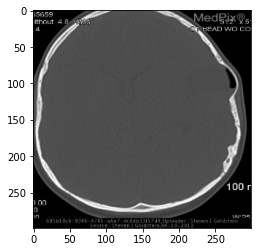

 19%|█▊        | 280/1498 [1:00:06<4:22:53, 12.95s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Axial  Anatomy: Brain and
Neuro   Findings: Left middle cranial fossa Arachnoid cyst
with focal expansion of the temporal squamosa.  Large
Subdural hematoma extending over the left hemisphere
convexity.  Persistent Falcine Sinus present on MRV.
Impression: Arachnoid Cyst associated, Spontaneous Subdural
Hematoma


AI GENERATED ------------
Modality: ct noncontrast plane axial  Anatomy: brain and
neuro   Findings: • skull base complex mass extending into
sella and suprasellar cistern  • irregular enhancement on
mri  • mottled calcification noted within mass on ct
Impression: chondrosarcoma of skull base


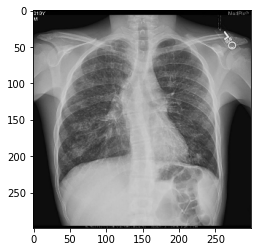

 19%|█▉        | 281/1498 [1:00:19<4:21:42, 12.90s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: Frontal  Anatomy: Chest,
Pulmonary (ex. Heart)   Findings: Perihilar linear
denisities and peribronchial cuffing.   Impression: Cystic
Fibrosis


AI GENERATED ------------
Modality: xr plain film plane pa  Anatomy: chest pulmonary
ex heart   Findings: pa and lateral chest radiographs
demonstrate a 15 x 23 cm right middle lung ct of the thorax
lung windows reveals that the right hilum with ill defined
mass in the right medial segment right lower lobe


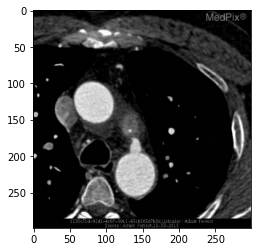

 19%|█▉        | 282/1498 [1:00:32<4:22:11, 12.94s/it]

ORIGINAL ----------------
Modality: CT w/contrast (IV) Plane: Axial  Anatomy:
Cardiovascular (inc. Heart)   Findings: Cardiac-gated CTA
images in multiple planes demonstrate a patent ductus
arteriosus, shown by a small contrast-enhanced vessel
connecting the descending aorta to the pulmonary artery.
Patency of vessel is demonstrated by a jet of contrast
spilling into the pulmonary artery at its connection with
the ductus arteriosus.  Of note, you can see changes in the
proximal descending aortic wall indicative of this patient's
stable aneurysm/dissection.   Impression: Patent Ductus
Arteriosus


AI GENERATED ------------
Modality: ct wcontrast iv plane axial  Anatomy:
cardiovascular inc heart   Findings: unenhanced ct shows
displaced intimal calcification enhanced ct shows intimal
flap extending from ectatic aortic root through descending
thoracic aorta dissection extends into the aneurysmal
innominate artery   Impression: aortic dissection debakey
type i stanford class a


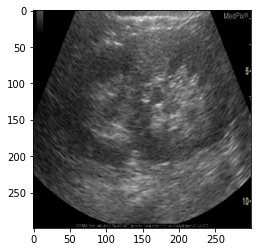

 19%|█▉        | 283/1498 [1:00:45<4:21:21, 12.91s/it]

ORIGINAL ----------------
Modality: US - Ultrasound Plane: Coronal  Anatomy:
Genitourinary   Findings: Ultrasound imaging of the
patient's right kidney revealed a faceless kidney sign and
showed evidence of a duplex collecting system, without
presence of hydronephrosis.   Impression: Duplicated
collecting system with presence of faceless kidney sign


AI GENERATED ------------
Modality: us ultrasound plane sagittal  Anatomy:
genitourinary   Findings: ultrasound both testes demonstrate
no tenderness is a large fluidfilled cystic mass replacing
the bilateral calcified it is hypointense to muscle there is
no cystic component the tumor is to extent measuring
approximately 11 x 11 x 11 x 11 cm


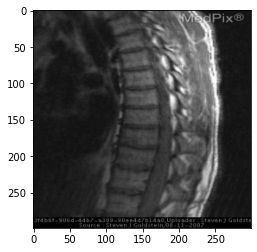

 19%|█▉        | 284/1498 [1:00:57<4:20:18, 12.87s/it]

ORIGINAL ----------------
Modality: MR - T1W - noncontrast Plane: Sagittal  Anatomy:
Spine   Findings: •  Moderate spinal cord expansion from T9
to conus •  Tumor is hyper-intense on T1 and T2 sequences •
Tumor enhances in a somewhat serpentine fashion
Impression: Spinal Cord Astrocytoma


AI GENERATED ------------
Modality: mr t1w noncontrast plane sagittal  Anatomy: spine
Findings: spit spinal cord at t11t12 no duplication of the
dural sac or nerve roots   Impression: diastematomyelia
fibrous septum


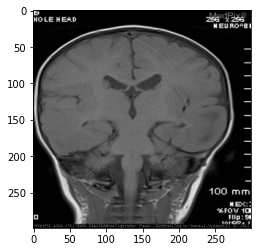

 19%|█▉        | 285/1498 [1:01:10<4:19:19, 12.83s/it]

ORIGINAL ----------------
Modality: MR - T1W - noncontrast Plane: Coronal  Anatomy:
Multisystem   Findings: •  CT Calcified subependymal lesions
in the lateral ventricular walls and low density lesion in
both cerebral hemispheres.  •  MRI Bilateral sub-cortical
and subependymal lesions best seen on T2 sequences. No mass
effect of enhancement.   Impression: Tuberous Sclerosis


AI GENERATED ------------
Modality: mr t1w wgadolinium plane coronal  Anatomy: brain
and neuro   Findings: • enhancing mass in atrial portion of
right lateral ventricle  • no invasion of adjacent brain  •
no hydrocephalus   Impression: intraventricular meningioma


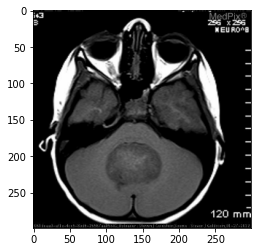

 19%|█▉        | 286/1498 [1:01:23<4:20:20, 12.89s/it]

ORIGINAL ----------------
Modality: MR - T1W - noncontrast Plane: Axial  Anatomy:
Brain and Neuro   Findings: •  Intraventricular mass with
enhancement expanding the fourth ventricle. •  Subtle
leptomeningeal enhancement lying behind the spinal cord at
T8 and T9 levels.   Impression: Medulloblastoma (PNET)


AI GENERATED ------------
Modality: mr flair plane axial  Anatomy: brain and neuro
Findings: • solid left cerebellar subacute hematoma with
some mass effect  • 4th ventricle minimally compressed  •
hemosiderin ring surrounding hematoma  • lineartubular
enhancement  • popcorn lesion medial and inferior to
hematoma   Impression: developmental venous anomaly dva and
cavernous malformation


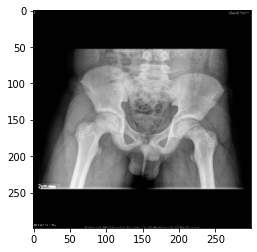

 19%|█▉        | 287/1498 [1:01:36<4:19:19, 12.85s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: AP  Anatomy: MSK -
Musculoskeletal   Findings: Widened, irregular proximal
femoral physis on the left. Also, a tangential line along
the lateral border of the femoral neck fails to intersect
any portion of the left femoral epiphysis.   Impression:
Slipped capital femoral epiphysis


AI GENERATED ------------
Modality: xr plain film plane ap  Anatomy: msk
musculoskeletal   Findings: ap and lateral radiographs of
the hips show serpiginous lines of sclerosis along the
femoral heads there is flattening and subchondral fracture
of the right femoral head additionally the right femoral
head is smaller than the left mri imaging


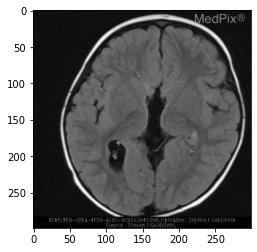

 19%|█▉        | 288/1498 [1:01:49<4:19:07, 12.85s/it]

ORIGINAL ----------------
Modality: MR - FLAIR Plane: Axial  Anatomy: Nerve, central
Findings: •  Agenesis of the corpus callosum •  Subependymal
gray matter   Impression: Agenesis of the Corpus Callosum
and subependymal gray matter  heterotopia


AI GENERATED ------------
Modality: mr flair plane axial  Anatomy: brain and neuro
Findings: • left parietal mass with irregular enhancement
and surrounding edema  • nonenhancing central portion
consistent with necrotic tumor   Impression: glioblastoma
multiforme


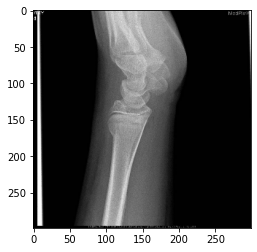

 19%|█▉        | 289/1498 [1:02:01<4:18:26, 12.83s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: Lateral  Anatomy: MSK -
Musculoskeletal   Findings: Buckle fracture of distal radius
(torus fracture)   Impression: Torus Fracture of the Distal
Radius


AI GENERATED ------------
Modality: xr plain film plane lateral  Anatomy: msk
musculoskeletal   Findings: ap lateral and oblique
radiographs of the wrist show conminuted distal radial
fracture with a following inflammatory changes digital
fragmentation of the following intraarticular extension
associated with a lesser degree oblique low lying dimensions
of the sclerotic and extend


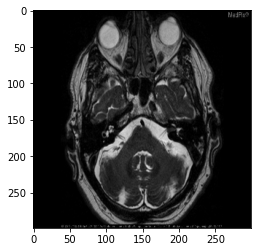

 19%|█▉        | 290/1498 [1:02:14<4:17:37, 12.80s/it]

ORIGINAL ----------------
Modality: MR - T2 weighted Plane: Axial  Anatomy: Brain and
Neuro   Findings: ?ultiplanar and multi-sequence MR imaging
demonstrates the presence of a small enhancing mass inside
the left internal auditory canal. The mass remains
intracanalicular without causing any expansion of the left
internal auditory canal. Given the clinical history , the
above findings are more consistent with vestibular
schwannoma.   Impression: Vestibular schwannoma


AI GENERATED ------------
Modality: mr t2 weighted plane axial  Anatomy: brain and
neuro   Findings: ultiplanar and multisequence mr imaging
demonstrates the presence of a small enhancing mass inside
the left internal auditory canal the mass remains
intracanalicular without causing any expansion of the left
internal auditory canal given the clinical history the


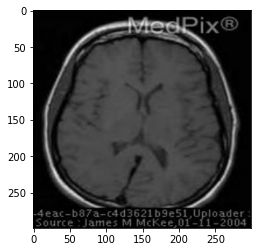

 19%|█▉        | 291/1498 [1:02:27<4:19:11, 12.88s/it]

ORIGINAL ----------------
Modality: MR - T1W - noncontrast Plane: Axial  Anatomy:
Brain and Neuro   Findings: Broad region of gray matter
intensity in the right temporo-occipital region of the brain
causing mild mass effect on the right lateral ventrical.
Impression: Gray Matter Heterotopia, Focal Type


AI GENERATED ------------
Modality: mr t1w wgadolinium plane axial  Anatomy: brain and
neuro   Findings: • infiltrative mass in right frontal lobe
• mass has elevated si on t2 scans and decreased si on t1
scans  • minimal to no contrast enhancement   Impression:
dnet dysembryoplastic neuroepithelial tumor


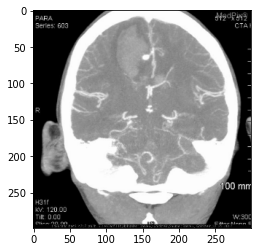

 19%|█▉        | 292/1498 [1:02:40<4:20:06, 12.94s/it]

ORIGINAL ----------------
Modality: CTA - CT Angiography Plane: Coronal  Anatomy:
Brain and Neuro   Findings: •  CT brain--right frontal lobe
hematoma •  CTA brain-- enhancing focus adjacent to hematoma
•  Angiogram--aneurysm arising from the distal portion of
the right callosomarginal artery.   Impression: Mycotic
aneurysm


AI GENERATED ------------
Modality: cta ct angiography plane coronal  Anatomy: brain
and neuro   Findings: • ctsubarachnoid hemorrhage hyperdense
basilar cisterns and sulci  • ctabasilar tip aneurysm
Impression: basilar artery aneurysm basilar tip aneurysm


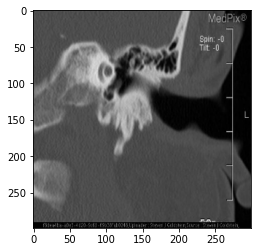

 20%|█▉        | 293/1498 [1:02:53<4:19:13, 12.91s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Coronal  Anatomy: Brain
and Neuro   Findings: 5 mm soft tissue mass adjacent to
promontory of cochlea. No bone erosion.   Impression: Glomus
tympanicum tumor (paraganglioma)


AI GENERATED ------------
Modality: ct noncontrast plane coronal  Anatomy: head and
neck ex orbit   Findings: • longitudinal fracture passing
through anterior wall of external auditory canal into tmj  •
the fracture extends along the floor of the middle cranial
fossa into the sphenoid sinus   Impression: longitudinal
petrous temporal bone fracture


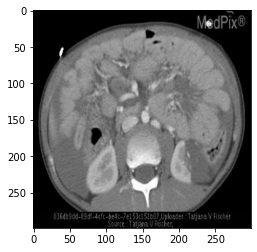

 20%|█▉        | 294/1498 [1:03:06<4:19:24, 12.93s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Axial  Anatomy:
Multisystem   Findings: Large intraperitoneal metal fragment
adjacent to the aorta superiorly to the left renal arteries.
Injury of the lower pole of the left kidney with large
avulsion, devascularized splen, hematoma in the pancreatic
tail. Intraperitoneal air and peritoneal fluid bilaterally
in the gutters.   Impression: Perforating fragment


AI GENERATED ------------
Modality: ct gi iv contrast plane axial  Anatomy:
genitourinary   Findings: • 6 cm x 6 cm enhancing mass
originating from the right kidney low density areas are seen
around the mass  • no ct evidence of renal vein involvement
Impression: renal cell carcinoma


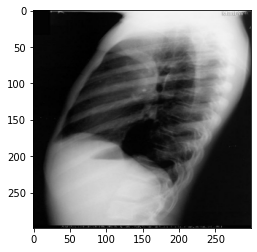

 20%|█▉        | 295/1498 [1:03:19<4:18:57, 12.92s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: Lateral  Anatomy: Chest,
Pulmonary (ex. Heart)   Findings: •  PA and lateral chest
radiographs:  Large, circumscribed anterior mediastinal mass
abutting the ascending aorta, pulmonary artery, and left
heart border.  No evident adenopathy or pleural effusion.
•  Contrast-enhanced chest CT:  Circumscribed, heterogeneous
anterior mediastinal mass containing multiple components
with fluid and fat attenuation - but no calcifications.  The
mass abuts and displaces the thymus - but appears separate.
No adenopathy or evidence of local invasion.   Impression:
Mediastinal Mature Teratoma


AI GENERATED ------------
Modality: xr plain film plane lateral  Anatomy: chest
pulmonary ex heart   Findings: • cxr large destructive left
apical mass involving the chest wall there is vertebral
destruction pleural metastasis lymphadenopathy and a
contralateral lung nodules  • ct 1 large left upper lobe
mass with adjacent chest wall invasion with


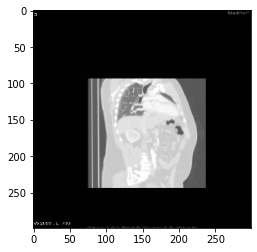

 20%|█▉        | 296/1498 [1:03:32<4:19:12, 12.94s/it]

ORIGINAL ----------------
Modality: CT w/contrast (IV) Plane: Sagittal  Anatomy:
Chest, Pulmonary (ex. Heart)   Findings: An accessory artery
originates just superior to the celiac trunk which
terminates in the medial basal segment of the right lower
lobe.  No airspace opacity is seen within the right lower
lobe.  Pulmonary veins within the region empty into the left
atrium.   Impression: Pulmonary Sequestration


AI GENERATED ------------
Modality: ct noncontrast plane sagittal  Anatomy: spine
Findings: the imaging demonstrated a t23 level of the
cervical spine with a scalpel sign indicating a likely
arachnoid cyst inferior to the syrinx   Impression:
arachnoid cyst causing hydromyelia


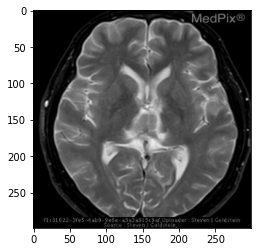

 20%|█▉        | 297/1498 [1:03:45<4:18:18, 12.90s/it]

ORIGINAL ----------------
Modality: MR - T2 weighted Plane: Axial  Anatomy: Brain and
Neuro   Findings: •  Mass appears to arise from the midbrain
or tectal plate  •  Mass involves both thalami -
infiltrating? •  Compresses third ventricle •  Homogeneous
enhancement   Impression: Pineal Germinoma (seminoma),
intracranial primary


AI GENERATED ------------
Modality: mr t2 weighted plane axial  Anatomy: brain and
neuro   Findings: • ring enhancing lesion right frontal lobe
• surrounding vasogenic edema  • lesion has low signal
intensity rim on t2 sequences  • elevated signal intensity
within lesion on dwi images  • decreased signal on adc map
Impression: brain


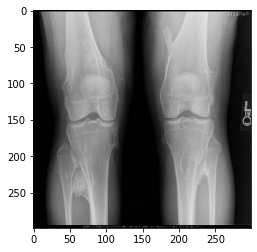

 20%|█▉        | 298/1498 [1:03:58<4:16:54, 12.85s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: AP  Anatomy: MSK -
Musculoskeletal   Findings: •  Multiple sessile and
pedunculated osseous lesions •  These have continuity with
both the cortex and the medullary cavity   Impression:
Hereditary Multiple Exostoses


AI GENERATED ------------
Modality: xr plain film plane ap  Anatomy: msk
musculoskeletal   Findings: ap and lateral radiographs of
the left knee demonstrate an effusion mri demonstrates a
welldefined hyperechoic lesion in the proximal femur with a
narrow zone of transition and low signal intensity on the
lesion is high signal on t2


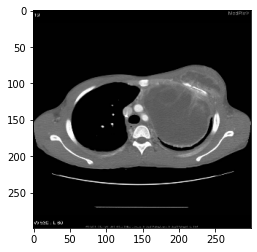

 20%|█▉        | 299/1498 [1:04:10<4:16:08, 12.82s/it]

ORIGINAL ----------------
Modality: CT w/contrast (IV) Plane: Axial  Anatomy: Brain
and Neuro   Findings: CT - There is a large heterogeneous
and partially enhancing mass within the left chest. It
compresses the main and left pulmonary arteries as well as
left main bronchus. It also has mass effect on the left
ventricle although no definite pericardium invasion is
identified.   MR - 12.5 X 12.1 X 16.5cm mass within the left
hemithorax with extension through the chest wall and under
the left pectoralis muscle. There is a tissue plane between
the mass and the aorta. Mass effect on left main bronchus
and pulmonary artery. Lesion is heterogeneous in signal on
both T1 and T2 sequences and demonstrates heterogenous
enhancement on the post-contrast images.   Impression:
Malignant peripheral nerve sheath tumor (MPNST) with
divergent rhabdomyosarcoma differentiation vs pleomorphic
sarcoma


AI GENERATED ------------
Modality: ct wcontrast iv plane axial  Anatomy:
cardiovascular inc heart   Find

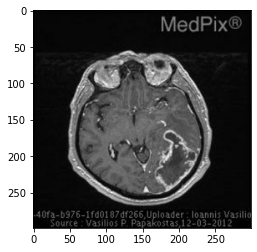

 20%|██        | 300/1498 [1:04:23<4:15:44, 12.81s/it]

ORIGINAL ----------------
Modality: MR - T1W w/Gadolinium Plane: Axial  Anatomy: Brain
and Neuro   Findings: A large , heterogeneous T2
hyperintense, ring enhancing mass lesion is noted in the
left temporoparietooccipital area. The mass lesion is
surrounded by vasogenic edema and exerts significant mass
effect in the adjacent cerebral parenchyma and left
occipital horn. The  combination of findings are consistent
with a high grade glioma.   Impression: Glioblastoma
Multiforme


AI GENERATED ------------
Modality: mr t1w wgd fat suppressed plane axial  Anatomy:
brain and neuro   Findings: contrastenhanced head ct and ct
images demonstrating a ringenhancing lesion in the right
temporal lobe extending through an eroded tegmen tympani
vasogenic edema surrounds the ring enhancing lesion
Impression: cerebral abscess


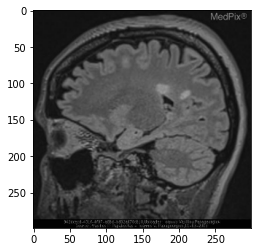

 20%|██        | 301/1498 [1:04:36<4:14:37, 12.76s/it]

ORIGINAL ----------------
Modality: MR - FLAIR Plane: Sagittal  Anatomy: Brain and
Neuro   Findings: Multiplanar MR Imaging demonstrates the
presence of two new demyelinating lesions in juxtacortical
white matter of the left frontal lobe compared with a
previous Brain MRI scan performed three months ago. These
new lesions enhance vividly after gadolinium -based contrast
administration, indicating active disease.   Impression:
Multiple Sclerosis- active stage.


AI GENERATED ------------
Modality: mr flair plane sagittal  Anatomy: brain and neuro
Findings: • ct wellmarginated lowdensity cystic appearing
cerebellar aneurysm  • cerebellar artery with a posterior
mural nodule  • cerebellar artery  • cerebellar artery
aneurysm and draining small cavernous cerebellar origin with
a posterior low cerebellar artery aneurysm   Impression:
cerebellar artery


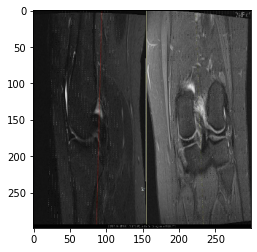

 20%|██        | 302/1498 [1:04:48<4:13:37, 12.72s/it]

ORIGINAL ----------------
Modality: MR - T2 weighted Plane: Multiple or Montage
Anatomy: MSK - Musculoskeletal   Findings: Fig 1: Coronal
and axial T2 MRI of L Knee – PCL and menisci  On coronal
view there is increased signal in the proximal PCL near its
attachment at the femur as well as diffuse increased signal
within the anterior lateral meniscus which is seen to extend
to the superior articular cartilage. On axial view a foci of
increased signaling in the proximal portion of the PCL is
visible as well as slightly increased signal and blurring of
meniscal space in the anterior portion of the lateral
meniscus and posterior portion of the medial meniscus
consistent with the friable appearance of maceration of the
cartilage.    Fig 2: Coronal and sagittal T2 MRI of L Knee –
Lateral meniscus  Coronal view shows increased signaling
throughout the lateral meniscus in various orientations
consistent with a complex tear along with extension of
abnormal signaling into the superior articular 

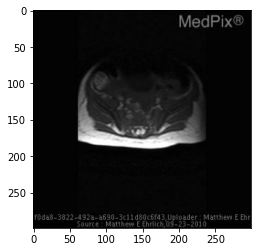

 20%|██        | 303/1498 [1:05:01<4:12:36, 12.68s/it]

ORIGINAL ----------------
Modality: MR - T1W - noncontrast Plane: Axial  Anatomy:
Spine   Findings: The exam of the brain, cranium,
craniocervical junction, and upper cervical spinal cord are
unremarkable (not shown).    There is normal alignment of
the vertebral bodies and facets throughout the spine.  Bone
marrow is homogeneous in signal intensity.  There is a
tethered cord, terminating as a lipomyelocele.  The neural
placode-lipoma interface is located within the spinal canal
at approximately S3. There is associated posterior spinal
dysraphism. No meningocele is identified. There is no
syrinx.  Lipoma is noted in the subcutaneous region
extending into the spinal canal more marked on the left
side. The overlying skin is intact.   Impression:
Lipomyelocele


AI GENERATED ------------
Modality: mr t2 weighted plane axial  Anatomy: msk
musculoskeletal   Findings: mri bone marrow edema within the
lateral cuneiform bone with transverse fracture line
thickened plantar fascia with high t2 s

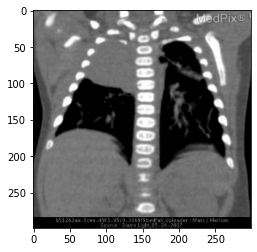

 20%|██        | 304/1498 [1:05:14<4:11:58, 12.66s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Coronal  Anatomy: Chest,
Pulmonary (ex. Heart)   Findings: •  Frontal view of the
chest shows a large right paraspinal mass with splaying of
the 3rd and 4th posterior ribs.  •  Non-contrast CT image of
the chest below the carina shows a soft-tissue paraspinal
mass with calcification medially.   •  Contrast-enhanced CT
image above the carina shows epidural extension.    Ovoid
region of enhancement; and, anteriorly is atelectatic lung.
•  Pre- and post-contrast T1-weighted MR images show the
mass to be of intermediate intensity with heterogeneous
enhancement. The mass abuts the trachea and epidural
extension is clearly seen.   •  Sagittal T2-weighted MR
image shows extension of the mass into the right neural
foramina from T2-T4.   Impression: Thoracic Neuroblastoma


AI GENERATED ------------
Modality: ct wcontrast iv plane coronal  Anatomy:
cardiovascular inc heart   Findings: cardiacgated gated
images cholelithiasis liver is a

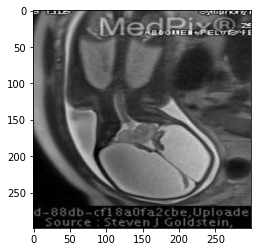

 20%|██        | 305/1498 [1:05:26<4:12:35, 12.70s/it]

ORIGINAL ----------------
Modality: MR - T2 weighted Plane: Coronal  Anatomy: Brain
and Neuro   Findings: Cerebral hemispheres replaced by fluid
filled sacs. Intact falx cerebri. Midbrain and cerebellum
unremarkable.   Impression: Hydranencephaly


AI GENERATED ------------
Modality: mr t1w noncontrast plane sagittal  Anatomy: brain
and neuro   Findings: • large cystic mass in the right
cerebellar hemisphere with rounded mural soft tissue nodule
• mr cystic right cerebellar hemisphere mass  • isointense
to slightly heterogeneous enhancement following contrast
Impression: medulloblastoma


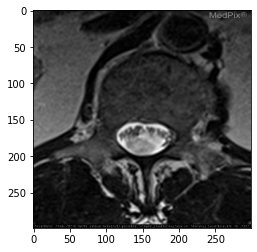

 20%|██        | 306/1498 [1:05:39<4:12:23, 12.70s/it]

ORIGINAL ----------------
Modality: MR T2* gradient,GRE,MPGR,SWAN,SWI Plane: Sagittal
Anatomy: Head and Neck (ex. orbit)   Findings: •  a 1.5 cm
mass lying behind cauda equina at L1-2.  •  Mass enhances
following contrast administration.  •  No associated bone
changes nor neuroforaminal enlargement.   Impression:
Ependymoma. Grade II


AI GENERATED ------------
Modality: mr t1w wgd fat suppressed plane sagittal  Anatomy:
brain and neuro   Findings: destructive lesion at l2 with
ventral paraspinal enhancing collection consistent with
abscess   Impression: spinal tuberculosispotts disease


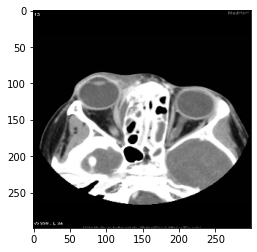

 20%|██        | 307/1498 [1:05:52<4:11:10, 12.65s/it]

ORIGINAL ----------------
Modality: CT w/contrast (IV) Plane: Axial  Anatomy: Eye and
Orbit (exclude Ophthalmology)   Findings: right eye
proptosis inflammatory change medial to medial rectus muscle
with enhancing mass along right medial orbital wall
ethmoidal air cell opacification   Impression: Subperiosteal
abscess


AI GENERATED ------------
Modality: ct gi iv contrast plane axial  Anatomy:
gastrointestinal   Findings: pancreatic head mass mass
Impression: which appears to invade the great vessels and
highly paraganglioma


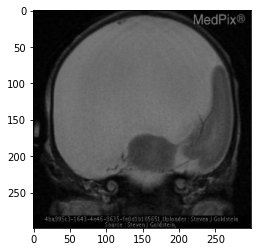

 21%|██        | 308/1498 [1:06:04<4:10:27, 12.63s/it]

ORIGINAL ----------------
Modality: MR - T2 weighted Plane: Coronal  Anatomy: Brain
and Neuro   Findings: •  No interhemispheric fissure  •
Fused thalami •  Monoventricle merges into posterior midline
cyst   Impression: Holoprosencephaly, alobar


AI GENERATED ------------
Modality: ct noncontrast plane axial  Anatomy: brain and
neuro   Findings: • severely depressed skull fracture  •
associated brain hematoma and extraaxial hematoma  •
pneumocephalus   Impression: depressed skull fracture


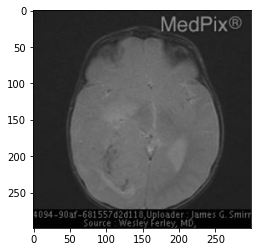

 21%|██        | 309/1498 [1:06:17<4:09:41, 12.60s/it]

ORIGINAL ----------------
Modality: MR - FLAIR Plane: Axial  Anatomy: Brain and Neuro
Findings: CT:  High density mass in the trigone of the right
lateral ventricle. Mass effect.  MRI: Right lateral
ventriclular mass with separate enhancing mass in left
temporal horn, suggesting carcinoma.  Mass effect with
midline shift.  Acute hemorrhage, right temporal horn, best
seen on GRE images.  Trapping of right temporal horn
Impression: Choroid Plexus Carcinoma


AI GENERATED ------------
Modality: mr t1w noncontrast plane axial  Anatomy: brain and
neuro   Findings: • cerebral cortical vein thrombosis  •
venous infarct left frontal lobe  • right transverse sinus
thrombosis   Impression: cerebral venous thrombosis   •
venous infarct


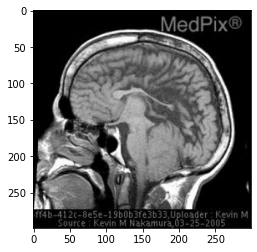

 21%|██        | 310/1498 [1:06:29<4:10:32, 12.65s/it]

ORIGINAL ----------------
Modality: MR - T1W - noncontrast Plane: Sagittal  Anatomy:
Brain and Neuro   Findings: Sagittal T1 MRI of the brain
demonstrates multiple typical findings of an Arnold Chiari
II malformation, including cerebellar tonsillar herniation,
dysgensis of the corpus callosum, a beaked tectum, towering
cerebellum, small posterior fossa, and hyperplastic massa
intermedia.  Axial FLAIR MRI demonstrates tonsillar
herniation.   Impression: Chiari II Malformation


AI GENERATED ------------
Modality: mr flair plane sagittal  Anatomy: brain and neuro
Findings: • solid mass arising from vermis with
heterogeneous enhancement  • the pons and flair  • no
contrast hemorrhage   Impression: glomus tumor paraganglioma


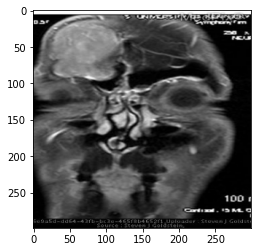

 21%|██        | 311/1498 [1:06:42<4:09:57, 12.64s/it]

ORIGINAL ----------------
Modality: MR - T1W w/Gd (fat suppressed) Plane: Coronal
Anatomy: Spine   Findings: •  Infiltrative mass right
frontal bone.   •  Destruction of both inner and outer table
of frontal bone and sinus walls •  Homogeneous enhancement
of mass.   Impression: Plasmacytoma frontal bone


AI GENERATED ------------
Modality: mr t1w wgd fat suppressed plane coronal  Anatomy:
eye and orbit exclude ophthalmology   Findings: • 10 by 14mm
mass occupying the posterior vitreous of the right eye  •
extension into optic nerve  • mass enhances homogeneously  •
no contralateral mass  • no pineal region mass   Impression:
retinoblastoma


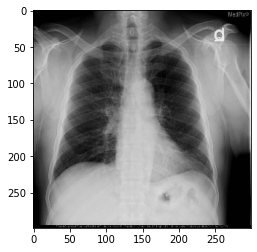

 21%|██        | 312/1498 [1:06:55<4:09:36, 12.63s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: PA  Anatomy: Chest,
Pulmonary (ex. Heart)   Findings: Airway wall thickening
with bilateral pleural plaques seen in the lateral aspects
of both lung fields on AP view.  No interstitial disease is
noted.   Impression: Pleural Plaques


AI GENERATED ------------
Modality: xr plain film plane pa  Anatomy: chest pulmonary
ex heart   Findings: pa and lateral chest radiographs
demonstrate a 15 x 23 cm right middle lung mass which is
predominantly hyperechoic cxr at the left lung that obscures
the ascending aorta there is a large hyperdense mass with in


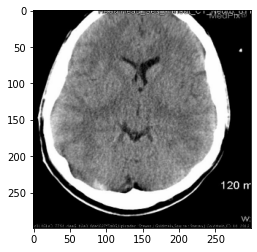

 21%|██        | 313/1498 [1:07:07<4:08:51, 12.60s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Axial  Anatomy: Brain and
Neuro   Findings: •  CT scan Hemorrhagic infarct right
parietal lobe  •  MRI scan Infarct with hemorrhage and
leptomeningeal and vascular enhancement.  No restricted
diffusion  •  MRV scan shows occlusion of multiple posterior
convexity veins and the left transverse sinus   Impression:
Venous Infarction, Thrombosis of Transverse sinus and
Multiple Cerebral Veins


AI GENERATED ------------
Modality: ct noncontrast plane axial  Anatomy: brain and
neuro   Findings: • hyperdense middle cerebral artery mca on
left  • extensive low attenuation region in the left mca
territory  • eyes deviated to side of brain lesion
Impression: cerebral infarction hyperdense mca sign


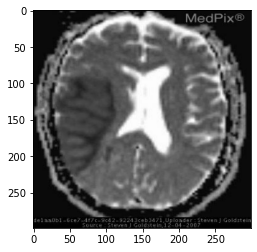

 21%|██        | 314/1498 [1:07:20<4:08:29, 12.59s/it]

ORIGINAL ----------------
Modality: MR - ADC Map (App Diff Coeff) Plane: Axial
Anatomy: Vascular   Findings: •  dolichoectasia of the right
internal carotid artery, right middle cerebral artery, and
anterior cerebral arteries •  matching DWI/ADC lesions
indicating cytotoxic edema   Impression: Cerebral arterial
dolichoectasia


AI GENERATED ------------
Modality: mr t1w wgd fat suppressed plane axial  Anatomy:
brain and neuro   Findings: • ring enhancing lesion right
frontal lobe  • surrounding vasogenic edema  • lesion has
low signal intensity rim on t2 sequences  • elevated signal
intensity within lesion on dwi images  • decreased signal on
adc map


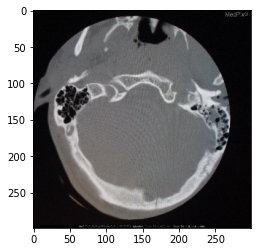

 21%|██        | 315/1498 [1:07:33<4:09:39, 12.66s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Axial  Anatomy: Brain and
Neuro   Findings: Bone windows show nondisplaced left
basilar skull fracture from region of (but not including)
left occipital condyle, and through temporal bone in a
longitudinal fashion, traversing mastoid air cells. Mastoid
effusion is seen.  Soft tissue windows show small bifrontal
subdural hematomas (contrecoup injury).   Impression:
Basilar Skull Fracture


AI GENERATED ------------
Modality: ct noncontrast plane axial  Anatomy: head and neck
ex orbit   Findings: ct of the head and neck demonstrates a
nondisplaced fracture of the right occipital condyle with
extension posteriorly into the occipital bone the
atlantoaxial and atlantooccipital relationship is normal
there is extensive subcutaneous air   Impression: occipital
condyle


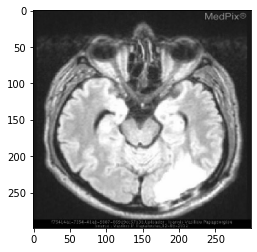

 21%|██        | 316/1498 [1:07:46<4:10:52, 12.73s/it]

ORIGINAL ----------------
Modality: MR - FLAIR Plane: Axial  Anatomy: Brain and Neuro
Findings: A large , heterogeneous T2 hyperintense, ring
enhancing mass lesion is noted in the left
temporoparietooccipital area. The mass lesion is surrounded
by vasogenic edema and exerts significant mass effect in the
adjacent cerebral parenchyma and left occipital horn. The
combination of findings are consistent with a high grade
glioma.   Impression: Glioblastoma Multiforme


AI GENERATED ------------
Modality: mr flair plane axial  Anatomy: brain and neuro
Findings: nchct demonstrates hemorrhage in the lateral
ventricles and the fourth ventricle with intraparenchymal
hemorrhage adjacent to this in the right cerebellum mri
demonstrates multiple flow voids in the right cerebellum
which enhance on post gadolinium images angiography
demonstrates right


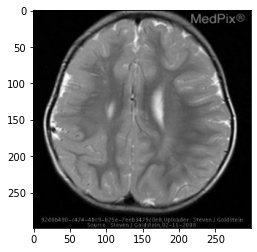

 21%|██        | 317/1498 [1:07:58<4:10:51, 12.74s/it]

ORIGINAL ----------------
Modality: MR - T2 weighted Plane: Axial  Anatomy: Brain and
Neuro   Findings: Abnormally thick cerebral cortex with
minimal sulci Right parietal and temporal lobes
Impression: Cortical Dysplasia, Pachygyria


AI GENERATED ------------
Modality: mr t2 weighted plane axial  Anatomy: brain and
neuro   Findings: • left frontal lobe mass  • mass has a
thick wall with calcifications  • there is no associated
vasogenic edema   Impression: papillary glioneuronal tumor
low grade


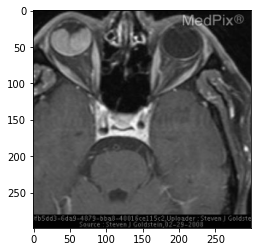

 21%|██        | 318/1498 [1:08:11<4:09:20, 12.68s/it]

ORIGINAL ----------------
Modality: MR - T1W w/Gd (fat suppressed) Plane: Axial
Anatomy: Abdomen - Generalized   Findings: •  Mass right
eye.   •  Retinal detachment   Impression: Ocular  melanoma


AI GENERATED ------------
Modality: mr t1w wgd fat suppressed plane coronal  Anatomy:
head and neck ex orbit   Findings: bulky infiltrative mass
in the right nasopharynx and oropharynx infiltrating the
skull base metastatic lymphadenopathy noded in neck
Impression: nonkeratinizing undifferentiated carcinoma
oropharyngeal cancer


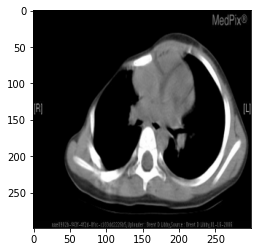

 21%|██▏       | 319/1498 [1:08:24<4:09:27, 12.70s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Axial  Anatomy: MSK -
Musculoskeletal   Findings: Ribs 1 through 8 are hypoplastic
anteriorly.  There is agenesis of the right pectoralis major
and minor muscles.  The right latissimus dorsi is
hypoplastic.  There is soft tissue webbing between the
fingers of the right hand, without osseous bridging.
Impression: Poland's Syndrome


AI GENERATED ------------
Modality: ct noncontrast plane axial  Anatomy:
cardiovascular inc heart   Findings: • aberrant origin there
subclavian artery and the right subclavian artery following
the aortic arch without evidence of a diverticulum and
lateral cervical esophagus   Impression: right sided aortic
arch with aberrant right subclavian artery


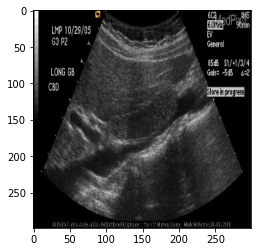

 21%|██▏       | 320/1498 [1:08:36<4:07:47, 12.62s/it]

ORIGINAL ----------------
Modality: US - Ultrasound Plane: Sagittal  Anatomy:
Gastrointestinal   Findings: Mobile, echogenic, intraluminal
structures that cast acoustic shadows are present within the
gallbladder.  There is no evidence of gallbladder wall
thickening, gallbladder enlargement or pericholecystic
fluid.  The common bile duct is not dilated.   Impression:
Cholelithiasis


AI GENERATED ------------
Modality: us ultrasound plane longitudinal  Anatomy:
genitourinary   Findings: on transabdominal ultrasound
imaging there was a normal homogeneous appearance to the
uterus and endometrial stripe no endometrial fluid or focal
areas of thickening ems measured 18 mm consistent with
endometrial atrophy endovaginal images again demonstrate
normal uniform thickness of the


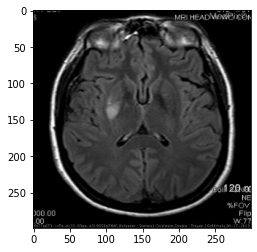

 21%|██▏       | 321/1498 [1:08:49<4:07:40, 12.63s/it]

ORIGINAL ----------------
Modality: MR - FLAIR Plane: Axial  Anatomy: Pathology
Findings: Lesion in the left basal ganglia showing
restricted diffusion (bright on DWI & dark on ADC) -  but
without any mass effect.  This lesion enhances following
contrast administration.   Impression: Basal ganglia
infarction - enhancing


AI GENERATED ------------
Modality: mr flair plane axial  Anatomy: brain and neuro
Findings: • multiple bilateral cerebral infarcts of varying
ages and sizes  • acute infarcts in the right frontal lobe
• absent flow in the distal ica mca and aca vessels
Impression: moyamoya


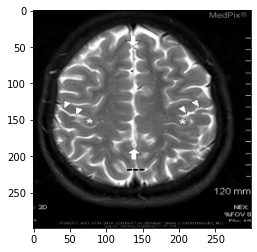

 21%|██▏       | 322/1498 [1:09:01<4:07:56, 12.65s/it]

ORIGINAL ----------------
Modality: MR - T2 weighted Plane: Axial  Anatomy: Brain and
Neuro   Findings: •  Dilated optic nerve sheaths •
Posterior flattening of the optic globes •  Empty Sella •
Focal sites of narrowing Superior Sagittal Sinus
Impression: Sagittal Sinus Stenosis, Pseudotumor  cerebri


AI GENERATED ------------
Modality: mr t2 weighted plane axial  Anatomy: brain and
neuro   Findings: • left parietooccipital mass with both
fluid cystic and solid components  • there is enhancement of
both the cyst walls and solid portions of the mass
Impression: oligodendroglioma malignant


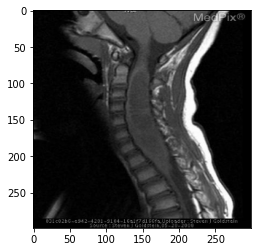

 22%|██▏       | 323/1498 [1:09:14<4:08:07, 12.67s/it]

ORIGINAL ----------------
Modality: MR - T1W - noncontrast Plane: Sagittal  Anatomy:
Spine   Findings: •  Expansile intramedullary lesion
extending full length of cervical spinal cord. •  Lesion has
both fluid ("cystic") and solid enhancing components. •
There is enlargement of the spinal canal with secondary
scalloping of the cervical vertebral bodies.   Impression:
Pilocytic Astrocytoma, Cervical Spinal Cord


AI GENERATED ------------
Modality: mr t1w noncontrast plane sagittal  Anatomy: spine
Findings: • moderate degeneration l4l5 facet joints  •
lateral recess and neural foramen mass at l45 on right  •
mass is high signal intensity on t2 images and appears to
arise from the right l45 facet joint   Impression: synovial
cyst


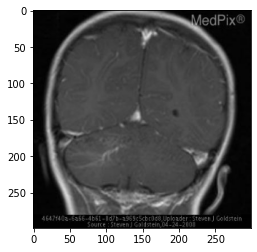

 22%|██▏       | 324/1498 [1:09:27<4:09:20, 12.74s/it]

ORIGINAL ----------------
Modality: MR - T1W w/Gadolinium Plane: Coronal  Anatomy:
Brain and Neuro   Findings: Right cerebellum -  dilated
anomalous veins that converge into an enlarged collecting
vein that extends to the right tentorial leaflet.
Impression: DVA, Developmental Venous Anomaly, venous
angioma


AI GENERATED ------------
Modality: mr t1w wgadolinium plane coronal  Anatomy: brain
and neuro   Findings: • left cerebellar subacute hematoma
with some mass effect  • 4th ventricle minimally compressed
• hemosiderin ring surrounding hematoma  • lineartubular
enhancement  • popcorn lesion medial and inferior to
hematoma   Impression: developmental venous anomaly dva and
cavernous malformation


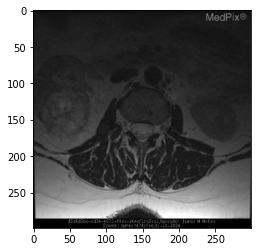

 22%|██▏       | 325/1498 [1:09:40<4:10:19, 12.80s/it]

ORIGINAL ----------------
Modality: MR - T1W - noncontrast Plane: Axial  Anatomy:
Genitourinary   Findings: Complexly enhancing mass within
lower pole of right kidney.  No evidence of renal vein
invasion.  Heterogeneity within IVC during these
corticomedulary enhanced sequences was not present on other
pre or post contrast imaging, consistent with admixture
artifact.   Impression: Renal Cell Carcinoma


AI GENERATED ------------
Modality: mr t2 weighted plane axial  Anatomy: spine
Findings: • spinal cord tethered to l34 level  • small cyst
• no sinus abnormalities  • degenerative changes in location
through foraminal narrowing location at hypoplastic right c6
indicative of abscess  • small clot is found on three noted
• bilateral


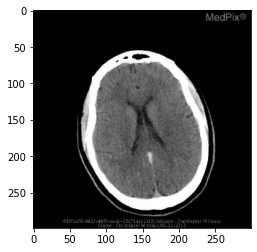

 22%|██▏       | 326/1498 [1:09:53<4:09:01, 12.75s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Axial  Anatomy: Brain and
Neuro   Findings: The vein of Galen, straight sinus, and
dominant left transverse venous dural sinus are particularly
hyperattenuating, and apparently prominent in caliber.   The
superior sagittal sinus is notably less hyperattenuating and
is normal in appearance.  The right transverse dural venous
sinus is hypoplastic.   Gray/white matter discrimination is
preserved.  There is no evidence for infarction or
intracranial hemorrhage.  There are no brain masses or mass
effect.  There is no hydrocephalus.   The skull is intact.
The partially imaged aerated portions of the skull base are
free of significant effusions..    Impression: The vein of
Galen, straight sinus, and dominant left transverse venous
dural sinus are all particularly hyperattenuating and
apparently prominent in caliber, all very concerning for
thrombosis.   Impression: Venous thrombosis of the vein of
Galen, straight sinus, and dominant 

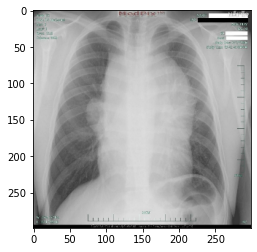

 22%|██▏       | 327/1498 [1:10:05<4:08:32, 12.73s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: PA  Anatomy: Chest,
Pulmonary (ex. Heart)   Findings: CXR- PA/LAT- showed Large
anterior mediastinal mass CT Chest- Confirmation of large
anterior mediastinal mass with mixed attenuation. The mass
exerts considerable mass effect on other mediastinal
structures.   Impression: Anterior mediastinal
nonseminomatous germ cell tumor


AI GENERATED ------------
Modality: xr plain film plane pa  Anatomy: chest pulmonary
ex heart   Findings: cxr prominent bilateral hila when
compared with prior cxr 5 months prior peripheral tapering
of pulmonary vasculature new airspace opacification superior
segment left lower lobe seen best on lateral view ct pedvt
large clot burden involving majority


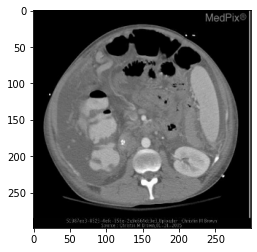

 22%|██▏       | 328/1498 [1:10:18<4:08:26, 12.74s/it]

ORIGINAL ----------------
Modality: CT - GI & IV Contrast Plane: Axial  Anatomy:
Gastrointestinal   Findings: Question small liver? Multiple
venous collaterals Splenomegaly Ascites Incidental finding
of gallstones   Impression: Cirrhosis of the Liver


AI GENERATED ------------
Modality: ct gi iv contrast plane axial  Anatomy:
gastrointestinal   Findings: >> diffuse enlargement of the
vermiform appendix >> mesenteric fat stranding in the right
lower quadrant >> no contrast enhancement within the
appendiceal lumen >> an appendicolith was present in the
appendiceal lumen   Impression: acute appendicitis


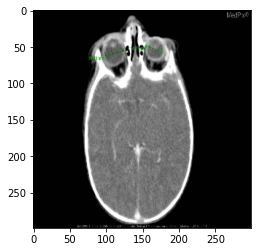

 22%|██▏       | 329/1498 [1:10:31<4:09:32, 12.81s/it]

ORIGINAL ----------------
Modality: CT w/contrast (IV) Plane: Axial  Anatomy: Eye and
Orbit (exclude Ophthalmology)   Findings: Left sided
micropthalmos.  Small left cone shaped lens.  Retrolental
density with a linear stalk that appears to attach to the
retina.   Impression: Persistent Hyperplastic Primary
Vitreous


AI GENERATED ------------
Modality: ct noncontrast plane axial  Anatomy: brain and
neuro   Findings: • craniectomy  • frontotemporal hematoma
evacuation   Impression: parenchymal hemorrhage and brain
edema after blast injury    Impression: images of the brain


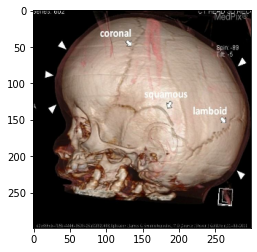

 22%|██▏       | 330/1498 [1:10:44<4:08:38, 12.77s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: 3D Reconstruction
Anatomy: MSK - Musculoskeletal   Findings: •  Skull is
elongated in sagittal (AP) diameter (dolichocephaly) •
Ridging along the sagittal suture line   Impression:
Craniosynostosis; Scaphocephaly


AI GENERATED ------------
Modality: ct noncontrast plane 3d reconstruction  Anatomy:
msk musculoskeletal   Findings: • fusion bony masses at the
hull shaped skull base of the left lesser structures with
increased signal intensity relative to the physis at skull
level and greater tuberosity   Impression: upon the orbit


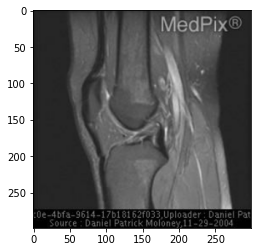

 22%|██▏       | 331/1498 [1:10:56<4:07:17, 12.71s/it]

ORIGINAL ----------------
Modality: MR - PDW Proton Density Plane: Sagittal  Anatomy:
MSK - Musculoskeletal   Findings: Complete disruption of the
ACL   Impression: ACL Tear


AI GENERATED ------------
Modality: mr t1w noncontrast plane sagittal  Anatomy: msk
musculoskeletal   Findings: plain films and mri revealed a
16cm oseous irregularity along the lateral aspect of the
medial femoral condyle a loose fragment was suspected on
plain films the mr revealed fluid signal intensity
surrounding fluid signal intensity surrounding the fragment


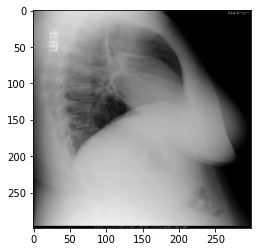

 22%|██▏       | 332/1498 [1:11:09<4:06:20, 12.68s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: AP  Anatomy: Chest,
Pulmonary (ex. Heart)   Findings: •  Chest PA/lateral -
normal  •  CT Chest w/o contrast -  Cavitary left lower lobe
nodule with evidence of endobronchial spread.   Impression:
Pulmonary Blastomycosis


AI GENERATED ------------
Modality: xr plain film plane lateral  Anatomy:
gastrointestinal   Findings: ct of the abdomen demonstrated
a radiopaque foreign body in the left lower quadrant within
the cecum with a soft tissue around the intraperitoneal
esophagus on the axial ct scan   Impression: esophageal
foreign body tumor of the abdomen


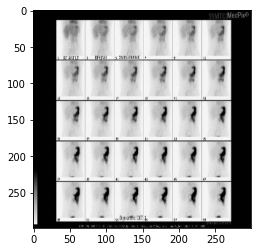

 22%|██▏       | 333/1498 [1:11:22<4:08:32, 12.80s/it]

ORIGINAL ----------------
Modality: NM - Nuclear Medicine Plane: Coronal  Anatomy:
Gastrointestinal   Findings: An axial Ct scan with oral and
IV contrast demonstrating a ring enhacing tubular structure
in the region of the ileal small bowel.   Impression:
Meckel's Diverticulum


AI GENERATED ------------
Modality: nm nuclear medicine plane nos not specified
Anatomy: head and neck ex orbit   Findings: preoperative
thyroid nuclear scan was performed i 131 77 microcurie was
administered 24 hours prior to imaging and measurement of
the radioactive uptake was 138 normal 8 30 on the day of
imaging technetium


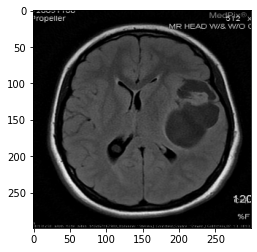

 22%|██▏       | 334/1498 [1:11:35<4:07:53, 12.78s/it]

ORIGINAL ----------------
Modality: MR - T1W w/Gadolinium Plane: Coronal  Anatomy:
Brain and Neuro   Findings: •  Large "cystic" mass in the
left temporal lobe with a "mural nodule" extending into the
basal ganglia. •  The only the nodule enhances with contrast
administration.   Impression: Pleomorphic Xanthoastrocytoma,
WHO Grade 2


AI GENERATED ------------
Modality: mr flair plane axial  Anatomy: brain and neuro
Findings: • agyria with figure 8 shape to brain  • thick
cortex  • mild hydrocephalus  • intact corpus callosum
Impression: agyria lissencephaly


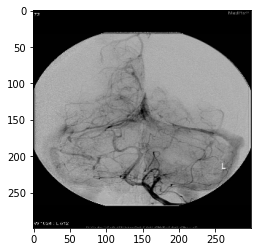

 22%|██▏       | 335/1498 [1:11:47<4:07:12, 12.75s/it]

ORIGINAL ----------------
Modality: AN - Angiogram Plane: Coronal  Anatomy: Brain and
Neuro   Findings: On T2, there is abnormal increased signal
in the medial left occipital lobe.  Dark on the ADC and
bright on DWI, this is restricted diffusion from cytotoxic
edema - consistent with acute cerebral ischemia.  The
conventional angiogram demonstrates an abrupt cut off of the
left PCA that results in decreased perfusion to the left
occipital lobe, on the arterial phase images.   Impression:
Thromboembolic Stroke Secondary to Septic Emboli


AI GENERATED ------------
Modality: an angiogram plane ap  Anatomy: brain and neuro
Findings: 6 cm extra axial left parietal mass with vasogenic
edema   Impression: meningioma


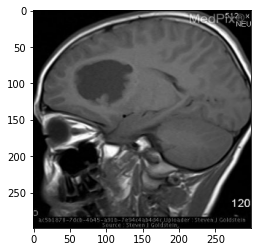

 22%|██▏       | 336/1498 [1:12:00<4:06:51, 12.75s/it]

ORIGINAL ----------------
Modality: MR - T1W - noncontrast Plane: Sagittal  Anatomy:
Brain and Neuro   Findings: •  Left frontal lobe mass •
Mass has a thick wall with calcifications •  There is no
associated vasogenic edema   Impression: Papillary
Glioneuronal Tumor, low grade


AI GENERATED ------------
Modality: mr t1w noncontrast plane sagittal  Anatomy: brain
and neuro   Findings: • complex and apparently
intraventricular mass with both fluid cystic and solid
components  • solid portions of mass enhance relatively
homogeneously  • hydrocephalus   Impression:
intraventricular cerebellar astrocytoma pilocytic
astrocytoma


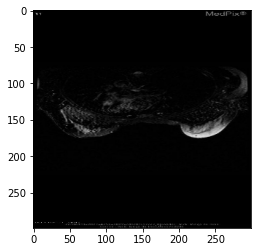

 22%|██▏       | 337/1498 [1:12:13<4:06:11, 12.72s/it]

ORIGINAL ----------------
Modality: MR - Montage Plane: Axial  Anatomy: Breast and
Mammography   Findings: Multiple well circumscribed foci of
nonenhancing, increased T2 signal on STIR and decreased
signal on T2 fat suppressed sequences in the breasts without
skin thickening.  No concerning areas of enhancement on post
gadolinium sequences.   Impression: Siliconomas:  Silicone
granulomas from direct intramammary silicone injection
breast augmentation


AI GENERATED ------------
Modality: mr t1w noncontrast plane axial  Anatomy: breast
and mammography   Findings: mammogram bilateral subglandular
implants in place there is calcification of the implant
capsule which is unchanged from the comparison study with
only abnormality in size from the comparison study with mild
increased in the lower half of the


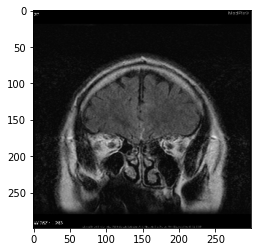

 23%|██▎       | 338/1498 [1:12:26<4:07:18, 12.79s/it]

ORIGINAL ----------------
Modality: MR - FLAIR Plane: Coronal  Anatomy: Brain and
Neuro   Findings: Noncontrast CT of the Head:  Increased
attenuation in the anterior interhemispheric fissure.  MR:
Focal area of enlargement of the flow void in the region of
the anterior interhemispheric fissure suspicious for
aneurysm of the anterior communicating artery.  MRA:
Demontrates 7 mm aneurysmal dilatation of the anterior
communicating artery.  Also identified was diffuse contour
irregularity of the distal MCA and posterior circulation
suggestive of intracranial atherosclerosis.   Impression:
Subarachnoid Hemorrhage Ruptured 7 mm Anterior Communicating
Artery Aneurysm


AI GENERATED ------------
Modality: mr flair plane coronal  Anatomy: brain and neuro
Findings: axial flair mri sequences demonstrate multiple
small foci of increased signal intensity in the
periventricular white matter which had increased in number
compared to prior mri performed four years prior the left
optic nerve was enlar

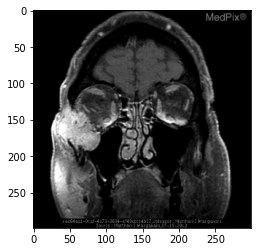

 23%|██▎       | 339/1498 [1:12:38<4:06:14, 12.75s/it]

ORIGINAL ----------------
Modality: MR - T1W w/Gadolinium Plane: Coronal  Anatomy:
Generalized   Findings: CT of the head 12/3/2010 » 3.5 x2.5
x2.3 cm invasive destructive mass at the junction of the
left zygomatic arch, left maxillary sinus and inferiolateral
wall of the left orbit »contains small bony fragments  MRI
of the head 12/14/2010 » 3.5cm expansile mass centered at
the malar eminence.  » Mass enhaced homogeneously except for
small areas of hypointensisty.  » Flow voids within the mass
MRA of the head  12/14/2010 » Enlarged blood vessels seen
extending toward and within the left orbital mass.   » The
hypervascularity of the mass is suggestive of a metastasis
CT of the abdomen and pelvis 1/25/2011 » 5 cm lower pole
left renal mass » Heterogeneus enhancement with contrast »
Contains calcifications » No renal vein involvement » No
significant lymph node enlargment  Post treatment CT of the
head 3/22/2011 » Resection of the mass » Lateral wall of the
orbit has been resected » Surg

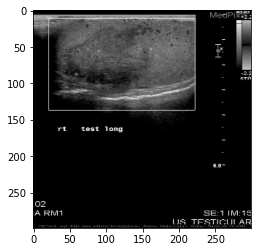

 23%|██▎       | 340/1498 [1:12:51<4:06:30, 12.77s/it]

ORIGINAL ----------------
Modality: US - Ultrasound Plane: NOS - Not specified
Anatomy: Genitourinary   Findings: Ultrasound of the
testicles demonstrated a large, heterogeneous hypoechoic
right intratesticular mass.  Multiple small hyperechoic foci
consistent with calcifications were present as well as
vascularity within the mass.   Impression: Mixed Germ Cell
Testicular Tumor


AI GENERATED ------------
Modality: us ultrasound plane sagittal  Anatomy:
genitourinary   Findings: ultrasound both testes demonstrate
no tenderness is a large solid mass measuring approximately
12mm and multiple 12 x 80 x 23 cm mass   Impression:
multiple cystic masses


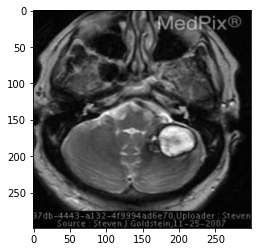

 23%|██▎       | 341/1498 [1:13:04<4:07:17, 12.82s/it]

ORIGINAL ----------------
Modality: MR - T2 weighted Plane: Axial  Anatomy: Brain and
Neuro   Findings: •  Left cerebellar subacute hematoma with
some mass effect. •  4th ventricle minimally compressed •
Hemosiderin ring surrounding hematoma •  Linear/tubular
enhancement •  "Popcorn" lesion medial and inferior to
hematoma   Impression: Developmental Venous Anomaly (DVA)
and Cavernous Malformation


AI GENERATED ------------
Modality: mr flair plane axial  Anatomy: brain and neuro
Findings: • mri enlarged left cavernous sinus and superior
opthamic vein proptosis and enlargement of all the extra
occular muscles  • angiogram direct cavernous carotid
fistula   Impression: traumatic carotidcavernous fistula


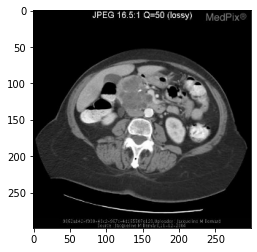

 23%|██▎       | 342/1498 [1:13:17<4:06:41, 12.80s/it]

ORIGINAL ----------------
Modality: CT - GI & IV Contrast Plane: Axial  Anatomy:
Gastrointestinal   Findings: Large multilocular cystic mass
with calcification.  The mass is located in the region of
the pancreatic head and causes mass effect on the adjacent
structures and vessels   Impression: Pancreatic
Adenocarcinoma


AI GENERATED ------------
Modality: ct gi iv contrast plane axial  Anatomy:
gastrointestinal   Findings: >> diffuse enlargement of the
vermiform appendix >> mesenteric fat stranding in the right
lower quadrant >> no contrast enhancement within the
appendiceal lumen >> an appendicolith was present in the
appendiceal lumen   Impression: acute appendicitis


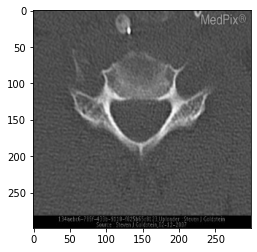

 23%|██▎       | 343/1498 [1:13:30<4:06:39, 12.81s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Axial  Anatomy: Brain and
Neuro   Findings: Original MVA Admission five months PTA:
Fracture dislocation C5-C6 with left sided perched facets.
Followup studies on this admission: Anterior fusion C5-6
Avulsion of the C5, C6 and C7 nerve roots on the left with
pseudomeningocele foramation   Impression: Cervical Nerve
Root Avulsion


AI GENERATED ------------
Modality: ct noncontrast plane axial  Anatomy: spine
Findings: • prevertebral soft tissue hematoma  • fracture
through the left c4 lateral mass and laminar arch with
unilateral perched c45 facets on the right  • herniated and
disrupted disk c45 facets with some disrupted disk c45
facets on the c56 level


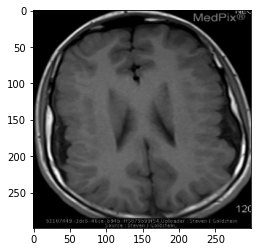

 23%|██▎       | 344/1498 [1:13:42<4:05:28, 12.76s/it]

ORIGINAL ----------------
Modality: MR - T1W - noncontrast Plane: Axial  Anatomy:
Generalized   Findings: Multiple small dysplastic cortical
gyri involving the right and left frontal and parietal
lobes.   Impression: Polymicrogyria, Bilateral.


AI GENERATED ------------
Modality: mr t1w noncontrast plane axial  Anatomy: brain and
neuro   Findings: • multiple bilateral cerebral infarcts of
varying ages and sizes  • acute infarcts in the right
frontal lobe  • absent flow in the distal ica mca and aca
vessels   Impression: moyamoya


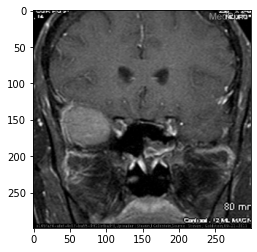

 23%|██▎       | 345/1498 [1:13:55<4:04:24, 12.72s/it]

ORIGINAL ----------------
Modality: MR - T1W w/Gd (fat suppressed) Plane: Coronal
Anatomy: Genitourinary   Findings: Enhancing mass centered
on right sphenoid ridge with extension into right orbit and
middle cranial fossa. Lesion enhances following contrast.
Impression: Pheochromocytoma, metastatic to orbit


AI GENERATED ------------
Modality: mr t1w wgd fat suppressed plane coronal  Anatomy:
brain and neuro   Findings: ct shows thickening of the falx
and the tentorium bilaterally contrast shows extensive
bilateral extraaxial subdural fluid consistent with hematoma
sdh overlying both cerebral hemispheres the sdh is also seen
layering in between the cerebral hemishperes


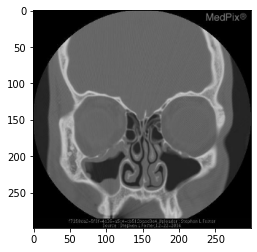

 23%|██▎       | 346/1498 [1:14:08<4:03:50, 12.70s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Coronal  Anatomy: Eye and
Orbit (exclude Ophthalmology)   Findings: Blowout fracture
of orbital floor with involvement of the infraorbital
foramen.  No entrapment of the inferior rectus muscle.
Impression: Blowout fracture of orbit


AI GENERATED ------------
Modality: ct noncontrast plane axial  Anatomy: brain and
neuro   Findings: • marked dilatation of the vein of galen
• fistula fed by hypertrophied branches of the anterior aca
and posterior pca cerebral arteries  • hydrocephalus  •
tortuous veins at skull base draining the normal brain
Impression: aneurysmal dilation of


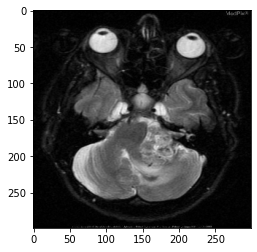

 23%|██▎       | 347/1498 [1:14:21<4:05:32, 12.80s/it]

ORIGINAL ----------------
Modality: MR - T2 weighted Plane: Axial  Anatomy: Brain and
Neuro   Findings: Brain MRI (T1W, T2W, T1W+C) demonstrate
multiple enhancing lesions; there are bilateral enhancing
lesions in the internal auditory canals; there is an
enhancing lesion within the right lateral ventricle; there
are multiple enhancing lesions along the falx.   Impression:
MISME-Too - Neurofibromatosis Type 2


AI GENERATED ------------
Modality: mr t2 weighted plane axial  Anatomy: brain and
neuro   Findings: ct relatively hypoattenuating mass in the
posterior fossa with obstructing hydrocephalus mr t2
hyperintense t1 hypointense avidly enhancing mass
compressing the fourth ventricle with resultant
hydrocephalus   Impression: pilocytic astrocytoma of the
posterior fossa


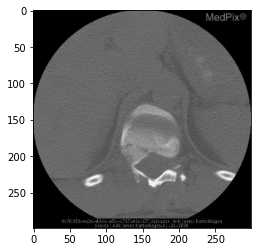

 23%|██▎       | 348/1498 [1:14:33<4:04:31, 12.76s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Axial  Anatomy: Spine
Findings: Chance Fracture through T11   Impression: Chance
Fracture


AI GENERATED ------------
Modality: ct noncontrast plane axial  Anatomy: spine
Findings: chance fracture through t11   Impression: chance
fracture


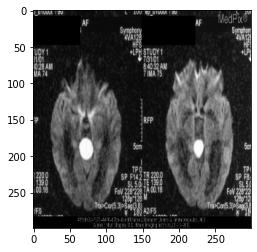

 23%|██▎       | 349/1498 [1:14:46<4:03:24, 12.71s/it]

ORIGINAL ----------------
Modality: MR - DWI Diffusion Weighted Plane: Axial  Anatomy:
Brain and Neuro   Findings: Slightly hetergeneous mass in
the supracerebellar cistern (posterior fossa) extending
through tentorial opening into the quadrigeminal cistern.
Impression: Epidermoid Inclusion Cyst


AI GENERATED ------------
Modality: mr adc map app diff coeff plane axial  Anatomy:
brain and neuro   Findings: • adc fracture of right sided
extraaxial hemorrhages  • subarachnoid hemorrhage
Impression: subarachnoid hemorrhage aneurysm basilar artery
aneurysm


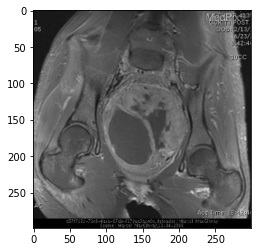

 23%|██▎       | 350/1498 [1:14:58<4:02:24, 12.67s/it]

ORIGINAL ----------------
Modality: MR - T1W w/Gd (fat suppressed) Plane: Coronal
Anatomy: Genitourinary   Findings: Large complex enhancing
mass which is locally invasive into lumbosacral spine.
Impression: Rhabdomyosarcoma


AI GENERATED ------------
Modality: mr t2 weighted plane coronal  Anatomy:
genitourinary   Findings: ultrasound images demonstrate
multiple left peritesticular small round rectum structures
anterior and partial fusion tubular shaped collection that
follows signal on grayscale sequence images and through the
cyst like normal fat   Impression: dermoid cyst cystic
teratoma


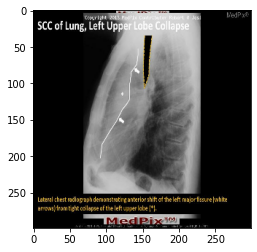

 23%|██▎       | 351/1498 [1:15:11<4:01:42, 12.64s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: Lateral  Anatomy: Chest,
Pulmonary (ex. Heart)   Findings: Initial chest radiographs
were obtained (figure 1).  The chest radiographs revealed
tight left upper lobe collapse - resulting in an abnormal
left hilar contour, indistinct left heart border,
generalized oligemia in the left chest, and dramatic
anterior shift of the left major fissue.   Impression: Left
upper lobe collapse,  squamous cell carcinoma


AI GENERATED ------------
Modality: xr plain film plane lateral  Anatomy: spine
Findings: ankylosis of the spine anterior fusion of the
vertebral bodies of the anterior soft tissues at all levels
there is ankylosis of the facet joints most and facets at
the spine that is contiguous with illdefined and central
muscles  •


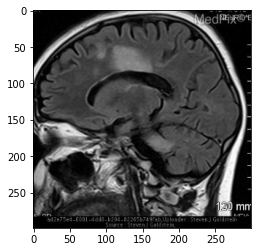

 23%|██▎       | 352/1498 [1:15:24<4:02:14, 12.68s/it]

ORIGINAL ----------------
Modality: MR - FLAIR Plane: Sagittal  Anatomy: Brain and
Neuro   Findings: •  Multiple lesions in the pons, midbrain,
cerebellar peduncles and cerebral hemisphere.  •  White
matter more involved than gray matter of cortex. •  No mass
effect or pathological enhancement.   Impression: Acute
Disseminated Encephalomyelitis (ADEM)


AI GENERATED ------------
Modality: mr t1w noncontrast plane sagittal  Anatomy: brain
and neuro   Findings: • complex enhancing lesion right basal
ganglia and temporal lobe  • lesion contains both cystic and
solid components  • marked perilesional edema present  • no
restricted diffusion on dwi images   Impression:
glioblastoma


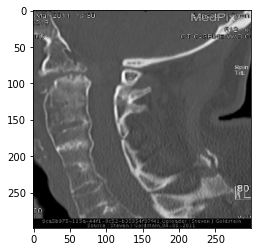

 24%|██▎       | 353/1498 [1:15:36<4:01:26, 12.65s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Sagittal  Anatomy: Spine
Findings: CT and MRI show classic findings of Ankylosing
spondylitis with "squaring"of vertebral bodies, fusion of
the facets and spinous processes and calcifications of the
anterior and posterior longitudinal ligaments.   There is an
unfused fracture through the base of the odontoid which is
fused to the arch of C1 and the clivus. There is cord injury
at this level due to hyperophic boney changes and cord
compression  There are also classic changes of
achondroplasia.   Impression: Ankylosing Spondylitis in an
Anchondroplasitic dwarf.


AI GENERATED ------------
Modality: ct noncontrast plane sagittal  Anatomy: spine
Findings: • prevertebral soft tissue hematoma  • fracture
through the left c4 lateral mass and laminar arch with
unilateral perched c45 facets on the right  • herniated and
disrupted disk c45 facets with some disrupted disk c45
facets on the c56 level


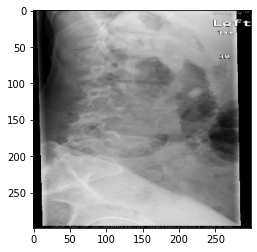

 24%|██▎       | 354/1498 [1:15:49<4:01:12, 12.65s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: nan  Anatomy: Spine
Findings: Previous imaging used for comparison: AP and
lateral radiographs of the lumbar spine from the previous
year show levoscoliosis without compression fracture. AP and
lateral radiographs of the lumbar spine from 3 years prior
show levoscoliosis without compression fracture.  First
Injury - February imaging:  Radiograph of the lumbar spine:
1.      Age indeterminate but new minimal compression
deformity of the L2 vertebral body as well 2.      Age
indeterminate but new compression deformity of the L3
vertebral body with approximately 15% loss of height
anteriorly.  3.      Compression deformity of the L5
vertebral body 4.      Diffuse osteopenia is noted  CT of
the lumbar spine: 1.      Age indeterminate mild superior
endplate depressions at L2 and L3 vertebral bodies, similar
to those seen on the lumbar spine radiographs. 2.
Superior and inferior endplate depression at L5 3.
Other findings include: • 

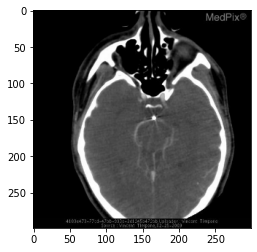

 24%|██▎       | 355/1498 [1:16:02<4:00:37, 12.63s/it]

ORIGINAL ----------------
Modality: CT w/contrast (IV) Plane: Axial  Anatomy: Brain
and Neuro   Findings: Contrast enhanced CT angiogram of the
head was performed which demonstrated a radiopaque foreign
body in the expected location of the basilar artery with
satisfactory collateral filling of the posterior cerebral
arteries (Fig. 1).   A subsequent non-contrast CT of the
head was performed following onset of further neurological
symptoms, which revealed interval displacement of the
radiopaque foreign body to the left posterior cerebral
artery (PCA) with loss of gray white matter differentiation
consistent with left PCA territorial infarction from
embolized IED fragment (Fig. 2).   Impression: IED Fragment
Embolism to Left Posterior Cerebral Artery


AI GENERATED ------------
Modality: ct noncontrast plane axial  Anatomy: brain and
neuro   Findings: • ct hyperdense mass in the suprasellar
cistern  • angio giant right internal carotid terminus
aneurysm   Impression: giant aneurysm


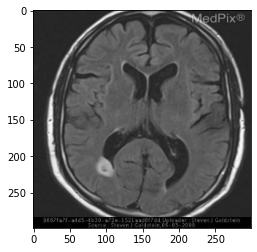

 24%|██▍       | 356/1498 [1:16:14<3:59:55, 12.61s/it]

ORIGINAL ----------------
Modality: MR - FLAIR Plane: Axial  Anatomy: Brain and Neuro
Findings: •  Mass adjacent to occipital horn of right
lateral ventricle. •  No enhancement after contrast •  No
associated hemorrhage or mass effect   Impression:
Astrocytoma, low grade


AI GENERATED ------------
Modality: mr t1w wgadolinium plane axial  Anatomy: brain and
neuro   Findings: • ring enhancing lesion right frontal lobe
• surrounding vasogenic edema  • lesion has low signal
intensity rim on t2 sequences  • elevated signal intensity
within lesion on dwi images  • decreased signal on adc map
Impression: brain


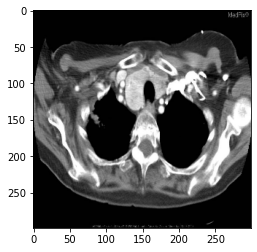

 24%|██▍       | 357/1498 [1:16:27<4:00:50, 12.66s/it]

ORIGINAL ----------------
Modality: CT w/contrast (IV) Plane: Axial  Anatomy: Head and
Neck (ex. orbit)   Findings: Substernal extension of multi-
nodular goiter into the anterior mediastinal space.
Impression: thyroid goiter


AI GENERATED ------------
Modality: ct wcontrast iv plane axial  Anatomy:
cardiovascular inc heart   Findings: aberrant right
subclavian artery   Impression: aberrant right subclavian
artery


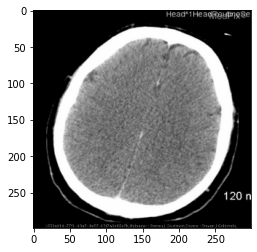

 24%|██▍       | 358/1498 [1:16:40<4:00:20, 12.65s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Axial  Anatomy: Brain and
Neuro   Findings: •  CT:  loss of normal gray-matter -
white-matter junction differentiation     Small ventricular
size for age. = suggesting brain swelling  •  MRI:  Brain
edema with small ventricles and tight posterior fossa.
Abnormal increase in signal contrast between white and gray
matter on DWI and ADC map.  •  There is cerebral swelling
with central midline herniation.   Impression: Hypoxic-
ischemic encephalopathy


AI GENERATED ------------
Modality: ct noncontrast plane axial  Anatomy: brain and
neuro   Findings: • bilateral extraaxial hemorrhages  •
subarachnoid hemorrhage  • hemorrhage right temporal lobe
Impression: head trauma tbi falls


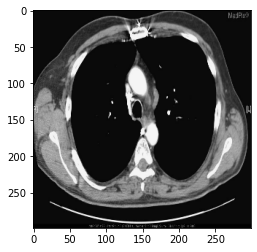

 24%|██▍       | 359/1498 [1:16:52<3:59:46, 12.63s/it]

ORIGINAL ----------------
Modality: CT w/contrast (IV) Plane: Axial  Anatomy: Chest,
Pulmonary (ex. Heart)   Findings: PA and lateral chest
radiograph demonstrate a LUL nodule. Axial CT images
demonstrate a spiculated LUL mass and a prominent lymph node
in the aorticopulmonary window.   Impression: Non-small Cell
Lung Cancer


AI GENERATED ------------
Modality: ct wcontrast iv plane axial  Anatomy:
cardiovascular inc heart   Findings: ovoid calcifications
within the mitral annulus   Impression: calcified mitral
annulus


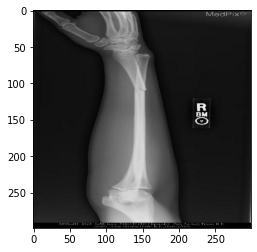

 24%|██▍       | 360/1498 [1:17:05<3:59:28, 12.63s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: AP  Anatomy: MSK -
Musculoskeletal   Findings: Fracture of the distal radial
shaft with an associated dislocation of the distal
radioulnar joint.   Impression: Galeazzi Fracture


AI GENERATED ------------
Modality: xr plain film plane ap  Anatomy: msk
musculoskeletal   Findings: plain radiographs demonstrate
thickening of the achilles tendon convex   Impression: of
achilles tendon on the posterior margin of kagers fat pad
and a lower limits normal toygars angle mr   Findings:
demonstrates focal thickening of the achilles tendon
increased t2w


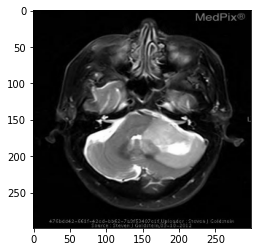

 24%|██▍       | 361/1498 [1:17:17<3:59:19, 12.63s/it]

ORIGINAL ----------------
Modality: MR - T2 weighted Plane: Axial  Anatomy:
Generalized   Findings: •  Enhancing mass in the left
cerebellar hemisphere. •  Mass is bright on DWI (restricted
diffusion)   Impression: Diffuse Large B-cell Lymphoma


AI GENERATED ------------
Modality: mr t2 weighted plane axial  Anatomy: brain and
neuro   Findings: • multifocal enhancing masses in midbrain
pons and medulla  • homogeneous enhancement following
contrast  • no hydrocephalus   Impression: anaplastic
astrocytoma


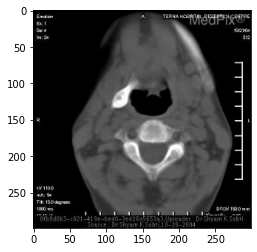

 24%|██▍       | 362/1498 [1:17:30<3:59:54, 12.67s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Axial  Anatomy: Head and
Neck (ex. orbit)   Findings: Elongated styloid process on
the left side. Calcification or ossification of the right
stylohyoid ligament is seen. Pseudoarticulation between the
ossified stylohyoid ligament and hyoid bone on the right
side.   Impression: OSSIFICATION OF STYLOHYOID LIGAMENT


AI GENERATED ------------
Modality: mr t1w noncontrast plane coronal  Anatomy: head
and neck ex orbit   Findings: typical changes of fibrous
dysplasia with widening of bone and increased attenuation
involving the right frontal ethmoid sphenoid temporal and
occipital bones including clivus   Impression: fibro osseous
lesions of the face and sinuses fibrous dysplasia


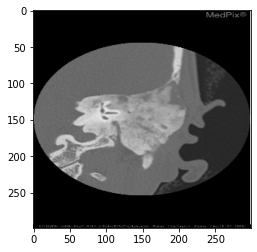

 24%|██▍       | 363/1498 [1:17:43<3:58:38, 12.62s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Coronal  Anatomy: Brain
and Neuro   Findings: There is osseous widening and ground
glass appearance of the petrous, squamous and mastoid
segments of the temporal bone.   Impression: Fibrous
dysplasia


AI GENERATED ------------
Modality: ct noncontrast plane axial  Anatomy: msk
musculoskeletal   Findings: plain films and ct show an air
lucencies in the neck ct images demonstrate air dissecting
through the left chest ct images of the chest and
inflammatory change at the absence of the left axillary
region of the proximal right


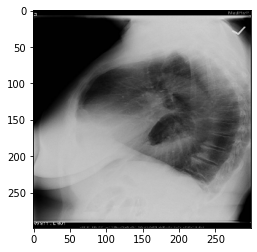

 24%|██▍       | 364/1498 [1:17:55<3:57:58, 12.59s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: Lateral  Anatomy:
Gastrointestinal   Findings: Large paraesophageal hiatal
hernia   Impression: Paraesophageal Hernia


AI GENERATED ------------
Modality: xr plain film plane lateral  Anatomy:
cardiovascular inc heart   Findings: cxr and chest ct
demonstrates enlarged main and left pulmonary arteries with
a normal size to the right pulmonary artery the pulmonic
valve is visible with three leafs the right heart volume is
mildly enlarged a right breast


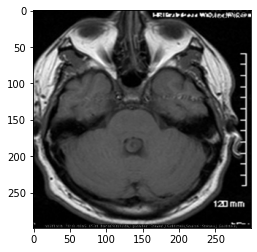

 24%|██▍       | 365/1498 [1:18:08<3:58:59, 12.66s/it]

ORIGINAL ----------------
Modality: MR - T1W - noncontrast Plane: Axial  Anatomy:
Brain and Neuro   Findings: Mixed signal intensity,
enhancing mass in the Fourth Ventricle.  No invasion of the
cerebellum or spinal metastatic disease.   Impression:
Subependymoma (WHO Gr 1) fourth ventricle


AI GENERATED ------------
Modality: mr t1w noncontrast plane axial  Anatomy: brain and
neuro   Findings: • 4 cm mass in right cerebellar hemisphere
• isointense to slighly hyperintense on t1  • low signal on
t2 images  • heterogeneous enhancement following contrast
Impression: cerebellar metastatic disease from colon cancer


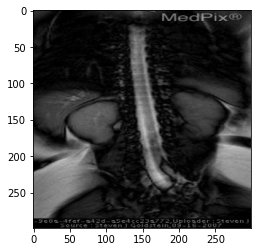

 24%|██▍       | 366/1498 [1:18:21<4:02:17, 12.84s/it]

ORIGINAL ----------------
Modality: MR - T2 weighted Plane: Coronal  Anatomy: Spine
Findings: •  Spinal cord tethered to S1 level by fatty mass.
•  Open neural placode in close proximity to lipoma. •
Widened lower lumbar and sacral canal with spinal
dysraphism. •  Spinal hydrosyrinx (syringohydromyelia)
Impression: Lipomyelomeningocele with spinal cord syrinx


AI GENERATED ------------
Modality: mr t2 weighted plane coronal  Anatomy:
genitourinary   Findings: initial plain films demonstrate
soft tissue mass adjacent to the bladder vascular further mr
images through the bladder with contrast material and
somewhat less than 25 cm in a lobulated 4 cm rounded lesion
at the ureteropelvic junction this level


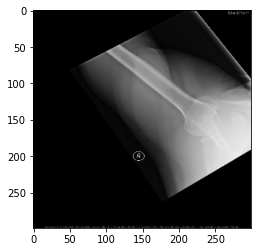

 24%|██▍       | 367/1498 [1:18:34<4:01:46, 12.83s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: AP  Anatomy: Generalized
Findings: Cervical MRI:  1.      PROMINENT STRAIGHTENING OF
CERVICAL SPINE WHICH MIGHT BE SECONDARY TO MUSCLE SPASM.
2.      AT C3-4 : MILD POSTERIOR DISC BULGE AND FOCAL
CENTRAL ASYMMETRIC DISC BULGING/PROTRUSION WITH EFFACEMENT
OF ANTERIOR SUBARACHNOID SPACE FLATTENING THE VENTRAL ASPECT
OF THE THECAL SAC.  MILD BILATERAL FACET JOINT ARTHROPATHY
AND UNCOVERTEBRAL JOINT HYPERTROPHY WITH NO SIGNIFICANT
NEURAL FORAMINAL NARROWING.     3.      AT C4-5 : MILD
POSTERIOR DISC BULGE SLIGHTLY ASYMMETRIC TO THE RIGHT WITH
NO EVIDENCE OF CENTRAL CANAL STENOSIS.  MILD BILATERAL FACET
JOINT ARTHROPATHY.  NO EVIDENCE OF NEURAL FORAMINAL
STENOSIS.    4.      AT C5-6 : POSTERIOR DISC BULGE AND
RIGHT POSTEROLATERAL ASYMMETRIC DISC BULGING/PROTRUSION AND
POSTERIOR SPURRING.  BILATERAL FACET JOINT ARTHROPATHY AND
UNCOVERTEBRAL JOINT HYPERTROPHY RESULTING IN MILD NEURAL
FORAMINAL NARROWING ON THE RIGHT.    5.      AT C6-

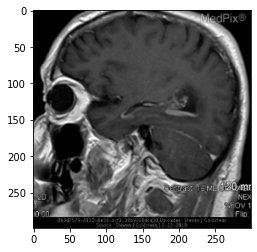

 25%|██▍       | 368/1498 [1:18:47<4:00:45, 12.78s/it]

ORIGINAL ----------------
Modality: MR - T1W w/Gadolinium Plane: Sagittal  Anatomy:
Generalized   Findings: Diffuse subependymal masses which
enhance following contrast administration.  Periventricular
edema noted in the right cerebellar hemisphere and
surrounding the lateral and third ventricles.   Impression:
Diffuse Large B-cell Lymphoma


AI GENERATED ------------
Modality: mr t1w wgadolinium plane sagittal  Anatomy: brain
and neuro   Findings: • multiple bilateral cerebral infarcts
of varying ages and sizes  • acute infarcts in the right
frontal lobe  • absent flow in the distal ica mca and aca
vessels   Impression: moyamoya


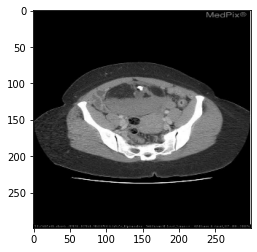

 25%|██▍       | 369/1498 [1:19:00<4:00:16, 12.77s/it]

ORIGINAL ----------------
Modality: CT - GI & IV Contrast Plane: Axial  Anatomy:
Genitourinary   Findings: Acute abdominal radiographic exam
shows a calcific density overlying the lower pelvis.  Pelvic
ultrasound shows a large hyperechoic left adnexal mass; The
left ovary is not seen as a separate structure.  CT further
demonstrates a large anterior mid-line pelvic mass with
mixed attenuation to include soft tissue, fat, and the
calcific opacity.   Impression: Ovarian Cystic Teratoma
("dermoid" or "dermoid cyst")


AI GENERATED ------------
Modality: ct gi iv contrast plane axial  Anatomy:
gastrointestinal   Findings: dilated tubular structure in
rlq coming off the cecum with central calcification likely
appendicolith and periappendiceal stranding   Impression:
acute appendicitis


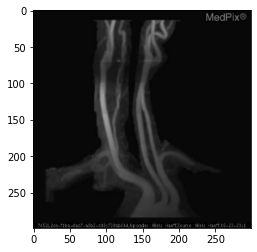

 25%|██▍       | 370/1498 [1:19:12<3:57:41, 12.64s/it]

ORIGINAL ----------------
Modality: MRA - MR Angiography/Venography Plane: Coronal
Anatomy: Head and Neck (ex. orbit)   Findings: On the right,
there is a long segment vertebral artery dissection spanning
approximately from C1-C6.  Brain imaging was did not show
any restricted diffusion to suggest secondary ischemia.
Impression: Vertebral Artery Dissection


AI GENERATED ------------
Modality: mra mr angiographyvenography plane nos not
specified  Anatomy: brain and neuro   Findings: 3 week old
pontine infarct on mri vertebral artery dissection with
extension into basilar artery on cta mra and vertebral
angiogram   Impression: vertebral basilar artery dissection
with pontine infarct


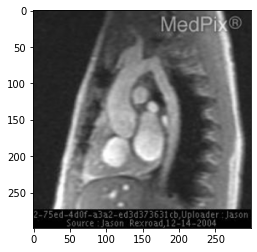

 25%|██▍       | 371/1498 [1:19:25<3:58:33, 12.70s/it]

ORIGINAL ----------------
Modality: MR - Montage Plane: Multiple or Montage  Anatomy:
Cardiovascular (inc. Heart)   Findings: Repaired Coarctation
of the Aorta.  Four contiguous double inversion recovery
fast spin echo magnetic resonance (MR) images in LAO (”candy
cane”) projection show an area of narrowing at the level of
the proximal descending thoracic aorta, the site of the
patient’s surgical repair.  At the point of maximal
narrowing, the aorta measures 13mm.   Bright blood (SSFP) MR
images in LAO and a tangential oblique coronal plane through
the region of the coarctation repair shows no evidence of a
flow jet, which if present suggests a hemodynamically
significant coarctation.  Bright blood (fast GRE) MR image
in LAO projection shows no evidence of a flow jet.
Impression: Aortic coarctation repair; postsurgical imaging


AI GENERATED ------------
Modality: mr t2 weighted plane sagittal  Anatomy: msk
musculoskeletal   Findings: plain films of the right knee
demonstrate cortical 

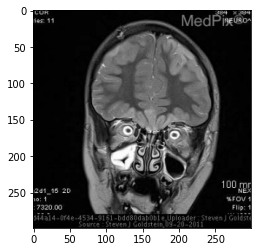

 25%|██▍       | 372/1498 [1:19:37<3:56:53, 12.62s/it]

ORIGINAL ----------------
Modality: MR - T2 weighted Plane: Coronal  Anatomy: Brain
and Neuro   Findings: Shearing injury with intraventricular
blood and hematoma involving the corpus callosum. Traumatic
and icshemic changes and swelling of cortical gray matter
involving both sides of the brain.  Microhemorrhages
(T2*dark) predominately in the cerebellum.   Impression:
Severe diffuse axonal injury (shearing injury) of the lobar
white matter, corpus callosum, and cerebellum with cortical
edema


AI GENERATED ------------
Modality: mr flair plane coronal  Anatomy: brain and neuro
Findings: • solid left orbit » abnormal signal in the medial
aspect of the left globe  • is heterogeneous in the region
of enhancement of the iac   Impression: vestibular
schwannoma


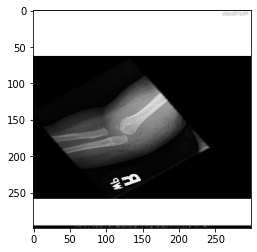

 25%|██▍       | 373/1498 [1:19:50<3:55:22, 12.55s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: Lateral  Anatomy: MSK -
Musculoskeletal   Findings: Soft Tissue swelling of the
upper arm and "bucket handle" fracture of the distal humerus
consistent with characteristic metaphyseal lesion.
Impression: Classic Metaphyseal Lesion- Accidental Trauma


AI GENERATED ------------
Modality: xr plain film plane ap  Anatomy: msk
musculoskeletal   Findings: plain films of the right
shoulder and arm centrally located large expansile and lytic
lesion of the proximal humeral metaphysis and diaphysis
there is an intertrochanteric fracture   Impression: simple
bone cyst pathologic fracture


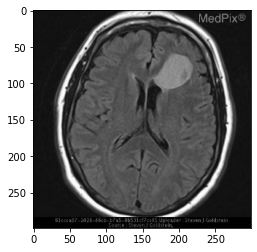

 25%|██▍       | 374/1498 [1:20:02<3:54:31, 12.52s/it]

ORIGINAL ----------------
Modality: MR - FLAIR Plane: Axial  Anatomy: Brain and Neuro
Findings: •  CT: Heterogeneous complex mass adjacent to left
frontal horn, with calcifications and "fluid" •  MR:
Partially "cystic" lesion with an enhancing mural nodule
Impression: Neurocytoma (Extraventricular) with Ganglion
Cell Development


AI GENERATED ------------
Modality: mr flair plane axial  Anatomy: brain and neuro
Findings: • quadrigeminal plate csf signal cyst  •
compresses vermis  • elevates basal vein sof rosenthal  •
multiple white matter lesions consistent with ms
Impression: arachnoid cyst


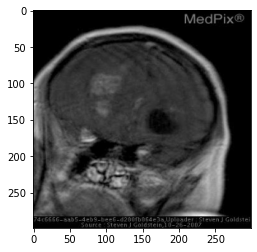

 25%|██▌       | 375/1498 [1:20:15<3:55:40, 12.59s/it]

ORIGINAL ----------------
Modality: MR - T1W w/Gadolinium Plane: Coronal  Anatomy:
Brain and Neuro   Findings: CT- multiple calcified masses in
both cerebral hemispheres.  Atrophy and bilateral
leukomalacia  MRI- Large hemorrhagic cyst left frontal lobe
(fluid/fluid level). Very dystropic looking brain due to
TORCH  infection probably toxoplasmosis. Multiple foci of
contrast enchancement following contrast   Impression: TORCH
infection by Hx Enlarging hemorrhagic cyst mass,
inflammatory


AI GENERATED ------------
Modality: mr t1w noncontrast plane sagittal  Anatomy: brain
and neuro   Findings: radiological   Findings: large sellar
mass with suprasellar extension isointense on t1
hyperintense t2 enhances intensely and heterogeneously
intrasellar suprasellar extension fig 45 cm mass extending
peripheral suprasellar cistern and homogeneously enhancing
mass extending peripheral gadolinium with peripheral
enhancement


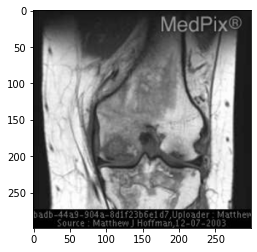

 25%|██▌       | 376/1498 [1:20:28<3:57:22, 12.69s/it]

ORIGINAL ----------------
Modality: MR - T1W - noncontrast Plane: Coronal  Anatomy:
MSK - Musculoskeletal   Findings: Findings:         Knee:
There is a large joint effusion.  Within the distal femur
and proximal tibia there are serpiginous, geographic areas
of heterogeneous but primarily decreased signal intensity on
T1 weighted images and increased signal intensity on T2
weighted images, consistent with osteonecrosis. Small
subchondral areas of osteonecrosis involve both the medial
and lateral femoral condyles.  A large area of osteonecrosis
is seen on the posterior-lateral femoral condyle which has
fluid extending deep to an osteochondral flap or unstable
fragment measuring 3 cm in length on the sagittal plane.
There is diffuse edema or reactive marrow changes in the
medial femoral condyle.  There is diffuse soft tissue edema
in the medial and posterior soft tissues of the knee.
Wrist: The lunate shows diffuse decreased signal intensity
on the Gradient Echo and T1 weighted image seq

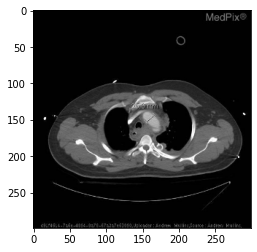

 25%|██▌       | 377/1498 [1:20:40<3:57:48, 12.73s/it]

ORIGINAL ----------------
Modality: CT w/contrast (IV) Plane: Axial  Anatomy:
Cardiovascular (inc. Heart)   Findings: Axial CT with IV
contrast demontrates enlargment of the proximal descending
aorta distal to the left subclavian artery with intimal flap
involving the entire diameter of the proximal descending
aorta.  A large amount of mediastinal hematoma is present.
Aortogram demonstrates a large pseudoaneurysm distal to the
left subclavian artery.  Aortic stent graft placement was
performed with exclusion of the pseudoaneurysm.
Impression: Traumatic Aortic Injury


AI GENERATED ------------
Modality: ct wcontrast iv plane axial  Anatomy: vascular
Findings: ct with intravenous and oral contrast material
demonstrates a large retroperitoneal mass with central
dystrophic calcifications this mass is completely separate
from the right kidney which other than the hydronephrosis
and the presence of the ureteral stent is otherwise
unremarkable


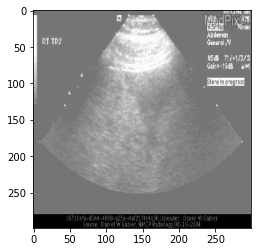

 25%|██▌       | 378/1498 [1:20:53<3:56:43, 12.68s/it]

ORIGINAL ----------------
Modality: US - Ultrasound Plane: Transverse  Anatomy:
Abdomen - Generalized   Findings: CT, ABDOMEN, WITH CONTRAST
MATERIAL:    Note is made of a vague area of hyperdensity
seen in the right lobe of the liver inferolaterally
measuring 1.7 x 1.6 cm.  Delayed images demonstrate this
area to be less conspicuous.  There is no liver laceration
identified and there is no free fluid or inflammation  seen
in the abdomen or pelvis.  Remainder of the liver
demonstrates mild fatty infiltration, without evidence of
focal lesion.  The liver is normal in size and normal in
contour.   Ultrasound of the liver is recommended for
further evaluation.  US, ABDOMINAL LIMITED:  There is
diffuse fatty infiltration of the liver, moderate in degree,
obscuring portal vein walls.  The liver demonstrates a
wedge-shaped area along the lateral aspect ofthe right
inferior segment that extends from its apex at a hepatic
vein branch to the capsule.  This demonstrates normal
vessels traversing

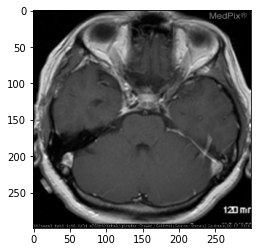

 25%|██▌       | 379/1498 [1:21:06<3:56:45, 12.69s/it]

ORIGINAL ----------------
Modality: MR - T1W w/Gadolinium Plane: Axial  Anatomy: Brain
and Neuro   Findings: MRI reveals subtle elevated signal
within the right temporal bone extending into the greater
wing of the sphenoid bone.    There is enhancement in this
region following gadolinium administration.  There is no
dural or brain mass.   Impression: Meningioma, Intraosseous


AI GENERATED ------------
Modality: mr t1w wgd fat suppressed plane axial  Anatomy:
brain and neuro   Findings: • mri enlarged left cavernous
sinus and superior opthamic vein proptosis and enlargement
of all the extra occular muscles  • angiogram direct
cavernous carotid fistula   Impression: traumatic
carotidcavernous fistula


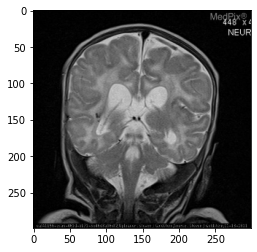

 25%|██▌       | 380/1498 [1:21:18<3:56:03, 12.67s/it]

ORIGINAL ----------------
Modality: MR - T2 weighted Plane: Coronal  Anatomy: Brain
and Neuro   Findings: •  Cerebral Atrophy with large
ventricles and sulci. •  Multiple brain calcifications on CT
scan. •  Atophic white matter •  Abnormal WM signal
intensity, best seen on FLAIR and T2 imaging   Impression:
Prenatal (intrauterine) Cytomegalovirus (CMV) Infection


AI GENERATED ------------
Modality: mr t2 weighted plane coronal  Anatomy: brain and
neuro   Findings: • absent septum pellucidum  • abnormal
configuration of frontal horns of lateral ventricle  • small
pituitary gland   Impression: septooptic dysplasia demorsier
syndrome


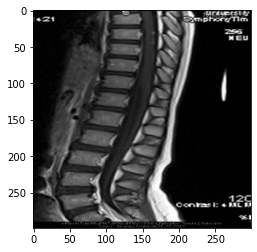

 25%|██▌       | 381/1498 [1:21:31<3:56:48, 12.72s/it]

ORIGINAL ----------------
Modality: MR - T1W w/Gadolinium Plane: Sagittal  Anatomy:
Brain and Neuro   Findings: •  Intraventricular mass with
enhancement expanding the fourth ventricle. •  Subtle
leptomeningeal enhancement lying behind the spinal cord at
T8 and T9 levels.   Impression: Medulloblastoma (PNET)


AI GENERATED ------------
Modality: mr t1w noncontrast plane sagittal  Anatomy: brain
and neuro   Findings: complex enhancing solid and fluid mass
in left cerebellar hemisphere that displaces the 4th
ventricle and causes obstructive hydrocephalus there are
small nodular masses in the vallecula and adhering to the
cervical and thoracic spinal cord   Impression: von


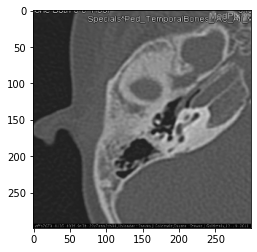

 26%|██▌       | 382/1498 [1:21:44<3:56:18, 12.70s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Axial  Anatomy: Head and
Neck (ex. orbit)   Findings: •  Deformed pinna •  Bony
atretic plate A•  nterior displacement descending portion
facial nerve canal •  Normal middle ear and inner ear
Impression: Microtia and Atresia of the External Auditory
Canal


AI GENERATED ------------
Modality: ct noncontrast plane axial  Anatomy: msk
musculoskeletal   Findings: • multiple lesions  • well
corticated bony masses arising from the posterior elements
of the cervical thoracic and lumbar spine  • the lesions at
both c7 and l4 extend into the spinal canal   Impression:
multiple osteochondroma


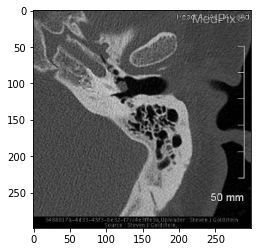

 26%|██▌       | 383/1498 [1:21:56<3:55:14, 12.66s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Axial  Anatomy: Brain and
Neuro   Findings: 4 mm mass arising from the promontory of
cochlea. No associated bone erosion.   Impression: Glomus
tympanicum and glomus jugulare tumors (paraganglioma)


AI GENERATED ------------
Modality: ct noncontrast plane axial  Anatomy: head and neck
ex orbit   Findings: high riding and dehiscent jugular bulb
on the right   Impression: dehiscent julgular bulb


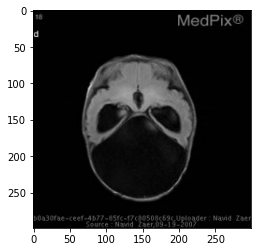

 26%|██▌       | 384/1498 [1:22:09<3:54:01, 12.60s/it]

ORIGINAL ----------------
Modality: MR - FLAIR Plane: Axial  Anatomy: Brain and Neuro
Findings: MR imaging of the brain w/o contrast reveals
agenesis of the corpus callosum with a very large inter-
hemispheric cyst and severe hydrocephalus.  There is a large
posterior fossa cyst with rudimentary cerebellar
hemispheres. The cerebellar vermis appears to be absent.
There is marked elevation of the tentorium and torcula. The
lateral ventricles are dilated.  There is no acute
hemorrhage.  The findings appear to be consistent with the
diagnosis of severe Dandy-Walker malformation.   Impression:
Dandy-Walker Malformation


AI GENERATED ------------
Modality: mr flair plane axial  Anatomy: brain and neuro
Findings: axial flair t1 and t2 mr images through the brain
demonstrate mixed high and low t1 signal abnormalities in
the dentate nuclei of the cerebellum caudate nuclei pallidum
and thalami these lesions are fairly symmetric and
correspond to areas


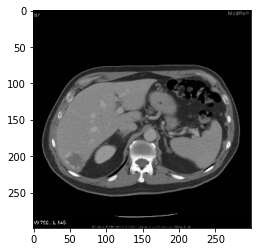

 26%|██▌       | 385/1498 [1:22:22<3:55:32, 12.70s/it]

ORIGINAL ----------------
Modality: CT w/contrast (IV) Plane: Axial  Anatomy: Abdomen
- Generalized   Findings: Discontinuous peripheral pooling
of contrast enhancement in the arterial phase with
progressive filling seen in the portal venous phase and
prolonged enhancement of the lesion in delayed images on a
three phase enhanced liver CT.   Impression: Liver
Hemangioma


AI GENERATED ------------
Modality: ct wcontrast iv plane axial  Anatomy:
genitourinary   Findings: ultrasound was performed of the
kidneys the left kidney demonstrates a hypoechoic soft
tissue mass in the central renal sinus fat splaying the
pelvic vasculature noncontrast ct followed by iv contrast
demonstrates a similar soft tissue mass with enhancement
this


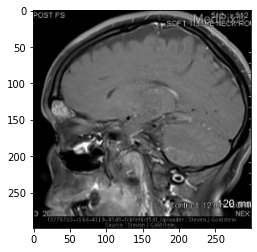

 26%|██▌       | 386/1498 [1:22:35<3:55:16, 12.69s/it]

ORIGINAL ----------------
Modality: MR - T1W w/Gadolinium Plane: Sagittal  Anatomy:
Head and Neck (ex. orbit)   Findings: •  Calcified enhancing
mass in the left frontal sinus. •  Mass is dense on CT. •
Mixed signal intensity on MRI. •  Portions of the mass do
enhance.   Impression: Osteoma left Frontal sinus


AI GENERATED ------------
Modality: mr t1w wgd fat suppressed plane sagittal  Anatomy:
brain and neuro   Findings: • mri enlarged left cavernous
sinus and superior opthamic vein proptosis and enlargement
of all the extra occular muscles  • angiogram direct
cavernous carotid fistula   Impression: traumatic
carotidcavernous fistula


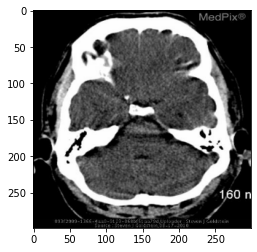

 26%|██▌       | 387/1498 [1:22:47<3:54:44, 12.68s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Axial  Anatomy: Brain and
Neuro   Findings: •  Diffuse brain edema with very small
ventricles and obliteration of sulci - due to cytotoxic
edema. •  Complete loss of gray-white matter border in the
basal ganglia and over the cerebral hemispheres.
Impression: Brain Death


AI GENERATED ------------
Modality: ct noncontrast plane axial  Anatomy: brain and
neuro   Findings: • bilateral anterior circulation infarcts
on ct and mri  • occlusion of the supracavernous intradural
internal carotid arteries on mra   Impression: moyamoya
anterior circulation infarcts bilateral aca


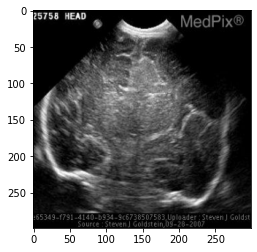

 26%|██▌       | 388/1498 [1:23:00<3:54:43, 12.69s/it]

ORIGINAL ----------------
Modality: US - Ultrasound Plane: Coronal  Anatomy: Brain and
Neuro   Findings: The left cerebral hemispheric cortex is
severely thickened with broad gyri and shallow sulci.
Heterotopias and gliosis are seen in the white matter. Both
the heterotopia and gliosis appear as areas of prolonged T1
and T2 relaxation times.   There is marked deformity of the
left lateral ventricle and left to right shift due to the
hamartomatous enlargement of the left cerebral hemisphere
Impression: Hemimegalencephaly


AI GENERATED ------------
Modality: us ultrasound plane longitudinal  Anatomy:
genitourinary   Findings: multiple grayscale trans abdominal
images of the pelvis demonstrate seperation of the
endometrium and myometrium from of the upper 23rds of the
uterus into seperate uterine horns joining at the lower
uterine segment there is a single cervix   Impression:
bicornuate uterus


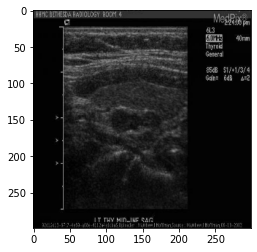

 26%|██▌       | 389/1498 [1:23:13<3:54:26, 12.68s/it]

ORIGINAL ----------------
Modality: US - Ultrasound Plane: Sagittal  Anatomy: Head and
Neck (ex. orbit)   Findings: Adjacent to the mid to lower
pole of the left thyroid lobe posteriorly is a 1.5 x 0.5 x
0.8 cm ovoid homogeneous solid hypoechoic mass.  It is well
circumscribed and there is no cystic components or
calcifications identified.  This is the only abnormality
found.   Impression: PARATHYROID ADENOMA


AI GENERATED ------------
Modality: us ultrasound plane sagittal  Anatomy: head and
neck ex orbit   Findings: abnormally enlarged left internal
jugular lymph node with heterogeneous echogenicity and
multiple echogenic foci consistent with calcifications
psamomma bodies   Impression: metastatic thyroid papillary
carcinoma to internal jugular nodes sp usguided percutaneous
biopsy


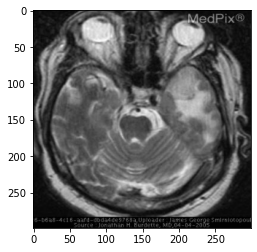

 26%|██▌       | 390/1498 [1:23:26<3:56:14, 12.79s/it]

ORIGINAL ----------------
Modality: MR - T2 weighted Plane: Axial  Anatomy: Brain and
Neuro   Findings: Dural based mass in anterior-medial
portion of middle cranial fossa on the right.  Roughly
hemispheric in shape with a broad dural base and enhancement
of the adjacent dura and cavernous sinus.  There very
extensive vasogenic edema.   Impression: Meningioma, WHO
Grade 1


AI GENERATED ------------
Modality: mr t2 weighted plane axial  Anatomy: brain and
neuro   Findings: • dramatic widening of the occipital bone
diploic space and abnormal signal  • expansion of the clivus
and abnormal signal  • thickening of the left petrous bone
and abnormal signal  • maxillary ethmoid and sphenoid sinus
mucoperiosteal thickening


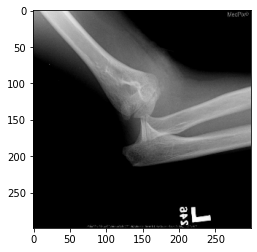

 26%|██▌       | 391/1498 [1:23:38<3:55:00, 12.74s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: Lateral  Anatomy: MSK -
Musculoskeletal   Findings: The initial AP and lateral
images of the left elbow demonstrate posterior dislocation
at the elbow joint.  The post-reduction image although
limited, demonstrates mild displacement of the medial
epicondylar epiphysis consistent with an avulsion fracture.
Impression: Posterior elbow dislocation with fracture of the
medial epicondyle.


AI GENERATED ------------
Modality: xr plain film plane lateral  Anatomy: msk
musculoskeletal   Findings: plain radiographs demonstrate
thickening of the achilles tendon convex   Impression: of
achilles tendon on the posterior margin of kagers fat pad
and a lower limits normal toygars angle mr   Findings:
demonstrates focal thickening of the achilles tendon
increased t2w


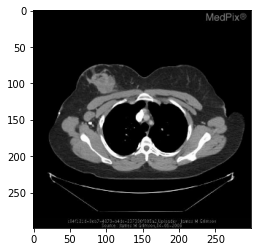

 26%|██▌       | 392/1498 [1:23:51<3:53:57, 12.69s/it]

ORIGINAL ----------------
Modality: CT w/contrast (IV) Plane: Axial  Anatomy: Breast
and Mammography   Findings: The mammogram (MLO view
provided, as the copy of the CC view was of poor quality)
demonstrates a large (3cm) round mass with well
circumscribed margins.  Multiple small pleomorphic
calcifications were seen within the mass.  The CT exam shows
the corresponding mass in the right breast, as well as a
large abnormal right axillary lymph node.  There were other
nodes noted in the supraclavicular area (not shown).  There
were no lung masses.   Impression: Primary small cell
neuroendocrine carcinoma of the breast


AI GENERATED ------------
Modality: ct wcontrast iv plane axial  Anatomy:
cardiovascular inc heart   Findings: axial ct images with
intravenous contrast material demonstrate mild smooth
thickening of the interatrial septum with diffuse fat
attenuation no pulmonary embolims was present note the large
amount of subcutaneous fat circumferentially compatible with
a large bod

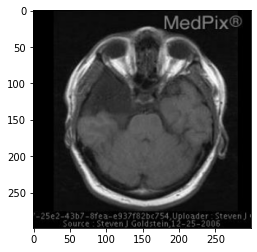

 26%|██▌       | 393/1498 [1:24:03<3:53:32, 12.68s/it]

ORIGINAL ----------------
Modality: MR - FLAIR Plane: Axial  Anatomy: Brain and Neuro
Findings: Large cystic mass in right middle and anterior
crainal fossa with CSF signal intensity on all sequences.
Associated with partial agensis of temporal and frontal lobe
Impression: Arachnoid Cyst


AI GENERATED ------------
Modality: mr t1w noncontrast plane axial  Anatomy: brain and
neuro   Findings: ct multiple calcified masses in both
cerebral hemispheres atrophy and bilateral leukomalacia mri
large hemorrhagic cyst left frontal lobe fluidfluid level
very dystropic looking brain due to torch infection probably
toxoplasmosis multiple foci of contrast enchancement
following contrast


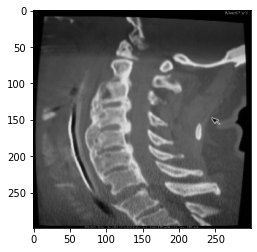

 26%|██▋       | 394/1498 [1:24:16<3:52:19, 12.63s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Sagittal  Anatomy: Spine
Findings: Diffuse Idiopathic Skeletal Hyperostosis with
unstable, three-column fracture at the C7/T1 level with
unilateral interfacet dislocation and fracture at that
level.   Impression: Diffuse Idiopathic Skeletal
Hyperostosis with unstable, three-column fracture at the
C7/T1 level with unilateral interfacet dislocation and
fracture at that level.


AI GENERATED ------------
Modality: ct noncontrast plane sagittal  Anatomy: spine
Findings: • pronounced prevertebral soft tissue swelling  •
edema and hemorrhage in medulla and upper cervical cord on
mri  • epidural hematoma in the cervical spine  •
atlantooccipital distraction with disruption right and left
craniocervical articulations   Impression: atlantooccipital
distraction injury


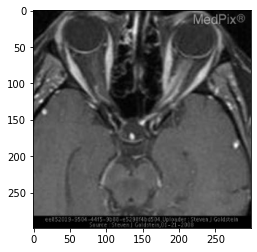

 26%|██▋       | 395/1498 [1:24:29<3:52:57, 12.67s/it]

ORIGINAL ----------------
Modality: MR - T1W w/Gd (fat suppressed) Plane: Axial
Anatomy: Eye and Orbit (exclude Ophthalmology)   Findings: •
Enlarged optic nerve/nerve sheath complex on left. •
Enhancement of optic nerve sheath best seen on fat
suppressed images--"Tram Track" sign •  Loss of CSF signal
in nerve sheath due compression by tumor •  Loss of target
sign on coronal T2 sequences through orbit due to
compression of nerve and increased T2 signal of nerve.
Impression: Optic nerve meningioma


AI GENERATED ------------
Modality: mr t1w wgd fat suppressed plane axial  Anatomy:
head and neck ex orbit   Findings: ct of the head and neck
axial ct images demonstrate a round mass adjacent to the
right parotid gland with a benign appearing defined
enhancing mass is an in appearance and a nondisplaced
epidural


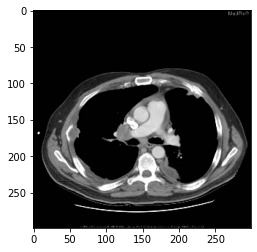

 26%|██▋       | 396/1498 [1:24:41<3:52:03, 12.64s/it]

ORIGINAL ----------------
Modality: CT w/contrast (IV) Plane: Axial  Anatomy: Chest,
Pulmonary (ex. Heart)   Findings: AP chest radiograph: right
upper lobe mass, right hilar mass, right pleural thickening
with several right masses along the junction of the pleura
and lung.   Impression: Adenocarcinoma (poorly
differentiated)


AI GENERATED ------------
Modality: ct wcontrast iv plane axial  Anatomy:
cardiovascular inc heart   Findings: cxr and chest ct
demonstrates enlarged main and left pulmonary arteries with
a normal size to the right pulmonary artery the pulmonic
valve is visible with three leafs the right heart volume is
mildly enlarged a right breast


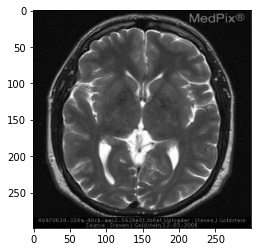

 27%|██▋       | 397/1498 [1:24:54<3:51:24, 12.61s/it]

ORIGINAL ----------------
Modality: MR - T2 weighted Plane: Axial  Anatomy: Brain and
Neuro   Findings: Bilateral and symmetric hyperintensity in
the pulvinar of thalamus on T1-weighted MR   Impression:
Fabry Disease


AI GENERATED ------------
Modality: mr t2 weighted plane axial  Anatomy: brain and
neuro   Findings: • thrombosis anterior half of superior
sagittal sinus  • bilateral frontal lobe venous infarcts  •
artifact from metallic dental braces   Impression: superior
sagittal sinus thrombosis with bilateral frontal lobe venous
lobe venous infarction


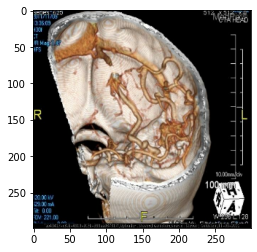

 27%|██▋       | 398/1498 [1:25:06<3:51:03, 12.60s/it]

ORIGINAL ----------------
Modality: CTA - CT Angiography Plane: NOS - Not specified
Anatomy: Brain and Neuro   Findings: •  Calcified lesion
left temporal lobe on CT scan •  CTA and MRI both
demonstrate a 2 cm AVM nidus in left temporal lobe •
Dilated feeding arteries (especially Left PCA) •  Enlarge
draining veins •  Angiogram confirms diagnosis of AVM
Impression: AVM, Arterio-venous Malformation, Vascular
malformation


AI GENERATED ------------
Modality: cta ct angiography plane 3d reconstruction
Anatomy: brain and neuro   Findings: • acute right frontal
lobe infarct  • focal stenosis right mca superior division
• occlusion left mca m1 segment   Impression: moyamoya


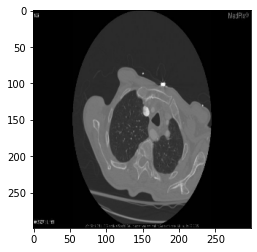

 27%|██▋       | 399/1498 [1:25:19<3:50:42, 12.60s/it]

ORIGINAL ----------------
Modality: CT w/contrast (IV) Plane: Axial  Anatomy:
Cardiovascular (inc. Heart)   Findings: The patient's PA/LAT
chest radiograph revealed widening of the superior
mediastinum.  On lateral view there is a soft tissue density
in the superior middle mediastinum with mass effect on the
posterior trachea.  CT, PE/DVT showed an incidental finding
of an aberrant right subclavian artery.  The artery is seen
passing posterior to the esophagus from left to right.  The
patients symptoms likely resulted from a left lung base
pneumonia also seen on the CT.   Impression: Left Aortic
Arch with Aberrant Right Subclavian Artery


AI GENERATED ------------
Modality: ct noncontrast plane axial  Anatomy: msk
musculoskeletal   Findings: ap and lateral radiographs of
the left knee demonstrate an eccentric metaphysealdistal
diaphysis lesion which is geographic with sclerotic borders
and lytic lesion is endosteal scalloping and narrow zone of
transition the lesion demonstrates which

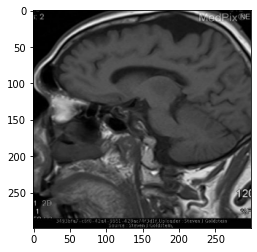

 27%|██▋       | 400/1498 [1:25:32<3:51:38, 12.66s/it]

ORIGINAL ----------------
Modality: MR - T1W - noncontrast Plane: Sagittal  Anatomy:
Brain and Neuro   Findings: •  Bilateral Thalamic infarcts •
Left Occipital lobe infarction  •  Brainstem infarct •
Bilateral Cerebellar infarcts   Impression: Basilar artery
thrombosis, cerebral infarction


AI GENERATED ------------
Modality: mr t1w noncontrast plane sagittal  Anatomy: brain
and neuro   Findings: • ring enhancing lesion right frontal
lobe  • surrounding vasogenic edema  • lesion has low signal
intensity rim on t2 sequences  • elevated signal intensity
within lesion on dwi images  • decreased signal on adc map
Impression: brain


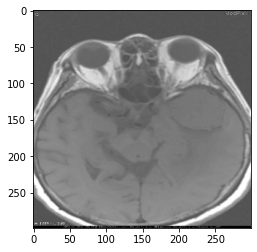

 27%|██▋       | 401/1498 [1:25:44<3:50:19, 12.60s/it]

ORIGINAL ----------------
Modality: MR - T1W - noncontrast Plane: Axial  Anatomy:
Brain and Neuro   Findings: Gadloinium enahaced MRI of the
bran demonstated a well circumscribed nodular extraaxial
mass lesion within the left temporal region that
demonstrated homogeneous enhancement. Additionally, no
evidence of diffusion abnormality was present. Finally,
small linear projections (i.e. "dural tails" were present at
the periphery of this lesion).   Impression: Meningioma


AI GENERATED ------------
Modality: mr t1w noncontrast plane axial  Anatomy: brain and
neuro   Findings: • ct hyperdense mass right basal ganglia
and temporal lobe  • mri shows high attenuation mass in left
inferior temporal lobe  • mri enhancing mass is associated
with contrast enhancement   Impression: glioblastoma
multiforme


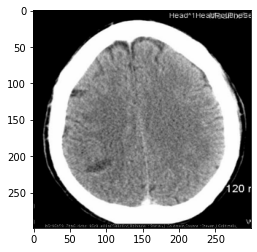

 27%|██▋       | 402/1498 [1:25:57<3:49:42, 12.58s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Axial  Anatomy: Brain and
Neuro   Findings: •  CT - low density lesion right parietal
lobe interpreted as small infarct. •  MRI - enhancing lesion
in same location with restricted diffusion and peripheral
enhancement consistent with abscess.   Impression: Brain,
cerebral abscess


AI GENERATED ------------
Modality: ct noncontrast plane axial  Anatomy: brain and
neuro   Findings: • acute right frontal lobe infarct  •
focal stenosis right mca superior division  • occlusion left
mca m1 segment   Impression: moyamoya


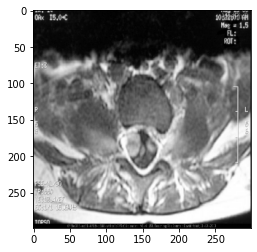

 27%|██▋       | 403/1498 [1:26:09<3:49:19, 12.57s/it]

ORIGINAL ----------------
Modality: MR - T1W - noncontrast Plane: Axial  Anatomy:
Spine   Findings: •  Paraspinal masses •  Soft-tissue masses
•  Masses are elongated or fusiform   Impression:
Neurofibromatosis-1


AI GENERATED ------------
Modality: mr t2 gradientgrempgrswanswi plane axial  Anatomy:
spine   Findings: • severe congenital spinal stenosis  •
large intraspinal mass centered at l45 disk space »
extradural vs intradural  • no enhancement of mass following
contrast administration   Impression: l4l5 herniated disc
with a sequestered fragment


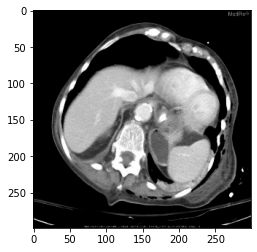

 27%|██▋       | 404/1498 [1:26:22<3:50:25, 12.64s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Axial  Anatomy:
Gastrointestinal   Findings: Fluid-filled abnormality
adjacent to or contiguous with the stomach.  There is a
small air-fluid level.   Impression: Gastric diverticulum


AI GENERATED ------------
Modality: ct wcontrast iv plane axial  Anatomy:
gastrointestinal   Findings: retrocardiac mass on plain film
in the paraesophageal region heterogenous soft tissue mass
arising from the esophagus on ct   Impression:
gastrointestinal stromal tumor


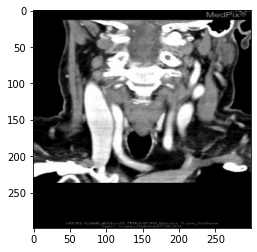

 27%|██▋       | 405/1498 [1:26:35<3:49:39, 12.61s/it]

ORIGINAL ----------------
Modality: CT w/contrast (IV) Plane: Coronal  Anatomy:
Cardiovascular (inc. Heart)   Findings: Aberrant origin of
the right subclavian artery from the distal aortic arch.  It
then passes behind the esophagus and in front of the spine
to assume its normal position in the neck.   Impression:
Aberrant Right Subclavian Artery


AI GENERATED ------------
Modality: ct wcontrast iv plane coronal  Anatomy:
genitourinary   Findings: endometrial fluid with fluid
pattern suggestive of an arcuate uterus or less likely
partial bicornuate uterus small amount of free fluid in the
pelvis prominent ovaries with numerous enlarged follicles
Impression: bicornuate uterus


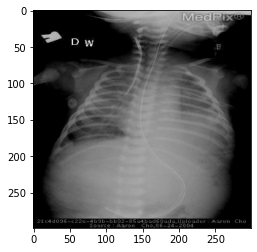

 27%|██▋       | 406/1498 [1:26:47<3:48:54, 12.58s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: Frontal  Anatomy: Chest,
Pulmonary (ex. Heart)   Findings: Mass in the left lower
hemithorax.   Impression: Delayed onset of congenital
diaphragmatic hernia


AI GENERATED ------------
Modality: xr plain film plane ap  Anatomy: gastrointestinal
Findings: supine ap abdominal radiograph reveals a round
mass in the right upper quadrant ct shows a mixed
attenuation center of a region of fat attenuation and right
middle fossa sagittal t1 and t2 it is hypoechoic solid
lesion with peripheral


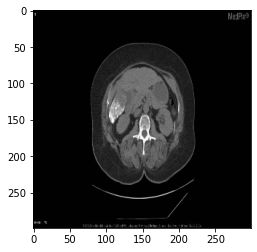

 27%|██▋       | 407/1498 [1:27:00<3:48:23, 12.56s/it]

ORIGINAL ----------------
Modality: CT - noncontrast Plane: Axial  Anatomy:
Gastrointestinal   Findings: CT ABDOMEN 05 APR 2004:  Liver
demonstrates a nodular contour consistent with chronic
cirrhosis.  There are areas of heterogeneous density,
throughout the right lobe of the liver, without definitive
circumscribed mass identified.  Hypertrophy of the caudate
lobe.  The left lobe appears clear by CT. Small spenule is
present. Atherosclerotic vascular calcification of the
abdominal aorta without aneurysmal dilatation. Degenerative
changes of the spine.    MR Abdomen 10 APR 2004:  The liver
is diffusely nodular consistent with cirrhosis.  Multiple
hyperenhancing lesions seen throughout the right lobe of the
liver which appear to conglomerate to a mass in the superior
portion of right lobe measuring approximately 13 X 10 cm.  A
separate conglomeration mass is seen in the inferior portion
of right lobe near the tip measuring approximately 7 X 7 cm.
Additionally there is a hyperenhancing m

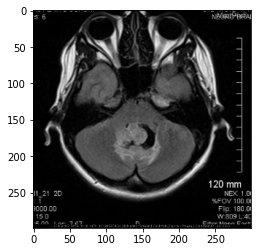

 27%|██▋       | 408/1498 [1:27:12<3:47:56, 12.55s/it]

ORIGINAL ----------------
Modality: MR - FLAIR Plane: Axial  Anatomy: Brain and Neuro
Findings: Complex enhancing mass within the 4th ventricle.
Mass contains cystic elements. The mass obstructs the 4th
ventricle outflow resulting in non-communicating
hydrocephalus.   Impression: Ependymal neoplasms, Ependymoma
WHO grade II


AI GENERATED ------------
Modality: mr flair plane axial  Anatomy: brain and neuro
Findings: • solid mass arising from vermis with
heterogeneous enhancement  • the pons and flair  • no
enhancement   Impression: juvenile pilocytic astrocytoma


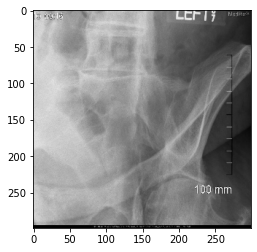

 27%|██▋       | 409/1498 [1:27:25<3:48:51, 12.61s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: AP  Anatomy: Spine
Findings: Lumbar spine: appears to be completely fused
through the anterior spinal ligament. Sacroiliac
articulations appear to be fused. Diffuse sclerosis and
fusion is seen throughout the facet joints. Findings
consistent with ankylosing spondylosis. Sacroiliac joints:
Bilateral fusion consistent with ankylosing spondylosis.
Thoracic spine: Fusion of the dorsal spine consistent with
ankylosing spondylosis. Squaring of the vertebral bodies.
Cervical spine: Generalized demineralization with complete
fusion of the cervical spine as described. Diffuse facet
joint degenerative joint disease and sclerosis is present.
Impression: Ankylosing Spondylitis


AI GENERATED ------------
Modality: xr plain film plane ap  Anatomy: spine   Findings:
• ct images at 5 mm collimation were obtained with oral and
intravenous contrast material at the l5s1 level of the
sacrum with oral and contrast 1 cm in a superior aspect of
the

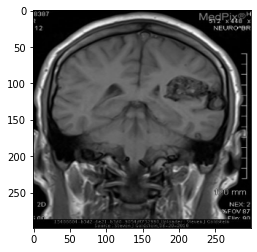

 27%|██▋       | 410/1498 [1:27:38<3:48:26, 12.60s/it]

ORIGINAL ----------------
Modality: MR - T1W - noncontrast Plane: Coronal  Anatomy:
Brain and Neuro   Findings: •  CT: Mixed density lesion left
parietal lobe with minimal mass effect  •  MR: Dilated
vascular channel surrounding nidus with central flow voids.
Lesion associated with large venous channels at convexity.
•  MRA: AVM left parietal lobe supplied by enlarged MCA
branches.  No aneurysm identified.   Impression: AVM,
Arterio-venous Malformation, Vascular malformation


AI GENERATED ------------
Modality: mr t1w noncontrast plane coronal  Anatomy: brain
and neuro   Findings: • ct shows thickening of the falx and
the tentorium bilaterally  • mri shows extensive bilateral
extraaxial subdural fluid consistent with hematoma sdh
overlying both cerebral hemispheres the sdh is also seen
layering in between the cerebral hemishperes


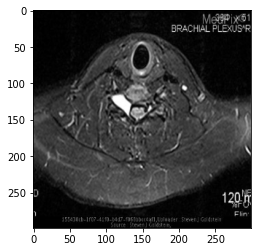

 27%|██▋       | 411/1498 [1:27:50<3:47:46, 12.57s/it]

ORIGINAL ----------------
Modality: MR T2* gradient,GRE,MPGR,SWAN,SWI Plane: Axial
Anatomy: Brain and Neuro   Findings: •  Pseudomeningocele
C7/T1 neural foramen on right •  C8 nerve root is not seen
on the right   Impression: Cervical Nerve Root Avulsion


AI GENERATED ------------
Modality: mr t2 weighted plane axial  Anatomy: msk
musculoskeletal   Findings: plain film of right knee 4
months after mva 1 month after acute limb ischemia  • mild
lucency at the anterior articular surface of the lateral
condyle in ap view  • mild medial and patellofemoral
osteoarthritis  • subchondral patellar


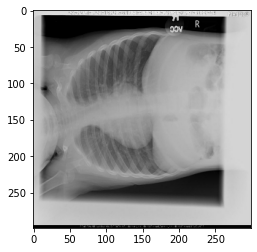

 28%|██▊       | 412/1498 [1:28:03<3:48:28, 12.62s/it]

ORIGINAL ----------------
Modality: XR - Plain Film Plane: Decubitus  Anatomy: Chest,
Pulmonary (ex. Heart)   Findings: The frontal and lateral
views of the thorax show hyperaeration and increased lucency
of the right hemithorax.  The decubitis films demonstrate no
movement of the diaphram on the right.   Impression: Foreign
Body Aspiration


AI GENERATED ------------
Modality: xr plain film plane pa  Anatomy: chest pulmonary
ex heart   Findings: cxr prominent bilateral hila when
compared with prior cxr 5 months prior peripheral tapering
of pulmonary vasculature new airspace opacification superior
segment left lower lobe seen best on lateral view ct pedvt
large clot burden involving majority


In [ ]:
# Prepare images from test set to be captioned
imgs=[]
texts=[]
for i in data_pipeline['captioning']['test']:
    img=i['image']
    text=i['text']
    imgs.append(img)
    texts.append(text)
    
    
# Caption them
true_captions=[]
true_tokens = []
predicted_captions= []
predicted_tokens = []

modality='US' #<--- select modality here
print('--------\n')
print('searching for {US}')
for i in tqdm(range(len(imgs))):
    # Check if the image is of a certain modality
                                                      
    img=imgs[i]
    img=tf.expand_dims(img,0)
    text=texts[i]
    text=tf.expand_dims(text,0)
    original=format_original(text)
 
    
    tokens=model.text_encoder.tokenize(text)
    true_tokens.append(tokens)

    batch_data={'image':img,'text':tf.constant('<start> ', shape=(1,))}

    this_tokens=[]
    for i in range(49):
        this_tokens
        
        probs=test_step(batch_data)
        selection=np.argmax(probs,axis=-1)
        
        this_tokens.append(selection[0,i])
        word=model.text_encoder.vocabulary_dict[selection[0,i]]
        batch_data['text']=batch_data['text']+' '+word

    predicted_tokens.append(this_tokens)
    plt.figure()
    plt.imshow(img.numpy()[0].astype(int))
    plt.show()
    print('ORIGINAL ----------------')
    print(original)
    print('\n')
    print('AI GENERATED ------------')
    caption=format_caption(batch_data['text'])
    print(caption)



    predicted_captions.append(caption)
    true_captions.append(text[0][0].numpy().decode("utf-8"))


In [40]:
# save the resulting captions to a csv
import pandas as pd
import os
processed_true_captions=[caption[8:-6] for caption in true_captions]
d={'true':processed_true_captions,'predicted':predicted_captions}
results=pd.DataFrame(d)
os.makedirs(f'../results/{date_str}/',exist_ok=True)
results.to_csv(f'../results/{date_str}/results_500.csv', index=False)

# TENSORBOARDS

In [11]:
%load_ext tensorboard 

In [12]:
logdir='../model_logs/pretraining/captioning/'

In [13]:
%tensorboard --logdir {logdir}

# LOAD A SAVED MODEL

## Instantiating the model
You need to use the same parameters that the model had at training. 
You must also use the same pipeline to call the model on some data. 

In [58]:

#Settings
params={
    'IMG_SIZE':(299,299),
    'IMG_BACKBONE':'efficientnetb0',
    'IMG_TRAINABLE':False,
    'EMBEDDING_DIM':500,
    'SEQ_LEN':70 ,
    'NUM_HEADS':3,
    'DROPOUT':0.01,
    'DATA_PATH':'../data/intermediate/inter_medpix.csv',
    'DATA_SPLIT':[0.9,0.05,0.05],
    'DATA_DOWNSCALE':False,               
    'LEARNING_RATE': 9e-4,
}

data_pipeline= build_pipeline(inter_dataset_path=params['DATA_PATH'],
                              image_size=params['IMG_SIZE'],
                              train_val_test_split=params['DATA_SPLIT'])

model= instantiate_captioner(params,data_pipeline)  # Instantiate the model

input images must be floats from 0 to 255 and have (299,299,3) format.



We need to call the model on some data before loading weights

In [59]:
train_data=data_pipeline['captioning']['train'].batch(32)
validation_data=data_pipeline['captioning']['val'].batch(32)
loss=tf.keras.losses.SparseCategoricalCrossentropy(reduction='none',from_logits=False)
opt = keras.optimizers.Adam(learning_rate=params['LEARNING_RATE'])
model.compile(loss=loss, optimizer=opt)
model.fit(train_data.take(1),epochs=1)

1/1 [==============================] - 11s 11s/step - loss: 9.4525 - acc: 6.0643e-04


In [60]:
# Load the weights
model.load_weights('../models/pretraining/captioning/20221107-034449') 